<a href="https://colab.research.google.com/github/alexchilton/CAS_Project_2_protein_autoencoders/blob/main/cleaned_notebook.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<h1 align="center"><strong>Protein autoencoder</strong></h1>

<h5 align="center">
    <a href="https://github.com/alexchilton/CAS_Project_2_protein_autoencoders">
        https://github.com/alexchilton/CAS_Project_2_protein_autoencoders
    </a>
    <br>
    Alex C., Lara N.
</h5>


# Libraries

In [ ]:
!pip install torch_geometric

In [ ]:
import os
import collections
import copy
import itertools
import json
import logging
import time
from datetime import datetime
from pathlib import Path
from collections import defaultdict
from tqdm.notebook import tqdm
from tqdm import tqdm
#from google.colab import drive


from PIL import Image
from IPython.display import display


import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd

import torch
import torch.nn as nn
import torch.nn.functional as F

from torch_geometric.data import Data, DataLoader
from torch_geometric.loader import DataLoader
from torch_geometric.nn import GATv2Conv
from torch_geometric.utils import to_dense_adj, k_hop_subgraph
from torch_geometric.utils import to_networkx
from torch_geometric.nn import GATConv, global_mean_pool

import networkx as nx

from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.neighbors import NearestNeighbors
from sklearn.model_selection import train_test_split

from scipy.stats import wasserstein_distance


In [ ]:
!pip install biopython

In [ ]:
import warnings
from Bio.PDB.PDBExceptions import PDBConstructionWarning

# Suppress PDB warnings globally
warnings.simplefilter('ignore', PDBConstructionWarning)

In [ ]:
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [ ]:
# For Colab only_move to function file directory, load and go back to content /drive
#%cd /content/drive/MyDrive/CAS_AML/function_files
from preprocessing_v3 import ProteinAnalyzer, process_pdb_directory
from utils_ln import load_aa_info
from graphvae import ProteinGraphVAE
#%cd /content/drive

# Configuration

In [ ]:
# Configure logging
logging.basicConfig(level=logging.INFO)
logger = logging.getLogger(__name__)

# Set environment variable for MPS fallback
os.environ['PYTORCH_ENABLE_MPS_FALLBACK'] = '1'

# Set plot style
sns.set_theme()

# Device setup
def get_device():
    """Get the best available device with fallbacks"""
    if torch.cuda.is_available():
        return torch.device('cuda')
    elif torch.backends.mps.is_available():
        logger.info("MPS (M1/M2) device found but using CPU for some operations due to compatibility")
        return torch.device('cpu')
    return torch.device('cpu')

def compute_average_edges(data_loader):
    """
    Compute the average number of edges and nodes in the dataset
    """
    total_edges = 0
    total_nodes = 0
    num_graphs = 0

    for batch in data_loader:
        total_edges += batch.edge_index.size(1) // 2  # Divide by 2 for undirected edges
        total_nodes += batch.x.size(0)
        num_graphs += 1

    return {
        'avg_edges': total_edges / num_graphs,
        'avg_nodes': total_nodes / num_graphs,
        'avg_backbone': total_nodes / num_graphs - 1  # One less than nodes
    }

# Paths and constants

In [ ]:
# # Define the file for a demo protein structure
# pdb_file = '/content/drive/MyDrive/CAS_AML/datasets/all_nano_structures_single_domain/1zv5.pdb'

# # Define the directory containing the PDB files
# pdb_directory = '/content/drive/MyDrive/CAS_AML/datasets/all_nano_structures_single_domain_clean'

# # Define the file containing amino acid information
# aa_info_file = '/content/drive/MyDrive/CAS_AML/info_files/aa_mass_letter.csv'

# # Preprocessed protein dataframes
# output_dir = "/content/drive/MyDrive/CAS_AML/outputs/processed_dataframes"

# output_model_dir="/content/drive/MyDrive/CAS_AML/models"


In [ ]:
# on local

# Define the file for a demo protein structure
pdb_file = 'data/all_nano_structures_single_domain/1zv5.pdb'

# Define the directory containing the PDB files
pdb_directory = 'data/all_nano_structures_single_domain_clean'

# Define the file containing amino acid information
aa_info_file = 'aa_mass_letter.csv'

# Preprocessed protein dataframes
output_dir = "processed_dataframes"
output_model_dir="model"

# Preprocessing

Data are preprocessed from PDB files.   
Each PDB file is extracted and converted in a dataframe containing infrmation on the 3D structure (x, y, z coordinates of the aminoacids), on the neighborhood (number of surrounding aminoacids with average, and max distance) and on the additional small molecules close to that residue that have an impact on the structure.   
Distances and position in the 3D space are computed through the position of the alpha carbon mapped with the aminoacid mass to have an information on the aminoacid residue in that position, with relatively smaller dataframes.

In [ ]:
img = Image.open("/content/drive/MyDrive/CAS_AML/info_files/alpha_carbon.jpg")
img1=Image.open("/content/drive/MyDrive/CAS_AML/info_files/nanobody.jpg")

base_width = 600
wpercent = (base_width / float(img.size[0]))
hsize = int((float(img.size[1]) * float(wpercent)))
img = img.resize((base_width, hsize), Image.Resampling.LANCZOS)

base_width = 600
wpercent = (base_width / float(img1.size[0]))
hsize = int((float(img.size[1]) * float(wpercent)))
img1 = img1.resize((base_width, hsize), Image.Resampling.LANCZOS)



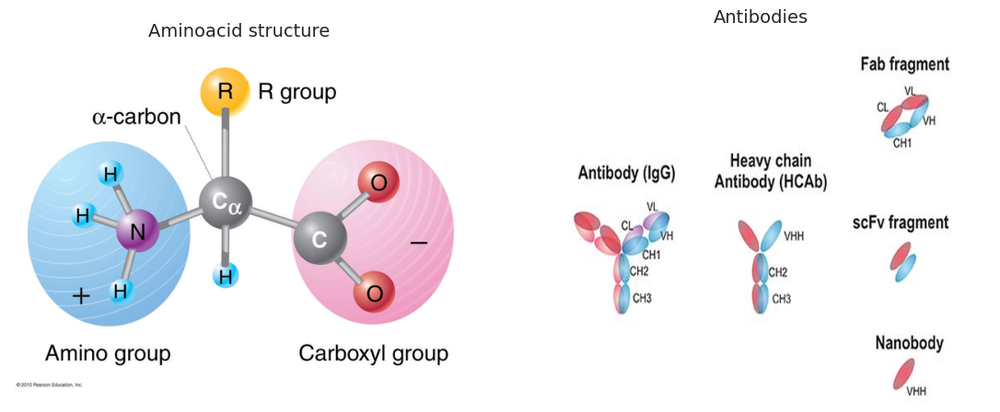

In [ ]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 12))


ax1.imshow(img)
ax1.grid(None)
ax1.set_xticks([])
ax1.set_yticks([])
ax1.set_title('Aminoacid structure', fontsize=14, pad=20)


ax2.imshow(img1)
ax2.grid(None)
ax2.set_xticks([])
ax2.set_yticks([])
ax2.set_title('Antibodies', fontsize=14, pad=20)

plt.tight_layout(pad=4)  # layout
plt.show()



In [ ]:
# Load amino acid information
aa_info = pd.read_csv(aa_info_file)
aa_info['Abbrev.'] = aa_info['Abbrev.'].apply(lambda x: x.upper())
aa_info_dict = aa_info.set_index('Abbrev.').to_dict(orient='index')
#aa_info_dict

In [ ]:
# Process PDB directory
dataframes = process_pdb_directory(pdb_directory, aa_info_dict, neighborhood_radius=5.0)


Processing PDBs: 100%|██████████| 1646/1646 [14:06<00:00,  1.95it/s] 


In [ ]:
dataframes[100]

('data/all_nano_structures_single_domain_clean/6qpg.pdb',
                X          Y           Z   Avg_Mass  Avg_Neighbor_Dist  \
 0      36.323002  -3.720000   27.447001  149.20784           3.798889   
 1      34.318001  -2.347000   30.367001  147.13074           3.804916   
 2      35.535000   1.252000   30.068001  133.10384           4.203339   
 3      34.761002   1.298000   26.339001  165.19184           4.117101   
 4      31.247999  -0.021000   27.004999  117.14784           3.807043   
 ...          ...        ...         ...        ...                ...   
 8798  245.561005 -49.153000 -143.811005  146.14594           3.813642   
 8799  248.477997 -46.709999 -143.660995   75.06714           4.038929   
 8800  251.311005 -45.792000 -146.042007  119.12034           3.802752   
 8801  255.044998 -45.397999 -145.507004  117.14784           4.184459   
 8802  257.760986 -42.911999 -146.505005  119.12034           4.312732   
 
       Max_Neighbor_Dist  Neighbor_Count  Small_Mole

In [ ]:
import os

# Directory to store processed DataFrames
os.makedirs(output_dir, exist_ok=True)

# Save each DataFrame to a pickle file
for pdb_file, df in dataframes:
    pdb_id = os.path.basename(pdb_file).replace('.pdb', '')  # Extract PDB ID from filename
    df.to_pickle(os.path.join(output_dir, f"{pdb_id}.pkl"))

print(f"DataFrames saved in {output_dir} as pickle files")


# Graph conversion

In [ ]:
def nanobody_to_graph(df, k=10, include_coordinates=True):
    """
    Convert a nanobody DataFrame into a graph for GTA-based GNNs.

    Parameters:
    - df: DataFrame containing nanobody data.
    - k: Number of nearest neighbors for graph connectivity.
    - include_coordinates: Whether to include 3D coordinates in node features.

    Returns:
    - PyTorch Geometric Data object.
    """
    # Step 1: Node Features
    features_to_include = ['Avg_Mass', 'Avg_Neighbor_Dist', 'Max_Neighbor_Dist', 'Neighbor_Count', 'Small_Molecules_Found']
    node_features = df[features_to_include].values

    if include_coordinates:
        coords = df[['X', 'Y', 'Z']].values
        node_features = np.hstack([node_features, coords])

    # to tensor
    node_features = torch.tensor(node_features, dtype=torch.float)

    # Step 2: KNN-based Edge Construction
    coords = df[['X', 'Y', 'Z']].values
    nbrs = NearestNeighbors(n_neighbors=k, algorithm='ball_tree').fit(coords)
    distances, indices = nbrs.kneighbors(coords)

    edge_index = []
    edge_attr = []
    for i in range(len(indices)):
        for j in range(1, k):
            edge_index.append([i, indices[i, j]])
            edge_attr.append([distances[i, j]])

    edge_index = torch.tensor(edge_index, dtype=torch.long).t().contiguous()
    edge_attr = torch.tensor(edge_attr, dtype=torch.float)

    # Step 3: Create Graph Data Object
    data = Data(
        x=node_features,
        edge_index=edge_index,
        edge_attr=edge_attr,
    )
    return data


In [ ]:
graphs = []
for pdb_file, df in tqdm(dataframes, desc="Processing", unit="graph", bar_format="{l_bar}{bar}| {n_fmt}/{total_fmt} [{elapsed}<{remaining}]"):
    graph = nanobody_to_graph(df, k=5, include_coordinates=True)
    graphs.append((pdb_file, graph))


Processing: 100%|██████████| 1646/1646 [00:36<00:00]


# Graph representation and reality

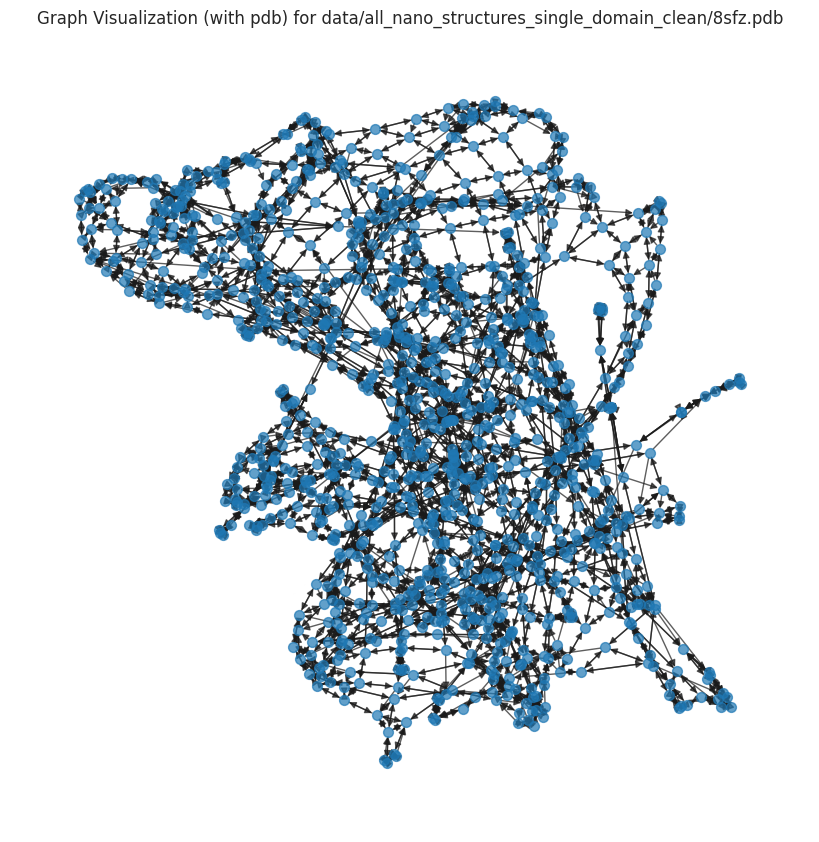

In [ ]:
def visualize_nanobody_graph(data, pdb_file):
    """Visualize the nanobody graph."""
    G = to_networkx(data, edge_attrs=['edge_attr'], node_attrs=['x'])
    pos = nx.spring_layout(G, seed=42)
    plt.figure(figsize=(8,8))
    nx.draw(G, pos, with_labels=False, node_size=50, alpha=0.7)
    plt.title(f"Graph Visualization (with pdb) for {pdb_file}")
    plt.show()

# Example
pdb_file, data = graphs[20]
visualize_nanobody_graph(data, pdb_file)


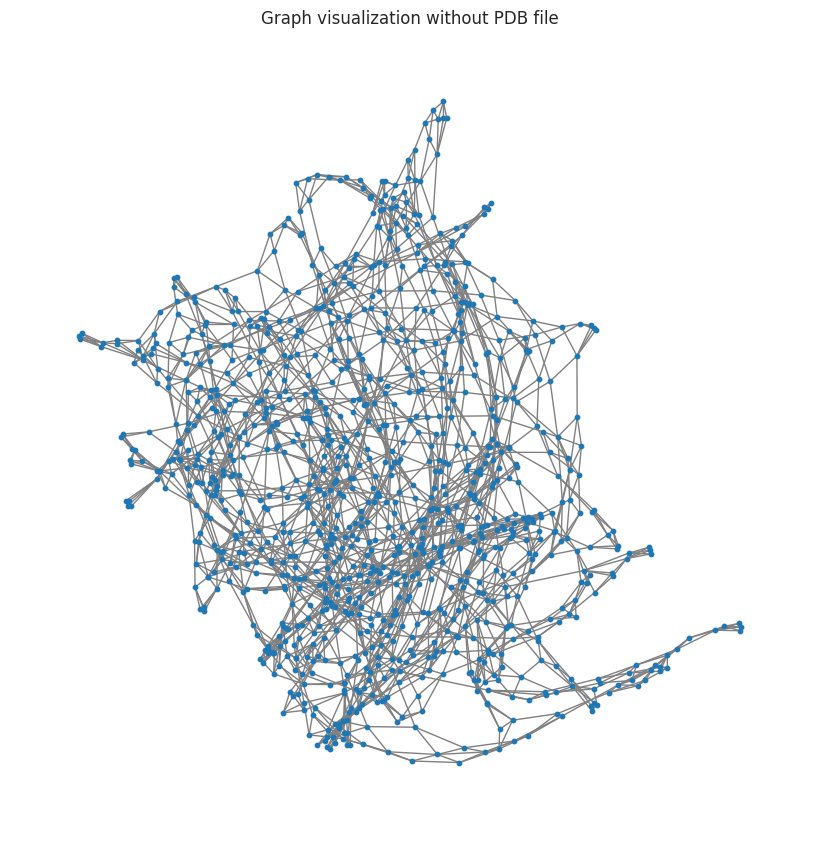

In [ ]:
pdb, graph_data = graphs[20]
nx_graph = to_networkx(graph_data, to_undirected=True)
plt.figure(figsize=(8, 8))
nx.draw(nx_graph, node_size=10, edge_color="gray")
plt.title('Graph visualization without PDB file')
plt.show()

Representation of a preprocessed protein in form of graph. Important element are the asymmetry and teh metrics.

In [ ]:
metrics = calculate_graph_metrics(graph_data)
print("Metrics for Graph-Protein")
for key, value in metrics.items():
    print(f"  {key}: {value}")

Metrics for Graph-Protein
  num_nodes: 1058
  num_edges: 2426
  avg_degree: 4.586011342155009
  edge_density: 0.004338705148680236
  clustering_coeff: 0.3730323761514688
  graph_diameter: inf
  avg_path_length: inf


In [ ]:
image_path_1 = "/content/drive/MyDrive/CAS_AML/info_files/nanobody.jpg"
image_path_2 = "/content/drive/MyDrive/CAS_AML/info_files/nanobody.jpg"
image_1 = Image.open(image_path_1)
image_2 = Image.open(image_path_2)

fig, axes = plt.subplots(1, 2, figsize=(15, 8))  # 1 row, 2 columns
axes[0].imshow(image_1)
axes[0].axis('off')
axes[0].set_title("Image 1: Original")

axes[1].imshow(image_2)
axes[1].axis('off')
axes[1].set_title("Image 2: Plot")

plt.tight_layout()
plt.show()


# Dataloader and augmentation

In [ ]:
def prepare_graphs_for_vae(graph_tuples, batch_size=16, train_ratio=0.8, shuffle=True):
    """
    Prepare PDB graph data for VAE training with normalization
    """
    # Extract PyG Data objects
    graphs = [g[1] for g in graph_tuples]

    # Calculate normalization statistics across all graphs
    all_features = torch.cat([g.x for g in graphs], dim=0)
    feature_means = all_features.mean(dim=0)
    feature_stds = all_features.std(dim=0)

    # Prevent division by zero
    feature_stds = torch.where(feature_stds == 0, torch.ones_like(feature_stds), feature_stds)

    # Normalize all graphs
    for graph in graphs:
        graph.x = (graph.x - feature_means) / feature_stds

        # Also normalize edge attributes (distances)
        if graph.edge_attr is not None:
            edge_mean = graph.edge_attr.mean()
            edge_std = graph.edge_attr.std()
            if edge_std > 0:
                graph.edge_attr = (graph.edge_attr - edge_mean) / edge_std

    # Rest of your existing function...
    train_graphs, test_graphs = train_test_split(
        graphs,
        train_size=train_ratio,
        shuffle=shuffle,
        random_state=42
    )

    train_loader = DataLoader(
        train_graphs,
        batch_size=batch_size,
        shuffle=shuffle
    )

    test_loader = DataLoader(
        test_graphs,
        batch_size=batch_size,
        shuffle=False
    )

    sample_data = train_graphs[0]
    in_channels = sample_data.x.size(1)

    print(f"Dataset prepared:")
    print(f"Number of training graphs: {len(train_graphs)}")
    print(f"Number of test graphs: {len(test_graphs)}")
    print(f"Number of features per node: {in_channels}")
    print(f"Feature means:", feature_means)
    print(f"Feature stds:", feature_stds)

    # Return normalization parameters for later use (e.g., inference)
    return train_loader, test_loader, in_channels, (feature_means, feature_stds)

In [ ]:
# Adjust batch size for better gradient estimates
train_loader, test_loader, in_channels, norm_params = prepare_graphs_for_vae(
    graphs,
    batch_size=16,  # Increased batch size
    train_ratio=0.8,
    shuffle=True
)

Dataset prepared:
Number of training graphs: 1316
Number of test graphs: 330
Number of features per node: 8
Feature means: tensor([129.2633,   3.9415,   4.2174,   3.1894,   1.8581,  89.7058,  92.3966,
         96.3327])
Feature stds: tensor([ 29.3618,   0.1919,   0.4701,   6.9553,   1.7267,  99.2087,  95.7911,
        101.8036])


In [ ]:
def augment_graph(graph, noise_level=0.01):
    """
    Augments a PyTorch Geometric graph by adding small random noise to node features
    and edge attributes.

    Parameters:
    - graph: PyG Data object to augment.
    - noise_level: Magnitude of noise to add to node features and edge attributes.

    Returns:
    - Augmented PyG Data object.
    """
    augmented_graph = graph.clone()

    # Add random noise to node features
    if graph.x is not None:
        augmented_graph.x += torch.randn_like(graph.x) * noise_level

    # Add random noise to edge attributes (e.g., distances)
    if graph.edge_attr is not None:
        augmented_graph.edge_attr += torch.randn_like(graph.edge_attr) * noise_level

    return augmented_graph


In [ ]:
# Augment graphs in the training dataset
augmented_train_dataset = [augment_graph(g) for g in train_loader.dataset]

# Create a new DataLoader with augmented data
augmented_train_loader = DataLoader(augmented_train_dataset, batch_size=32, shuffle=True)

# Graph Variational Autoencoder (GraphVAE)

In [ ]:
def setup_and_train_vae(graph_tuples, batch_size=16, hidden_channels=64, latent_channels=32, num_heads=4, num_epochs=100):
    """
    Set up the VAE and start training with attention-based handling of variable-sized graphs
    """
    # Set up device
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    print(f"Using device: {device}")

    # Prepare data
    train_loader, test_loader, in_channels = prepare_graphs_for_vae(
        graph_tuples,
        batch_size=batch_size
    )

    # Initialize model
    model = ProteinGraphVAE(
        in_channels=in_channels,
        hidden_channels=hidden_channels,
        latent_channels=latent_channels,
        num_heads=num_heads
    ).to(device)

    # Train model
    trained_model, train_losses, test_losses = train_model(
        model=model,
        train_loader=train_loader,
        test_loader=test_loader,
        device=device,
        num_epochs=num_epochs
    )

    return trained_model, train_losses, test_losses, (train_loader, test_loader)

In [ ]:
def kl_annealing_factor(epoch, warmup_epochs=10, min_weight=0.0001, max_weight=1.0):
    """Compute KL annealing factor that gradually increases from min_weight to max_weight"""
    if epoch < warmup_epochs:
        return min_weight + (max_weight - min_weight) * (epoch / warmup_epochs)
    return max_weight

def compute_orthogonal_regularization(mu, lambda_ortho=0.1):
    """Compute orthogonality regularization for the latent space"""
    batch_size = mu.size(0)
    mu_normalized = F.normalize(mu, p=2, dim=1)  # Normalize each embedding
    correlation = torch.mm(mu_normalized.t(), mu_normalized) / batch_size
    identity = torch.eye(correlation.size(0), device=correlation.device)
    ortho_loss = lambda_ortho * torch.sum((correlation - identity) ** 2)
    return ortho_loss

def train_model(model, train_loader, test_loader, device, num_epochs=100,
                min_beta=0.0001, max_beta=0.01, warmup_epochs=10, lambda_ortho=0.1):
    """
    Train VAE model with KL annealing and orthogonal regularization
    """
    model = model.to(device)
    optimizer = torch.optim.Adam(model.parameters(), lr=0.001, weight_decay=1e-5)
    max_grad_norm = 1.0

    print(f"Starting training for {num_epochs} epochs...")
    print(f"Training on device: {device}")
    print(f"Number of training batches: {len(train_loader)}")
    print(f"Number of validation batches: {len(test_loader)}")
    print(f"KL annealing: {min_beta} -> {max_beta} over {warmup_epochs} epochs")
    print(f"Orthogonal regularization strength: {lambda_ortho}")

    history = {
        'train': {
            'total_loss': [], 'recon_loss': [], 'kl_loss': [], 'ortho_loss': [],
            'mass_loss': [], 'distance_loss': [], 'count_loss': [],
            'small_mol_loss': [], 'coord_loss': [], 'edge_loss': [],
            'beta': []  # Track KL weight
        },
        'test': {
            'total_loss': [], 'recon_loss': [], 'kl_loss': [], 'ortho_loss': [],
            'mass_loss': [], 'distance_loss': [], 'count_loss': [],
            'small_mol_loss': [], 'coord_loss': [], 'edge_loss': []
        }
    }

    for epoch in range(num_epochs):
        epoch_start_time = time.time()
        model.train()
        epoch_losses = {k: 0.0 for k in history['train'].keys()}

        # Get current KL weight from annealing schedule
        current_beta = kl_annealing_factor(epoch, warmup_epochs, min_beta, max_beta)
        epoch_losses['beta'] = current_beta

        # Progress bar for training
        pbar = tqdm(train_loader, desc=f'Epoch {epoch+1}/{num_epochs} [Train]')
        batch_count = 0

        for batch in pbar:
            try:
                batch = batch.to(device)
                optimizer.zero_grad()

                # Debug info for first batch
                if batch_count == 0 and epoch == 0:
                    print(f"\nBatch shapes:")
                    print(f"Input x shape: {batch.x.shape}")
                    print(f"Edge index shape: {batch.edge_index.shape}")
                    print(f"Edge attr shape: {batch.edge_attr.shape}")

                # Forward pass
                recon_batch, edge_recon, mu, logvar = model(batch.x, batch.edge_index,
                                                            batch.edge_attr, batch.batch)

                if batch_count == 0 and epoch == 0:
                    print(f"Reconstruction shape: {recon_batch.shape}")
                    print(f"Edge reconstruction shape: {edge_recon.shape}")

                # Reshape original data
                _, counts = torch.unique(batch.batch, return_counts=True)
                max_nodes = counts.max()
                batch_size = len(counts)
                padded_x = torch.zeros(batch_size, max_nodes, batch.x.size(1), device=device)

                start_idx = 0
                for i, count in enumerate(counts):
                    padded_x[i, :count] = batch.x[start_idx:start_idx + count]
                    start_idx += count

                # Calculate losses
                recon_loss, feature_losses = model.feature_specific_loss(
                    recon_batch, padded_x, edge_recon, batch.edge_attr)

                kl_loss = -0.5 * torch.mean(1 + logvar - mu.pow(2) - logvar.exp())

                # Add orthogonality regularization
                ortho_loss = compute_orthogonal_regularization(mu, lambda_ortho)

                # Combine losses with annealed KL weight
                loss = recon_loss + current_beta * kl_loss + ortho_loss

                # Detailed diagnostics every 10 batches
                if batch_count % 10 == 0:
                    with torch.no_grad():
                        print("\nDetailed loss diagnostics:")
                        print(f"Raw recon_loss: {recon_loss.item():.4f}")
                        print(f"Raw KL loss: {kl_loss.item():.4f}")
                        print(f"Ortho loss: {ortho_loss.item():.4f}")
                        print(f"Current beta: {current_beta:.4f}")
                        print(f"mu mean: {mu.mean().item():.4f}, std: {mu.std().item():.4f}")
                        print(f"logvar mean: {logvar.mean().item():.4f}, std: {logvar.std().item():.4f}")
                        for k, v in feature_losses.items():
                            print(f"{k}: {v.item():.4f}")

                # Backward pass with gradient clipping
                loss.backward()
                torch.nn.utils.clip_grad_norm_(model.parameters(), max_grad_norm)
                optimizer.step()

                # Update progress bar and losses
                batch_count += 1
                epoch_losses['total_loss'] += loss.item()
                epoch_losses['recon_loss'] += recon_loss.item()
                epoch_losses['kl_loss'] += kl_loss.item()
                epoch_losses['ortho_loss'] += ortho_loss.item()
                for k, v in feature_losses.items():
                    epoch_losses[f'{k}_loss'] += v.item()

                # Update progress bar description
                pbar.set_postfix({
                    'loss': f'{loss.item():.4f}',
                    'recon': f'{recon_loss.item():.4f}',
                    'kl': f'{kl_loss.item():.4f}',
                    'ortho': f'{ortho_loss.item():.4f}'
                })

            except Exception as e:
                print(f"\nError in batch {batch_count}:")
                print(str(e))
                print("Batch details:")
                print(f"Batch size: {batch.num_graphs}")
                print(f"Number of nodes: {batch.num_nodes}")
                print(f"Number of edges: {batch.num_edges}")
                continue

        # Average losses
        num_batches = len(train_loader)
        for k in epoch_losses:
            if k != 'beta':  # Don't average the beta value
                epoch_losses[k] = epoch_losses[k] / num_batches
            history['train'][k].append(epoch_losses[k])

        # Validation phase
        model.eval()
        test_losses = {k: 0.0 for k in history['test'].keys()}

        print("\nStarting validation...")
        with torch.no_grad():
            for batch in tqdm(test_loader, desc=f'Epoch {epoch+1}/{num_epochs} [Valid]'):
                batch = batch.to(device)
                recon_batch, edge_recon, mu, logvar = model(batch.x, batch.edge_index,
                                                            batch.edge_attr, batch.batch)

                # Reshape original data
                _, counts = torch.unique(batch.batch, return_counts=True)
                max_nodes = counts.max()
                batch_size = len(counts)
                padded_x = torch.zeros(batch_size, max_nodes, batch.x.size(1), device=device)

                start_idx = 0
                for i, count in enumerate(counts):
                    padded_x[i, :count] = batch.x[start_idx:start_idx + count]
                    start_idx += count

                recon_loss, feature_losses = model.feature_specific_loss(
                    recon_batch, padded_x, edge_recon, batch.edge_attr)
                kl_loss = -0.5 * torch.mean(1 + logvar - mu.pow(2) - logvar.exp())
                ortho_loss = compute_orthogonal_regularization(mu, lambda_ortho)
                loss = recon_loss + current_beta * kl_loss + ortho_loss

                test_losses['total_loss'] += loss.item()
                test_losses['recon_loss'] += recon_loss.item()
                test_losses['kl_loss'] += kl_loss.item()
                test_losses['ortho_loss'] += ortho_loss.item()
                for k, v in feature_losses.items():
                    test_losses[f'{k}_loss'] += v.item()

        # Average test losses
        for k in test_losses:
            test_losses[k] /= len(test_loader)
            history['test'][k].append(test_losses[k])

        epoch_time = time.time() - epoch_start_time

        # Print epoch summary
        print(f'\nEpoch [{epoch+1}/{num_epochs}] - Time: {epoch_time:.2f}s')
        print(f'Train - Total: {epoch_losses["total_loss"]:.4f}, '
              f'Recon: {epoch_losses["recon_loss"]:.4f}, '
              f'KL: {epoch_losses["kl_loss"]:.4f}, '
              f'Ortho: {epoch_losses["ortho_loss"]:.4f}, '
              f'Beta: {current_beta:.4f}')
        print('Feature Losses:')
        for k in ['mass_loss', 'distance_loss', 'count_loss',
                  'small_mol_loss', 'coord_loss', 'edge_loss']:
            print(f'  {k}: {epoch_losses[k]:.4f}')

        # Plot training progress
        if (epoch + 1) % 1 == 0:  # Plot every epoch
            plt.figure(figsize=(20, 10))

            # Plot 1: Total, Reconstruction, KL, and Ortho losses
            plt.subplot(2, 2, 1)
            plt.plot(history['train']['total_loss'], label='Total Loss')
            plt.plot(history['train']['recon_loss'], label='Reconstruction Loss')
            plt.plot(history['train']['kl_loss'], label='KL Loss')
            plt.plot(history['train']['ortho_loss'], label='Ortho Loss')
            plt.plot(history['train']['beta'], label='Beta (KL weight)')
            plt.xlabel('Epoch')
            plt.ylabel('Loss')
            plt.title('Training Losses')
            plt.legend()
            plt.grid(True)

            # Plot 2: Feature-specific losses
            plt.subplot(2, 2, 2)
            for k in ['mass_loss', 'distance_loss', 'count_loss',
                      'small_mol_loss', 'coord_loss', 'edge_loss']:
                plt.plot(history['train'][k], label=k.replace('_loss', ''))
            plt.xlabel('Epoch')
            plt.ylabel('Loss')
            plt.title('Feature-specific Losses')
            plt.legend()
            plt.grid(True)

            # Plot 3: Feature-specific losses (log scale)
            plt.subplot(2, 2, 3)
            for k in ['mass_loss', 'distance_loss', 'count_loss',
                      'small_mol_loss', 'coord_loss', 'edge_loss']:
                values = [max(1e-10, abs(x)) for x in history['train'][k]]
                plt.semilogy(values, label=k.replace('_loss', ''))
            plt.xlabel('Epoch')
            plt.ylabel('Loss (log scale)')
            plt.title('Feature-specific Losses (Log Scale)')
            plt.legend()
            plt.grid(True)

            # Plot 4: Training vs Validation losses
            plt.subplot(2, 2, 4)
            plt.plot(history['train']['total_loss'], label='Train Loss')
            plt.plot(history['test']['total_loss'], label='Val Loss')
            plt.xlabel('Epoch')
            plt.ylabel('Loss')
            plt.title('Training vs Validation Loss')
            plt.legend()
            plt.grid(True)

            plt.tight_layout()
            plt.show()

    print("\nTraining completed!")
    return model, history

## Model instantiation and summary

In [ ]:
model = ProteinGraphVAE(
    in_channels=8,
    hidden_channels=64,
    latent_channels=16,
    num_heads=4,
    edge_dim=1
)

In [ ]:
# Print model structure and parameter count
print("Model structure:")
print(model)

print("\nParameter count by layer:")
total_params = 0
for name, param in model.named_parameters():
    if param.requires_grad:
        print(f"{name}: {param.numel()} parameters")
        total_params += param.numel()
print(f"\nTotal trainable parameters: {total_params}")

Model structure:
ProteinGraphVAE(
  (encoder_layers): ModuleList(
    (0): GATConv(8, 64, heads=4)
    (1): GATConv(256, 64, heads=2)
    (2): GATConv(128, 64, heads=1)
  )
  (encoder_ff): Sequential(
    (0): Linear(in_features=64, out_features=128, bias=True)
    (1): ReLU()
    (2): Dropout(p=0.2, inplace=False)
    (3): Linear(in_features=128, out_features=64, bias=True)
    (4): ReLU()
  )
  (fc_mu): Linear(in_features=64, out_features=16, bias=True)
  (fc_logvar): Linear(in_features=64, out_features=16, bias=True)
  (shared_decoder): Sequential(
    (0): Linear(in_features=16, out_features=64, bias=True)
    (1): ReLU()
    (2): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): Dropout(p=0.2, inplace=False)
    (4): Linear(in_features=64, out_features=128, bias=True)
    (5): ReLU()
    (6): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): Linear(in_features=128, out_features=64, bias=True)
  )
  (coo

In [ ]:
device=get_device()

In [ ]:
def visualize_latent_space_with_node_count_filtered(model, data_loader, device='cuda', method='tsne', perplexity=30, max_nodes=5000):
    """
    Visualize the latent space using t-SNE or PCA, filtering graphs with a maximum number of nodes.

    Parameters:
    - model: Trained ProteinGraphVAE model.
    - data_loader: PyTorch Geometric DataLoader containing graphs.
    - device: 'cuda' or 'cpu'.
    - method: 'tsne' or 'pca' for dimensionality reduction.
    - perplexity: t-SNE perplexity (only for t-SNE).
    - max_nodes: Maximum number of nodes for graphs to be included in visualization.

    Returns:
    - None (displays the plot).
    """
    model.eval()
    model = model.to(device)

    latent_vectors = []
    node_counts = []

    with torch.no_grad():
        for batch in data_loader:
            batch = batch.to(device)

            # Encode to latent space
            mu, _ = model.encode(batch.x, batch.edge_index, batch.edge_attr, batch.batch)

            if mu.size(0) == batch.batch.max().item() + 1:
                # mu is already graph-level
                latent_vectors.append(mu.cpu().numpy())
                node_counts.extend([g.x.size(0) for g in batch.to_data_list()])  # Number of nodes per graph
            else:
                # mu is node-level, pool to graph-level
                pooled_mu = global_mean_pool(mu, batch.batch)  # Shape: [num_graphs, latent_dim]
                latent_vectors.append(pooled_mu.cpu().numpy())
                node_counts.extend([g.x.size(0) for g in batch.to_data_list()])  # Number of nodes per graph

    # Concatenate results
    latent_vectors = np.concatenate(latent_vectors, axis=0)
    node_counts = np.array(node_counts)

    # Filter graphs based on the number of nodes
    mask = node_counts <= max_nodes
    filtered_latent_vectors = latent_vectors[mask]
    filtered_node_counts = node_counts[mask]

    # Dimensionality reduction
    if method == 'tsne':
        reducer = TSNE(n_components=2, perplexity=perplexity, random_state=42)
    elif method == 'pca':
        reducer = PCA(n_components=2)
    else:
        raise ValueError("Method must be 'tsne' or 'pca'.")

    reduced_latent = reducer.fit_transform(filtered_latent_vectors)
    print(f"Filtered node counts: {filtered_node_counts.min()} - {filtered_node_counts.max()}")

    # Plotting
    plt.figure(figsize=(8, 8))
    scatter = plt.scatter(
        reduced_latent[:, 0],
        reduced_latent[:, 1],
        c=filtered_node_counts,  # Use filtered node counts as labels
        cmap='viridis',
        alpha=0.7
    )
    plt.colorbar(scatter, label='Node Counts')
    plt.title(f'Latent Space Visualization ({method.upper()}) - Filtered by Nodes ≤ {max_nodes}')
    plt.xlabel('Dimension 1')
    plt.ylabel('Dimension 2')
    plt.grid(True)
    plt.show()


## Visualization of the latent space before training

Filtered node counts: 102 - 4743


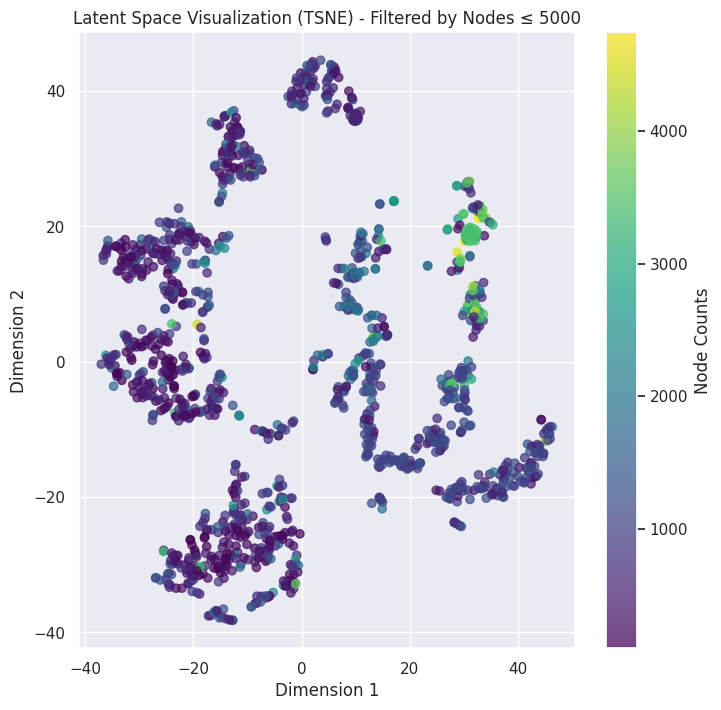

In [ ]:
visualize_latent_space_with_node_count_filtered(
    model=model,
    data_loader=augmented_train_loader,
    device=device,
    method='tsne',
    perplexity=30,
    max_nodes=5000
)

Filtered node counts: 102 - 4743


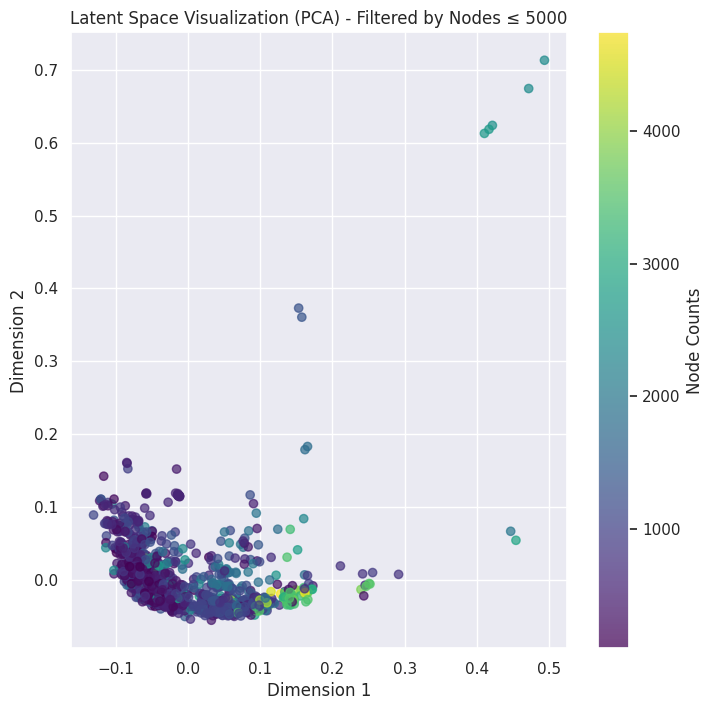

In [ ]:
visualize_latent_space_with_node_count_filtered(
    model=model,
    data_loader=augmented_train_loader,
    device=device,
    method='pca',
    max_nodes=5000
)

In [ ]:
def generate_protein_graphs(
    model,
    num_samples=5,
    nodes_per_graph=200,
    norm_params=None,
    device='cuda',
    k=10,
    temperature=1.0
):
    model.eval()
    model = model.to(device)

    # Handle normalization parameters
    feature_means, feature_stds = norm_params
    feature_means = feature_means.clone().detach().to(device)
    feature_stds = feature_stds.clone().detach().to(device)

    generated_graphs = []

    with torch.no_grad():
        for _ in range(num_samples):
            z = torch.randn(1, model.latent_channels).to(device) * temperature

            # Placeholder edge_index for decoding
            edge_index = torch.tensor(
                [[i, (i + 1) % nodes_per_graph] for i in range(nodes_per_graph)],
                dtype=torch.long
            ).t().contiguous().to(device)

            # Decode features
            decoded_features, _ = model.decode(
                z,
                num_nodes=nodes_per_graph,
                edge_index=edge_index
            )

            # Unnormalize features
            decoded_features = (decoded_features * feature_stds) + feature_means

            # Extract coordinates (ensure they are 2D)
            coords = decoded_features[0, :, -3:].cpu().numpy()

            # Create edges using k-NN
            nbrs = NearestNeighbors(n_neighbors=k, algorithm='ball_tree').fit(coords)
            distances, indices = nbrs.kneighbors(coords)

            edge_index = []
            edge_attr = []
            for i in range(len(indices)):
                for j in range(1, k):
                    edge_index.append([i, indices[i, j]])
                    edge_attr.append([distances[i, j]])

            edge_index = torch.tensor(edge_index, dtype=torch.long).t().contiguous().to(device)
            edge_attr = torch.tensor(edge_attr, dtype=torch.float).to(device)

            # Create PyG Data object
            graph = Data(
                x=decoded_features[0],  # Use the first graph's features
                edge_index=edge_index,
                edge_attr=edge_attr
            )
            generated_graphs.append(graph)

    return generated_graphs



In [ ]:
graph_data = [g[1] for g in graphs]

generated_graphs = generate_protein_graphs(
    model=model,
    num_samples=2,  # No of graphs
    nodes_per_graph=1000,  # nodes per graph
    norm_params=norm_params,
    device=device,
    k=5,
    temperature=1.5
)

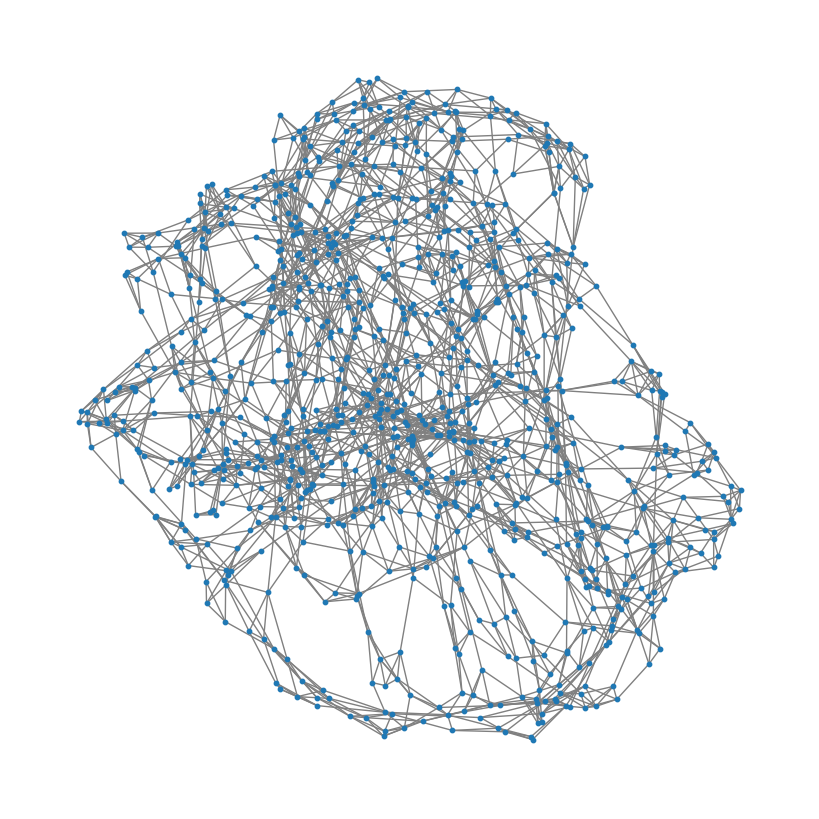

In [ ]:
graph = generated_graphs[0]
nx_graph = to_networkx(graph, to_undirected=True)
plt.figure(figsize=(8, 8))
nx.draw(nx_graph, node_size=10, edge_color="gray")
plt.show()

In [ ]:
def calculate_graph_metrics(graph):
    # Convert PyG graph to NetworkX format
    nx_graph = to_networkx(graph, to_undirected=True)

    # Compute metrics
    num_nodes = nx_graph.number_of_nodes()
    num_edges = nx_graph.number_of_edges()
    avg_degree = sum(dict(nx_graph.degree()).values()) / num_nodes
    edge_density = nx.density(nx_graph)
    clustering_coeff = nx.average_clustering(nx_graph)
    graph_diameter = nx.diameter(nx_graph) if nx.is_connected(nx_graph) else float('inf')
    avg_path_length = nx.average_shortest_path_length(nx_graph) if nx.is_connected(nx_graph) else float('inf')

    return {
        "num_nodes": num_nodes,
        "num_edges": num_edges,
        "avg_degree": avg_degree,
        "edge_density": edge_density,
        "clustering_coeff": clustering_coeff,
        "graph_diameter": graph_diameter,
        "avg_path_length": avg_path_length
    }

In [ ]:
# Apply this to each generated graph
for i, protein_graph in enumerate(generated_graphs, 1):
    metrics = calculate_graph_metrics(protein_graph)
    print(f"Metrics for Generated Protein {i}:")
    for key, value in metrics.items():
        print(f"  {key}: {value}")

Metrics for Generated Protein 1:
  num_nodes: 1000
  num_edges: 2571
  avg_degree: 5.142
  edge_density: 0.005147147147147147
  clustering_coeff: 0.4132515873015873
  graph_diameter: 21
  avg_path_length: 9.792246246246247
Metrics for Generated Protein 2:
  num_nodes: 1000
  num_edges: 2616
  avg_degree: 5.232
  edge_density: 0.005237237237237237
  clustering_coeff: 0.40208730158730155
  graph_diameter: 22
  avg_path_length: 9.626656656656657


## Training

Starting training for 100 epochs...
Training on device: cuda
Number of training batches: 42
Number of validation batches: 21
KL annealing: 1e-05 -> 0.005 over 25 epochs
Orthogonal regularization strength: 0.1


Epoch 1/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 17.67it/s, loss=2.1234, recon=0.6392, kl=0.3737, ortho=1.4842]


Batch shapes:
Input x shape: torch.Size([27456, 8])
Edge index shape: torch.Size([2, 109824])
Edge attr shape: torch.Size([109824, 1])
Reconstruction shape: torch.Size([32, 3558, 8])
Edge reconstruction shape: torch.Size([109824, 1])

Detailed loss diagnostics:
Raw recon_loss: 0.6920
Raw KL loss: 0.3766
Ortho loss: 1.4928
Current beta: 0.0000
mu mean: 0.0045, std: 0.1237
logvar mean: 1.0027, std: 0.1043
mass: 0.1508
distance: 0.1437
count: 0.0652
small_mol: 0.0685
coord: 0.1744
edge: 0.0894


Epoch 1/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 18.05it/s, loss=1.9416, recon=0.5046, kl=0.3987, ortho=1.4370]


Detailed loss diagnostics:
Raw recon_loss: 0.5398
Raw KL loss: 0.3920
Ortho loss: 1.4335
Current beta: 0.0000
mu mean: 0.0147, std: 0.1584
logvar mean: 1.0037, std: 0.1581
mass: 0.1419
distance: 0.1349
count: 0.0598
small_mol: 0.0634
coord: 0.0589
edge: 0.0810


Epoch 1/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 18.69it/s, loss=1.8942, recon=0.4619, kl=0.4004, ortho=1.4324]


Detailed loss diagnostics:
Raw recon_loss: 0.4518
Raw KL loss: 0.4003
Ortho loss: 1.4378
Current beta: 0.0000
mu mean: 0.0122, std: 0.1596
logvar mean: 1.0137, std: 0.1555
mass: 0.1234
distance: 0.1153
count: 0.0537
small_mol: 0.0553
coord: 0.0314
edge: 0.0726


Epoch 1/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 20.37it/s, loss=1.9861, recon=0.5603, kl=0.3979, ortho=1.4258]


Detailed loss diagnostics:
Raw recon_loss: 0.4495
Raw KL loss: 0.4148
Ortho loss: 1.4263
Current beta: 0.0000
mu mean: 0.0364, std: 0.2650
logvar mean: 0.9866, std: 0.2185
mass: 0.1226
distance: 0.1151
count: 0.0502
small_mol: 0.0510
coord: 0.0384
edge: 0.0722


Epoch 1/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 18.36it/s, loss=1.8696, recon=0.4251, kl=0.3892, ortho=1.4445]



Detailed loss diagnostics:
Raw recon_loss: 0.3514
Raw KL loss: 0.4108
Ortho loss: 1.4240
Current beta: 0.0000
mu mean: 0.0316, std: 0.2643
logvar mean: 0.9812, std: 0.2214
mass: 0.0937
distance: 0.0855
count: 0.0426
small_mol: 0.0432
coord: 0.0194
edge: 0.0670

Starting validation...


Epoch 1/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 68.15it/s]



Epoch [1/100] - Time: 2.60s
Train - Total: 1.9422, Recon: 0.5054, KL: 0.4007, Ortho: 1.4367, Beta: 0.0000
Feature Losses:
  mass_loss: 0.1298
  distance_loss: 0.1232
  count_loss: 0.0653
  small_mol_loss: 0.0563
  coord_loss: 0.0544
  edge_loss: 0.0765


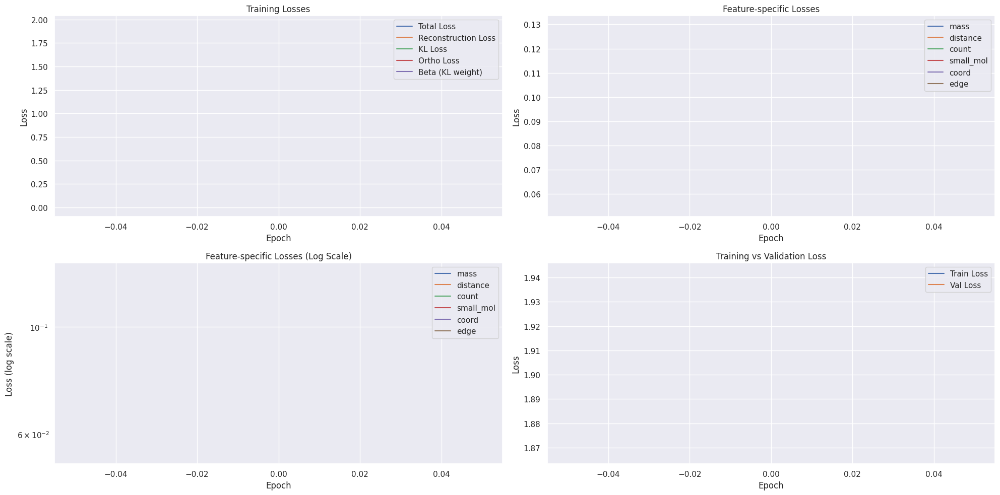

Epoch 2/100 [Train]:   7%|▋         | 3/42 [00:00<00:01, 20.97it/s, loss=1.8009, recon=0.3778, kl=0.4013, ortho=1.4230]


Detailed loss diagnostics:
Raw recon_loss: 0.3951
Raw KL loss: 0.4310
Ortho loss: 1.4229
Current beta: 0.0002
mu mean: 0.0510, std: 0.2923
logvar mean: 0.9822, std: 0.2601
mass: 0.1056
distance: 0.0999
count: 0.0435
small_mol: 0.0432
coord: 0.0347
edge: 0.0681


Epoch 2/100 [Train]:  29%|██▊       | 12/42 [00:00<00:01, 20.59it/s, loss=1.7787, recon=0.3569, kl=0.4041, ortho=1.4217]


Detailed loss diagnostics:
Raw recon_loss: 0.3854
Raw KL loss: 0.4032
Ortho loss: 1.4202
Current beta: 0.0002
mu mean: 0.0411, std: 0.2081
logvar mean: 0.9872, std: 0.2226
mass: 0.0813
distance: 0.0828
count: 0.0841
small_mol: 0.0298
coord: 0.0364
edge: 0.0709


Epoch 2/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 20.15it/s, loss=1.7435, recon=0.3219, kl=0.4171, ortho=1.4215]


Detailed loss diagnostics:
Raw recon_loss: 0.3554
Raw KL loss: 0.4278
Ortho loss: 1.4241
Current beta: 0.0002
mu mean: 0.0373, std: 0.3152
logvar mean: 0.9690, std: 0.2575
mass: 0.0931
distance: 0.0889
count: 0.0338
small_mol: 0.0385
coord: 0.0339
edge: 0.0671


Epoch 2/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 19.45it/s, loss=1.7251, recon=0.3037, kl=0.4389, ortho=1.4213]


Detailed loss diagnostics:
Raw recon_loss: 0.2731
Raw KL loss: 0.4169
Ortho loss: 1.4205
Current beta: 0.0002
mu mean: 0.0663, std: 0.3226
logvar mean: 0.9404, std: 0.2979
mass: 0.0688
distance: 0.0653
count: 0.0290
small_mol: 0.0198
coord: 0.0230
edge: 0.0672


Epoch 2/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.81it/s, loss=1.8975, recon=0.4531, kl=1.0097, ortho=1.4442]



Detailed loss diagnostics:
Raw recon_loss: 0.2828
Raw KL loss: 0.4361
Ortho loss: 1.4201
Current beta: 0.0002
mu mean: 0.0712, std: 0.3725
logvar mean: 0.9343, std: 0.3130
mass: 0.0722
distance: 0.0671
count: 0.0281
small_mol: 0.0220
coord: 0.0251
edge: 0.0682

Starting validation...


Epoch 2/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 69.16it/s]



Epoch [2/100] - Time: 2.43s
Train - Total: 1.7708, Recon: 0.3480, KL: 0.4377, Ortho: 1.4228, Beta: 0.0002
Feature Losses:
  mass_loss: 0.0870
  distance_loss: 0.0830
  count_loss: 0.0432
  small_mol_loss: 0.0317
  coord_loss: 0.0349
  edge_loss: 0.0682


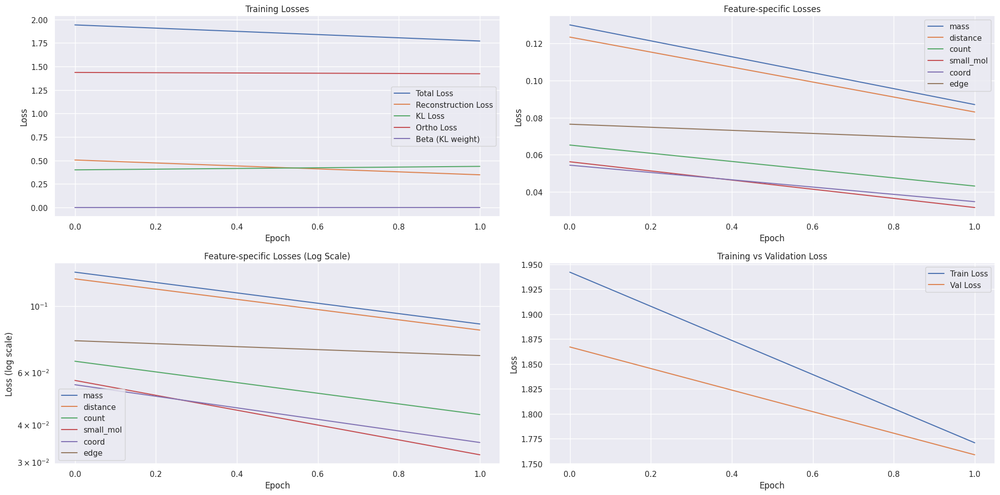

Epoch 3/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.18it/s, loss=1.7396, recon=0.3162, kl=0.4614, ortho=1.4232]


Detailed loss diagnostics:
Raw recon_loss: 0.2717
Raw KL loss: 0.5669
Ortho loss: 1.4218
Current beta: 0.0004
mu mean: 0.0914, std: 0.5869
logvar mean: 0.9137, std: 0.4045
mass: 0.0691
distance: 0.0659
count: 0.0276
small_mol: 0.0175
coord: 0.0244
edge: 0.0671


Epoch 3/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 18.06it/s, loss=1.7625, recon=0.3443, kl=0.4712, ortho=1.4180]


Detailed loss diagnostics:
Raw recon_loss: 0.3073
Raw KL loss: 0.5535
Ortho loss: 1.4236
Current beta: 0.0004
mu mean: 0.1345, std: 0.6027
logvar mean: 0.8622, std: 0.4462
mass: 0.0760
distance: 0.0742
count: 0.0278
small_mol: 0.0409
coord: 0.0208
edge: 0.0675


Epoch 3/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:01, 19.21it/s, loss=1.7091, recon=0.2895, kl=0.4884, ortho=1.4194]


Detailed loss diagnostics:
Raw recon_loss: 0.2943
Raw KL loss: 0.4800
Ortho loss: 1.4202
Current beta: 0.0004
mu mean: 0.0595, std: 0.5158
logvar mean: 0.8875, std: 0.3672
mass: 0.0756
distance: 0.0735
count: 0.0271
small_mol: 0.0315
coord: 0.0201
edge: 0.0664


Epoch 3/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 19.10it/s, loss=1.7042, recon=0.2823, kl=0.4262, ortho=1.4217]


Detailed loss diagnostics:
Raw recon_loss: 0.2814
Raw KL loss: 0.7122
Ortho loss: 1.4208
Current beta: 0.0004
mu mean: 0.1138, std: 0.8593
logvar mean: 0.7778, std: 0.5756
mass: 0.0729
distance: 0.0678
count: 0.0266
small_mol: 0.0240
coord: 0.0235
edge: 0.0666


Epoch 3/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 18.86it/s, loss=1.8438, recon=0.4046, kl=2.9074, ortho=1.4381]



Detailed loss diagnostics:
Raw recon_loss: 0.3321
Raw KL loss: 0.4805
Ortho loss: 1.4194
Current beta: 0.0004
mu mean: 0.0841, std: 0.5691
logvar mean: 0.8256, std: 0.4365
mass: 0.0935
distance: 0.0881
count: 0.0283
small_mol: 0.0299
coord: 0.0251
edge: 0.0673

Starting validation...


Epoch 3/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 65.82it/s]



Epoch [3/100] - Time: 2.55s
Train - Total: 1.7327, Recon: 0.3121, KL: 0.6468, Ortho: 1.4204, Beta: 0.0004
Feature Losses:
  mass_loss: 0.0772
  distance_loss: 0.0757
  count_loss: 0.0361
  small_mol_loss: 0.0267
  coord_loss: 0.0287
  edge_loss: 0.0679


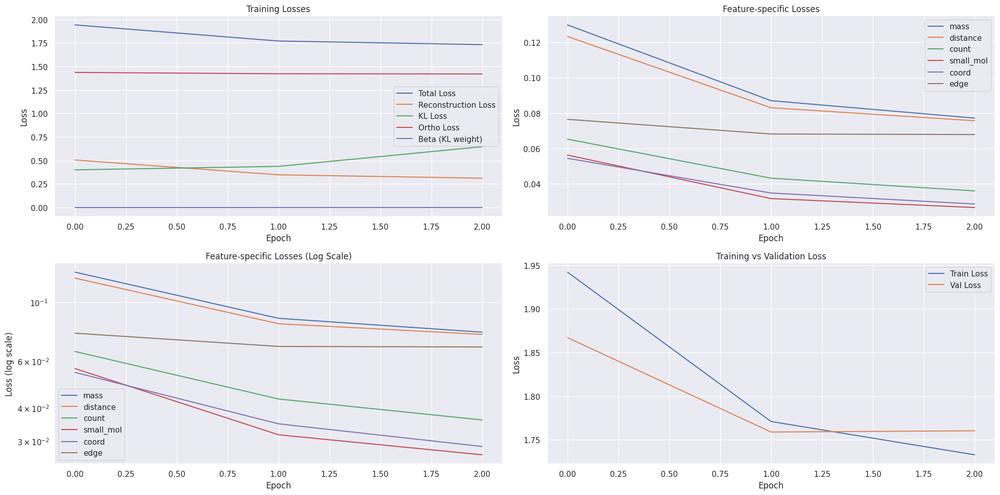

Epoch 4/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 18.21it/s, loss=1.7320, recon=0.3075, kl=2.7214, ortho=1.4229]


Detailed loss diagnostics:
Raw recon_loss: 0.7028
Raw KL loss: 0.4776
Ortho loss: 1.4201
Current beta: 0.0006
mu mean: 0.0974, std: 0.5636
logvar mean: 0.8076, std: 0.4650
mass: 0.0854
distance: 0.1250
count: 0.3511
small_mol: 0.0290
coord: 0.0387
edge: 0.0738


Epoch 4/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 19.12it/s, loss=1.6937, recon=0.2728, kl=1.1933, ortho=1.4202]


Detailed loss diagnostics:
Raw recon_loss: 0.2481
Raw KL loss: 1.0357
Ortho loss: 1.4186
Current beta: 0.0006
mu mean: 0.0927, std: 1.1729
logvar mean: 0.7610, std: 0.7185
mass: 0.0621
distance: 0.0615
count: 0.0256
small_mol: 0.0145
coord: 0.0173
edge: 0.0671


Epoch 4/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 20.39it/s, loss=1.7166, recon=0.2958, kl=0.7081, ortho=1.4203]


Detailed loss diagnostics:
Raw recon_loss: 0.2967
Raw KL loss: 0.6923
Ortho loss: 1.4202
Current beta: 0.0006
mu mean: 0.1033, std: 0.9060
logvar mean: 0.6804, std: 0.6185
mass: 0.0783
distance: 0.0763
count: 0.0266
small_mol: 0.0284
coord: 0.0201
edge: 0.0670


Epoch 4/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 19.86it/s, loss=1.7007, recon=0.2813, kl=0.9929, ortho=1.4188]


Detailed loss diagnostics:
Raw recon_loss: 0.2761
Raw KL loss: 0.8939
Ortho loss: 1.4188
Current beta: 0.0006
mu mean: 0.1221, std: 1.0692
logvar mean: 0.6181, std: 0.8901
mass: 0.0715
distance: 0.0701
count: 0.0261
small_mol: 0.0222
coord: 0.0186
edge: 0.0677


Epoch 4/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.61it/s, loss=1.8750, recon=0.4394, kl=0.6689, ortho=1.4352]



Detailed loss diagnostics:
Raw recon_loss: 0.2444
Raw KL loss: 1.1344
Ortho loss: 1.4187
Current beta: 0.0006
mu mean: 0.1497, std: 1.2891
logvar mean: 0.4344, std: 1.0221
mass: 0.0599
distance: 0.0578
count: 0.0251
small_mol: 0.0215
coord: 0.0131
edge: 0.0669

Starting validation...


Epoch 4/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 69.13it/s]



Epoch [4/100] - Time: 2.45s
Train - Total: 1.7260, Recon: 0.3059, KL: 0.9273, Ortho: 1.4196, Beta: 0.0006
Feature Losses:
  mass_loss: 0.0749
  distance_loss: 0.0758
  count_loss: 0.0410
  small_mol_loss: 0.0234
  coord_loss: 0.0230
  edge_loss: 0.0678


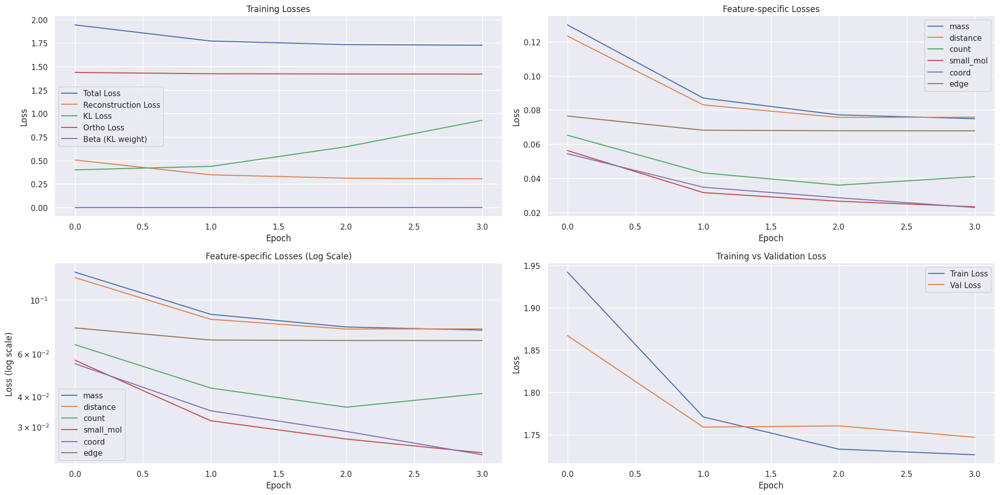

Epoch 5/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 17.45it/s, loss=1.7140, recon=0.2951, kl=0.8388, ortho=1.4183]


Detailed loss diagnostics:
Raw recon_loss: 0.2391
Raw KL loss: 0.4420
Ortho loss: 1.4206
Current beta: 0.0008
mu mean: 0.0092, std: 0.5679
logvar mean: 0.7824, std: 0.4224
mass: 0.0605
distance: 0.0596
count: 0.0253
small_mol: 0.0089
coord: 0.0176
edge: 0.0671


Epoch 5/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 20.76it/s, loss=1.7045, recon=0.2866, kl=0.7093, ortho=1.4173]


Detailed loss diagnostics:
Raw recon_loss: 0.3372
Raw KL loss: 0.8095
Ortho loss: 1.4196
Current beta: 0.0008
mu mean: 0.1342, std: 1.0370
logvar mean: 0.4478, std: 0.8983
mass: 0.0863
distance: 0.0838
count: 0.0272
small_mol: 0.0425
coord: 0.0294
edge: 0.0680


Epoch 5/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 19.98it/s, loss=1.7030, recon=0.2846, kl=1.1044, ortho=1.4175]


Detailed loss diagnostics:
Raw recon_loss: 0.2835
Raw KL loss: 0.7113
Ortho loss: 1.4199
Current beta: 0.0008
mu mean: 0.0739, std: 0.9649
logvar mean: 0.4546, std: 0.8477
mass: 0.0732
distance: 0.0706
count: 0.0262
small_mol: 0.0294
coord: 0.0173
edge: 0.0669


Epoch 5/100 [Train]:  76%|███████▌  | 32/42 [00:01<00:00, 20.33it/s, loss=1.7144, recon=0.2975, kl=1.1419, ortho=1.4160]


Detailed loss diagnostics:
Raw recon_loss: 0.3183
Raw KL loss: 0.7786
Ortho loss: 1.4149
Current beta: 0.0008
mu mean: 0.0295, std: 0.9839
logvar mean: 0.5468, std: 0.9100
mass: 0.0641
distance: 0.0702
count: 0.0730
small_mol: 0.0114
coord: 0.0287
edge: 0.0709


Epoch 5/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 20.00it/s, loss=1.8871, recon=0.4484, kl=1.1982, ortho=1.4378]



Detailed loss diagnostics:
Raw recon_loss: 0.2425
Raw KL loss: 1.2700
Ortho loss: 1.4168
Current beta: 0.0008
mu mean: 0.0804, std: 1.3855
logvar mean: 0.2890, std: 1.2483
mass: 0.0614
distance: 0.0596
count: 0.0252
small_mol: 0.0168
coord: 0.0116
edge: 0.0680

Starting validation...


Epoch 5/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 68.62it/s]



Epoch [5/100] - Time: 2.42s
Train - Total: 1.7172, Recon: 0.2980, KL: 0.9866, Ortho: 1.4184, Beta: 0.0008
Feature Losses:
  mass_loss: 0.0742
  distance_loss: 0.0739
  count_loss: 0.0370
  small_mol_loss: 0.0223
  coord_loss: 0.0230
  edge_loss: 0.0678


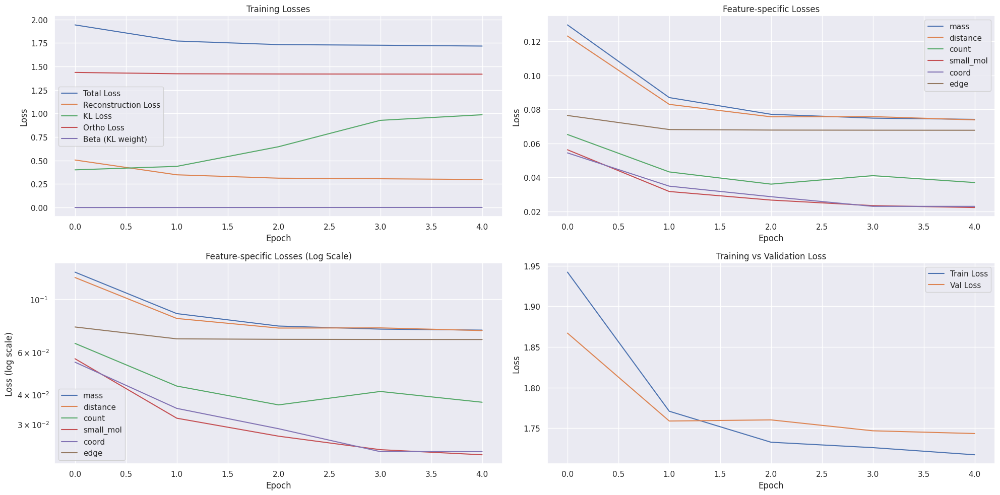

Epoch 6/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 15.38it/s, loss=1.7509, recon=0.3320, kl=1.4540, ortho=1.4174]


Detailed loss diagnostics:
Raw recon_loss: 0.2743
Raw KL loss: 0.6187
Ortho loss: 1.4183
Current beta: 0.0010
mu mean: 0.0474, std: 0.8188
logvar mean: 0.5458, std: 0.8435
mass: 0.0739
distance: 0.0716
count: 0.0262
small_mol: 0.0187
coord: 0.0169
edge: 0.0671


Epoch 6/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 19.35it/s, loss=1.9217, recon=0.5051, kl=0.3968, ortho=1.4162]


Detailed loss diagnostics:
Raw recon_loss: 0.2592
Raw KL loss: 0.8897
Ortho loss: 1.4185
Current beta: 0.0010
mu mean: -0.0405, std: 1.1131
logvar mean: 0.3603, std: 1.0126
mass: 0.0671
distance: 0.0696
count: 0.0258
small_mol: 0.0135
coord: 0.0162
edge: 0.0670


Epoch 6/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 19.45it/s, loss=1.6733, recon=0.2571, kl=1.2057, ortho=1.4150]


Detailed loss diagnostics:
Raw recon_loss: 0.4209
Raw KL loss: 0.9595
Ortho loss: 1.4146
Current beta: 0.0010
mu mean: 0.0125, std: 1.1256
logvar mean: 0.4199, std: 1.2396
mass: 0.0893
distance: 0.0979
count: 0.1254
small_mol: 0.0139
coord: 0.0220
edge: 0.0724


Epoch 6/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 20.61it/s, loss=1.7362, recon=0.3217, kl=0.8380, ortho=1.4136]


Detailed loss diagnostics:
Raw recon_loss: 0.2902
Raw KL loss: 1.2405
Ortho loss: 1.4155
Current beta: 0.0010
mu mean: -0.0082, std: 1.3699
logvar mean: 0.0675, std: 1.3624
mass: 0.0778
distance: 0.0749
count: 0.0265
small_mol: 0.0255
coord: 0.0187
edge: 0.0668


Epoch 6/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.66it/s, loss=1.7869, recon=0.3480, kl=0.5617, ortho=1.4383]



Detailed loss diagnostics:
Raw recon_loss: 0.2975
Raw KL loss: 1.1169
Ortho loss: 1.4145
Current beta: 0.0010
mu mean: 0.0039, std: 1.2298
logvar mean: 0.0939, std: 1.6060
mass: 0.0723
distance: 0.0809
count: 0.0350
small_mol: 0.0238
coord: 0.0147
edge: 0.0708

Starting validation...


Epoch 6/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 69.92it/s]



Epoch [6/100] - Time: 2.44s
Train - Total: 1.7186, Recon: 0.3002, KL: 1.0934, Ortho: 1.4173, Beta: 0.0010
Feature Losses:
  mass_loss: 0.0751
  distance_loss: 0.0753
  count_loss: 0.0392
  small_mol_loss: 0.0209
  coord_loss: 0.0221
  edge_loss: 0.0677


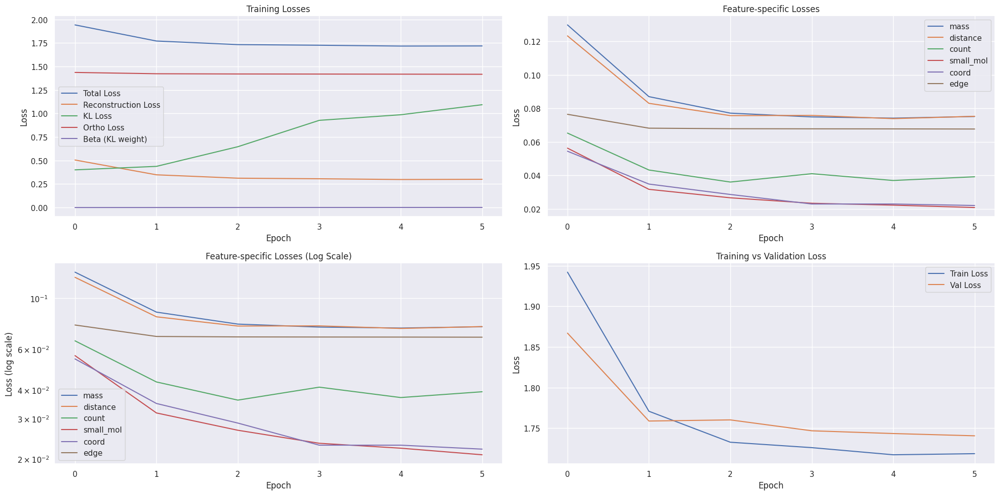

Epoch 7/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 16.68it/s, loss=1.6957, recon=0.2767, kl=1.4547, ortho=1.4172]


Detailed loss diagnostics:
Raw recon_loss: 0.2811
Raw KL loss: 1.6035
Ortho loss: 1.4152
Current beta: 0.0012
mu mean: -0.0368, std: 1.5814
logvar mean: -0.0863, std: 1.6567
mass: 0.0671
distance: 0.0630
count: 0.0255
small_mol: 0.0248
coord: 0.0331
edge: 0.0676


Epoch 7/100 [Train]:  29%|██▊       | 12/42 [00:00<00:01, 19.67it/s, loss=1.8575, recon=0.4407, kl=0.7701, ortho=1.4159]


Detailed loss diagnostics:
Raw recon_loss: 0.2668
Raw KL loss: 0.8204
Ortho loss: 1.4159
Current beta: 0.0012
mu mean: -0.0299, std: 1.0448
logvar mean: 0.0517, std: 1.2690
mass: 0.0655
distance: 0.0651
count: 0.0255
small_mol: 0.0160
coord: 0.0268
edge: 0.0679


Epoch 7/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 19.25it/s, loss=1.7025, recon=0.2840, kl=2.6971, ortho=1.4153]


Detailed loss diagnostics:
Raw recon_loss: 0.2842
Raw KL loss: 1.0605
Ortho loss: 1.4143
Current beta: 0.0012
mu mean: -0.0061, std: 1.2130
logvar mean: 0.0521, std: 1.4123
mass: 0.0766
distance: 0.0742
count: 0.0263
small_mol: 0.0242
coord: 0.0155
edge: 0.0673


Epoch 7/100 [Train]:  76%|███████▌  | 32/42 [00:01<00:00, 19.65it/s, loss=1.7791, recon=0.3656, kl=0.5611, ortho=1.4129]


Detailed loss diagnostics:
Raw recon_loss: 0.2799
Raw KL loss: 0.8404
Ortho loss: 1.4148
Current beta: 0.0012
mu mean: -0.0289, std: 1.0216
logvar mean: -0.0116, std: 1.5928
mass: 0.0747
distance: 0.0742
count: 0.0261
small_mol: 0.0211
coord: 0.0159
edge: 0.0679


Epoch 7/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.49it/s, loss=1.7514, recon=0.3254, kl=0.2166, ortho=1.4257]



Detailed loss diagnostics:
Raw recon_loss: 0.2414
Raw KL loss: 1.1015
Ortho loss: 1.4143
Current beta: 0.0012
mu mean: -0.0238, std: 1.2421
logvar mean: 0.0309, std: 1.5739
mass: 0.0617
distance: 0.0615
count: 0.0252
small_mol: 0.0104
coord: 0.0163
edge: 0.0663

Starting validation...


Epoch 7/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 67.62it/s]



Epoch [7/100] - Time: 2.48s
Train - Total: 1.7096, Recon: 0.2930, KL: 0.9518, Ortho: 1.4155, Beta: 0.0012
Feature Losses:
  mass_loss: 0.0742
  distance_loss: 0.0738
  count_loss: 0.0369
  small_mol_loss: 0.0203
  coord_loss: 0.0202
  edge_loss: 0.0676


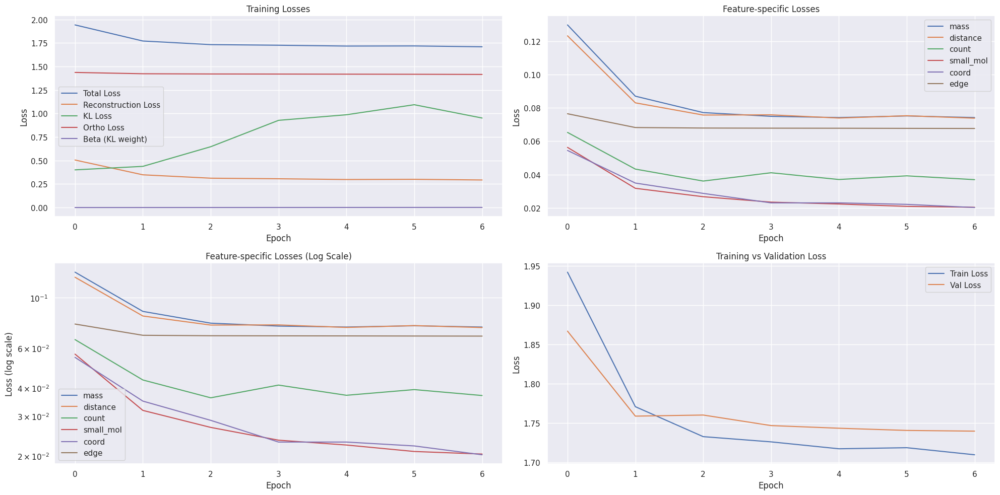

Epoch 8/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 17.96it/s, loss=1.6822, recon=0.2660, kl=0.8420, ortho=1.4150]


Detailed loss diagnostics:
Raw recon_loss: 0.2466
Raw KL loss: 0.7934
Ortho loss: 1.4199
Current beta: 0.0014
mu mean: -0.0244, std: 1.0189
logvar mean: -0.0568, std: 1.3834
mass: 0.0629
distance: 0.0614
count: 0.0252
small_mol: 0.0176
coord: 0.0125
edge: 0.0670


Epoch 8/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 19.13it/s, loss=1.9350, recon=0.5220, kl=0.6085, ortho=1.4122]


Detailed loss diagnostics:
Raw recon_loss: 0.3073
Raw KL loss: 1.3095
Ortho loss: 1.4141
Current beta: 0.0014
mu mean: 0.0245, std: 1.2958
logvar mean: -0.2824, std: 2.2331
mass: 0.0785
distance: 0.0850
count: 0.0350
small_mol: 0.0163
coord: 0.0243
edge: 0.0682


Epoch 8/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 20.13it/s, loss=1.6912, recon=0.2748, kl=0.9659, ortho=1.4150]


Detailed loss diagnostics:
Raw recon_loss: 0.2656
Raw KL loss: 1.1679
Ortho loss: 1.4142
Current beta: 0.0014
mu mean: 0.0023, std: 1.2552
logvar mean: -0.1678, std: 1.7721
mass: 0.0695
distance: 0.0687
count: 0.0258
small_mol: 0.0130
coord: 0.0220
edge: 0.0667


Epoch 8/100 [Train]:  76%|███████▌  | 32/42 [00:01<00:00, 20.80it/s, loss=1.7535, recon=0.3381, kl=0.4900, ortho=1.4147]


Detailed loss diagnostics:
Raw recon_loss: 0.3132
Raw KL loss: 2.0223
Ortho loss: 1.4127
Current beta: 0.0014
mu mean: -0.0804, std: 1.7460
logvar mean: -0.7242, std: 2.6628
mass: 0.0782
distance: 0.0741
count: 0.0263
small_mol: 0.0199
coord: 0.0467
edge: 0.0680


Epoch 8/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.78it/s, loss=1.8254, recon=0.3915, kl=0.2293, ortho=1.4336]



Detailed loss diagnostics:
Raw recon_loss: 0.2912
Raw KL loss: 0.6749
Ortho loss: 1.4143
Current beta: 0.0014
mu mean: -0.0259, std: 0.8504
logvar mean: -0.4352, std: 1.5635
mass: 0.0762
distance: 0.0732
count: 0.0262
small_mol: 0.0317
coord: 0.0166
edge: 0.0674

Starting validation...


Epoch 8/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 66.65it/s]



Epoch [8/100] - Time: 2.45s
Train - Total: 1.7172, Recon: 0.3013, KL: 0.8690, Ortho: 1.4147, Beta: 0.0014
Feature Losses:
  mass_loss: 0.0743
  distance_loss: 0.0752
  count_loss: 0.0417
  small_mol_loss: 0.0206
  coord_loss: 0.0218
  edge_loss: 0.0677


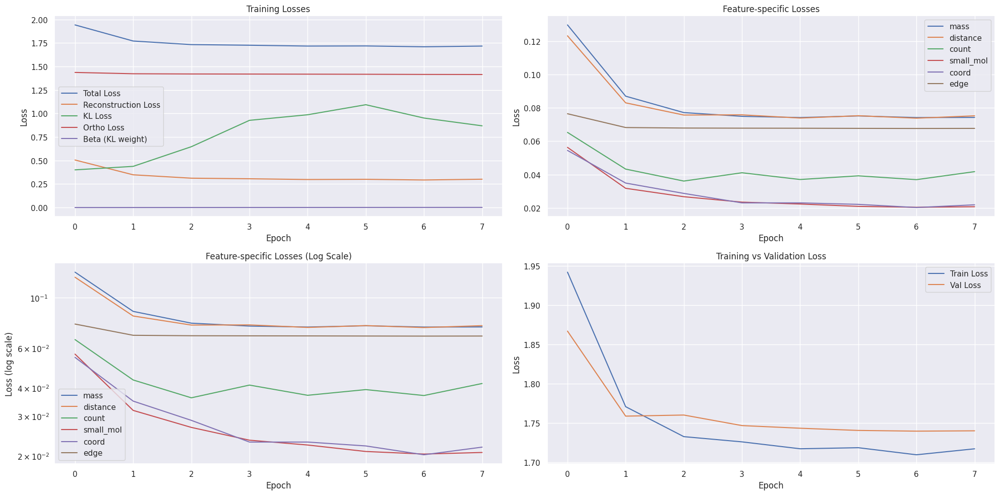

Epoch 9/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 17.87it/s, loss=1.6774, recon=0.2596, kl=1.3046, ortho=1.4157]


Detailed loss diagnostics:
Raw recon_loss: 0.2873
Raw KL loss: 0.4809
Ortho loss: 1.4127
Current beta: 0.0016
mu mean: -0.0016, std: 0.6666
logvar mean: 0.0583, std: 1.2874
mass: 0.0769
distance: 0.0711
count: 0.0261
small_mol: 0.0267
coord: 0.0193
edge: 0.0671


Epoch 9/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 20.00it/s, loss=1.6900, recon=0.2761, kl=1.1522, ortho=1.4121]


Detailed loss diagnostics:
Raw recon_loss: 0.2772
Raw KL loss: 0.6654
Ortho loss: 1.4178
Current beta: 0.0016
mu mean: 0.0113, std: 0.8291
logvar mean: -0.3750, std: 1.4799
mass: 0.0724
distance: 0.0686
count: 0.0258
small_mol: 0.0280
coord: 0.0156
edge: 0.0668


Epoch 9/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 19.94it/s, loss=1.8893, recon=0.4758, kl=0.4562, ortho=1.4128]


Detailed loss diagnostics:
Raw recon_loss: 0.2415
Raw KL loss: 0.8232
Ortho loss: 1.4148
Current beta: 0.0016
mu mean: -0.0709, std: 0.9263
logvar mean: -0.6040, std: 1.8169
mass: 0.0603
distance: 0.0602
count: 0.0251
small_mol: 0.0148
coord: 0.0143
edge: 0.0668


Epoch 9/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 19.18it/s, loss=1.6656, recon=0.2514, kl=0.5669, ortho=1.4133]


Detailed loss diagnostics:
Raw recon_loss: 0.3260
Raw KL loss: 0.5265
Ortho loss: 1.4135
Current beta: 0.0016
mu mean: -0.0294, std: 0.6663
logvar mean: -0.3010, std: 1.5899
mass: 0.0875
distance: 0.0824
count: 0.0268
small_mol: 0.0404
coord: 0.0200
edge: 0.0689


Epoch 9/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.64it/s, loss=2.0684, recon=0.6277, kl=2.5854, ortho=1.4366]



Detailed loss diagnostics:
Raw recon_loss: 0.3525
Raw KL loss: 1.2709
Ortho loss: 1.4138
Current beta: 0.0016
mu mean: -0.0609, std: 1.2498
logvar mean: -1.0060, std: 2.1125
mass: 0.0706
distance: 0.0854
count: 0.0958
small_mol: 0.0153
coord: 0.0161
edge: 0.0694

Starting validation...


Epoch 9/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 67.22it/s]



Epoch [9/100] - Time: 2.46s
Train - Total: 1.7170, Recon: 0.3008, KL: 0.9341, Ortho: 1.4147, Beta: 0.0016
Feature Losses:
  mass_loss: 0.0783
  distance_loss: 0.0749
  count_loss: 0.0372
  small_mol_loss: 0.0226
  coord_loss: 0.0201
  edge_loss: 0.0677


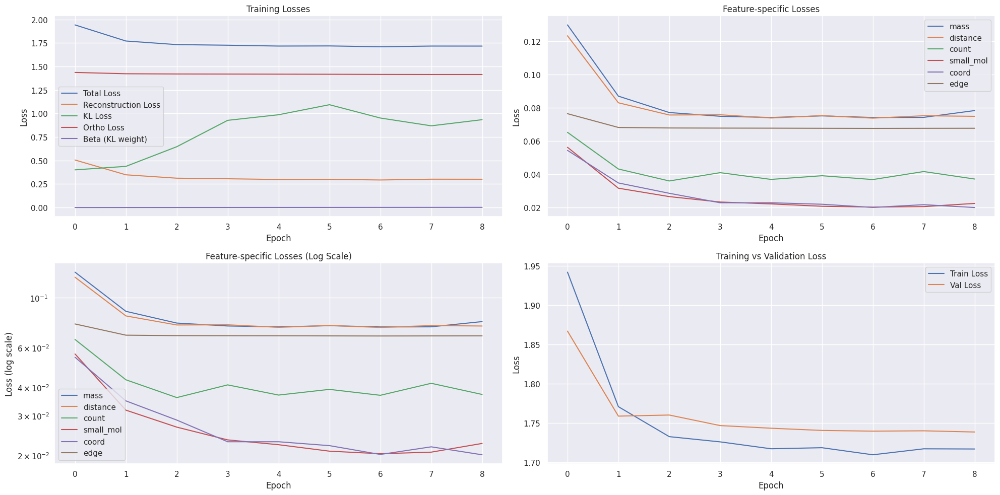

Epoch 10/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.50it/s, loss=1.7248, recon=0.3039, kl=0.3881, ortho=1.4202]


Detailed loss diagnostics:
Raw recon_loss: 0.3358
Raw KL loss: 1.9546
Ortho loss: 1.4125
Current beta: 0.0018
mu mean: -0.0371, std: 1.6260
logvar mean: -1.1434, std: 2.8958
mass: 0.0881
distance: 0.0858
count: 0.0270
small_mol: 0.0265
coord: 0.0407
edge: 0.0678


Epoch 10/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 18.95it/s, loss=1.6737, recon=0.2572, kl=0.5872, ortho=1.4155]


Detailed loss diagnostics:
Raw recon_loss: 0.2863
Raw KL loss: 0.6651
Ortho loss: 1.4167
Current beta: 0.0018
mu mean: -0.0544, std: 0.8372
logvar mean: -0.1767, std: 1.5984
mass: 0.0757
distance: 0.0772
count: 0.0264
small_mol: 0.0214
coord: 0.0188
edge: 0.0669


Epoch 10/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:01, 18.54it/s, loss=1.6784, recon=0.2639, kl=0.8261, ortho=1.4129]


Detailed loss diagnostics:
Raw recon_loss: 0.2758
Raw KL loss: 0.7517
Ortho loss: 1.4187
Current beta: 0.0018
mu mean: 0.0182, std: 0.9632
logvar mean: -0.0336, std: 1.3532
mass: 0.0775
distance: 0.0781
count: 0.0265
small_mol: 0.0128
coord: 0.0142
edge: 0.0666


Epoch 10/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 20.08it/s, loss=1.6903, recon=0.2761, kl=0.9316, ortho=1.4125]


Detailed loss diagnostics:
Raw recon_loss: 0.3528
Raw KL loss: 0.7313
Ortho loss: 1.4135
Current beta: 0.0018
mu mean: -0.0626, std: 0.9340
logvar mean: -0.3954, std: 1.4746
mass: 0.0922
distance: 0.0837
count: 0.0271
small_mol: 0.0354
coord: 0.0473
edge: 0.0670


Epoch 10/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.67it/s, loss=1.8685, recon=0.4319, kl=0.6220, ortho=1.4355]



Detailed loss diagnostics:
Raw recon_loss: 0.2668
Raw KL loss: 1.1066
Ortho loss: 1.4154
Current beta: 0.0018
mu mean: -0.0726, std: 1.2188
logvar mean: -0.6514, std: 1.7119
mass: 0.0676
distance: 0.0674
count: 0.0256
small_mol: 0.0213
coord: 0.0178
edge: 0.0672

Starting validation...


Epoch 10/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 67.67it/s]



Epoch [10/100] - Time: 2.45s
Train - Total: 1.7118, Recon: 0.2950, KL: 0.8443, Ortho: 1.4153, Beta: 0.0018
Feature Losses:
  mass_loss: 0.0747
  distance_loss: 0.0743
  count_loss: 0.0371
  small_mol_loss: 0.0212
  coord_loss: 0.0202
  edge_loss: 0.0676


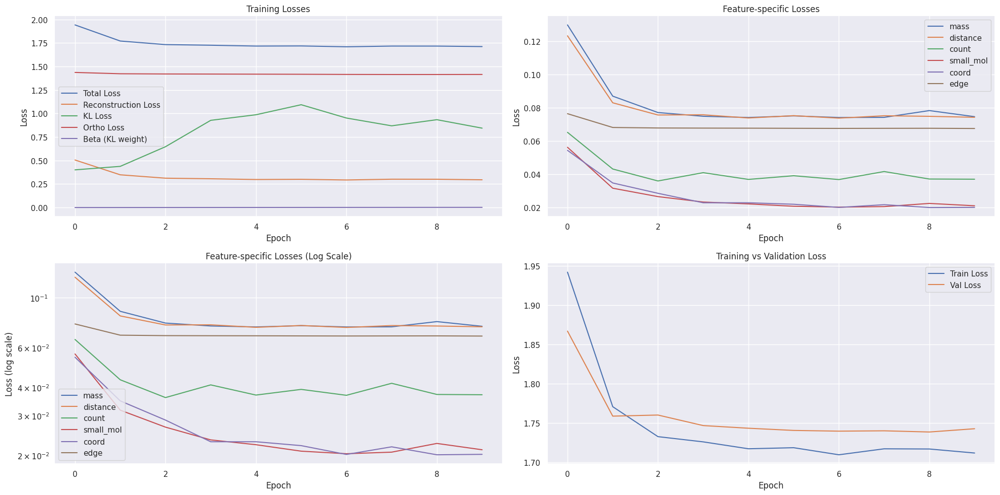

Epoch 11/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 16.95it/s, loss=1.6626, recon=0.2481, kl=1.0165, ortho=1.4125]


Detailed loss diagnostics:
Raw recon_loss: 0.2548
Raw KL loss: 0.8144
Ortho loss: 1.4137
Current beta: 0.0020
mu mean: -0.0366, std: 0.9385
logvar mean: -0.5188, std: 1.8799
mass: 0.0614
distance: 0.0596
count: 0.0251
small_mol: 0.0140
coord: 0.0275
edge: 0.0673


Epoch 11/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 19.70it/s, loss=1.6954, recon=0.2805, kl=0.6860, ortho=1.4135]


Detailed loss diagnostics:
Raw recon_loss: 0.2728
Raw KL loss: 0.5513
Ortho loss: 1.4132
Current beta: 0.0020
mu mean: -0.0237, std: 0.7750
logvar mean: -0.1554, std: 1.3885
mass: 0.0742
distance: 0.0706
count: 0.0260
small_mol: 0.0170
coord: 0.0172
edge: 0.0678


Epoch 11/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 19.85it/s, loss=1.7210, recon=0.3043, kl=1.7129, ortho=1.4133]


Detailed loss diagnostics:
Raw recon_loss: 0.2821
Raw KL loss: 0.8165
Ortho loss: 1.4131
Current beta: 0.0020
mu mean: -0.0239, std: 1.0054
logvar mean: -0.6004, std: 1.5989
mass: 0.0766
distance: 0.0755
count: 0.0263
small_mol: 0.0210
coord: 0.0163
edge: 0.0663


Epoch 11/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 19.20it/s, loss=1.7172, recon=0.3034, kl=0.8039, ortho=1.4122]


Detailed loss diagnostics:
Raw recon_loss: 0.2354
Raw KL loss: 0.5141
Ortho loss: 1.4117
Current beta: 0.0020
mu mean: 0.0268, std: 0.7294
logvar mean: -0.1079, std: 1.3501
mass: 0.0610
distance: 0.0598
count: 0.0251
small_mol: 0.0141
coord: 0.0104
edge: 0.0651


Epoch 11/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.16it/s, loss=1.8032, recon=0.3768, kl=0.1527, ortho=1.4261]



Detailed loss diagnostics:
Raw recon_loss: 0.3490
Raw KL loss: 0.4561
Ortho loss: 1.4150
Current beta: 0.0020
mu mean: -0.0629, std: 0.6400
logvar mean: -0.4612, std: 1.2091
mass: 0.0690
distance: 0.0807
count: 0.0920
small_mol: 0.0205
coord: 0.0161
edge: 0.0708

Starting validation...


Epoch 11/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 65.71it/s]



Epoch [11/100] - Time: 2.52s
Train - Total: 1.7074, Recon: 0.2925, KL: 0.6784, Ortho: 1.4135, Beta: 0.0020
Feature Losses:
  mass_loss: 0.0743
  distance_loss: 0.0740
  count_loss: 0.0356
  small_mol_loss: 0.0204
  coord_loss: 0.0205
  edge_loss: 0.0676


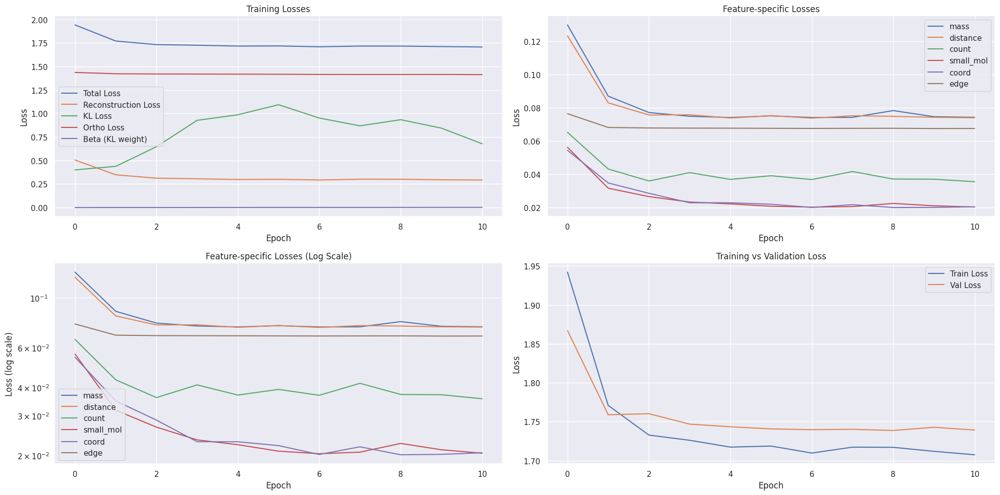

Epoch 12/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 16.04it/s, loss=1.7322, recon=0.3165, kl=0.6830, ortho=1.4142]


Detailed loss diagnostics:
Raw recon_loss: 0.2612
Raw KL loss: 0.6143
Ortho loss: 1.4119
Current beta: 0.0022
mu mean: -0.0305, std: 0.7824
logvar mean: -0.5746, std: 1.4774
mass: 0.0670
distance: 0.0649
count: 0.0255
small_mol: 0.0187
coord: 0.0174
edge: 0.0677


Epoch 12/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 19.27it/s, loss=1.6660, recon=0.2500, kl=0.7799, ortho=1.4143]


Detailed loss diagnostics:
Raw recon_loss: 0.3181
Raw KL loss: 0.6007
Ortho loss: 1.4129
Current beta: 0.0022
mu mean: 0.0112, std: 0.7945
logvar mean: -0.4381, std: 1.4409
mass: 0.0924
distance: 0.0886
count: 0.0273
small_mol: 0.0237
coord: 0.0195
edge: 0.0666


Epoch 12/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 19.52it/s, loss=1.7533, recon=0.3389, kl=0.7281, ortho=1.4128]


Detailed loss diagnostics:
Raw recon_loss: 0.3172
Raw KL loss: 0.6464
Ortho loss: 1.4147
Current beta: 0.0022
mu mean: -0.0185, std: 0.7398
logvar mean: -0.8823, std: 1.7296
mass: 0.0869
distance: 0.0763
count: 0.0266
small_mol: 0.0376
coord: 0.0218
edge: 0.0680


Epoch 12/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 19.07it/s, loss=1.6898, recon=0.2749, kl=0.5441, ortho=1.4137]


Detailed loss diagnostics:
Raw recon_loss: 0.2799
Raw KL loss: 0.9824
Ortho loss: 1.4133
Current beta: 0.0022
mu mean: 0.0150, std: 1.0156
logvar mean: -0.9415, std: 2.0456
mass: 0.0696
distance: 0.0756
count: 0.0317
small_mol: 0.0190
coord: 0.0153
edge: 0.0687


Epoch 12/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.21it/s, loss=1.7045, recon=0.2700, kl=0.5873, ortho=1.4332]



Detailed loss diagnostics:
Raw recon_loss: 0.2730
Raw KL loss: 0.8009
Ortho loss: 1.4129
Current beta: 0.0022
mu mean: -0.0187, std: 0.7979
logvar mean: -0.9230, std: 2.1454
mass: 0.0721
distance: 0.0684
count: 0.0258
small_mol: 0.0220
coord: 0.0178
edge: 0.0670

Starting validation...


Epoch 12/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 67.94it/s]



Epoch [12/100] - Time: 2.50s
Train - Total: 1.7072, Recon: 0.2917, KL: 0.8181, Ortho: 1.4138, Beta: 0.0022
Feature Losses:
  mass_loss: 0.0745
  distance_loss: 0.0746
  count_loss: 0.0365
  small_mol_loss: 0.0198
  coord_loss: 0.0186
  edge_loss: 0.0676


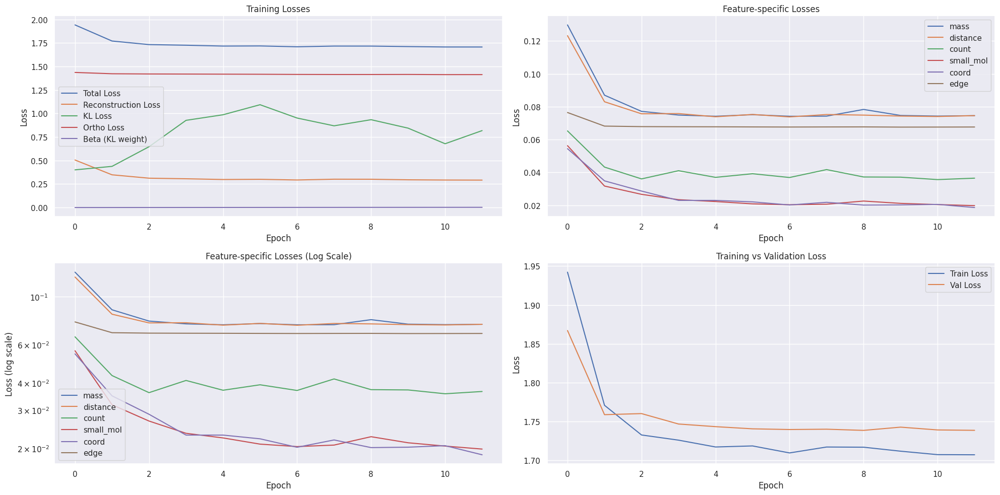

Epoch 13/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.33it/s, loss=1.7172, recon=0.3034, kl=0.4534, ortho=1.4128]


Detailed loss diagnostics:
Raw recon_loss: 0.2772
Raw KL loss: 0.6052
Ortho loss: 1.4114
Current beta: 0.0024
mu mean: -0.0200, std: 0.7271
logvar mean: -0.7270, std: 1.5168
mass: 0.0770
distance: 0.0728
count: 0.0261
small_mol: 0.0207
coord: 0.0135
edge: 0.0671


Epoch 13/100 [Train]:  29%|██▊       | 12/42 [00:00<00:01, 19.58it/s, loss=1.6979, recon=0.2834, kl=0.5207, ortho=1.4133]


Detailed loss diagnostics:
Raw recon_loss: 0.2855
Raw KL loss: 0.9336
Ortho loss: 1.4162
Current beta: 0.0024
mu mean: -0.0007, std: 1.1297
logvar mean: -0.3301, std: 1.8898
mass: 0.0752
distance: 0.0736
count: 0.0261
small_mol: 0.0132
coord: 0.0298
edge: 0.0677


Epoch 13/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:01, 18.54it/s, loss=1.6542, recon=0.2387, kl=0.5469, ortho=1.4141]


Detailed loss diagnostics:
Raw recon_loss: 0.2863
Raw KL loss: 1.4815
Ortho loss: 1.4136
Current beta: 0.0024
mu mean: 0.0323, std: 1.3544
logvar mean: -1.2686, std: 2.4789
mass: 0.0760
distance: 0.0694
count: 0.0258
small_mol: 0.0190
coord: 0.0299
edge: 0.0663


Epoch 13/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 19.84it/s, loss=1.7020, recon=0.2884, kl=0.2684, ortho=1.4130]


Detailed loss diagnostics:
Raw recon_loss: 0.2820
Raw KL loss: 0.6863
Ortho loss: 1.4127
Current beta: 0.0024
mu mean: -0.0450, std: 0.7601
logvar mean: -0.9071, std: 1.7545
mass: 0.0755
distance: 0.0750
count: 0.0262
small_mol: 0.0222
coord: 0.0161
edge: 0.0671


Epoch 13/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.44it/s, loss=1.7748, recon=0.3456, kl=1.5072, ortho=1.4256]



Detailed loss diagnostics:
Raw recon_loss: 0.2791
Raw KL loss: 0.5065
Ortho loss: 1.4128
Current beta: 0.0024
mu mean: -0.0151, std: 0.7021
logvar mean: -0.5226, std: 1.2949
mass: 0.0759
distance: 0.0710
count: 0.0261
small_mol: 0.0233
coord: 0.0144
edge: 0.0685

Starting validation...


Epoch 13/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 70.05it/s]



Epoch [13/100] - Time: 2.47s
Train - Total: 1.7083, Recon: 0.2931, KL: 0.6975, Ortho: 1.4135, Beta: 0.0024
Feature Losses:
  mass_loss: 0.0736
  distance_loss: 0.0739
  count_loss: 0.0391
  small_mol_loss: 0.0189
  coord_loss: 0.0199
  edge_loss: 0.0676


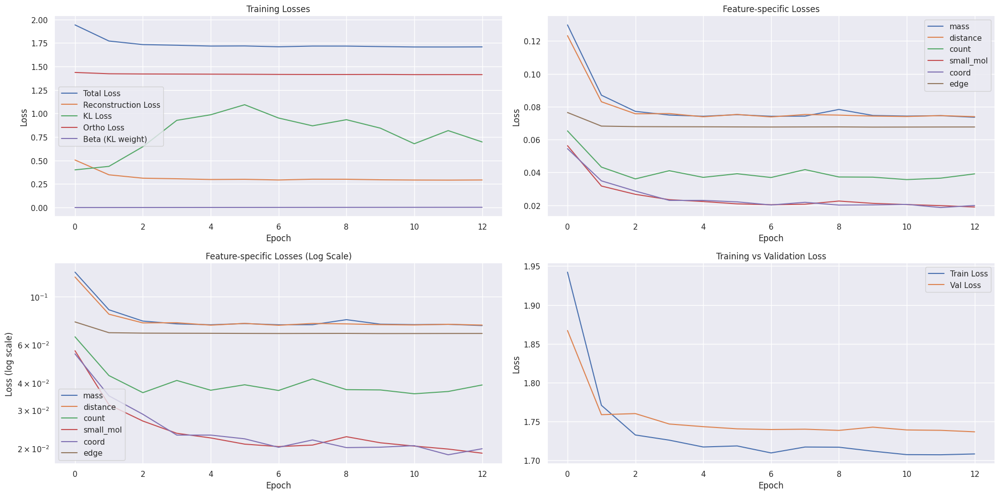

Epoch 14/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 18.58it/s, loss=1.7286, recon=0.3123, kl=0.8666, ortho=1.4140]


Detailed loss diagnostics:
Raw recon_loss: 0.2688
Raw KL loss: 0.5735
Ortho loss: 1.4131
Current beta: 0.0026
mu mean: -0.0317, std: 0.7664
logvar mean: -0.8173, std: 1.3176
mass: 0.0713
distance: 0.0686
count: 0.0258
small_mol: 0.0180
coord: 0.0183
edge: 0.0668


Epoch 14/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 19.81it/s, loss=1.7440, recon=0.3300, kl=0.5249, ortho=1.4127]


Detailed loss diagnostics:
Raw recon_loss: 0.2745
Raw KL loss: 0.7998
Ortho loss: 1.4130
Current beta: 0.0026
mu mean: 0.0215, std: 0.8883
logvar mean: -0.9322, std: 1.8369
mass: 0.0737
distance: 0.0728
count: 0.0261
small_mol: 0.0201
coord: 0.0149
edge: 0.0669


Epoch 14/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 19.84it/s, loss=1.6655, recon=0.2516, kl=0.7901, ortho=1.4119]


Detailed loss diagnostics:
Raw recon_loss: 0.3733
Raw KL loss: 0.5582
Ortho loss: 1.4111
Current beta: 0.0026
mu mean: -0.0691, std: 0.7083
logvar mean: -0.7275, std: 1.3694
mass: 0.0708
distance: 0.0867
count: 0.1159
small_mol: 0.0156
coord: 0.0121
edge: 0.0723


Epoch 14/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 18.81it/s, loss=1.6805, recon=0.2657, kl=0.6848, ortho=1.4131]


Detailed loss diagnostics:
Raw recon_loss: 0.2573
Raw KL loss: 0.5242
Ortho loss: 1.4130
Current beta: 0.0026
mu mean: -0.0221, std: 0.5994
logvar mean: -0.8443, std: 1.3649
mass: 0.0627
distance: 0.0635
count: 0.0252
small_mol: 0.0132
coord: 0.0245
edge: 0.0681


Epoch 14/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.68it/s, loss=1.9146, recon=0.4734, kl=0.1146, ortho=1.4408]



Detailed loss diagnostics:
Raw recon_loss: 0.2827
Raw KL loss: 0.4676
Ortho loss: 1.4118
Current beta: 0.0026
mu mean: 0.0118, std: 0.5658
logvar mean: -0.6172, std: 1.4965
mass: 0.0789
distance: 0.0742
count: 0.0263
small_mol: 0.0197
coord: 0.0161
edge: 0.0675

Starting validation...


Epoch 14/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 67.44it/s]



Epoch [14/100] - Time: 2.45s
Train - Total: 1.7059, Recon: 0.2905, KL: 0.6683, Ortho: 1.4137, Beta: 0.0026
Feature Losses:
  mass_loss: 0.0740
  distance_loss: 0.0751
  count_loss: 0.0369
  small_mol_loss: 0.0183
  coord_loss: 0.0187
  edge_loss: 0.0676


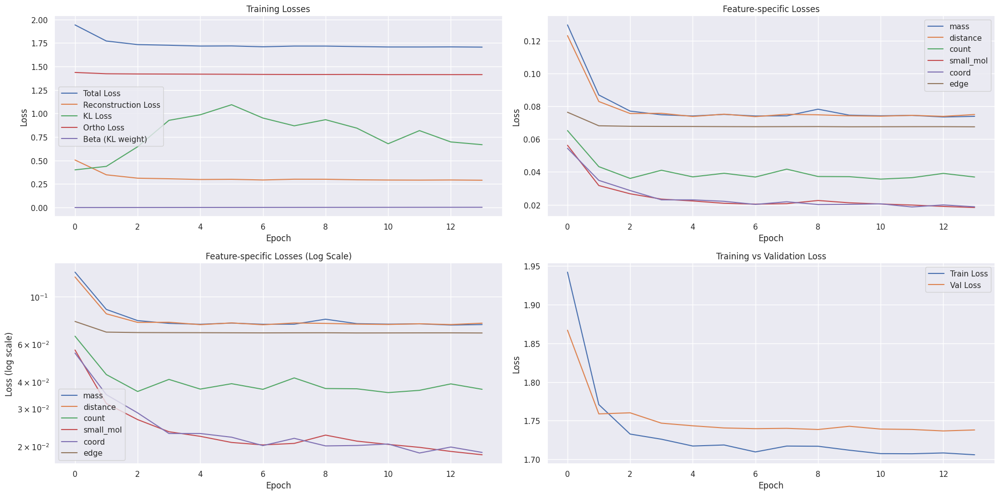

Epoch 15/100 [Train]:   7%|▋         | 3/42 [00:00<00:01, 19.85it/s, loss=1.6935, recon=0.2782, kl=0.7358, ortho=1.4132]


Detailed loss diagnostics:
Raw recon_loss: 0.2782
Raw KL loss: 0.7647
Ortho loss: 1.4126
Current beta: 0.0028
mu mean: 0.0160, std: 0.7583
logvar mean: -1.3079, std: 1.7582
mass: 0.0729
distance: 0.0699
count: 0.0258
small_mol: 0.0277
coord: 0.0150
edge: 0.0671


Epoch 15/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 19.49it/s, loss=1.7195, recon=0.3057, kl=0.5474, ortho=1.4123]


Detailed loss diagnostics:
Raw recon_loss: 0.3978
Raw KL loss: 0.7365
Ortho loss: 1.4131
Current beta: 0.0028
mu mean: -0.0319, std: 0.9322
logvar mean: -0.8527, std: 1.1909
mass: 0.0758
distance: 0.0931
count: 0.1228
small_mol: 0.0199
coord: 0.0155
edge: 0.0707


Epoch 15/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 19.79it/s, loss=1.6556, recon=0.2388, kl=0.6344, ortho=1.4150]


Detailed loss diagnostics:
Raw recon_loss: 0.2922
Raw KL loss: 0.6106
Ortho loss: 1.4123
Current beta: 0.0028
mu mean: -0.0332, std: 0.7111
logvar mean: -0.9644, std: 1.6338
mass: 0.0805
distance: 0.0766
count: 0.0264
small_mol: 0.0231
coord: 0.0181
edge: 0.0675


Epoch 15/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 20.09it/s, loss=1.7268, recon=0.3133, kl=0.3494, ortho=1.4125]


Detailed loss diagnostics:
Raw recon_loss: 0.2631
Raw KL loss: 0.5154
Ortho loss: 1.4126
Current beta: 0.0028
mu mean: -0.0147, std: 0.6773
logvar mean: -0.7742, std: 1.1783
mass: 0.0683
distance: 0.0692
count: 0.0257
small_mol: 0.0196
coord: 0.0132
edge: 0.0671


Epoch 15/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.62it/s, loss=1.7068, recon=0.2796, kl=0.4434, ortho=1.4260]



Detailed loss diagnostics:
Raw recon_loss: 0.2553
Raw KL loss: 0.7240
Ortho loss: 1.4127
Current beta: 0.0028
mu mean: -0.0525, std: 0.7228
logvar mean: -1.3373, std: 1.6758
mass: 0.0630
distance: 0.0611
count: 0.0252
small_mol: 0.0167
coord: 0.0217
edge: 0.0677

Starting validation...


Epoch 15/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 67.79it/s]



Epoch [15/100] - Time: 2.46s
Train - Total: 1.7071, Recon: 0.2920, KL: 0.6326, Ortho: 1.4133, Beta: 0.0028
Feature Losses:
  mass_loss: 0.0745
  distance_loss: 0.0743
  count_loss: 0.0377
  small_mol_loss: 0.0188
  coord_loss: 0.0191
  edge_loss: 0.0676


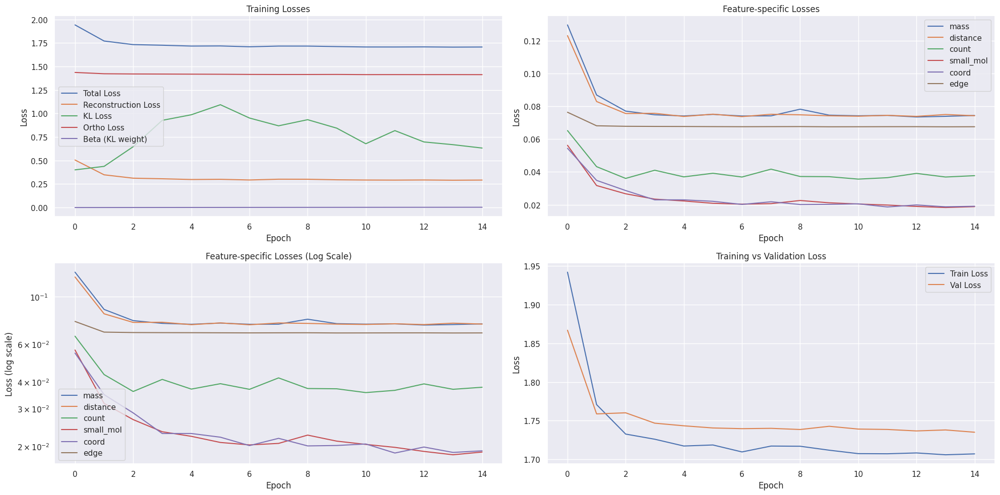

Epoch 16/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 18.12it/s, loss=1.6900, recon=0.2767, kl=0.5084, ortho=1.4118]


Detailed loss diagnostics:
Raw recon_loss: 0.2720
Raw KL loss: 0.6789
Ortho loss: 1.4134
Current beta: 0.0030
mu mean: -0.0227, std: 0.7626
logvar mean: -0.9802, std: 1.6003
mass: 0.0716
distance: 0.0732
count: 0.0260
small_mol: 0.0216
coord: 0.0123
edge: 0.0673


Epoch 16/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 19.60it/s, loss=1.6921, recon=0.2788, kl=0.4395, ortho=1.4120]


Detailed loss diagnostics:
Raw recon_loss: 0.2860
Raw KL loss: 0.6565
Ortho loss: 1.4125
Current beta: 0.0030
mu mean: -0.0139, std: 0.7902
logvar mean: -0.8903, std: 1.5217
mass: 0.0800
distance: 0.0752
count: 0.0264
small_mol: 0.0149
coord: 0.0227
edge: 0.0668


Epoch 16/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 19.10it/s, loss=1.6796, recon=0.2657, kl=0.8530, ortho=1.4113]


Detailed loss diagnostics:
Raw recon_loss: 0.2891
Raw KL loss: 0.4965
Ortho loss: 1.4115
Current beta: 0.0030
mu mean: -0.0090, std: 0.6484
logvar mean: -0.7605, std: 1.2710
mass: 0.0610
distance: 0.0688
count: 0.0628
small_mol: 0.0132
coord: 0.0125
edge: 0.0708


Epoch 16/100 [Train]:  76%|███████▌  | 32/42 [00:01<00:00, 16.50it/s, loss=1.7036, recon=0.2887, kl=0.7801, ortho=1.4125]


Detailed loss diagnostics:
Raw recon_loss: 0.2555
Raw KL loss: 0.3852
Ortho loss: 1.4113
Current beta: 0.0030
mu mean: -0.0513, std: 0.5988
logvar mean: -0.6443, std: 0.9644
mass: 0.0651
distance: 0.0617
count: 0.0252
small_mol: 0.0117
coord: 0.0242
edge: 0.0676


Epoch 16/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 18.66it/s, loss=1.7907, recon=0.3598, kl=0.3234, ortho=1.4300]



Detailed loss diagnostics:
Raw recon_loss: 0.3352
Raw KL loss: 0.4721
Ortho loss: 1.4132
Current beta: 0.0030
mu mean: -0.0038, std: 0.6028
logvar mean: -0.6785, std: 1.4418
mass: 0.0964
distance: 0.0968
count: 0.0278
small_mol: 0.0263
coord: 0.0207
edge: 0.0672

Starting validation...


Epoch 16/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 69.68it/s]



Epoch [16/100] - Time: 2.56s
Train - Total: 1.7041, Recon: 0.2895, KL: 0.6045, Ortho: 1.4128, Beta: 0.0030
Feature Losses:
  mass_loss: 0.0750
  distance_loss: 0.0743
  count_loss: 0.0346
  small_mol_loss: 0.0193
  coord_loss: 0.0187
  edge_loss: 0.0676


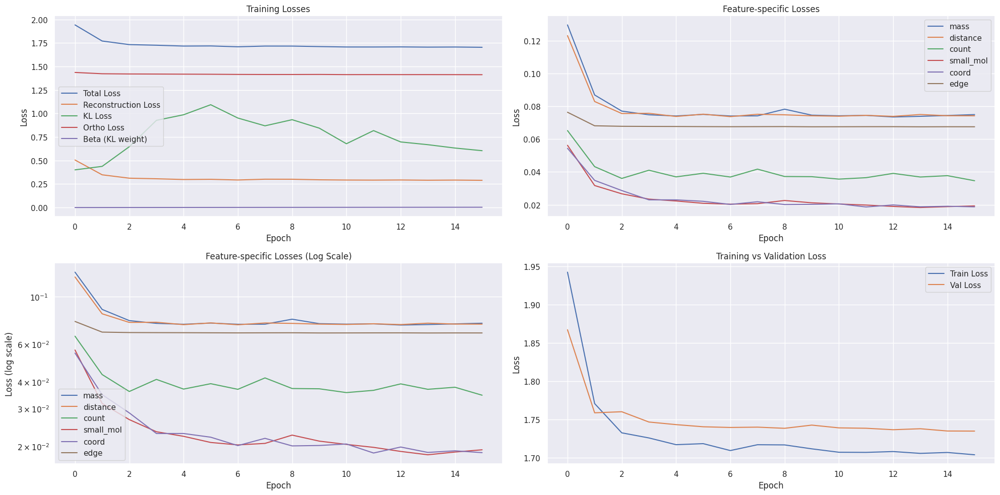

Epoch 17/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.31it/s, loss=1.7146, recon=0.3003, kl=0.7037, ortho=1.4121]


Detailed loss diagnostics:
Raw recon_loss: 0.2875
Raw KL loss: 0.4924
Ortho loss: 1.4115
Current beta: 0.0032
mu mean: -0.0468, std: 0.6424
logvar mean: -0.8860, std: 1.2467
mass: 0.0747
distance: 0.0798
count: 0.0345
small_mol: 0.0145
coord: 0.0156
edge: 0.0684


Epoch 17/100 [Train]:  29%|██▊       | 12/42 [00:00<00:01, 20.03it/s, loss=1.7053, recon=0.2878, kl=1.3816, ortho=1.4131]


Detailed loss diagnostics:
Raw recon_loss: 0.2660
Raw KL loss: 0.4781
Ortho loss: 1.4132
Current beta: 0.0032
mu mean: -0.0297, std: 0.6874
logvar mean: -0.6476, std: 1.2614
mass: 0.0723
distance: 0.0688
count: 0.0259
small_mol: 0.0160
coord: 0.0161
edge: 0.0669


Epoch 17/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 19.98it/s, loss=1.6911, recon=0.2759, kl=0.5865, ortho=1.4133]


Detailed loss diagnostics:
Raw recon_loss: 0.2578
Raw KL loss: 0.5807
Ortho loss: 1.4119
Current beta: 0.0032
mu mean: -0.0389, std: 0.7234
logvar mean: -0.9761, std: 1.2439
mass: 0.0675
distance: 0.0685
count: 0.0257
small_mol: 0.0137
coord: 0.0151
edge: 0.0672


Epoch 17/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 19.82it/s, loss=1.6692, recon=0.2560, kl=0.4132, ortho=1.4119]


Detailed loss diagnostics:
Raw recon_loss: 0.2664
Raw KL loss: 0.6052
Ortho loss: 1.4112
Current beta: 0.0032
mu mean: -0.0138, std: 0.7606
logvar mean: -0.9438, std: 1.3917
mass: 0.0715
distance: 0.0685
count: 0.0258
small_mol: 0.0200
coord: 0.0138
edge: 0.0667


Epoch 17/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.89it/s, loss=1.8592, recon=0.4312, kl=0.5742, ortho=1.4262]



Detailed loss diagnostics:
Raw recon_loss: 0.3092
Raw KL loss: 0.5526
Ortho loss: 1.4133
Current beta: 0.0032
mu mean: -0.0606, std: 0.5978
logvar mean: -1.1454, std: 1.2194
mass: 0.0872
distance: 0.0742
count: 0.0262
small_mol: 0.0337
coord: 0.0206
edge: 0.0673

Starting validation...


Epoch 17/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 68.80it/s]



Epoch [17/100] - Time: 2.43s
Train - Total: 1.7060, Recon: 0.2915, KL: 0.5911, Ortho: 1.4127, Beta: 0.0032
Feature Losses:
  mass_loss: 0.0746
  distance_loss: 0.0745
  count_loss: 0.0364
  small_mol_loss: 0.0196
  coord_loss: 0.0187
  edge_loss: 0.0676


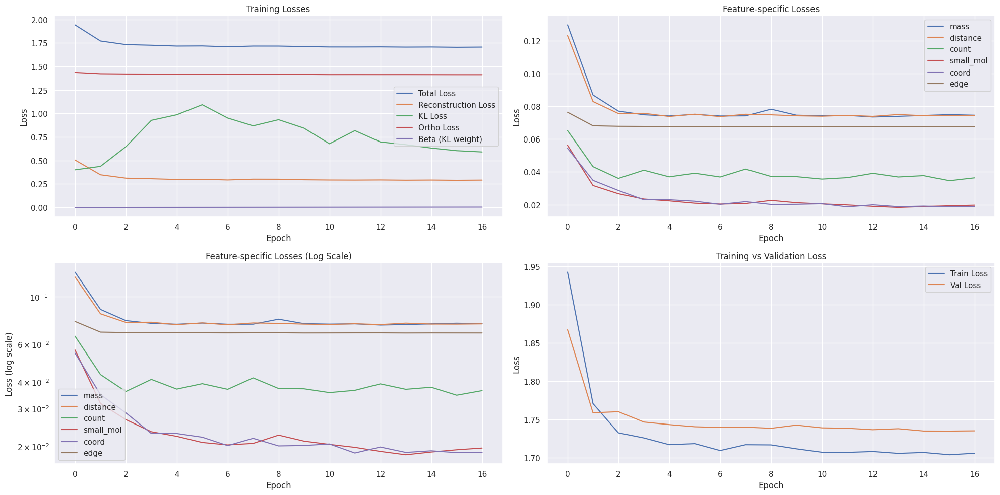

Epoch 18/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 17.74it/s, loss=1.6782, recon=0.2635, kl=0.5448, ortho=1.4128]


Detailed loss diagnostics:
Raw recon_loss: 0.2728
Raw KL loss: 0.4819
Ortho loss: 1.4146
Current beta: 0.0034
mu mean: -0.0968, std: 0.6375
logvar mean: -0.9929, std: 1.0021
mass: 0.0720
distance: 0.0685
count: 0.0257
small_mol: 0.0169
coord: 0.0216
edge: 0.0682


Epoch 18/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 18.90it/s, loss=1.6944, recon=0.2807, kl=0.5031, ortho=1.4119]


Detailed loss diagnostics:
Raw recon_loss: 0.4335
Raw KL loss: 0.7433
Ortho loss: 1.4105
Current beta: 0.0034
mu mean: -0.0489, std: 0.8455
logvar mean: -1.0996, std: 1.5029
mass: 0.0770
distance: 0.0902
count: 0.1591
small_mol: 0.0182
coord: 0.0197
edge: 0.0693


Epoch 18/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 19.37it/s, loss=1.6925, recon=0.2796, kl=0.5767, ortho=1.4109]


Detailed loss diagnostics:
Raw recon_loss: 0.2547
Raw KL loss: 0.3198
Ortho loss: 1.4140
Current beta: 0.0034
mu mean: -0.0823, std: 0.5598
logvar mean: -0.4735, std: 0.8675
mass: 0.0702
distance: 0.0690
count: 0.0258
small_mol: 0.0107
coord: 0.0122
edge: 0.0667


Epoch 18/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 20.55it/s, loss=1.6860, recon=0.2720, kl=0.6038, ortho=1.4119]


Detailed loss diagnostics:
Raw recon_loss: 0.2611
Raw KL loss: 0.4567
Ortho loss: 1.4118
Current beta: 0.0034
mu mean: -0.0043, std: 0.6344
logvar mean: -0.7455, std: 1.1909
mass: 0.0699
distance: 0.0706
count: 0.0258
small_mol: 0.0157
coord: 0.0127
edge: 0.0664


Epoch 18/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.54it/s, loss=1.8468, recon=0.4204, kl=0.2034, ortho=1.4257]



Detailed loss diagnostics:
Raw recon_loss: 0.3914
Raw KL loss: 0.6734
Ortho loss: 1.4149
Current beta: 0.0034
mu mean: 0.0132, std: 0.7368
logvar mean: -1.2767, std: 1.2999
mass: 0.0752
distance: 0.0931
count: 0.1181
small_mol: 0.0242
coord: 0.0101
edge: 0.0709

Starting validation...


Epoch 18/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 66.69it/s]



Epoch [18/100] - Time: 2.47s
Train - Total: 1.7064, Recon: 0.2917, KL: 0.5942, Ortho: 1.4127, Beta: 0.0034
Feature Losses:
  mass_loss: 0.0741
  distance_loss: 0.0743
  count_loss: 0.0377
  small_mol_loss: 0.0185
  coord_loss: 0.0196
  edge_loss: 0.0675


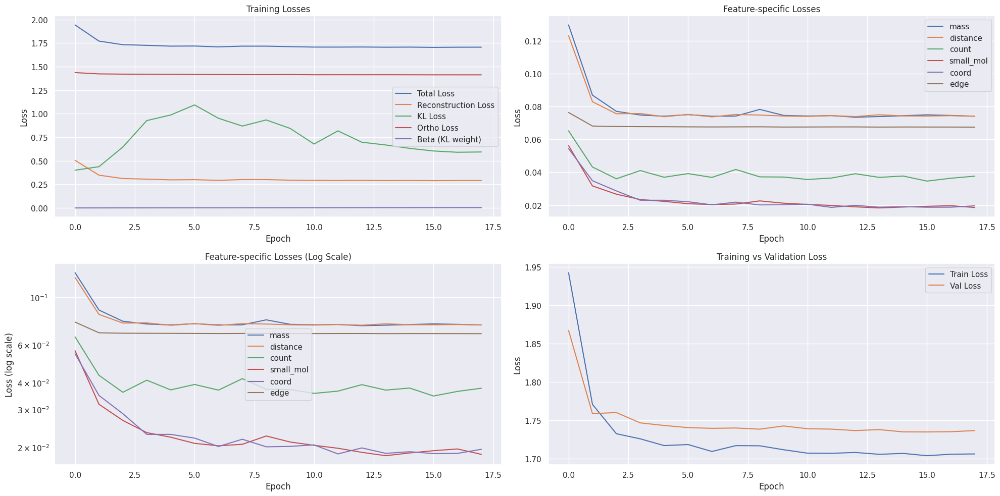

Epoch 19/100 [Train]:   7%|▋         | 3/42 [00:00<00:02, 19.40it/s, loss=1.7082, recon=0.2936, kl=0.6369, ortho=1.4123]


Detailed loss diagnostics:
Raw recon_loss: 0.2948
Raw KL loss: 0.5467
Ortho loss: 1.4116
Current beta: 0.0036
mu mean: -0.0386, std: 0.6699
logvar mean: -1.0858, std: 1.0357
mass: 0.0782
distance: 0.0774
count: 0.0264
small_mol: 0.0290
coord: 0.0156
edge: 0.0682


Epoch 19/100 [Train]:  29%|██▊       | 12/42 [00:00<00:01, 19.14it/s, loss=1.6997, recon=0.2857, kl=0.6071, ortho=1.4118]


Detailed loss diagnostics:
Raw recon_loss: 0.2880
Raw KL loss: 0.8074
Ortho loss: 1.4142
Current beta: 0.0036
mu mean: -0.0721, std: 0.7644
logvar mean: -1.5038, std: 1.4875
mass: 0.0776
distance: 0.0740
count: 0.0262
small_mol: 0.0259
coord: 0.0162
edge: 0.0681


Epoch 19/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 20.42it/s, loss=1.6837, recon=0.2697, kl=0.5423, ortho=1.4121]


Detailed loss diagnostics:
Raw recon_loss: 0.2845
Raw KL loss: 0.7105
Ortho loss: 1.4115
Current beta: 0.0036
mu mean: -0.0459, std: 0.8443
logvar mean: -1.1531, std: 1.1400
mass: 0.0766
distance: 0.0752
count: 0.0263
small_mol: 0.0212
coord: 0.0178
edge: 0.0674


Epoch 19/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 19.12it/s, loss=1.6797, recon=0.2672, kl=0.3304, ortho=1.4112]


Detailed loss diagnostics:
Raw recon_loss: 0.2597
Raw KL loss: 0.6668
Ortho loss: 1.4125
Current beta: 0.0036
mu mean: -0.0579, std: 0.8036
logvar mean: -1.0807, std: 1.1824
mass: 0.0665
distance: 0.0670
count: 0.0256
small_mol: 0.0138
coord: 0.0202
edge: 0.0667


Epoch 19/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 20.02it/s, loss=1.7439, recon=0.3141, kl=0.2509, ortho=1.4289]



Detailed loss diagnostics:
Raw recon_loss: 0.2575
Raw KL loss: 0.4536
Ortho loss: 1.4116
Current beta: 0.0036
mu mean: -0.0378, std: 0.6640
logvar mean: -0.7167, std: 1.1045
mass: 0.0684
distance: 0.0699
count: 0.0257
small_mol: 0.0096
coord: 0.0163
edge: 0.0676

Starting validation...


Epoch 19/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 67.42it/s]



Epoch [19/100] - Time: 2.42s
Train - Total: 1.7003, Recon: 0.2858, KL: 0.5829, Ortho: 1.4125, Beta: 0.0036
Feature Losses:
  mass_loss: 0.0731
  distance_loss: 0.0733
  count_loss: 0.0358
  small_mol_loss: 0.0186
  coord_loss: 0.0174
  edge_loss: 0.0675


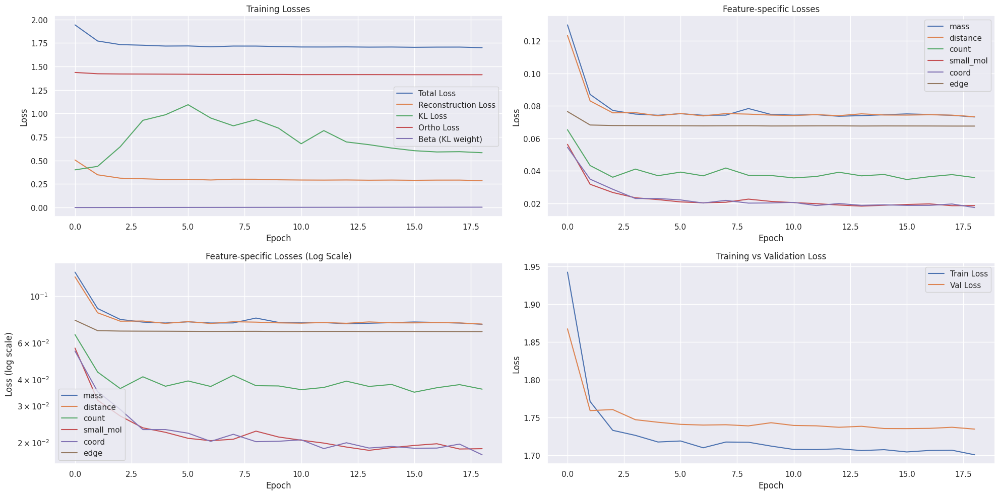

Epoch 20/100 [Train]:  10%|▉         | 4/42 [00:00<00:01, 19.06it/s, loss=1.7189, recon=0.3057, kl=0.5123, ortho=1.4113]


Detailed loss diagnostics:
Raw recon_loss: 0.4342
Raw KL loss: 0.4433
Ortho loss: 1.4121
Current beta: 0.0038
mu mean: -0.0649, std: 0.6077
logvar mean: -0.8413, std: 1.0230
mass: 0.0744
distance: 0.0894
count: 0.1696
small_mol: 0.0176
coord: 0.0131
edge: 0.0702


Epoch 20/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 19.02it/s, loss=1.6799, recon=0.2672, kl=0.4811, ortho=1.4109]


Detailed loss diagnostics:
Raw recon_loss: 0.3037
Raw KL loss: 0.4669
Ortho loss: 1.4117
Current beta: 0.0038
mu mean: -0.0611, std: 0.6754
logvar mean: -0.8423, std: 0.9864
mass: 0.0832
distance: 0.0800
count: 0.0268
small_mol: 0.0210
coord: 0.0261
edge: 0.0667


Epoch 20/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 20.43it/s, loss=1.6812, recon=0.2690, kl=0.4108, ortho=1.4107]


Detailed loss diagnostics:
Raw recon_loss: 0.5347
Raw KL loss: 0.5007
Ortho loss: 1.4115
Current beta: 0.0038
mu mean: -0.0865, std: 0.6963
logvar mean: -0.8245, std: 1.1091
mass: 0.0855
distance: 0.1203
count: 0.2191
small_mol: 0.0174
coord: 0.0189
edge: 0.0735


Epoch 20/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 20.19it/s, loss=1.6920, recon=0.2794, kl=0.5384, ortho=1.4106]


Detailed loss diagnostics:
Raw recon_loss: 0.2389
Raw KL loss: 0.4988
Ortho loss: 1.4133
Current beta: 0.0038
mu mean: -0.0688, std: 0.6831
logvar mean: -0.9338, std: 1.0197
mass: 0.0616
distance: 0.0605
count: 0.0251
small_mol: 0.0155
coord: 0.0092
edge: 0.0671


Epoch 20/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.83it/s, loss=1.7549, recon=0.3281, kl=0.3569, ortho=1.4255]



Detailed loss diagnostics:
Raw recon_loss: 0.2550
Raw KL loss: 0.7215
Ortho loss: 1.4105
Current beta: 0.0038
mu mean: -0.0433, std: 0.8119
logvar mean: -1.1585, std: 1.3802
mass: 0.0636
distance: 0.0614
count: 0.0252
small_mol: 0.0129
coord: 0.0253
edge: 0.0666

Starting validation...


Epoch 20/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 68.23it/s]



Epoch [20/100] - Time: 2.43s
Train - Total: 1.7069, Recon: 0.2929, KL: 0.5108, Ortho: 1.4121, Beta: 0.0038
Feature Losses:
  mass_loss: 0.0739
  distance_loss: 0.0746
  count_loss: 0.0401
  small_mol_loss: 0.0189
  coord_loss: 0.0178
  edge_loss: 0.0677


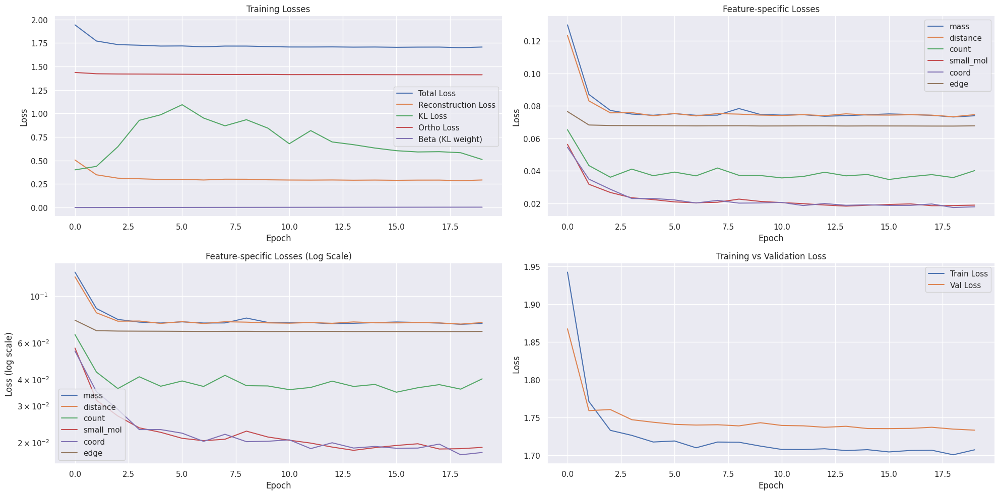

Epoch 21/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.56it/s, loss=1.6639, recon=0.2477, kl=0.7109, ortho=1.4134]


Detailed loss diagnostics:
Raw recon_loss: 0.2706
Raw KL loss: 0.3849
Ortho loss: 1.4109
Current beta: 0.0040
mu mean: -0.0686, std: 0.5887
logvar mean: -0.7290, std: 0.9093
mass: 0.0768
distance: 0.0744
count: 0.0261
small_mol: 0.0131
coord: 0.0130
edge: 0.0672


Epoch 21/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 19.33it/s, loss=1.7576, recon=0.3437, kl=0.3768, ortho=1.4124]


Detailed loss diagnostics:
Raw recon_loss: 0.2498
Raw KL loss: 0.6058
Ortho loss: 1.4123
Current beta: 0.0040
mu mean: -0.0694, std: 0.8256
logvar mean: -0.8949, std: 1.0543
mass: 0.0629
distance: 0.0649
count: 0.0253
small_mol: 0.0115
coord: 0.0183
edge: 0.0669


Epoch 21/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 19.23it/s, loss=1.7056, recon=0.2910, kl=0.7553, ortho=1.4115]


Detailed loss diagnostics:
Raw recon_loss: 0.3229
Raw KL loss: 0.6924
Ortho loss: 1.4121
Current beta: 0.0040
mu mean: -0.0747, std: 0.7884
logvar mean: -1.2081, std: 1.2348
mass: 0.0971
distance: 0.0791
count: 0.0268
small_mol: 0.0303
coord: 0.0223
edge: 0.0673


Epoch 21/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 20.13it/s, loss=1.6862, recon=0.2720, kl=0.4958, ortho=1.4122]


Detailed loss diagnostics:
Raw recon_loss: 0.2460
Raw KL loss: 0.4408
Ortho loss: 1.4123
Current beta: 0.0040
mu mean: -0.0944, std: 0.6272
logvar mean: -0.8196, std: 1.0058
mass: 0.0609
distance: 0.0590
count: 0.0250
small_mol: 0.0122
coord: 0.0211
edge: 0.0677


Epoch 21/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.85it/s, loss=1.8231, recon=0.3951, kl=0.5908, ortho=1.4256]



Detailed loss diagnostics:
Raw recon_loss: 0.2638
Raw KL loss: 0.4076
Ortho loss: 1.4111
Current beta: 0.0040
mu mean: -0.0219, std: 0.5959
logvar mean: -0.8027, std: 0.9639
mass: 0.0719
distance: 0.0705
count: 0.0259
small_mol: 0.0188
coord: 0.0100
edge: 0.0667

Starting validation...


Epoch 21/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 69.68it/s]



Epoch [21/100] - Time: 2.42s
Train - Total: 1.7050, Recon: 0.2904, KL: 0.5423, Ortho: 1.4125, Beta: 0.0040
Feature Losses:
  mass_loss: 0.0744
  distance_loss: 0.0742
  count_loss: 0.0371
  small_mol_loss: 0.0195
  coord_loss: 0.0177
  edge_loss: 0.0675


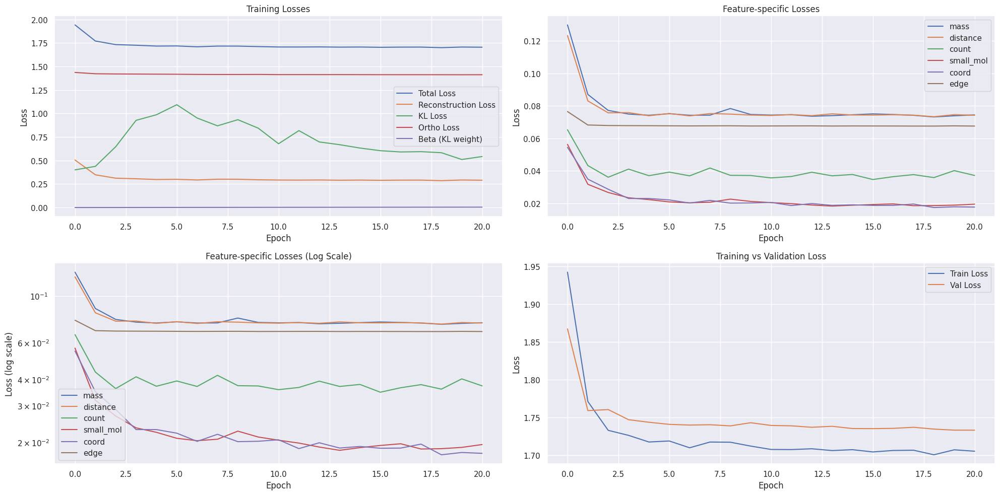

Epoch 22/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 19.78it/s, loss=1.6694, recon=0.2566, kl=0.4849, ortho=1.4108]


Detailed loss diagnostics:
Raw recon_loss: 0.2636
Raw KL loss: 0.5951
Ortho loss: 1.4123
Current beta: 0.0042
mu mean: -0.0137, std: 0.7246
logvar mean: -1.0974, std: 1.1403
mass: 0.0693
distance: 0.0674
count: 0.0257
small_mol: 0.0220
coord: 0.0124
edge: 0.0668


Epoch 22/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 20.24it/s, loss=1.7026, recon=0.2869, kl=0.5481, ortho=1.4134]


Detailed loss diagnostics:
Raw recon_loss: 0.3045
Raw KL loss: 0.4968
Ortho loss: 1.4122
Current beta: 0.0042
mu mean: -0.0378, std: 0.6970
logvar mean: -0.9135, std: 0.9592
mass: 0.0918
distance: 0.0795
count: 0.0266
small_mol: 0.0231
coord: 0.0171
edge: 0.0665


Epoch 22/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 20.30it/s, loss=1.7209, recon=0.3066, kl=0.6982, ortho=1.4114]


Detailed loss diagnostics:
Raw recon_loss: 0.2597
Raw KL loss: 0.6095
Ortho loss: 1.4127
Current beta: 0.0042
mu mean: -0.0024, std: 0.8376
logvar mean: -0.8633, std: 1.1640
mass: 0.0692
distance: 0.0685
count: 0.0256
small_mol: 0.0136
coord: 0.0152
edge: 0.0676


Epoch 22/100 [Train]:  76%|███████▌  | 32/42 [00:01<00:00, 20.07it/s, loss=1.6679, recon=0.2554, kl=0.3732, ortho=1.4109]


Detailed loss diagnostics:
Raw recon_loss: 0.2692
Raw KL loss: 0.3734
Ortho loss: 1.4111
Current beta: 0.0042
mu mean: -0.0354, std: 0.5379
logvar mean: -0.8495, std: 0.8632
mass: 0.0721
distance: 0.0706
count: 0.0257
small_mol: 0.0216
coord: 0.0115
edge: 0.0676


Epoch 22/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 20.08it/s, loss=1.7131, recon=0.2829, kl=0.3044, ortho=1.4289]



Detailed loss diagnostics:
Raw recon_loss: 0.2719
Raw KL loss: 0.6637
Ortho loss: 1.4115
Current beta: 0.0042
mu mean: -0.0791, std: 0.7346
logvar mean: -1.3508, std: 1.0535
mass: 0.0681
distance: 0.0663
count: 0.0256
small_mol: 0.0261
coord: 0.0179
edge: 0.0679

Starting validation...


Epoch 22/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 68.17it/s]



Epoch [22/100] - Time: 2.41s
Train - Total: 1.7035, Recon: 0.2894, KL: 0.4994, Ortho: 1.4121, Beta: 0.0042
Feature Losses:
  mass_loss: 0.0733
  distance_loss: 0.0739
  count_loss: 0.0394
  small_mol_loss: 0.0180
  coord_loss: 0.0172
  edge_loss: 0.0677


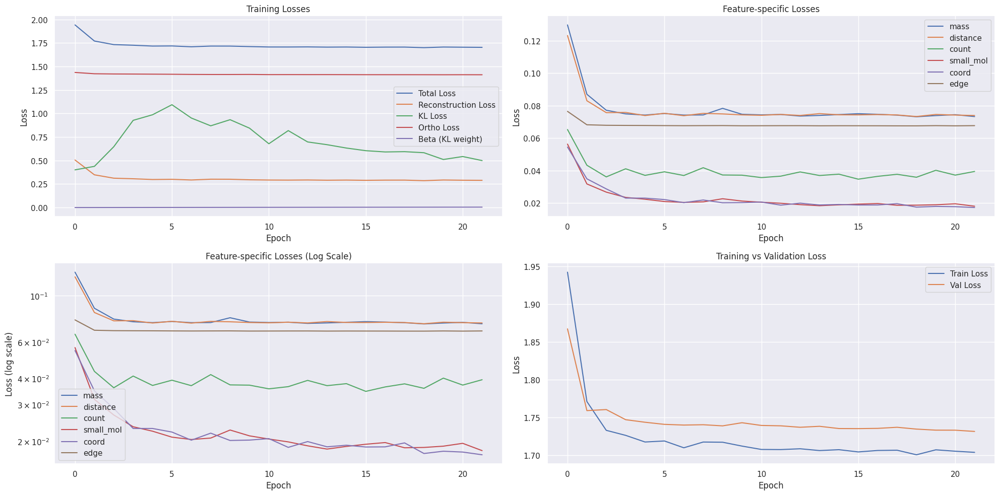

Epoch 23/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 17.48it/s, loss=1.6713, recon=0.2576, kl=0.4357, ortho=1.4118]


Detailed loss diagnostics:
Raw recon_loss: 0.2551
Raw KL loss: 0.6178
Ortho loss: 1.4114
Current beta: 0.0044
mu mean: -0.0290, std: 0.6964
logvar mean: -1.2351, std: 1.3333
mass: 0.0666
distance: 0.0642
count: 0.0253
small_mol: 0.0170
coord: 0.0160
edge: 0.0659


Epoch 23/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 20.10it/s, loss=1.6710, recon=0.2580, kl=0.4123, ortho=1.4111]


Detailed loss diagnostics:
Raw recon_loss: 0.3539
Raw KL loss: 0.4659
Ortho loss: 1.4115
Current beta: 0.0044
mu mean: -0.0298, std: 0.6984
logvar mean: -0.7045, std: 1.0023
mass: 0.0700
distance: 0.0814
count: 0.1059
small_mol: 0.0143
coord: 0.0112
edge: 0.0711


Epoch 23/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:01, 19.77it/s, loss=1.8317, recon=0.4169, kl=0.4878, ortho=1.4126]


Detailed loss diagnostics:
Raw recon_loss: 0.2707
Raw KL loss: 0.4755
Ortho loss: 1.4112
Current beta: 0.0044
mu mean: -0.0753, std: 0.6580
logvar mean: -0.9098, std: 0.9916
mass: 0.0744
distance: 0.0742
count: 0.0262
small_mol: 0.0166
coord: 0.0131
edge: 0.0663


Epoch 23/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 21.02it/s, loss=1.6783, recon=0.2641, kl=0.5472, ortho=1.4119]


Detailed loss diagnostics:
Raw recon_loss: 0.2652
Raw KL loss: 0.4193
Ortho loss: 1.4110
Current beta: 0.0044
mu mean: -0.0864, std: 0.5596
logvar mean: -0.9677, std: 0.8732
mass: 0.0710
distance: 0.0701
count: 0.0258
small_mol: 0.0199
coord: 0.0110
edge: 0.0674


Epoch 23/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 20.24it/s, loss=1.8692, recon=0.4401, kl=0.3097, ortho=1.4277]



Detailed loss diagnostics:
Raw recon_loss: 0.4340
Raw KL loss: 0.3787
Ortho loss: 1.4111
Current beta: 0.0044
mu mean: -0.0545, std: 0.5743
logvar mean: -0.8276, std: 0.8277
mass: 0.0773
distance: 0.0913
count: 0.1611
small_mol: 0.0202
coord: 0.0145
edge: 0.0695

Starting validation...


Epoch 23/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 67.92it/s]



Epoch [23/100] - Time: 2.39s
Train - Total: 1.7068, Recon: 0.2926, KL: 0.4896, Ortho: 1.4120, Beta: 0.0044
Feature Losses:
  mass_loss: 0.0747
  distance_loss: 0.0748
  count_loss: 0.0378
  small_mol_loss: 0.0196
  coord_loss: 0.0182
  edge_loss: 0.0676


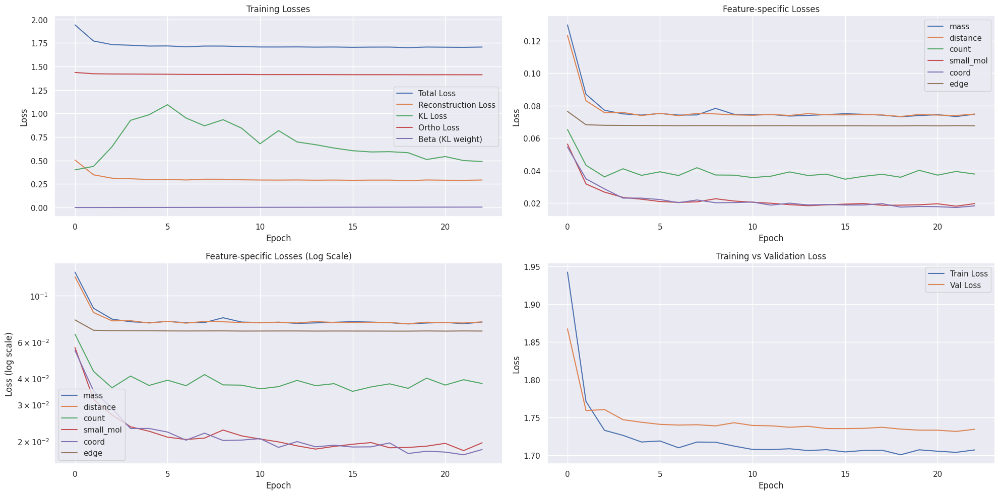

Epoch 24/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.51it/s, loss=1.6941, recon=0.2759, kl=0.8406, ortho=1.4143]


Detailed loss diagnostics:
Raw recon_loss: 0.4898
Raw KL loss: 0.5051
Ortho loss: 1.4110
Current beta: 0.0046
mu mean: -0.0431, std: 0.6641
logvar mean: -0.9641, std: 1.0837
mass: 0.0866
distance: 0.1176
count: 0.1774
small_mol: 0.0212
coord: 0.0167
edge: 0.0703


Epoch 24/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 18.71it/s, loss=1.7022, recon=0.2859, kl=0.8456, ortho=1.4124]


Detailed loss diagnostics:
Raw recon_loss: 0.2365
Raw KL loss: 0.6593
Ortho loss: 1.4139
Current beta: 0.0046
mu mean: -0.0804, std: 0.7610
logvar mean: -1.0395, std: 1.6031
mass: 0.0605
distance: 0.0594
count: 0.0250
small_mol: 0.0112
coord: 0.0136
edge: 0.0668


Epoch 24/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 18.98it/s, loss=1.6554, recon=0.2406, kl=0.5047, ortho=1.4125]


Detailed loss diagnostics:
Raw recon_loss: 0.2789
Raw KL loss: 0.5377
Ortho loss: 1.4128
Current beta: 0.0046
mu mean: -0.0845, std: 0.6696
logvar mean: -0.8171, std: 1.3932
mass: 0.0741
distance: 0.0765
count: 0.0261
small_mol: 0.0206
coord: 0.0146
edge: 0.0669


Epoch 24/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 19.09it/s, loss=1.7178, recon=0.3019, kl=0.6823, ortho=1.4128]


Detailed loss diagnostics:
Raw recon_loss: 0.2832
Raw KL loss: 0.5645
Ortho loss: 1.4127
Current beta: 0.0046
mu mean: -0.0244, std: 0.6507
logvar mean: -1.0824, std: 1.3983
mass: 0.0766
distance: 0.0753
count: 0.0263
small_mol: 0.0219
coord: 0.0165
edge: 0.0666


Epoch 24/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.05it/s, loss=1.7220, recon=0.2940, kl=0.5128, ortho=1.4256]



Detailed loss diagnostics:
Raw recon_loss: 0.2870
Raw KL loss: 0.4286
Ortho loss: 1.4126
Current beta: 0.0046
mu mean: -0.0770, std: 0.6067
logvar mean: -0.7202, std: 1.1709
mass: 0.0793
distance: 0.0770
count: 0.0265
small_mol: 0.0156
coord: 0.0207
edge: 0.0679

Starting validation...


Epoch 24/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 70.00it/s]



Epoch [24/100] - Time: 2.51s
Train - Total: 1.7056, Recon: 0.2894, KL: 0.6906, Ortho: 1.4130, Beta: 0.0046
Feature Losses:
  mass_loss: 0.0739
  distance_loss: 0.0742
  count_loss: 0.0374
  small_mol_loss: 0.0187
  coord_loss: 0.0177
  edge_loss: 0.0675


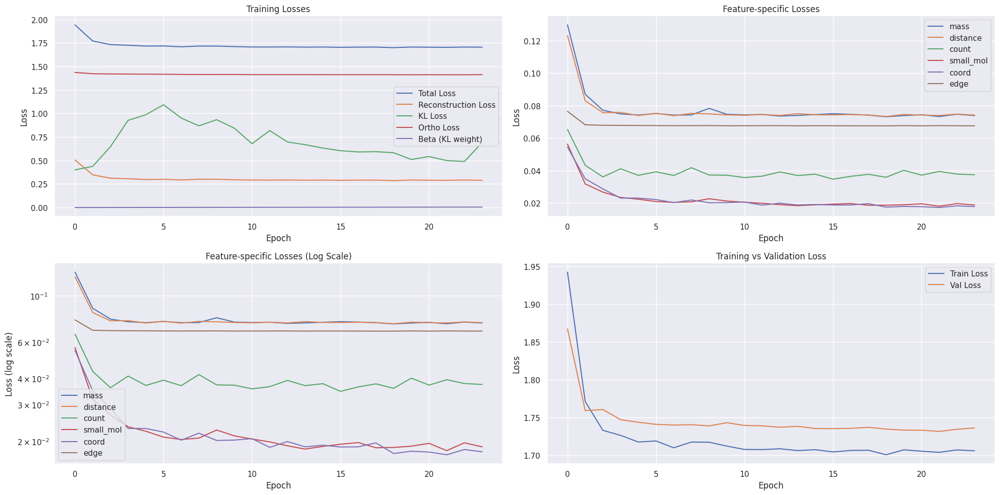

Epoch 25/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 15.61it/s, loss=1.7187, recon=0.3045, kl=0.5743, ortho=1.4114]


Detailed loss diagnostics:
Raw recon_loss: 0.2939
Raw KL loss: 0.6475
Ortho loss: 1.4115
Current beta: 0.0048
mu mean: -0.0581, std: 0.7432
logvar mean: -1.1448, std: 1.3248
mass: 0.0779
distance: 0.0750
count: 0.0263
small_mol: 0.0262
coord: 0.0217
edge: 0.0667


Epoch 25/100 [Train]:  29%|██▊       | 12/42 [00:00<00:01, 20.43it/s, loss=1.6566, recon=0.2421, kl=0.4615, ortho=1.4123]


Detailed loss diagnostics:
Raw recon_loss: 0.2626
Raw KL loss: 0.3055
Ortho loss: 1.4113
Current beta: 0.0048
mu mean: -0.0353, std: 0.5192
logvar mean: -0.5751, std: 0.8848
mass: 0.0734
distance: 0.0686
count: 0.0258
small_mol: 0.0128
coord: 0.0143
edge: 0.0676


Epoch 25/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 19.20it/s, loss=1.7212, recon=0.3058, kl=0.6650, ortho=1.4123]


Detailed loss diagnostics:
Raw recon_loss: 0.2359
Raw KL loss: 0.3423
Ortho loss: 1.4124
Current beta: 0.0048
mu mean: -0.0233, std: 0.5760
logvar mean: -0.6033, std: 0.8855
mass: 0.0615
distance: 0.0612
count: 0.0251
small_mol: 0.0100
coord: 0.0112
edge: 0.0668


Epoch 25/100 [Train]:  76%|███████▌  | 32/42 [00:01<00:00, 20.43it/s, loss=1.6977, recon=0.2840, kl=0.3961, ortho=1.4118]


Detailed loss diagnostics:
Raw recon_loss: 0.2756
Raw KL loss: 0.4302
Ortho loss: 1.4107
Current beta: 0.0048
mu mean: -0.0247, std: 0.6529
logvar mean: -0.7448, std: 0.9355
mass: 0.0760
distance: 0.0740
count: 0.0262
small_mol: 0.0173
coord: 0.0150
edge: 0.0671


Epoch 25/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.78it/s, loss=1.8509, recon=0.4117, kl=1.0494, ortho=1.4342]



Detailed loss diagnostics:
Raw recon_loss: 0.2652
Raw KL loss: 0.5460
Ortho loss: 1.4109
Current beta: 0.0048
mu mean: -0.0656, std: 0.7361
logvar mean: -1.0128, std: 0.9711
mass: 0.0717
distance: 0.0700
count: 0.0258
small_mol: 0.0160
coord: 0.0144
edge: 0.0673

Starting validation...


Epoch 25/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 70.21it/s]



Epoch [25/100] - Time: 2.43s
Train - Total: 1.7016, Recon: 0.2872, KL: 0.5084, Ortho: 1.4119, Beta: 0.0048
Feature Losses:
  mass_loss: 0.0737
  distance_loss: 0.0736
  count_loss: 0.0369
  small_mol_loss: 0.0185
  coord_loss: 0.0169
  edge_loss: 0.0676


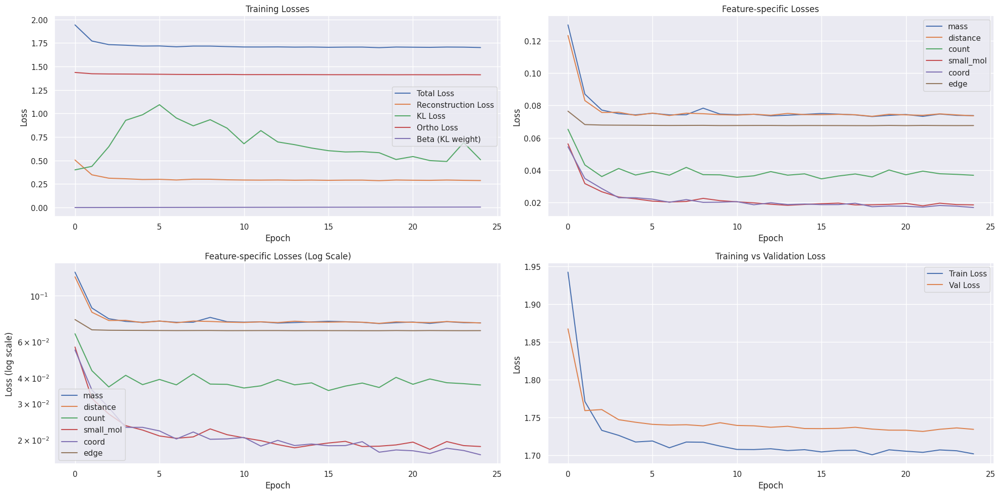

Epoch 26/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 19.55it/s, loss=1.7073, recon=0.2937, kl=0.4122, ortho=1.4115]


Detailed loss diagnostics:
Raw recon_loss: 0.2820
Raw KL loss: 0.3925
Ortho loss: 1.4101
Current beta: 0.0050
mu mean: -0.0545, std: 0.5705
logvar mean: -0.8562, std: 0.8703
mass: 0.0769
distance: 0.0722
count: 0.0262
small_mol: 0.0219
coord: 0.0175
edge: 0.0673


Epoch 26/100 [Train]:  29%|██▊       | 12/42 [00:00<00:01, 19.28it/s, loss=1.6789, recon=0.2656, kl=0.3792, ortho=1.4114]


Detailed loss diagnostics:
Raw recon_loss: 0.2399
Raw KL loss: 0.3432
Ortho loss: 1.4105
Current beta: 0.0050
mu mean: -0.0196, std: 0.5507
logvar mean: -0.6845, std: 0.8755
mass: 0.0616
distance: 0.0602
count: 0.0251
small_mol: 0.0129
coord: 0.0129
edge: 0.0671


Epoch 26/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 18.69it/s, loss=1.7004, recon=0.2863, kl=0.7003, ortho=1.4106]


Detailed loss diagnostics:
Raw recon_loss: 0.2746
Raw KL loss: 0.7617
Ortho loss: 1.4107
Current beta: 0.0050
mu mean: -0.1043, std: 0.8549
logvar mean: -1.2898, std: 1.2336
mass: 0.0717
distance: 0.0715
count: 0.0259
small_mol: 0.0159
coord: 0.0228
edge: 0.0668


Epoch 26/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 19.09it/s, loss=1.6927, recon=0.2783, kl=0.4815, ortho=1.4120]


Detailed loss diagnostics:
Raw recon_loss: 0.2313
Raw KL loss: 0.5259
Ortho loss: 1.4104
Current beta: 0.0050
mu mean: -0.0344, std: 0.6507
logvar mean: -1.0614, std: 1.1575
mass: 0.0582
distance: 0.0573
count: 0.0248
small_mol: 0.0124
coord: 0.0124
edge: 0.0663


Epoch 26/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.70it/s, loss=3.1030, recon=1.6734, kl=0.5678, ortho=1.4267]



Detailed loss diagnostics:
Raw recon_loss: 0.2817
Raw KL loss: 0.4153
Ortho loss: 1.4114
Current beta: 0.0050
mu mean: -0.0746, std: 0.6071
logvar mean: -0.8610, std: 0.8467
mass: 0.0788
distance: 0.0768
count: 0.0263
small_mol: 0.0172
coord: 0.0154
edge: 0.0672

Starting validation...


Epoch 26/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 66.47it/s]



Epoch [26/100] - Time: 2.45s
Train - Total: 1.7319, Recon: 0.3180, KL: 0.4643, Ortho: 1.4116, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0737
  distance_loss: 0.0782
  count_loss: 0.0624
  small_mol_loss: 0.0177
  coord_loss: 0.0176
  edge_loss: 0.0683


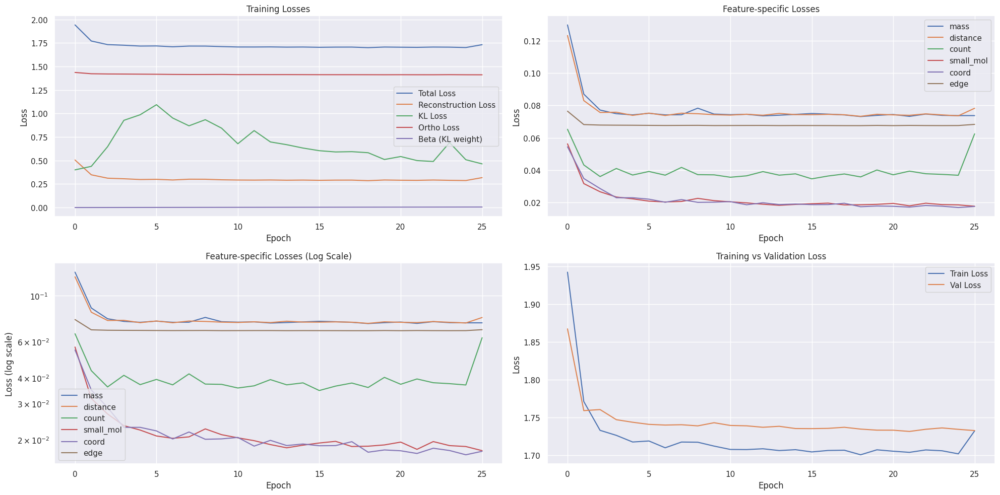

Epoch 27/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 17.13it/s, loss=1.6944, recon=0.2819, kl=0.4519, ortho=1.4102]


Detailed loss diagnostics:
Raw recon_loss: 0.2518
Raw KL loss: 0.3618
Ortho loss: 1.4116
Current beta: 0.0050
mu mean: -0.0181, std: 0.5851
logvar mean: -0.6630, std: 0.8558
mass: 0.0668
distance: 0.0668
count: 0.0255
small_mol: 0.0122
coord: 0.0136
edge: 0.0669


Epoch 27/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 19.15it/s, loss=1.6657, recon=0.2524, kl=0.3823, ortho=1.4114]


Detailed loss diagnostics:
Raw recon_loss: 0.2931
Raw KL loss: 0.3724
Ortho loss: 1.4121
Current beta: 0.0050
mu mean: 0.0000, std: 0.5822
logvar mean: -0.7673, std: 0.8548
mass: 0.0827
distance: 0.0806
count: 0.0267
small_mol: 0.0234
coord: 0.0135
edge: 0.0661


Epoch 27/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 19.56it/s, loss=1.6912, recon=0.2785, kl=0.3162, ortho=1.4112]


Detailed loss diagnostics:
Raw recon_loss: 0.2877
Raw KL loss: 0.4216
Ortho loss: 1.4103
Current beta: 0.0050
mu mean: -0.0419, std: 0.6512
logvar mean: -0.7388, std: 0.9394
mass: 0.0807
distance: 0.0774
count: 0.0264
small_mol: 0.0201
coord: 0.0161
edge: 0.0669


Epoch 27/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 18.55it/s, loss=1.6929, recon=0.2789, kl=0.3956, ortho=1.4120]


Detailed loss diagnostics:
Raw recon_loss: 0.2545
Raw KL loss: 0.3176
Ortho loss: 1.4106
Current beta: 0.0050
mu mean: -0.0376, std: 0.5546
logvar mean: -0.5914, std: 0.7831
mass: 0.0734
distance: 0.0646
count: 0.0254
small_mol: 0.0107
coord: 0.0136
edge: 0.0668


Epoch 27/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.30it/s, loss=1.7701, recon=0.3430, kl=0.2801, ortho=1.4257]



Detailed loss diagnostics:
Raw recon_loss: 0.2993
Raw KL loss: 0.3384
Ortho loss: 1.4121
Current beta: 0.0050
mu mean: -0.0228, std: 0.5233
logvar mean: -0.7570, std: 0.8546
mass: 0.0750
distance: 0.0844
count: 0.0345
small_mol: 0.0180
coord: 0.0192
edge: 0.0681

Starting validation...


Epoch 27/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 68.97it/s]



Epoch [27/100] - Time: 2.49s
Train - Total: 1.7062, Recon: 0.2923, KL: 0.4554, Ortho: 1.4116, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0748
  distance_loss: 0.0753
  count_loss: 0.0383
  small_mol_loss: 0.0188
  coord_loss: 0.0175
  edge_loss: 0.0676


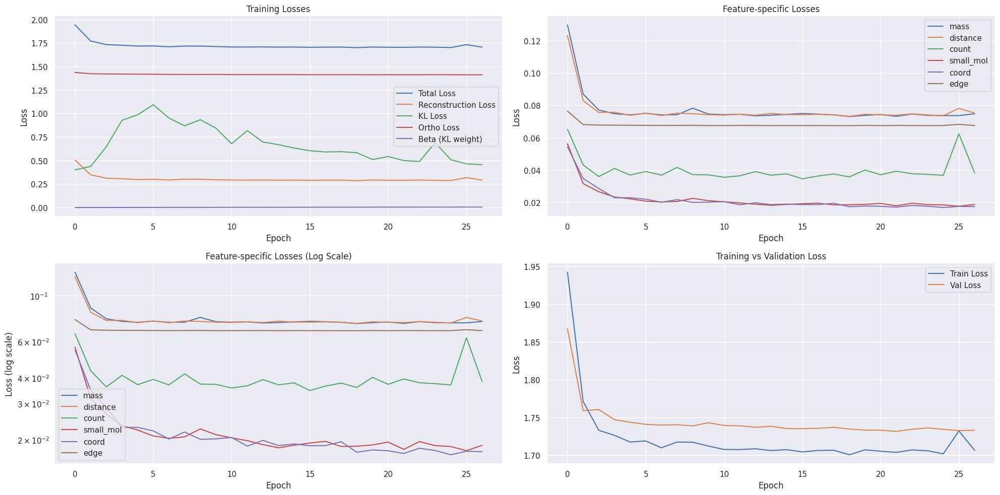

Epoch 28/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 19.37it/s, loss=1.6699, recon=0.2576, kl=0.3760, ortho=1.4104]


Detailed loss diagnostics:
Raw recon_loss: 0.2946
Raw KL loss: 0.5563
Ortho loss: 1.4096
Current beta: 0.0050
mu mean: -0.0181, std: 0.7450
logvar mean: -0.9416, std: 1.2102
mass: 0.0824
distance: 0.0823
count: 0.0266
small_mol: 0.0132
coord: 0.0231
edge: 0.0669


Epoch 28/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 18.36it/s, loss=1.6882, recon=0.2744, kl=0.4816, ortho=1.4113]


Detailed loss diagnostics:
Raw recon_loss: 0.2543
Raw KL loss: 0.5293
Ortho loss: 1.4114
Current beta: 0.0050
mu mean: -0.0344, std: 0.7776
logvar mean: -0.8631, std: 0.8870
mass: 0.0660
distance: 0.0659
count: 0.0255
small_mol: 0.0141
coord: 0.0160
edge: 0.0669


Epoch 28/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 19.19it/s, loss=1.7468, recon=0.3335, kl=0.4938, ortho=1.4108]


Detailed loss diagnostics:
Raw recon_loss: 0.2876
Raw KL loss: 0.8357
Ortho loss: 1.4122
Current beta: 0.0050
mu mean: 0.0051, std: 0.9226
logvar mean: -1.3526, std: 1.3819
mass: 0.0720
distance: 0.0718
count: 0.0259
small_mol: 0.0233
coord: 0.0277
edge: 0.0669


Epoch 28/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 18.77it/s, loss=1.7196, recon=0.3048, kl=0.5713, ortho=1.4119]


Detailed loss diagnostics:
Raw recon_loss: 0.3332
Raw KL loss: 0.5076
Ortho loss: 1.4117
Current beta: 0.0050
mu mean: -0.0139, std: 0.6966
logvar mean: -0.9671, std: 1.0049
mass: 0.0871
distance: 0.0841
count: 0.0269
small_mol: 0.0279
coord: 0.0401
edge: 0.0672


Epoch 28/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 18.86it/s, loss=1.9449, recon=0.5176, kl=0.4065, ortho=1.4253]



Detailed loss diagnostics:
Raw recon_loss: 0.2702
Raw KL loss: 0.3716
Ortho loss: 1.4095
Current beta: 0.0050
mu mean: -0.0230, std: 0.5810
logvar mean: -0.7669, std: 0.8244
mass: 0.0726
distance: 0.0702
count: 0.0259
small_mol: 0.0218
coord: 0.0124
edge: 0.0672

Starting validation...


Epoch 28/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 69.88it/s]



Epoch [28/100] - Time: 2.53s
Train - Total: 1.7074, Recon: 0.2934, KL: 0.4875, Ortho: 1.4116, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0754
  distance_loss: 0.0759
  count_loss: 0.0365
  small_mol_loss: 0.0204
  coord_loss: 0.0176
  edge_loss: 0.0675


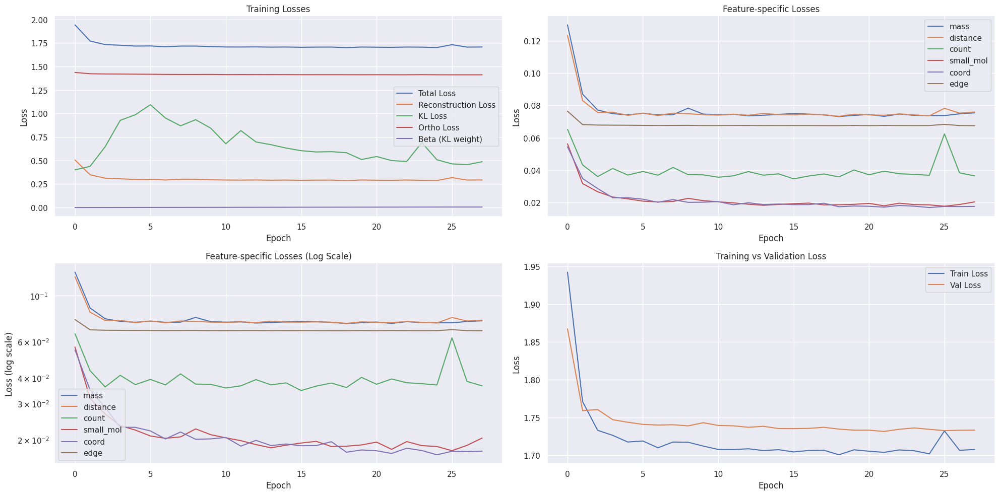

Epoch 29/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 18.80it/s, loss=1.7014, recon=0.2887, kl=0.4426, ortho=1.4105]


Detailed loss diagnostics:
Raw recon_loss: 0.3017
Raw KL loss: 0.4573
Ortho loss: 1.4119
Current beta: 0.0050
mu mean: -0.0348, std: 0.6061
logvar mean: -0.9967, std: 0.9144
mass: 0.0875
distance: 0.0732
count: 0.0263
small_mol: 0.0289
coord: 0.0189
edge: 0.0669


Epoch 29/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 20.13it/s, loss=1.6859, recon=0.2735, kl=0.4439, ortho=1.4102]


Detailed loss diagnostics:
Raw recon_loss: 0.2432
Raw KL loss: 0.5101
Ortho loss: 1.4117
Current beta: 0.0050
mu mean: -0.0311, std: 0.6905
logvar mean: -0.9027, std: 1.0397
mass: 0.0622
distance: 0.0620
count: 0.0251
small_mol: 0.0147
coord: 0.0122
edge: 0.0671


Epoch 29/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:00, 20.13it/s, loss=1.6416, recon=0.2290, kl=0.3604, ortho=1.4108]


Detailed loss diagnostics:
Raw recon_loss: 0.2589
Raw KL loss: 0.4092
Ortho loss: 1.4102
Current beta: 0.0050
mu mean: -0.0333, std: 0.6411
logvar mean: -0.7442, std: 0.9145
mass: 0.0698
distance: 0.0666
count: 0.0256
small_mol: 0.0132
coord: 0.0166
edge: 0.0672


Epoch 29/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 19.44it/s, loss=1.6951, recon=0.2813, kl=0.5210, ortho=1.4112]


Detailed loss diagnostics:
Raw recon_loss: 0.2667
Raw KL loss: 0.5759
Ortho loss: 1.4105
Current beta: 0.0050
mu mean: -0.0455, std: 0.6519
logvar mean: -1.1955, std: 1.1676
mass: 0.0701
distance: 0.0678
count: 0.0256
small_mol: 0.0226
coord: 0.0130
edge: 0.0675


Epoch 29/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.46it/s, loss=1.7487, recon=0.3170, kl=0.2835, ortho=1.4303]



Detailed loss diagnostics:
Raw recon_loss: 0.2982
Raw KL loss: 0.4573
Ortho loss: 1.4107
Current beta: 0.0050
mu mean: -0.0425, std: 0.5891
logvar mean: -0.9858, std: 1.0582
mass: 0.0804
distance: 0.0773
count: 0.0266
small_mol: 0.0199
coord: 0.0267
edge: 0.0673

Starting validation...


Epoch 29/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 65.51it/s]



Epoch [29/100] - Time: 2.49s
Train - Total: 1.7040, Recon: 0.2903, KL: 0.4785, Ortho: 1.4113, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0743
  distance_loss: 0.0746
  count_loss: 0.0372
  small_mol_loss: 0.0190
  coord_loss: 0.0177
  edge_loss: 0.0676


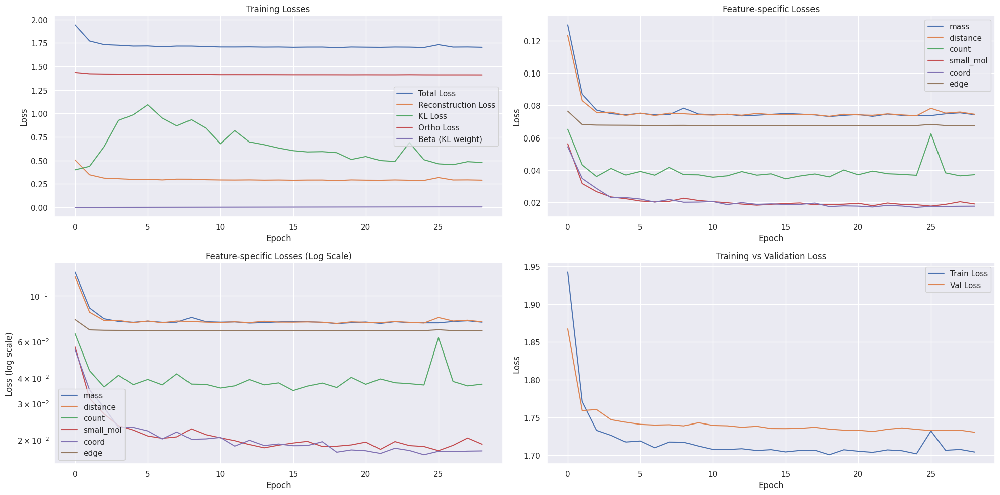

Epoch 30/100 [Train]:  10%|▉         | 4/42 [00:00<00:01, 19.16it/s, loss=1.8453, recon=0.4307, kl=0.4613, ortho=1.4123]


Detailed loss diagnostics:
Raw recon_loss: 0.2846
Raw KL loss: 0.5859
Ortho loss: 1.4110
Current beta: 0.0050
mu mean: -0.0452, std: 0.7008
logvar mean: -1.1594, std: 1.0936
mass: 0.0731
distance: 0.0720
count: 0.0260
small_mol: 0.0263
coord: 0.0198
edge: 0.0674


Epoch 30/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 19.70it/s, loss=1.8123, recon=0.3995, kl=0.3945, ortho=1.4108]


Detailed loss diagnostics:
Raw recon_loss: 0.2481
Raw KL loss: 0.4194
Ortho loss: 1.4130
Current beta: 0.0050
mu mean: -0.0697, std: 0.6566
logvar mean: -0.8011, std: 0.8326
mass: 0.0649
distance: 0.0634
count: 0.0253
small_mol: 0.0109
coord: 0.0155
edge: 0.0681


Epoch 30/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:01, 19.32it/s, loss=1.6717, recon=0.2581, kl=0.5634, ortho=1.4107]


Detailed loss diagnostics:
Raw recon_loss: 0.2789
Raw KL loss: 0.5449
Ortho loss: 1.4102
Current beta: 0.0050
mu mean: -0.0365, std: 0.6228
logvar mean: -1.2650, std: 0.9788
mass: 0.0734
distance: 0.0707
count: 0.0260
small_mol: 0.0227
coord: 0.0180
edge: 0.0680


Epoch 30/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 18.91it/s, loss=1.6612, recon=0.2478, kl=0.6293, ortho=1.4103]


Detailed loss diagnostics:
Raw recon_loss: 0.2736
Raw KL loss: 0.5405
Ortho loss: 1.4109
Current beta: 0.0050
mu mean: -0.0649, std: 0.6406
logvar mean: -1.0617, std: 1.3755
mass: 0.0714
distance: 0.0724
count: 0.0257
small_mol: 0.0148
coord: 0.0223
edge: 0.0670


Epoch 30/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.18it/s, loss=1.7570, recon=0.3254, kl=0.2654, ortho=1.4303]



Detailed loss diagnostics:
Raw recon_loss: 0.3008
Raw KL loss: 0.5276
Ortho loss: 1.4112
Current beta: 0.0050
mu mean: -0.0741, std: 0.7080
logvar mean: -1.0137, std: 0.9282
mass: 0.0651
distance: 0.0733
count: 0.0623
small_mol: 0.0158
coord: 0.0150
edge: 0.0692

Starting validation...


Epoch 30/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 65.54it/s]



Epoch [30/100] - Time: 2.52s
Train - Total: 1.7010, Recon: 0.2871, KL: 0.4978, Ortho: 1.4115, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0736
  distance_loss: 0.0736
  count_loss: 0.0364
  small_mol_loss: 0.0189
  coord_loss: 0.0171
  edge_loss: 0.0675


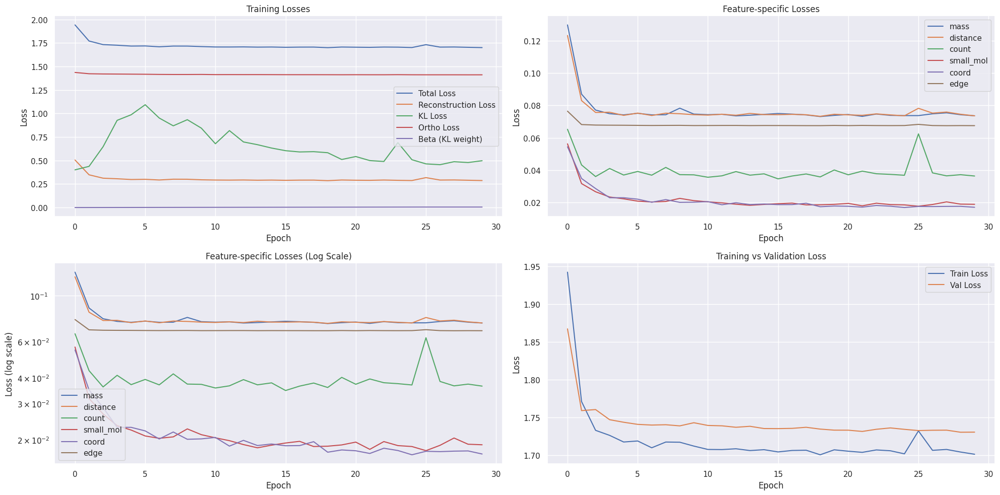

Epoch 31/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.88it/s, loss=1.6826, recon=0.2678, kl=0.4785, ortho=1.4124]


Detailed loss diagnostics:
Raw recon_loss: 0.3832
Raw KL loss: 0.4174
Ortho loss: 1.4118
Current beta: 0.0050
mu mean: -0.0492, std: 0.5938
logvar mean: -0.8973, std: 0.8665
mass: 0.0757
distance: 0.0883
count: 0.1163
small_mol: 0.0195
coord: 0.0122
edge: 0.0712


Epoch 31/100 [Train]:  29%|██▊       | 12/42 [00:00<00:01, 19.34it/s, loss=1.6922, recon=0.2791, kl=0.5283, ortho=1.4105]


Detailed loss diagnostics:
Raw recon_loss: 0.2394
Raw KL loss: 0.5764
Ortho loss: 1.4115
Current beta: 0.0050
mu mean: -0.0119, std: 0.7598
logvar mean: -1.0288, std: 1.0216
mass: 0.0625
distance: 0.0616
count: 0.0252
small_mol: 0.0108
coord: 0.0125
edge: 0.0669


Epoch 31/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 19.81it/s, loss=1.6747, recon=0.2609, kl=0.3063, ortho=1.4122]


Detailed loss diagnostics:
Raw recon_loss: 0.2881
Raw KL loss: 0.5130
Ortho loss: 1.4132
Current beta: 0.0050
mu mean: -0.0702, std: 0.7137
logvar mean: -1.0217, std: 0.8791
mass: 0.0772
distance: 0.0744
count: 0.0262
small_mol: 0.0293
coord: 0.0138
edge: 0.0670


Epoch 31/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 20.56it/s, loss=1.6841, recon=0.2699, kl=0.4841, ortho=1.4118]


Detailed loss diagnostics:
Raw recon_loss: 0.2628
Raw KL loss: 0.5160
Ortho loss: 1.4107
Current beta: 0.0050
mu mean: -0.0481, std: 0.6939
logvar mean: -1.0334, std: 0.9159
mass: 0.0656
distance: 0.0695
count: 0.0296
small_mol: 0.0161
coord: 0.0121
edge: 0.0697


Epoch 31/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.79it/s, loss=1.7582, recon=0.3213, kl=0.2806, ortho=1.4355]



Detailed loss diagnostics:
Raw recon_loss: 0.3072
Raw KL loss: 0.4009
Ortho loss: 1.4097
Current beta: 0.0050
mu mean: -0.0452, std: 0.6400
logvar mean: -0.7330, std: 0.8963
mass: 0.0847
distance: 0.0805
count: 0.0267
small_mol: 0.0169
coord: 0.0315
edge: 0.0670

Starting validation...


Epoch 31/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 67.44it/s]



Epoch [31/100] - Time: 2.45s
Train - Total: 1.7017, Recon: 0.2865, KL: 0.5448, Ortho: 1.4125, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0738
  distance_loss: 0.0735
  count_loss: 0.0359
  small_mol_loss: 0.0185
  coord_loss: 0.0172
  edge_loss: 0.0675


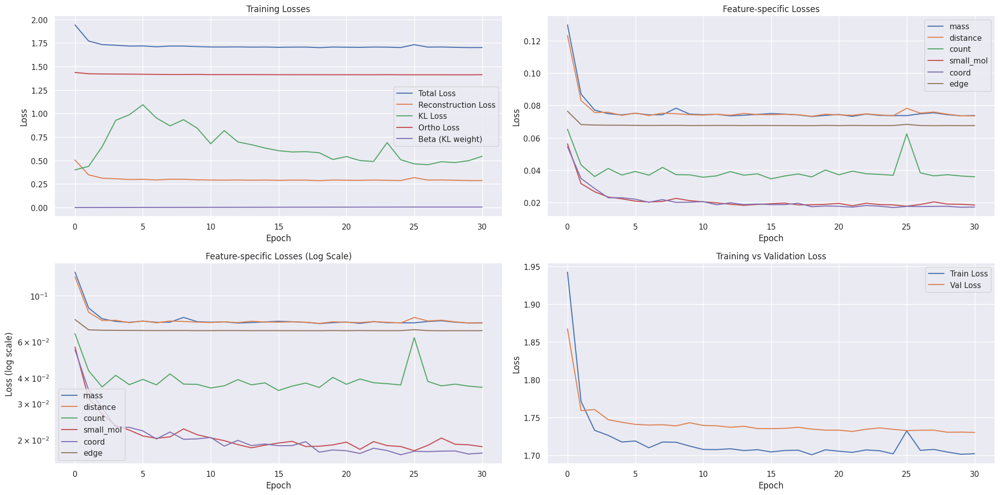

Epoch 32/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 17.25it/s, loss=1.7116, recon=0.2958, kl=0.4775, ortho=1.4134]


Detailed loss diagnostics:
Raw recon_loss: 0.2936
Raw KL loss: 0.6834
Ortho loss: 1.4116
Current beta: 0.0050
mu mean: -0.0877, std: 0.8775
logvar mean: -1.0921, std: 0.9972
mass: 0.0780
distance: 0.0764
count: 0.0264
small_mol: 0.0245
coord: 0.0213
edge: 0.0670


Epoch 32/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 19.95it/s, loss=1.7159, recon=0.3017, kl=0.5458, ortho=1.4115]


Detailed loss diagnostics:
Raw recon_loss: 0.2592
Raw KL loss: 0.4274
Ortho loss: 1.4108
Current beta: 0.0050
mu mean: -0.0397, std: 0.6529
logvar mean: -0.8469, std: 0.8487
mass: 0.0697
distance: 0.0667
count: 0.0256
small_mol: 0.0166
coord: 0.0126
edge: 0.0679


Epoch 32/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 19.37it/s, loss=1.6800, recon=0.2671, kl=0.4678, ortho=1.4106]


Detailed loss diagnostics:
Raw recon_loss: 0.2856
Raw KL loss: 0.4120
Ortho loss: 1.4107
Current beta: 0.0050
mu mean: -0.0988, std: 0.6126
logvar mean: -0.8350, std: 0.8660
mass: 0.0794
distance: 0.0781
count: 0.0264
small_mol: 0.0169
coord: 0.0181
edge: 0.0667


Epoch 32/100 [Train]:  76%|███████▌  | 32/42 [00:01<00:00, 19.28it/s, loss=1.7246, recon=0.3113, kl=0.4641, ortho=1.4110]


Detailed loss diagnostics:
Raw recon_loss: 0.3037
Raw KL loss: 0.4541
Ortho loss: 1.4105
Current beta: 0.0050
mu mean: -0.0272, std: 0.6769
logvar mean: -0.8063, std: 0.9247
mass: 0.0844
distance: 0.0826
count: 0.0267
small_mol: 0.0222
coord: 0.0208
edge: 0.0670


Epoch 32/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.62it/s, loss=1.7815, recon=0.3389, kl=0.5148, ortho=1.4400]



Detailed loss diagnostics:
Raw recon_loss: 0.2905
Raw KL loss: 0.3733
Ortho loss: 1.4105
Current beta: 0.0050
mu mean: -0.0811, std: 0.5585
logvar mean: -0.8601, std: 0.8005
mass: 0.0740
distance: 0.0823
count: 0.0350
small_mol: 0.0142
coord: 0.0155
edge: 0.0693

Starting validation...


Epoch 32/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 69.02it/s]



Epoch [32/100] - Time: 2.45s
Train - Total: 1.7005, Recon: 0.2862, KL: 0.5000, Ortho: 1.4118, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0745
  distance_loss: 0.0741
  count_loss: 0.0345
  small_mol_loss: 0.0181
  coord_loss: 0.0175
  edge_loss: 0.0675


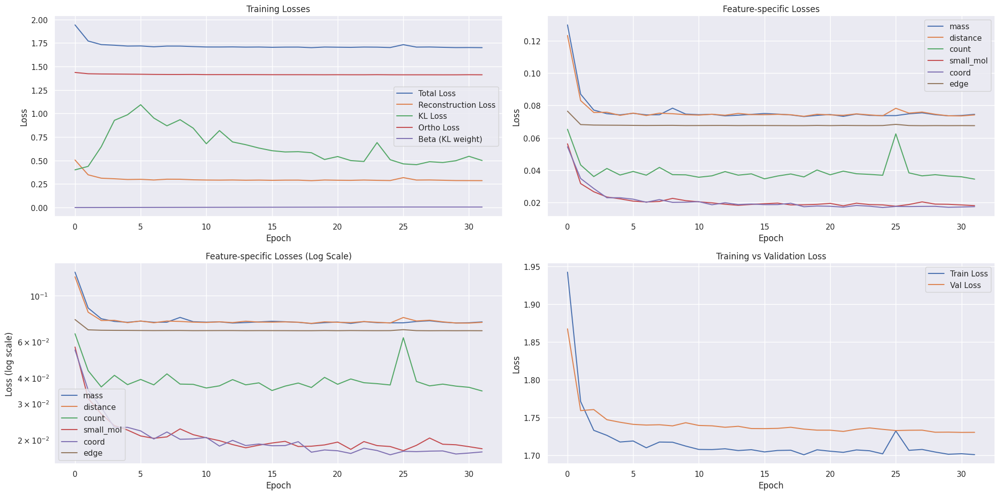

Epoch 33/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 17.93it/s, loss=1.6617, recon=0.2483, kl=0.6061, ortho=1.4104]


Detailed loss diagnostics:
Raw recon_loss: 0.6401
Raw KL loss: 0.4322
Ortho loss: 1.4111
Current beta: 0.0050
mu mean: -0.0546, std: 0.5711
logvar mean: -0.9502, std: 1.0124
mass: 0.0870
distance: 0.1368
count: 0.2986
small_mol: 0.0258
coord: 0.0177
edge: 0.0743


Epoch 33/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 19.03it/s, loss=1.6972, recon=0.2835, kl=0.5972, ortho=1.4107]


Detailed loss diagnostics:
Raw recon_loss: 0.2699
Raw KL loss: 1.0604
Ortho loss: 1.4110
Current beta: 0.0050
mu mean: -0.0798, std: 1.1030
logvar mean: -1.4859, std: 1.3225
mass: 0.0661
distance: 0.0667
count: 0.0254
small_mol: 0.0202
coord: 0.0259
edge: 0.0657


Epoch 33/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:00, 20.13it/s, loss=1.6981, recon=0.2834, kl=0.4370, ortho=1.4125]


Detailed loss diagnostics:
Raw recon_loss: 0.2835
Raw KL loss: 0.4662
Ortho loss: 1.4118
Current beta: 0.0050
mu mean: -0.0582, std: 0.6394
logvar mean: -0.9483, std: 0.9438
mass: 0.0763
distance: 0.0766
count: 0.0263
small_mol: 0.0201
coord: 0.0175
edge: 0.0668


Epoch 33/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 20.19it/s, loss=1.6804, recon=0.2670, kl=0.3882, ortho=1.4115]


Detailed loss diagnostics:
Raw recon_loss: 0.2523
Raw KL loss: 0.4969
Ortho loss: 1.4106
Current beta: 0.0050
mu mean: -0.1138, std: 0.7142
logvar mean: -0.8872, std: 0.8839
mass: 0.0653
distance: 0.0635
count: 0.0253
small_mol: 0.0154
coord: 0.0158
edge: 0.0671


Epoch 33/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.63it/s, loss=1.8066, recon=0.3782, kl=0.1847, ortho=1.4274]



Detailed loss diagnostics:
Raw recon_loss: 0.2706
Raw KL loss: 0.4073
Ortho loss: 1.4120
Current beta: 0.0050
mu mean: -0.0654, std: 0.5682
logvar mean: -0.8797, std: 0.9577
mass: 0.0718
distance: 0.0713
count: 0.0257
small_mol: 0.0181
coord: 0.0154
edge: 0.0683

Starting validation...


Epoch 33/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 63.86it/s]



Epoch [33/100] - Time: 2.48s
Train - Total: 1.7114, Recon: 0.2978, KL: 0.4863, Ortho: 1.4113, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0754
  distance_loss: 0.0763
  count_loss: 0.0427
  small_mol_loss: 0.0182
  coord_loss: 0.0174
  edge_loss: 0.0677


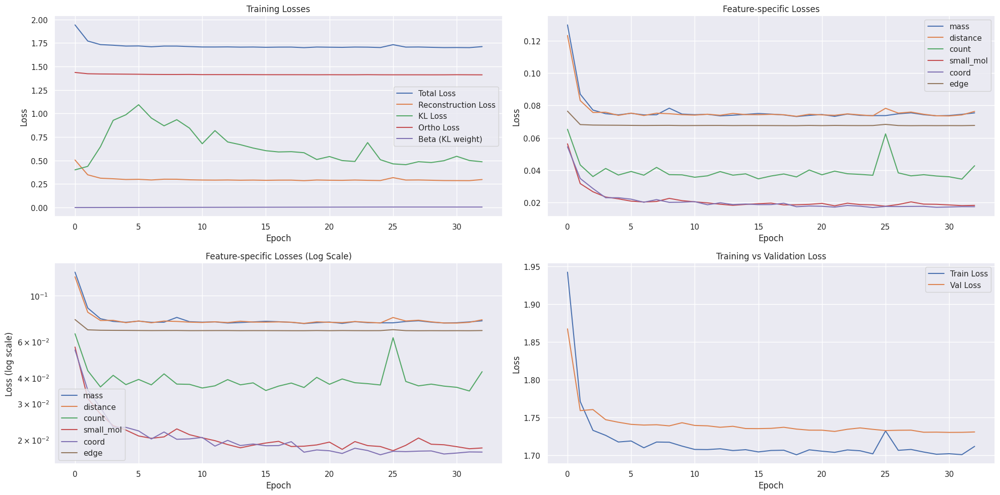

Epoch 34/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 15.58it/s, loss=1.6930, recon=0.2802, kl=0.4221, ortho=1.4107]


Detailed loss diagnostics:
Raw recon_loss: 0.4273
Raw KL loss: 0.6464
Ortho loss: 1.4109
Current beta: 0.0050
mu mean: -0.0931, std: 0.8280
logvar mean: -1.0844, std: 1.0211
mass: 0.0769
distance: 0.0902
count: 0.1591
small_mol: 0.0151
coord: 0.0176
edge: 0.0685


Epoch 34/100 [Train]:  29%|██▊       | 12/42 [00:00<00:01, 19.29it/s, loss=1.6656, recon=0.2522, kl=0.4834, ortho=1.4110]


Detailed loss diagnostics:
Raw recon_loss: 0.4107
Raw KL loss: 0.5009
Ortho loss: 1.4097
Current beta: 0.0050
mu mean: -0.1094, std: 0.6775
logvar mean: -0.9709, std: 0.9398
mass: 0.0763
distance: 0.1004
count: 0.1209
small_mol: 0.0189
coord: 0.0210
edge: 0.0731


Epoch 34/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 19.06it/s, loss=1.6502, recon=0.2379, kl=0.4570, ortho=1.4100]


Detailed loss diagnostics:
Raw recon_loss: 0.3614
Raw KL loss: 0.4013
Ortho loss: 1.4107
Current beta: 0.0050
mu mean: -0.0613, std: 0.5853
logvar mean: -0.8671, std: 0.8347
mass: 0.0702
distance: 0.0787
count: 0.1058
small_mol: 0.0193
coord: 0.0143
edge: 0.0730


Epoch 34/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 19.18it/s, loss=1.7458, recon=0.3339, kl=0.3902, ortho=1.4100]


Detailed loss diagnostics:
Raw recon_loss: 0.2805
Raw KL loss: 0.4657
Ortho loss: 1.4100
Current beta: 0.0050
mu mean: -0.0771, std: 0.6912
logvar mean: -0.8556, std: 0.9082
mass: 0.0768
distance: 0.0728
count: 0.0262
small_mol: 0.0178
coord: 0.0196
edge: 0.0672


Epoch 34/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.13it/s, loss=1.7915, recon=0.3587, kl=0.6181, ortho=1.4297]



Detailed loss diagnostics:
Raw recon_loss: 0.2418
Raw KL loss: 0.4520
Ortho loss: 1.4099
Current beta: 0.0050
mu mean: -0.0587, std: 0.6433
logvar mean: -0.8895, std: 0.9478
mass: 0.0629
distance: 0.0612
count: 0.0251
small_mol: 0.0132
coord: 0.0121
edge: 0.0674

Starting validation...


Epoch 34/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 65.75it/s]



Epoch [34/100] - Time: 2.52s
Train - Total: 1.7017, Recon: 0.2880, KL: 0.4701, Ortho: 1.4113, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0746
  distance_loss: 0.0741
  count_loss: 0.0362
  small_mol_loss: 0.0188
  coord_loss: 0.0168
  edge_loss: 0.0675


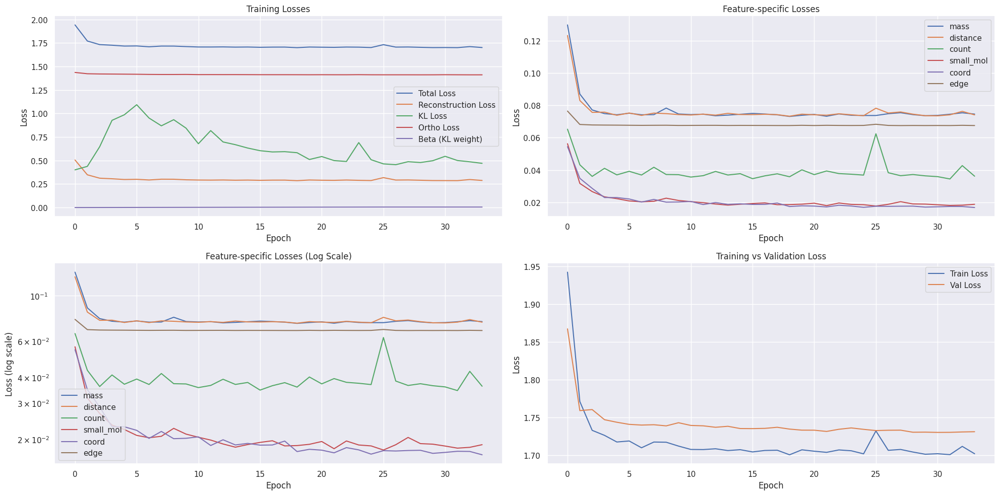

Epoch 35/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 19.17it/s, loss=1.7070, recon=0.2923, kl=0.4988, ortho=1.4123]


Detailed loss diagnostics:
Raw recon_loss: 0.2775
Raw KL loss: 0.6201
Ortho loss: 1.4109
Current beta: 0.0050
mu mean: 0.0049, std: 0.7373
logvar mean: -1.1741, std: 1.1789
mass: 0.0741
distance: 0.0756
count: 0.0260
small_mol: 0.0192
coord: 0.0156
edge: 0.0670


Epoch 35/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 20.21it/s, loss=1.6775, recon=0.2638, kl=0.3641, ortho=1.4119]


Detailed loss diagnostics:
Raw recon_loss: 0.3487
Raw KL loss: 0.4745
Ortho loss: 1.4110
Current beta: 0.0050
mu mean: -0.0388, std: 0.7099
logvar mean: -0.8611, std: 0.8688
mass: 0.0722
distance: 0.0847
count: 0.0918
small_mol: 0.0168
coord: 0.0134
edge: 0.0698


Epoch 35/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:00, 20.97it/s, loss=1.7222, recon=0.3098, kl=0.3615, ortho=1.4106]


Detailed loss diagnostics:
Raw recon_loss: 0.2700
Raw KL loss: 0.4704
Ortho loss: 1.4108
Current beta: 0.0050
mu mean: 0.0162, std: 0.7615
logvar mean: -0.6932, std: 0.9159
mass: 0.0728
distance: 0.0699
count: 0.0259
small_mol: 0.0108
coord: 0.0242
edge: 0.0664


Epoch 35/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 20.05it/s, loss=1.6905, recon=0.2783, kl=0.4533, ortho=1.4099]


Detailed loss diagnostics:
Raw recon_loss: 0.2870
Raw KL loss: 0.3974
Ortho loss: 1.4100
Current beta: 0.0050
mu mean: -0.0252, std: 0.6231
logvar mean: -0.8302, std: 0.8214
mass: 0.0644
distance: 0.0707
count: 0.0578
small_mol: 0.0090
coord: 0.0166
edge: 0.0685


Epoch 35/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 20.26it/s, loss=1.8037, recon=0.3726, kl=0.2808, ortho=1.4297]



Detailed loss diagnostics:
Raw recon_loss: 0.2579
Raw KL loss: 0.6678
Ortho loss: 1.4114
Current beta: 0.0050
mu mean: -0.0705, std: 0.7949
logvar mean: -1.2191, std: 1.0475
mass: 0.0663
distance: 0.0670
count: 0.0255
small_mol: 0.0177
coord: 0.0147
edge: 0.0666

Starting validation...


Epoch 35/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 67.65it/s]



Epoch [35/100] - Time: 2.39s
Train - Total: 1.7001, Recon: 0.2865, KL: 0.4681, Ortho: 1.4113, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0749
  distance_loss: 0.0744
  count_loss: 0.0347
  small_mol_loss: 0.0180
  coord_loss: 0.0170
  edge_loss: 0.0675


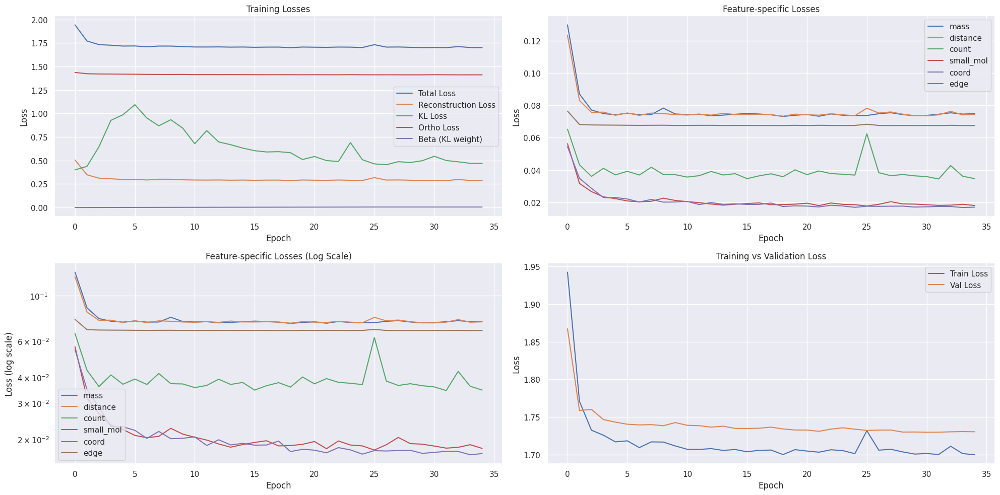

Epoch 36/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.92it/s, loss=1.6994, recon=0.2819, kl=0.9672, ortho=1.4127]


Detailed loss diagnostics:
Raw recon_loss: 0.2431
Raw KL loss: 0.5909
Ortho loss: 1.4104
Current beta: 0.0050
mu mean: -0.0781, std: 0.7762
logvar mean: -1.0783, std: 0.9701
mass: 0.0634
distance: 0.0626
count: 0.0252
small_mol: 0.0106
coord: 0.0131
edge: 0.0681


Epoch 36/100 [Train]:  29%|██▊       | 12/42 [00:00<00:01, 19.29it/s, loss=1.7150, recon=0.3015, kl=0.4419, ortho=1.4113]


Detailed loss diagnostics:
Raw recon_loss: 0.4313
Raw KL loss: 0.3993
Ortho loss: 1.4121
Current beta: 0.0050
mu mean: -0.0400, std: 0.5988
logvar mean: -0.8889, std: 0.8111
mass: 0.0731
distance: 0.0942
count: 0.1674
small_mol: 0.0143
coord: 0.0110
edge: 0.0712


Epoch 36/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 19.27it/s, loss=1.8077, recon=0.3929, kl=0.3992, ortho=1.4129]


Detailed loss diagnostics:
Raw recon_loss: 0.4241
Raw KL loss: 0.5001
Ortho loss: 1.4115
Current beta: 0.0050
mu mean: -0.0802, std: 0.6646
logvar mean: -1.0472, std: 0.8836
mass: 0.0894
distance: 0.0997
count: 0.1272
small_mol: 0.0205
coord: 0.0154
edge: 0.0719


Epoch 36/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 18.66it/s, loss=1.6777, recon=0.2635, kl=0.7414, ortho=1.4105]


Detailed loss diagnostics:
Raw recon_loss: 0.3094
Raw KL loss: 0.5324
Ortho loss: 1.4126
Current beta: 0.0050
mu mean: -0.0172, std: 0.6590
logvar mean: -1.1551, std: 0.9687
mass: 0.0849
distance: 0.0795
count: 0.0267
small_mol: 0.0346
coord: 0.0167
edge: 0.0670


Epoch 36/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 18.89it/s, loss=1.7739, recon=0.3360, kl=0.1983, ortho=1.4370]



Detailed loss diagnostics:
Raw recon_loss: 0.2860
Raw KL loss: 0.4660
Ortho loss: 1.4119
Current beta: 0.0050
mu mean: -0.1029, std: 0.6030
logvar mean: -1.0364, std: 0.9348
mass: 0.0778
distance: 0.0714
count: 0.0260
small_mol: 0.0226
coord: 0.0206
edge: 0.0676

Starting validation...


Epoch 36/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 64.03it/s]



Epoch [36/100] - Time: 2.56s
Train - Total: 1.7016, Recon: 0.2875, KL: 0.5236, Ortho: 1.4116, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0742
  distance_loss: 0.0742
  count_loss: 0.0372
  small_mol_loss: 0.0177
  coord_loss: 0.0166
  edge_loss: 0.0676


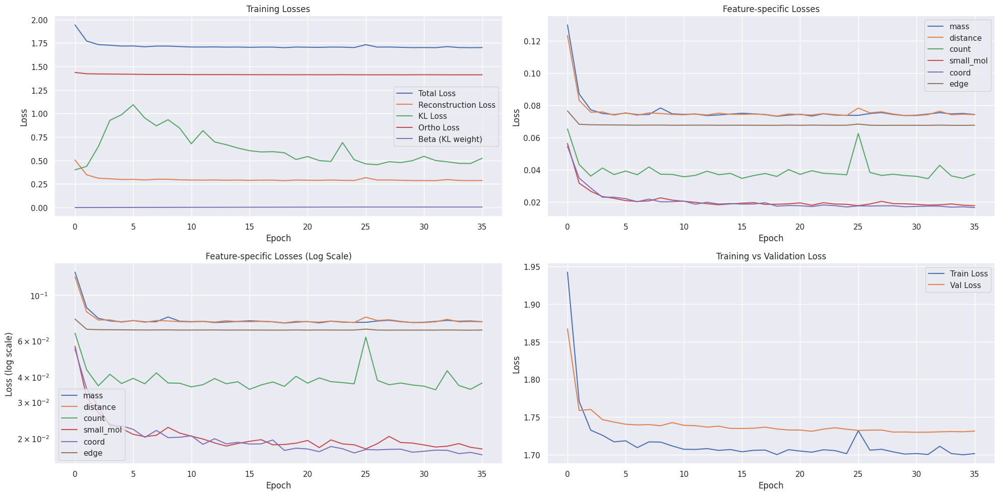

Epoch 37/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 19.34it/s, loss=1.8450, recon=0.4316, kl=0.5411, ortho=1.4107]


Detailed loss diagnostics:
Raw recon_loss: 0.2756
Raw KL loss: 0.4691
Ortho loss: 1.4113
Current beta: 0.0050
mu mean: -0.0674, std: 0.6268
logvar mean: -0.9789, std: 1.0029
mass: 0.0734
distance: 0.0743
count: 0.0258
small_mol: 0.0215
coord: 0.0123
edge: 0.0683


Epoch 37/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 21.04it/s, loss=1.8097, recon=0.3972, kl=0.3996, ortho=1.4105]


Detailed loss diagnostics:
Raw recon_loss: 0.2674
Raw KL loss: 0.3680
Ortho loss: 1.4106
Current beta: 0.0050
mu mean: -0.0231, std: 0.5636
logvar mean: -0.8490, std: 0.7872
mass: 0.0720
distance: 0.0689
count: 0.0258
small_mol: 0.0185
coord: 0.0152
edge: 0.0669


Epoch 37/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 20.46it/s, loss=1.7082, recon=0.2954, kl=0.5273, ortho=1.4102]


Detailed loss diagnostics:
Raw recon_loss: 0.2687
Raw KL loss: 0.3572
Ortho loss: 1.4114
Current beta: 0.0050
mu mean: -0.0349, std: 0.5694
logvar mean: -0.7613, std: 0.8217
mass: 0.0734
distance: 0.0699
count: 0.0259
small_mol: 0.0170
coord: 0.0151
edge: 0.0673


Epoch 37/100 [Train]:  76%|███████▌  | 32/42 [00:01<00:00, 20.25it/s, loss=1.6545, recon=0.2420, kl=0.5459, ortho=1.4098]


Detailed loss diagnostics:
Raw recon_loss: 0.2446
Raw KL loss: 0.4672
Ortho loss: 1.4112
Current beta: 0.0050
mu mean: -0.0441, std: 0.6989
logvar mean: -0.8454, std: 0.8909
mass: 0.0642
distance: 0.0630
count: 0.0253
small_mol: 0.0146
coord: 0.0109
edge: 0.0667


Epoch 37/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 20.22it/s, loss=1.8171, recon=0.3882, kl=0.3650, ortho=1.4271]



Detailed loss diagnostics:
Raw recon_loss: 0.2973
Raw KL loss: 0.6728
Ortho loss: 1.4104
Current beta: 0.0050
mu mean: -0.0869, std: 0.7697
logvar mean: -1.2913, std: 1.2643
mass: 0.0782
distance: 0.0764
count: 0.0264
small_mol: 0.0280
coord: 0.0215
edge: 0.0667

Starting validation...


Epoch 37/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 65.65it/s]



Epoch [37/100] - Time: 2.41s
Train - Total: 1.7031, Recon: 0.2893, KL: 0.4776, Ortho: 1.4114, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0749
  distance_loss: 0.0743
  count_loss: 0.0367
  small_mol_loss: 0.0188
  coord_loss: 0.0171
  edge_loss: 0.0675


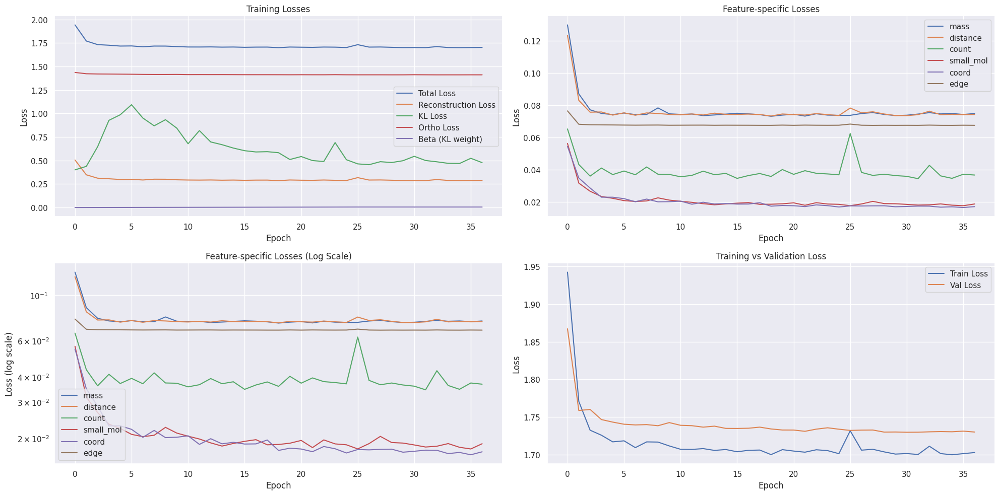

Epoch 38/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.85it/s, loss=1.6492, recon=0.2332, kl=0.6175, ortho=1.4129]


Detailed loss diagnostics:
Raw recon_loss: 0.2529
Raw KL loss: 0.4893
Ortho loss: 1.4106
Current beta: 0.0050
mu mean: -0.0313, std: 0.6149
logvar mean: -1.0802, std: 1.0474
mass: 0.0675
distance: 0.0678
count: 0.0255
small_mol: 0.0142
coord: 0.0108
edge: 0.0670


Epoch 38/100 [Train]:  29%|██▊       | 12/42 [00:00<00:01, 18.84it/s, loss=1.7046, recon=0.2892, kl=0.5785, ortho=1.4125]


Detailed loss diagnostics:
Raw recon_loss: 0.2352
Raw KL loss: 0.5416
Ortho loss: 1.4105
Current beta: 0.0050
mu mean: -0.1229, std: 0.6610
logvar mean: -1.1623, std: 0.9951
mass: 0.0620
distance: 0.0605
count: 0.0250
small_mol: 0.0100
coord: 0.0107
edge: 0.0669


Epoch 38/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 18.65it/s, loss=1.6677, recon=0.2532, kl=0.5768, ortho=1.4116]


Detailed loss diagnostics:
Raw recon_loss: 0.2954
Raw KL loss: 0.4014
Ortho loss: 1.4111
Current beta: 0.0050
mu mean: -0.0371, std: 0.6253
logvar mean: -0.8097, std: 0.8264
mass: 0.0826
distance: 0.0764
count: 0.0265
small_mol: 0.0202
coord: 0.0212
edge: 0.0685


Epoch 38/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 19.48it/s, loss=1.6615, recon=0.2489, kl=0.6389, ortho=1.4094]


Detailed loss diagnostics:
Raw recon_loss: 0.2361
Raw KL loss: 0.4406
Ortho loss: 1.4110
Current beta: 0.0050
mu mean: -0.0489, std: 0.6891
logvar mean: -0.7741, std: 0.8546
mass: 0.0605
distance: 0.0606
count: 0.0251
small_mol: 0.0094
coord: 0.0140
edge: 0.0664


Epoch 38/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.33it/s, loss=1.7527, recon=0.3210, kl=0.4611, ortho=1.4294]



Detailed loss diagnostics:
Raw recon_loss: 0.2723
Raw KL loss: 0.4214
Ortho loss: 1.4108
Current beta: 0.0050
mu mean: -0.1126, std: 0.6240
logvar mean: -0.8020, std: 0.9268
mass: 0.0736
distance: 0.0724
count: 0.0261
small_mol: 0.0171
coord: 0.0165
edge: 0.0666

Starting validation...


Epoch 38/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 69.10it/s]



Epoch [38/100] - Time: 2.49s
Train - Total: 1.7002, Recon: 0.2862, KL: 0.5373, Ortho: 1.4113, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0730
  distance_loss: 0.0733
  count_loss: 0.0379
  small_mol_loss: 0.0183
  coord_loss: 0.0161
  edge_loss: 0.0676


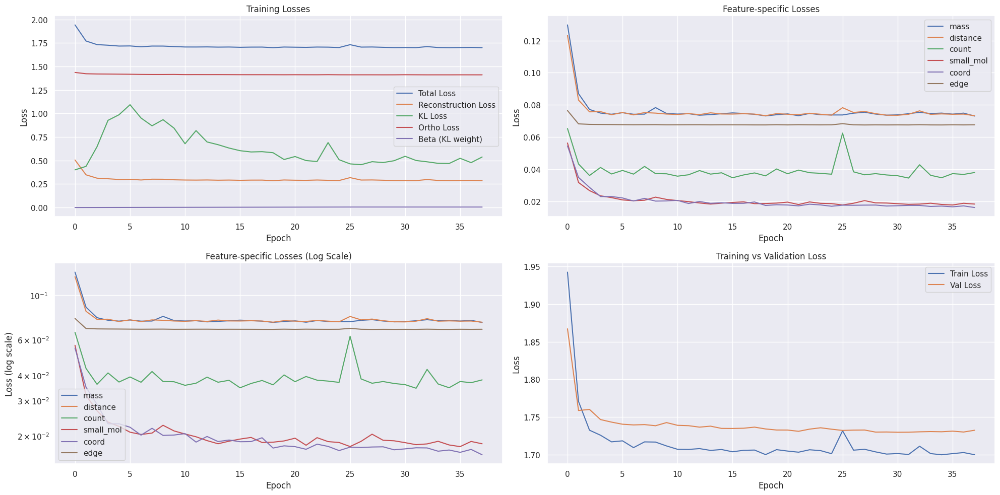

Epoch 39/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.88it/s, loss=1.6799, recon=0.2660, kl=0.4562, ortho=1.4116]


Detailed loss diagnostics:
Raw recon_loss: 0.2798
Raw KL loss: 0.4850
Ortho loss: 1.4111
Current beta: 0.0050
mu mean: -0.0685, std: 0.6721
logvar mean: -0.9105, std: 1.0295
mass: 0.0782
distance: 0.0749
count: 0.0262
small_mol: 0.0195
coord: 0.0147
edge: 0.0664


Epoch 39/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 19.45it/s, loss=1.7075, recon=0.2944, kl=0.5131, ortho=1.4105]


Detailed loss diagnostics:
Raw recon_loss: 0.2915
Raw KL loss: 0.5432
Ortho loss: 1.4123
Current beta: 0.0050
mu mean: -0.0278, std: 0.7459
logvar mean: -0.9959, std: 0.9467
mass: 0.0791
distance: 0.0774
count: 0.0264
small_mol: 0.0236
coord: 0.0180
edge: 0.0670


Epoch 39/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:01, 18.98it/s, loss=1.6623, recon=0.2502, kl=0.3771, ortho=1.4102]


Detailed loss diagnostics:
Raw recon_loss: 0.3089
Raw KL loss: 0.5183
Ortho loss: 1.4114
Current beta: 0.0050
mu mean: -0.0998, std: 0.6719
logvar mean: -1.0982, std: 0.8860
mass: 0.0842
distance: 0.0827
count: 0.0269
small_mol: 0.0281
coord: 0.0200
edge: 0.0670


Epoch 39/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 19.56it/s, loss=1.6852, recon=0.2729, kl=0.4565, ortho=1.4100]


Detailed loss diagnostics:
Raw recon_loss: 0.2617
Raw KL loss: 0.4354
Ortho loss: 1.4103
Current beta: 0.0050
mu mean: -0.0749, std: 0.6154
logvar mean: -0.9189, std: 0.8883
mass: 0.0713
distance: 0.0687
count: 0.0258
small_mol: 0.0163
coord: 0.0122
edge: 0.0674


Epoch 39/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.31it/s, loss=1.8276, recon=0.3977, kl=0.4342, ortho=1.4277]



Detailed loss diagnostics:
Raw recon_loss: 0.2706
Raw KL loss: 0.4186
Ortho loss: 1.4115
Current beta: 0.0050
mu mean: -0.0928, std: 0.6626
logvar mean: -0.7749, std: 0.8100
mass: 0.0753
distance: 0.0740
count: 0.0262
small_mol: 0.0104
coord: 0.0182
edge: 0.0664

Starting validation...


Epoch 39/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 68.59it/s]



Epoch [39/100] - Time: 2.49s
Train - Total: 1.6994, Recon: 0.2860, KL: 0.4763, Ortho: 1.4110, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0730
  distance_loss: 0.0733
  count_loss: 0.0367
  small_mol_loss: 0.0192
  coord_loss: 0.0163
  edge_loss: 0.0675


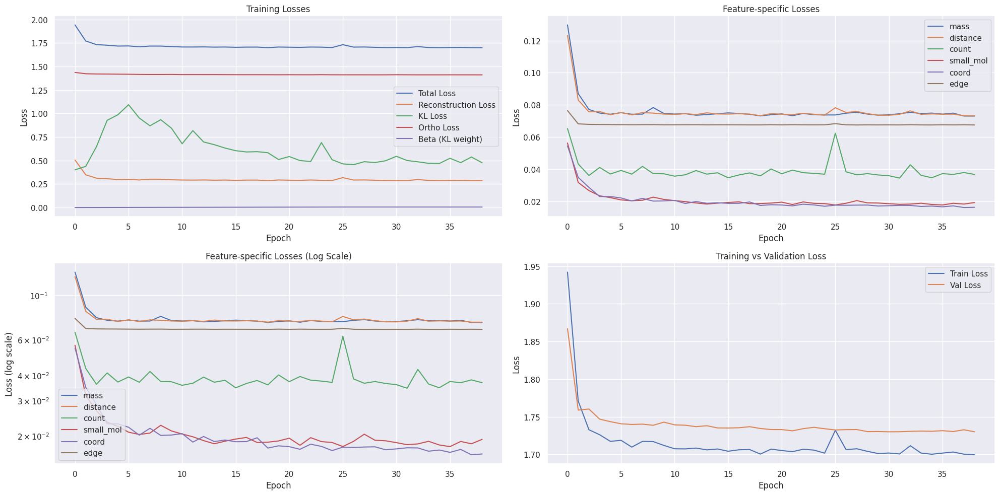

Epoch 40/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 18.12it/s, loss=1.7118, recon=0.2986, kl=0.5374, ortho=1.4105]


Detailed loss diagnostics:
Raw recon_loss: 0.2494
Raw KL loss: 0.3861
Ortho loss: 1.4113
Current beta: 0.0050
mu mean: -0.0488, std: 0.6189
logvar mean: -0.7383, std: 0.8349
mass: 0.0676
distance: 0.0669
count: 0.0256
small_mol: 0.0146
coord: 0.0083
edge: 0.0664


Epoch 40/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 20.82it/s, loss=1.8003, recon=0.3857, kl=0.3255, ortho=1.4130]


Detailed loss diagnostics:
Raw recon_loss: 0.2537
Raw KL loss: 0.4513
Ortho loss: 1.4119
Current beta: 0.0050
mu mean: -0.0125, std: 0.7140
logvar mean: -0.6340, std: 0.9702
mass: 0.0688
distance: 0.0674
count: 0.0256
small_mol: 0.0107
coord: 0.0150
edge: 0.0662


Epoch 40/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 19.91it/s, loss=1.6991, recon=0.2857, kl=0.4791, ortho=1.4110]


Detailed loss diagnostics:
Raw recon_loss: 0.2876
Raw KL loss: 0.5166
Ortho loss: 1.4109
Current beta: 0.0050
mu mean: -0.0661, std: 0.6727
logvar mean: -1.0412, std: 0.9891
mass: 0.0754
distance: 0.0717
count: 0.0261
small_mol: 0.0280
coord: 0.0196
edge: 0.0669


Epoch 40/100 [Train]:  76%|███████▌  | 32/42 [00:01<00:00, 20.06it/s, loss=1.7433, recon=0.3305, kl=0.4218, ortho=1.4107]


Detailed loss diagnostics:
Raw recon_loss: 0.2430
Raw KL loss: 0.3517
Ortho loss: 1.4115
Current beta: 0.0050
mu mean: 0.0020, std: 0.5887
logvar mean: -0.6260, std: 0.8869
mass: 0.0643
distance: 0.0644
count: 0.0254
small_mol: 0.0144
coord: 0.0076
edge: 0.0668


Epoch 40/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 20.08it/s, loss=1.9102, recon=0.4774, kl=0.3621, ortho=1.4310]



Detailed loss diagnostics:
Raw recon_loss: 0.2809
Raw KL loss: 0.4059
Ortho loss: 1.4105
Current beta: 0.0050
mu mean: -0.0531, std: 0.6130
logvar mean: -0.8194, std: 0.8658
mass: 0.0745
distance: 0.0721
count: 0.0259
small_mol: 0.0250
coord: 0.0154
edge: 0.0680

Starting validation...


Epoch 40/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 69.81it/s]



Epoch [40/100] - Time: 2.40s
Train - Total: 1.7025, Recon: 0.2888, KL: 0.4527, Ortho: 1.4114, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0742
  distance_loss: 0.0737
  count_loss: 0.0356
  small_mol_loss: 0.0211
  coord_loss: 0.0168
  edge_loss: 0.0674


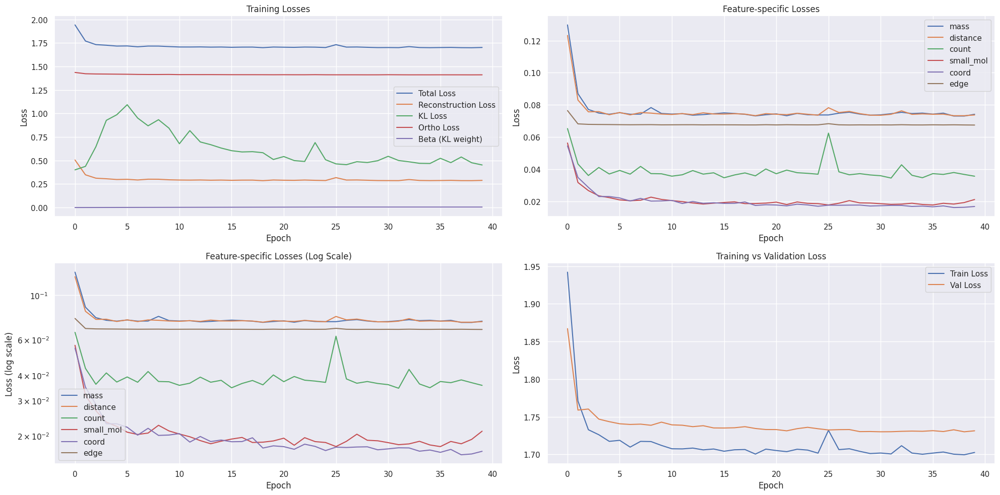

Epoch 41/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.59it/s, loss=1.6941, recon=0.2806, kl=0.5190, ortho=1.4109]


Detailed loss diagnostics:
Raw recon_loss: 0.2834
Raw KL loss: 0.4248
Ortho loss: 1.4098
Current beta: 0.0050
mu mean: -0.0142, std: 0.6493
logvar mean: -0.7592, std: 0.9420
mass: 0.0781
distance: 0.0771
count: 0.0265
small_mol: 0.0187
coord: 0.0157
edge: 0.0674


Epoch 41/100 [Train]:  29%|██▊       | 12/42 [00:00<00:01, 19.72it/s, loss=1.6782, recon=0.2640, kl=0.4687, ortho=1.4119]


Detailed loss diagnostics:
Raw recon_loss: 0.2277
Raw KL loss: 0.4280
Ortho loss: 1.4096
Current beta: 0.0050
mu mean: -0.0438, std: 0.6364
logvar mean: -0.8419, std: 0.9148
mass: 0.0586
distance: 0.0580
count: 0.0248
small_mol: 0.0137
coord: 0.0067
edge: 0.0659


Epoch 41/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 19.65it/s, loss=1.6772, recon=0.2643, kl=0.4428, ortho=1.4107]


Detailed loss diagnostics:
Raw recon_loss: 0.4156
Raw KL loss: 0.4065
Ortho loss: 1.4115
Current beta: 0.0050
mu mean: -0.0542, std: 0.6521
logvar mean: -0.6800, std: 0.9332
mass: 0.0858
distance: 0.0997
count: 0.1280
small_mol: 0.0127
coord: 0.0192
edge: 0.0702


Epoch 41/100 [Train]:  76%|███████▌  | 32/42 [00:01<00:00, 20.06it/s, loss=1.6768, recon=0.2650, kl=0.3414, ortho=1.4101]


Detailed loss diagnostics:
Raw recon_loss: 0.2493
Raw KL loss: 0.5348
Ortho loss: 1.4108
Current beta: 0.0050
mu mean: -0.0726, std: 0.7573
logvar mean: -0.8559, std: 1.0059
mass: 0.0645
distance: 0.0662
count: 0.0253
small_mol: 0.0124
coord: 0.0133
edge: 0.0676


Epoch 41/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 20.00it/s, loss=1.8201, recon=0.3866, kl=0.2574, ortho=1.4321]



Detailed loss diagnostics:
Raw recon_loss: 0.2937
Raw KL loss: 0.3206
Ortho loss: 1.4095
Current beta: 0.0050
mu mean: -0.0321, std: 0.5502
logvar mean: -0.6621, std: 0.7791
mass: 0.0802
distance: 0.0793
count: 0.0263
small_mol: 0.0258
coord: 0.0145
edge: 0.0675

Starting validation...


Epoch 41/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 67.90it/s]



Epoch [41/100] - Time: 2.42s
Train - Total: 1.7053, Recon: 0.2917, KL: 0.4605, Ortho: 1.4113, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0747
  distance_loss: 0.0748
  count_loss: 0.0393
  small_mol_loss: 0.0185
  coord_loss: 0.0169
  edge_loss: 0.0675


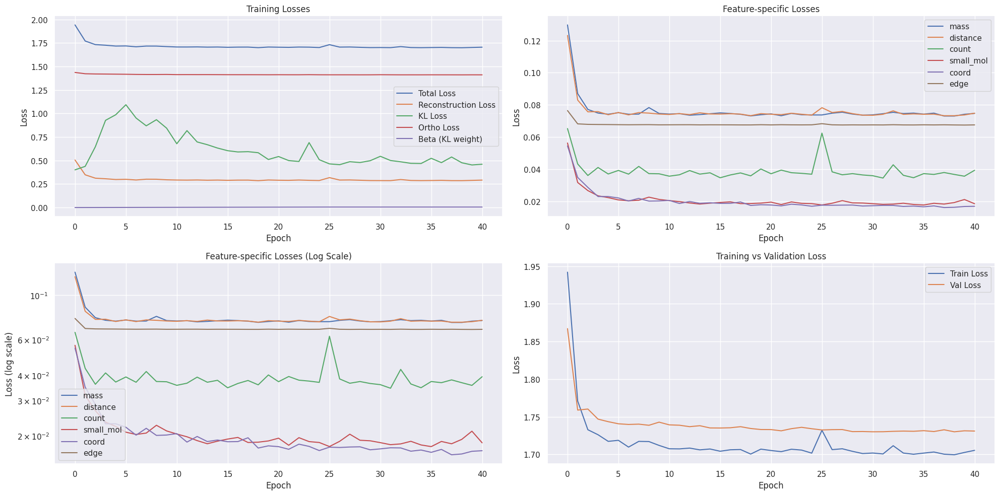

Epoch 42/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.70it/s, loss=1.7032, recon=0.2892, kl=0.4465, ortho=1.4117]


Detailed loss diagnostics:
Raw recon_loss: 0.2643
Raw KL loss: 0.4175
Ortho loss: 1.4106
Current beta: 0.0050
mu mean: -0.0170, std: 0.6592
logvar mean: -0.7867, std: 0.8294
mass: 0.0715
distance: 0.0704
count: 0.0258
small_mol: 0.0194
coord: 0.0112
edge: 0.0660


Epoch 42/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 19.28it/s, loss=1.7014, recon=0.2887, kl=0.4398, ortho=1.4105]


Detailed loss diagnostics:
Raw recon_loss: 0.2804
Raw KL loss: 0.5549
Ortho loss: 1.4134
Current beta: 0.0050
mu mean: -0.0411, std: 0.7908
logvar mean: -0.9382, std: 0.9155
mass: 0.0746
distance: 0.0733
count: 0.0262
small_mol: 0.0195
coord: 0.0198
edge: 0.0669


Epoch 42/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 20.31it/s, loss=1.6860, recon=0.2724, kl=0.4427, ortho=1.4114]


Detailed loss diagnostics:
Raw recon_loss: 0.3061
Raw KL loss: 0.4414
Ortho loss: 1.4093
Current beta: 0.0050
mu mean: -0.0716, std: 0.6662
logvar mean: -0.7871, std: 1.0365
mass: 0.0794
distance: 0.0851
count: 0.0346
small_mol: 0.0148
coord: 0.0232
edge: 0.0690


Epoch 42/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 19.75it/s, loss=1.7571, recon=0.3449, kl=0.4744, ortho=1.4099]


Detailed loss diagnostics:
Raw recon_loss: 0.2615
Raw KL loss: 0.4552
Ortho loss: 1.4094
Current beta: 0.0050
mu mean: -0.1168, std: 0.6729
logvar mean: -0.8631, std: 0.8753
mass: 0.0719
distance: 0.0672
count: 0.0257
small_mol: 0.0141
coord: 0.0150
edge: 0.0676


Epoch 42/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.43it/s, loss=1.9479, recon=0.5115, kl=2.0597, ortho=1.4260]



Detailed loss diagnostics:
Raw recon_loss: 0.3054
Raw KL loss: 0.6257
Ortho loss: 1.4107
Current beta: 0.0050
mu mean: -0.1063, std: 0.8091
logvar mean: -1.1111, std: 0.9458
mass: 0.0635
distance: 0.0704
count: 0.0669
small_mol: 0.0172
coord: 0.0179
edge: 0.0695

Starting validation...


Epoch 42/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 68.67it/s]



Epoch [42/100] - Time: 2.48s
Train - Total: 1.7023, Recon: 0.2889, KL: 0.4738, Ortho: 1.4110, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0737
  distance_loss: 0.0732
  count_loss: 0.0353
  small_mol_loss: 0.0178
  coord_loss: 0.0213
  edge_loss: 0.0675


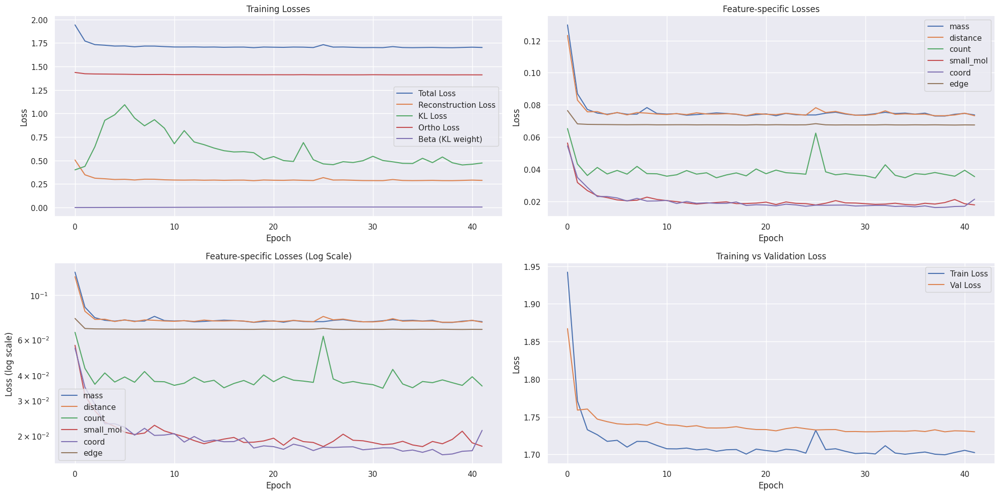

Epoch 43/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 17.11it/s, loss=1.7294, recon=0.3173, kl=0.3805, ortho=1.4102]


Detailed loss diagnostics:
Raw recon_loss: 0.2795
Raw KL loss: 0.4667
Ortho loss: 1.4094
Current beta: 0.0050
mu mean: -0.0499, std: 0.6741
logvar mean: -0.8884, std: 1.0198
mass: 0.0812
distance: 0.0695
count: 0.0258
small_mol: 0.0189
coord: 0.0175
edge: 0.0665


Epoch 43/100 [Train]:  29%|██▊       | 12/42 [00:00<00:01, 20.16it/s, loss=1.6771, recon=0.2639, kl=0.4744, ortho=1.4108]


Detailed loss diagnostics:
Raw recon_loss: 0.2847
Raw KL loss: 0.4931
Ortho loss: 1.4111
Current beta: 0.0050
mu mean: -0.0564, std: 0.5817
logvar mean: -1.1634, std: 0.9927
mass: 0.0759
distance: 0.0726
count: 0.0261
small_mol: 0.0251
coord: 0.0177
edge: 0.0674


Epoch 43/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:01, 19.34it/s, loss=1.6863, recon=0.2723, kl=0.6138, ortho=1.4110]


Detailed loss diagnostics:
Raw recon_loss: 0.3016
Raw KL loss: 0.6743
Ortho loss: 1.4103
Current beta: 0.0050
mu mean: -0.0994, std: 0.8263
logvar mean: -1.2038, std: 1.0144
mass: 0.0647
distance: 0.0733
count: 0.0689
small_mol: 0.0130
coord: 0.0109
edge: 0.0707


Epoch 43/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 19.36it/s, loss=1.6809, recon=0.2693, kl=0.4282, ortho=1.4095]


Detailed loss diagnostics:
Raw recon_loss: 0.2813
Raw KL loss: 0.4476
Ortho loss: 1.4104
Current beta: 0.0050
mu mean: -0.0381, std: 0.6383
logvar mean: -0.8395, std: 1.0197
mass: 0.0740
distance: 0.0710
count: 0.0260
small_mol: 0.0146
coord: 0.0286
edge: 0.0671


Epoch 43/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.67it/s, loss=1.8195, recon=0.3913, kl=0.3283, ortho=1.4265]



Detailed loss diagnostics:
Raw recon_loss: 0.2737
Raw KL loss: 0.5202
Ortho loss: 1.4104
Current beta: 0.0050
mu mean: -0.0921, std: 0.6532
logvar mean: -1.1733, std: 0.8412
mass: 0.0723
distance: 0.0711
count: 0.0258
small_mol: 0.0231
coord: 0.0143
edge: 0.0671

Starting validation...


Epoch 43/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 70.42it/s]



Epoch [43/100] - Time: 2.44s
Train - Total: 1.7030, Recon: 0.2895, KL: 0.5015, Ortho: 1.4110, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0738
  distance_loss: 0.0749
  count_loss: 0.0385
  small_mol_loss: 0.0181
  coord_loss: 0.0167
  edge_loss: 0.0676


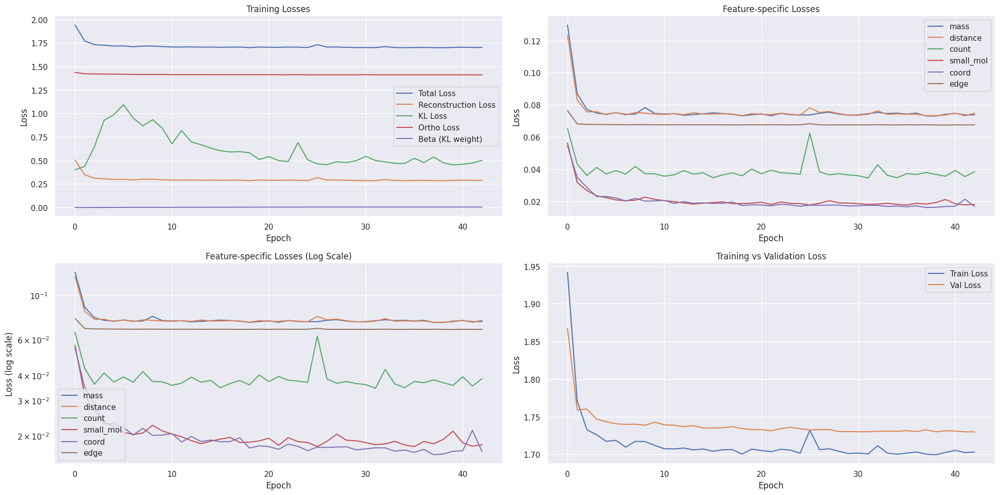

Epoch 44/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 17.16it/s, loss=1.6950, recon=0.2832, kl=0.5189, ortho=1.4092]


Detailed loss diagnostics:
Raw recon_loss: 0.3093
Raw KL loss: 0.6311
Ortho loss: 1.4093
Current beta: 0.0050
mu mean: -0.0629, std: 0.7510
logvar mean: -1.1887, std: 1.1879
mass: 0.0810
distance: 0.0801
count: 0.0265
small_mol: 0.0316
coord: 0.0226
edge: 0.0676


Epoch 44/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 20.00it/s, loss=1.6584, recon=0.2469, kl=0.3851, ortho=1.4096]


Detailed loss diagnostics:
Raw recon_loss: 0.2511
Raw KL loss: 0.4644
Ortho loss: 1.4109
Current beta: 0.0050
mu mean: -0.0199, std: 0.7099
logvar mean: -0.8221, std: 0.8840
mass: 0.0661
distance: 0.0642
count: 0.0254
small_mol: 0.0137
coord: 0.0147
edge: 0.0670


Epoch 44/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:01, 19.17it/s, loss=1.9283, recon=0.5163, kl=0.4542, ortho=1.4097]


Detailed loss diagnostics:
Raw recon_loss: 0.2740
Raw KL loss: 0.4904
Ortho loss: 1.4095
Current beta: 0.0050
mu mean: -0.0575, std: 0.7147
logvar mean: -0.8604, std: 0.9335
mass: 0.0745
distance: 0.0732
count: 0.0261
small_mol: 0.0163
coord: 0.0169
edge: 0.0669


Epoch 44/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 19.66it/s, loss=1.6523, recon=0.2393, kl=0.5391, ortho=1.4103]


Detailed loss diagnostics:
Raw recon_loss: 0.2733
Raw KL loss: 0.4627
Ortho loss: 1.4114
Current beta: 0.0050
mu mean: -0.0889, std: 0.6480
logvar mean: -0.9660, std: 0.8765
mass: 0.0752
distance: 0.0727
count: 0.0261
small_mol: 0.0173
coord: 0.0149
edge: 0.0671


Epoch 44/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.57it/s, loss=1.8195, recon=0.3904, kl=0.5780, ortho=1.4262]



Detailed loss diagnostics:
Raw recon_loss: 0.2658
Raw KL loss: 0.9604
Ortho loss: 1.4102
Current beta: 0.0050
mu mean: -0.0861, std: 1.0814
logvar mean: -1.2700, std: 1.2605
mass: 0.0642
distance: 0.0628
count: 0.0253
small_mol: 0.0139
coord: 0.0334
edge: 0.0662

Starting validation...


Epoch 44/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 70.63it/s]



Epoch [44/100] - Time: 2.45s
Train - Total: 1.7039, Recon: 0.2908, KL: 0.4807, Ortho: 1.4107, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0757
  distance_loss: 0.0755
  count_loss: 0.0359
  small_mol_loss: 0.0192
  coord_loss: 0.0170
  edge_loss: 0.0675


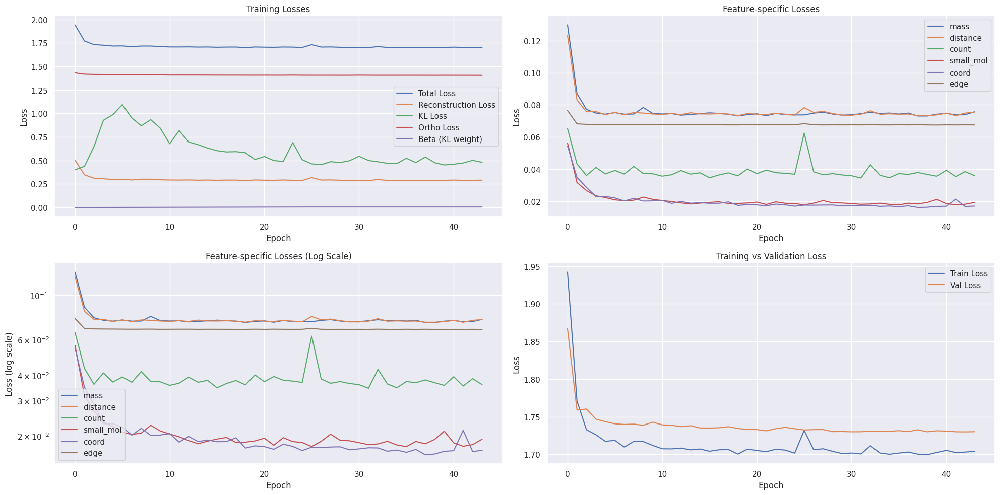

Epoch 45/100 [Train]:  10%|▉         | 4/42 [00:00<00:01, 19.40it/s, loss=1.6457, recon=0.2327, kl=0.4090, ortho=1.4110]


Detailed loss diagnostics:
Raw recon_loss: 0.2621
Raw KL loss: 0.5529
Ortho loss: 1.4103
Current beta: 0.0050
mu mean: -0.0304, std: 0.7579
logvar mean: -0.9935, std: 0.9347
mass: 0.0676
distance: 0.0680
count: 0.0256
small_mol: 0.0176
coord: 0.0163
edge: 0.0671


Epoch 45/100 [Train]:  29%|██▊       | 12/42 [00:00<00:01, 19.38it/s, loss=1.6651, recon=0.2505, kl=0.4825, ortho=1.4122]


Detailed loss diagnostics:
Raw recon_loss: 0.2819
Raw KL loss: 0.3836
Ortho loss: 1.4105
Current beta: 0.0050
mu mean: -0.0638, std: 0.6072
logvar mean: -0.7929, std: 0.7888
mass: 0.0753
distance: 0.0757
count: 0.0260
small_mol: 0.0252
coord: 0.0122
edge: 0.0675


Epoch 45/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 19.52it/s, loss=1.6984, recon=0.2854, kl=0.4127, ortho=1.4110]


Detailed loss diagnostics:
Raw recon_loss: 0.2632
Raw KL loss: 0.5266
Ortho loss: 1.4102
Current beta: 0.0050
mu mean: -0.0858, std: 0.6951
logvar mean: -1.0676, std: 0.9294
mass: 0.0690
distance: 0.0668
count: 0.0257
small_mol: 0.0147
coord: 0.0198
edge: 0.0672


Epoch 45/100 [Train]:  76%|███████▌  | 32/42 [00:01<00:00, 20.19it/s, loss=1.6997, recon=0.2870, kl=0.4471, ortho=1.4104]


Detailed loss diagnostics:
Raw recon_loss: 0.2973
Raw KL loss: 0.5993
Ortho loss: 1.4110
Current beta: 0.0050
mu mean: -0.0898, std: 0.7676
logvar mean: -1.1427, std: 0.9185
mass: 0.0833
distance: 0.0800
count: 0.0266
small_mol: 0.0186
coord: 0.0222
edge: 0.0666


Epoch 45/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.86it/s, loss=1.7850, recon=0.3571, kl=0.3896, ortho=1.4259]



Detailed loss diagnostics:
Raw recon_loss: 0.2947
Raw KL loss: 0.4989
Ortho loss: 1.4118
Current beta: 0.0050
mu mean: -0.0507, std: 0.6973
logvar mean: -0.9380, std: 0.9586
mass: 0.0623
distance: 0.0730
count: 0.0692
small_mol: 0.0111
coord: 0.0086
edge: 0.0704

Starting validation...


Epoch 45/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 64.77it/s]



Epoch [45/100] - Time: 2.45s
Train - Total: 1.6958, Recon: 0.2828, KL: 0.4573, Ortho: 1.4108, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0734
  distance_loss: 0.0730
  count_loss: 0.0348
  small_mol_loss: 0.0180
  coord_loss: 0.0162
  edge_loss: 0.0675


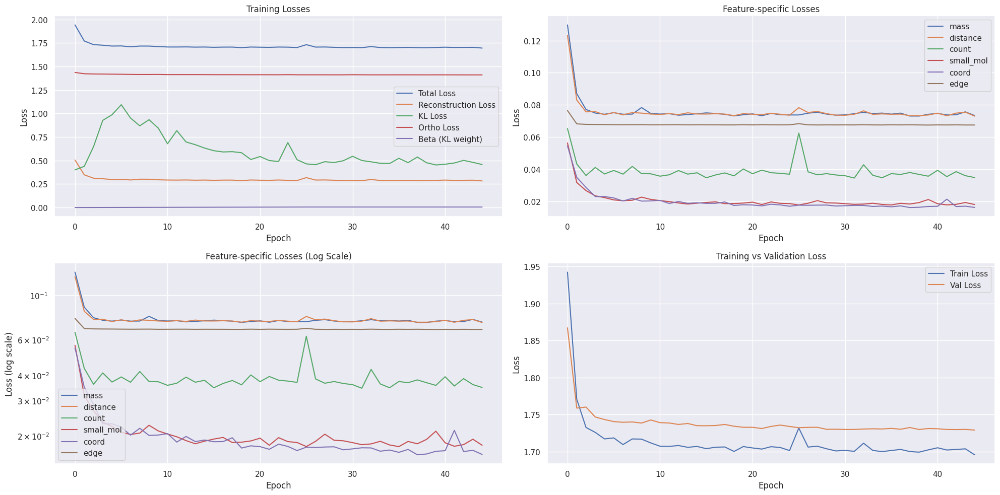

Epoch 46/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 17.30it/s, loss=1.8109, recon=0.3968, kl=0.5644, ortho=1.4112]


Detailed loss diagnostics:
Raw recon_loss: 0.2561
Raw KL loss: 0.5631
Ortho loss: 1.4117
Current beta: 0.0050
mu mean: -0.0983, std: 0.7583
logvar mean: -1.0552, std: 1.0127
mass: 0.0666
distance: 0.0657
count: 0.0255
small_mol: 0.0115
coord: 0.0203
edge: 0.0665


Epoch 46/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 19.62it/s, loss=1.6545, recon=0.2416, kl=0.5457, ortho=1.4101]


Detailed loss diagnostics:
Raw recon_loss: 0.2398
Raw KL loss: 0.5439
Ortho loss: 1.4099
Current beta: 0.0050
mu mean: -0.0696, std: 0.7289
logvar mean: -1.0875, std: 0.8915
mass: 0.0630
distance: 0.0609
count: 0.0251
small_mol: 0.0125
coord: 0.0104
edge: 0.0679


Epoch 46/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 19.33it/s, loss=1.7278, recon=0.3161, kl=0.3654, ortho=1.4099]


Detailed loss diagnostics:
Raw recon_loss: 0.2838
Raw KL loss: 0.4091
Ortho loss: 1.4120
Current beta: 0.0050
mu mean: -0.0534, std: 0.5639
logvar mean: -0.9668, std: 0.8808
mass: 0.0749
distance: 0.0713
count: 0.0260
small_mol: 0.0197
coord: 0.0259
edge: 0.0660


Epoch 46/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 20.02it/s, loss=1.6884, recon=0.2754, kl=0.4813, ortho=1.4106]


Detailed loss diagnostics:
Raw recon_loss: 0.3265
Raw KL loss: 0.3974
Ortho loss: 1.4111
Current beta: 0.0050
mu mean: -0.0847, std: 0.5564
logvar mean: -0.9687, std: 0.8081
mass: 0.0911
distance: 0.0846
count: 0.0270
small_mol: 0.0356
coord: 0.0221
edge: 0.0661


Epoch 46/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.48it/s, loss=1.7366, recon=0.3007, kl=0.3688, ortho=1.4341]



Detailed loss diagnostics:
Raw recon_loss: 0.2752
Raw KL loss: 0.5064
Ortho loss: 1.4099
Current beta: 0.0050
mu mean: -0.0374, std: 0.6891
logvar mean: -0.9676, std: 1.0108
mass: 0.0718
distance: 0.0702
count: 0.0258
small_mol: 0.0168
coord: 0.0237
edge: 0.0669

Starting validation...


Epoch 46/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 67.37it/s]



Epoch [46/100] - Time: 2.47s
Train - Total: 1.6994, Recon: 0.2859, KL: 0.4781, Ortho: 1.4111, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0736
  distance_loss: 0.0738
  count_loss: 0.0371
  small_mol_loss: 0.0178
  coord_loss: 0.0161
  edge_loss: 0.0675


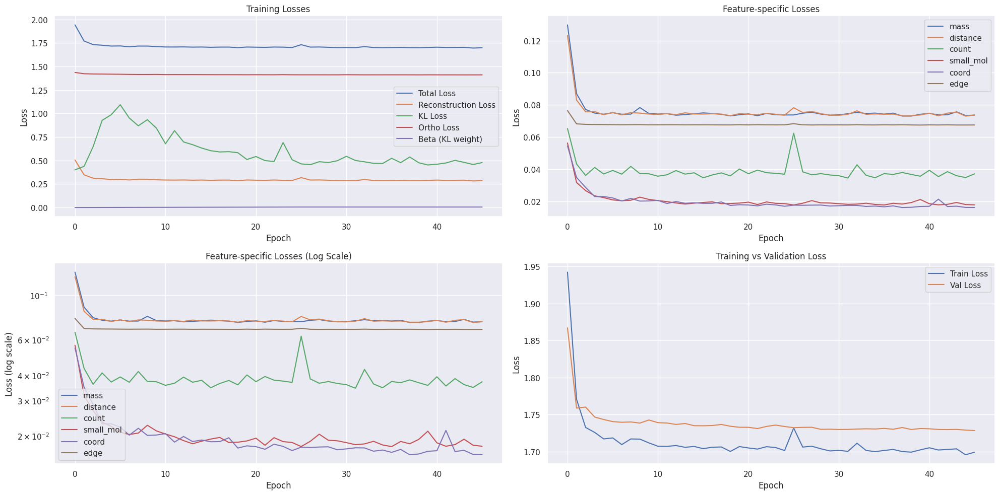

Epoch 47/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 19.26it/s, loss=1.6619, recon=0.2477, kl=0.7318, ortho=1.4105]


Detailed loss diagnostics:
Raw recon_loss: 0.2633
Raw KL loss: 0.4454
Ortho loss: 1.4093
Current beta: 0.0050
mu mean: -0.0515, std: 0.6570
logvar mean: -0.8738, std: 0.8960
mass: 0.0721
distance: 0.0704
count: 0.0259
small_mol: 0.0149
coord: 0.0129
edge: 0.0671


Epoch 47/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 20.09it/s, loss=1.8627, recon=0.4487, kl=0.7504, ortho=1.4103]


Detailed loss diagnostics:
Raw recon_loss: 0.2913
Raw KL loss: 0.4863
Ortho loss: 1.4117
Current beta: 0.0050
mu mean: -0.0113, std: 0.7080
logvar mean: -0.9102, std: 0.8791
mass: 0.0778
distance: 0.0773
count: 0.0263
small_mol: 0.0203
coord: 0.0224
edge: 0.0672


Epoch 47/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 20.03it/s, loss=1.7009, recon=0.2891, kl=0.4704, ortho=1.4094]


Detailed loss diagnostics:
Raw recon_loss: 0.2569
Raw KL loss: 0.4616
Ortho loss: 1.4102
Current beta: 0.0050
mu mean: -0.0585, std: 0.6350
logvar mean: -0.9482, std: 0.9403
mass: 0.0667
distance: 0.0677
count: 0.0255
small_mol: 0.0172
coord: 0.0121
edge: 0.0677


Epoch 47/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 20.51it/s, loss=1.6885, recon=0.2746, kl=0.4890, ortho=1.4114]


Detailed loss diagnostics:
Raw recon_loss: 0.2730
Raw KL loss: 0.4684
Ortho loss: 1.4116
Current beta: 0.0050
mu mean: -0.0808, std: 0.6677
logvar mean: -0.9412, std: 0.8838
mass: 0.0749
distance: 0.0767
count: 0.0263
small_mol: 0.0149
coord: 0.0135
edge: 0.0667


Epoch 47/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.77it/s, loss=1.8016, recon=0.3722, kl=0.5210, ortho=1.4268]



Detailed loss diagnostics:
Raw recon_loss: 0.3085
Raw KL loss: 0.4380
Ortho loss: 1.4107
Current beta: 0.0050
mu mean: -0.0905, std: 0.5615
logvar mean: -1.0752, std: 0.8815
mass: 0.0844
distance: 0.0778
count: 0.0265
small_mol: 0.0311
coord: 0.0210
edge: 0.0677

Starting validation...


Epoch 47/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 68.46it/s]



Epoch [47/100] - Time: 2.44s
Train - Total: 1.7101, Recon: 0.2969, KL: 0.4722, Ortho: 1.4108, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0767
  distance_loss: 0.0763
  count_loss: 0.0399
  small_mol_loss: 0.0189
  coord_loss: 0.0175
  edge_loss: 0.0676


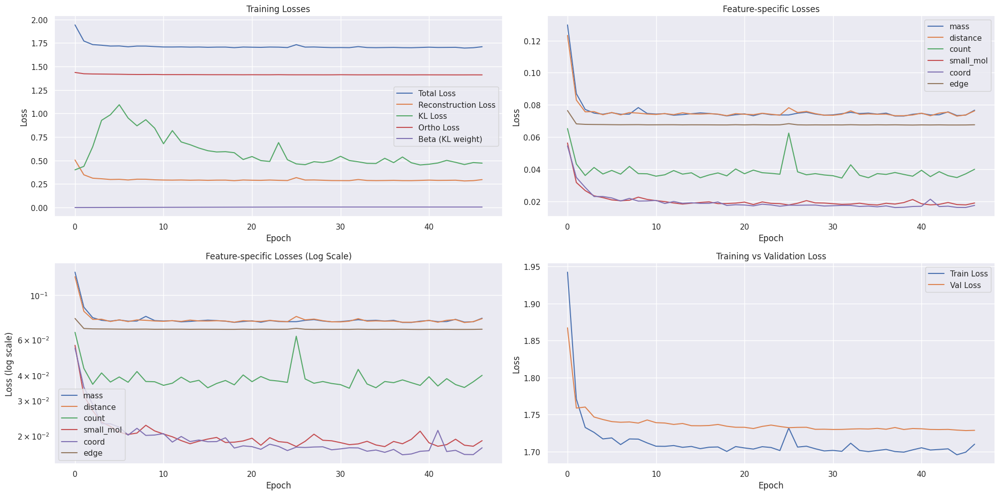

Epoch 48/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 17.62it/s, loss=1.6548, recon=0.2396, kl=0.6211, ortho=1.4122]


Detailed loss diagnostics:
Raw recon_loss: 0.2784
Raw KL loss: 0.5532
Ortho loss: 1.4109
Current beta: 0.0050
mu mean: -0.0686, std: 0.6694
logvar mean: -1.1755, std: 1.0058
mass: 0.0759
distance: 0.0726
count: 0.0260
small_mol: 0.0232
coord: 0.0139
edge: 0.0668


Epoch 48/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 19.13it/s, loss=1.6907, recon=0.2782, kl=0.3381, ortho=1.4108]


Detailed loss diagnostics:
Raw recon_loss: 0.2617
Raw KL loss: 0.4324
Ortho loss: 1.4100
Current beta: 0.0050
mu mean: -0.0425, std: 0.6153
logvar mean: -0.9490, std: 0.8811
mass: 0.0681
distance: 0.0642
count: 0.0254
small_mol: 0.0170
coord: 0.0190
edge: 0.0679


Epoch 48/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 19.26it/s, loss=1.7847, recon=0.3723, kl=0.4194, ortho=1.4103]


Detailed loss diagnostics:
Raw recon_loss: 0.2864
Raw KL loss: 0.4135
Ortho loss: 1.4097
Current beta: 0.0050
mu mean: -0.0365, std: 0.6051
logvar mean: -0.8958, std: 0.8566
mass: 0.0776
distance: 0.0749
count: 0.0262
small_mol: 0.0275
coord: 0.0135
edge: 0.0668


Epoch 48/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 19.32it/s, loss=1.7519, recon=0.3396, kl=0.4136, ortho=1.4102]


Detailed loss diagnostics:
Raw recon_loss: 0.2264
Raw KL loss: 0.3979
Ortho loss: 1.4099
Current beta: 0.0050
mu mean: -0.0695, std: 0.6236
logvar mean: -0.7342, std: 0.9193
mass: 0.0603
distance: 0.0590
count: 0.0249
small_mol: 0.0098
coord: 0.0068
edge: 0.0656


Epoch 48/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.38it/s, loss=1.7909, recon=0.3576, kl=0.2586, ortho=1.4320]



Detailed loss diagnostics:
Raw recon_loss: 0.2643
Raw KL loss: 0.4644
Ortho loss: 1.4094
Current beta: 0.0050
mu mean: -0.0523, std: 0.6404
logvar mean: -0.9506, std: 0.9673
mass: 0.0704
distance: 0.0676
count: 0.0257
small_mol: 0.0164
coord: 0.0174
edge: 0.0669

Starting validation...


Epoch 48/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 66.22it/s]



Epoch [48/100] - Time: 2.49s
Train - Total: 1.6984, Recon: 0.2853, KL: 0.4651, Ortho: 1.4108, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0733
  distance_loss: 0.0737
  count_loss: 0.0374
  small_mol_loss: 0.0171
  coord_loss: 0.0163
  edge_loss: 0.0675


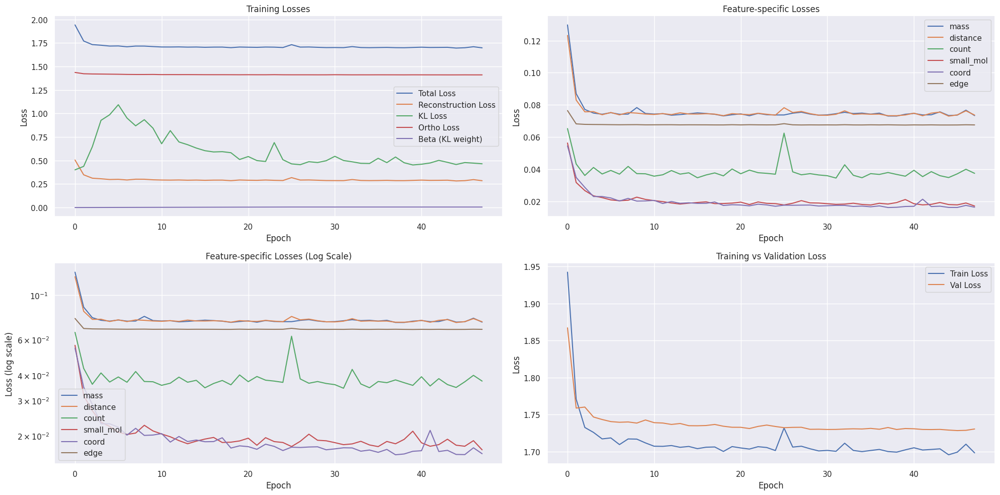

Epoch 49/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 17.97it/s, loss=1.8162, recon=0.4051, kl=0.5300, ortho=1.4085]


Detailed loss diagnostics:
Raw recon_loss: 0.2608
Raw KL loss: 0.3947
Ortho loss: 1.4094
Current beta: 0.0050
mu mean: -0.0645, std: 0.5779
logvar mean: -0.8279, std: 0.9371
mass: 0.0754
distance: 0.0668
count: 0.0256
small_mol: 0.0137
coord: 0.0116
edge: 0.0677


Epoch 49/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 18.99it/s, loss=1.6643, recon=0.2507, kl=0.5144, ortho=1.4110]


Detailed loss diagnostics:
Raw recon_loss: 0.2558
Raw KL loss: 0.4599
Ortho loss: 1.4089
Current beta: 0.0050
mu mean: -0.0517, std: 0.6491
logvar mean: -0.9409, std: 0.9236
mass: 0.0678
distance: 0.0684
count: 0.0257
small_mol: 0.0161
coord: 0.0108
edge: 0.0670


Epoch 49/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 19.25it/s, loss=1.6516, recon=0.2403, kl=0.3822, ortho=1.4094]


Detailed loss diagnostics:
Raw recon_loss: 0.2391
Raw KL loss: 0.4828
Ortho loss: 1.4136
Current beta: 0.0050
mu mean: -0.0411, std: 0.6583
logvar mean: -0.9907, std: 0.9325
mass: 0.0612
distance: 0.0600
count: 0.0250
small_mol: 0.0182
coord: 0.0083
edge: 0.0664


Epoch 49/100 [Train]:  76%|███████▌  | 32/42 [00:01<00:00, 20.25it/s, loss=1.6522, recon=0.2393, kl=0.4736, ortho=1.4106]


Detailed loss diagnostics:
Raw recon_loss: 0.2910
Raw KL loss: 0.4800
Ortho loss: 1.4095
Current beta: 0.0050
mu mean: -0.0569, std: 0.7009
logvar mean: -0.8365, std: 1.0510
mass: 0.0782
distance: 0.0762
count: 0.0264
small_mol: 0.0224
coord: 0.0209
edge: 0.0668


Epoch 49/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.60it/s, loss=1.8812, recon=0.4532, kl=0.3949, ortho=1.4261]



Detailed loss diagnostics:
Raw recon_loss: 0.2989
Raw KL loss: 0.4068
Ortho loss: 1.4102
Current beta: 0.0050
mu mean: -0.0918, std: 0.5795
logvar mean: -0.9447, std: 0.8508
mass: 0.0825
distance: 0.0782
count: 0.0263
small_mol: 0.0220
coord: 0.0210
edge: 0.0689

Starting validation...


Epoch 49/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 67.16it/s]



Epoch [49/100] - Time: 2.46s
Train - Total: 1.7020, Recon: 0.2892, KL: 0.4483, Ortho: 1.4106, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0737
  distance_loss: 0.0742
  count_loss: 0.0377
  small_mol_loss: 0.0193
  coord_loss: 0.0165
  edge_loss: 0.0676


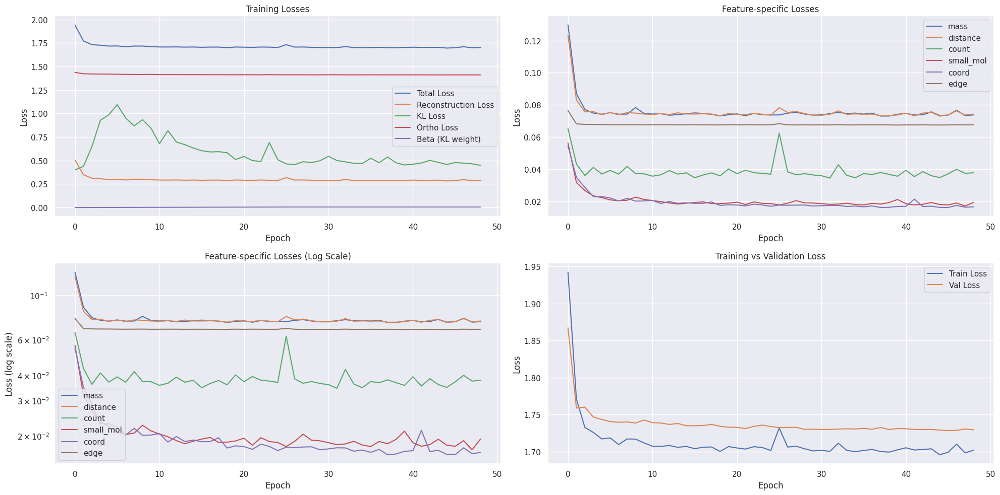

Epoch 50/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 16.43it/s, loss=1.6888, recon=0.2732, kl=0.7163, ortho=1.4120]


Detailed loss diagnostics:
Raw recon_loss: 0.2491
Raw KL loss: 0.3329
Ortho loss: 1.4112
Current beta: 0.0050
mu mean: -0.0089, std: 0.5643
logvar mean: -0.7069, std: 0.7938
mass: 0.0694
distance: 0.0678
count: 0.0255
small_mol: 0.0095
coord: 0.0109
edge: 0.0660


Epoch 50/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 20.41it/s, loss=1.6729, recon=0.2583, kl=0.5246, ortho=1.4120]


Detailed loss diagnostics:
Raw recon_loss: 0.4013
Raw KL loss: 0.5414
Ortho loss: 1.4120
Current beta: 0.0050
mu mean: -0.0891, std: 0.7185
logvar mean: -0.9918, std: 1.0671
mass: 0.0793
distance: 0.0971
count: 0.1251
small_mol: 0.0141
coord: 0.0168
edge: 0.0689


Epoch 50/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 20.73it/s, loss=1.6814, recon=0.2667, kl=0.4890, ortho=1.4123]


Detailed loss diagnostics:
Raw recon_loss: 0.2876
Raw KL loss: 0.5413
Ortho loss: 1.4111
Current beta: 0.0050
mu mean: -0.0835, std: 0.6731
logvar mean: -1.0687, std: 1.0925
mass: 0.0769
distance: 0.0767
count: 0.0263
small_mol: 0.0274
coord: 0.0130
edge: 0.0673


Epoch 50/100 [Train]:  76%|███████▌  | 32/42 [00:01<00:00, 20.86it/s, loss=1.6638, recon=0.2508, kl=0.6079, ortho=1.4100]


Detailed loss diagnostics:
Raw recon_loss: 0.2805
Raw KL loss: 0.4757
Ortho loss: 1.4121
Current beta: 0.0050
mu mean: -0.0938, std: 0.6734
logvar mean: -0.9318, std: 0.9179
mass: 0.0760
distance: 0.0752
count: 0.0263
small_mol: 0.0178
coord: 0.0183
edge: 0.0670


Epoch 50/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 20.25it/s, loss=1.7816, recon=0.3465, kl=0.2148, ortho=1.4341]



Detailed loss diagnostics:
Raw recon_loss: 0.2702
Raw KL loss: 0.3350
Ortho loss: 1.4103
Current beta: 0.0050
mu mean: -0.0215, std: 0.5394
logvar mean: -0.7242, std: 0.8607
mass: 0.0734
distance: 0.0719
count: 0.0260
small_mol: 0.0191
coord: 0.0119
edge: 0.0678

Starting validation...


Epoch 50/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 69.10it/s]



Epoch [50/100] - Time: 2.39s
Train - Total: 1.7014, Recon: 0.2869, KL: 0.5185, Ortho: 1.4119, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0736
  distance_loss: 0.0740
  count_loss: 0.0379
  small_mol_loss: 0.0181
  coord_loss: 0.0158
  edge_loss: 0.0675


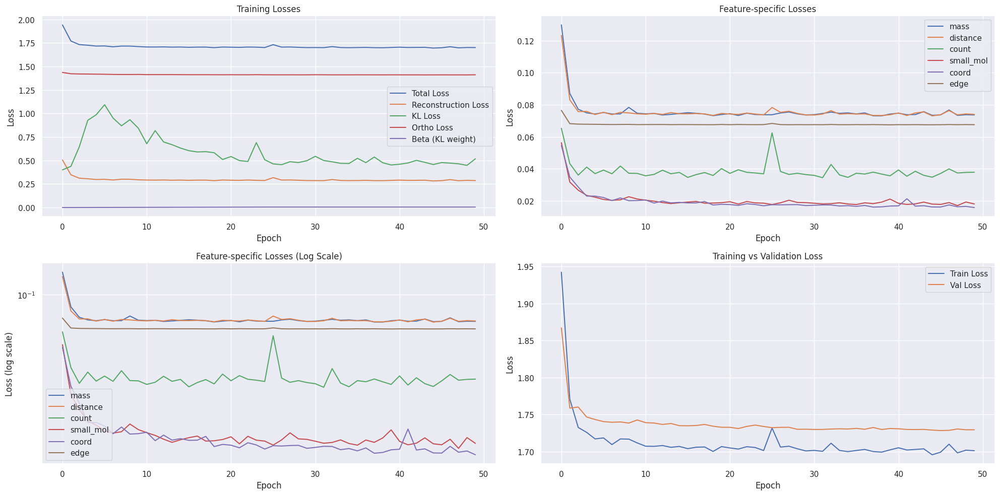

Epoch 51/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 17.84it/s, loss=1.6635, recon=0.2513, kl=0.4138, ortho=1.4102]


Detailed loss diagnostics:
Raw recon_loss: 0.2693
Raw KL loss: 0.3518
Ortho loss: 1.4104
Current beta: 0.0050
mu mean: -0.0312, std: 0.5750
logvar mean: -0.7034, std: 0.8559
mass: 0.0741
distance: 0.0717
count: 0.0261
small_mol: 0.0198
coord: 0.0101
edge: 0.0675


Epoch 51/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 19.21it/s, loss=1.6776, recon=0.2648, kl=0.4222, ortho=1.4107]


Detailed loss diagnostics:
Raw recon_loss: 0.2667
Raw KL loss: 0.3219
Ortho loss: 1.4117
Current beta: 0.0050
mu mean: -0.0525, std: 0.5680
logvar mean: -0.6415, std: 0.7927
mass: 0.0741
distance: 0.0737
count: 0.0260
small_mol: 0.0134
coord: 0.0128
edge: 0.0667


Epoch 51/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 20.53it/s, loss=1.6556, recon=0.2442, kl=0.4039, ortho=1.4094]


Detailed loss diagnostics:
Raw recon_loss: 0.2785
Raw KL loss: 0.5111
Ortho loss: 1.4088
Current beta: 0.0050
mu mean: -0.0545, std: 0.6564
logvar mean: -1.0482, std: 1.0429
mass: 0.0601
distance: 0.0654
count: 0.0581
small_mol: 0.0132
coord: 0.0111
edge: 0.0706


Epoch 51/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 20.27it/s, loss=1.7174, recon=0.3045, kl=0.4125, ortho=1.4108]


Detailed loss diagnostics:
Raw recon_loss: 0.2857
Raw KL loss: 0.4144
Ortho loss: 1.4111
Current beta: 0.0050
mu mean: -0.0597, std: 0.6186
logvar mean: -0.8653, std: 0.8882
mass: 0.0743
distance: 0.0724
count: 0.0261
small_mol: 0.0212
coord: 0.0254
edge: 0.0663


Epoch 51/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.70it/s, loss=1.7817, recon=0.3455, kl=0.3570, ortho=1.4344]



Detailed loss diagnostics:
Raw recon_loss: 0.2670
Raw KL loss: 0.3702
Ortho loss: 1.4104
Current beta: 0.0050
mu mean: -0.0077, std: 0.5746
logvar mean: -0.7174, std: 0.9140
mass: 0.0691
distance: 0.0684
count: 0.0256
small_mol: 0.0221
coord: 0.0135
edge: 0.0682

Starting validation...


Epoch 51/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 68.00it/s]



Epoch [51/100] - Time: 2.45s
Train - Total: 1.6928, Recon: 0.2798, KL: 0.4234, Ortho: 1.4109, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0723
  distance_loss: 0.0720
  count_loss: 0.0341
  small_mol_loss: 0.0179
  coord_loss: 0.0159
  edge_loss: 0.0676


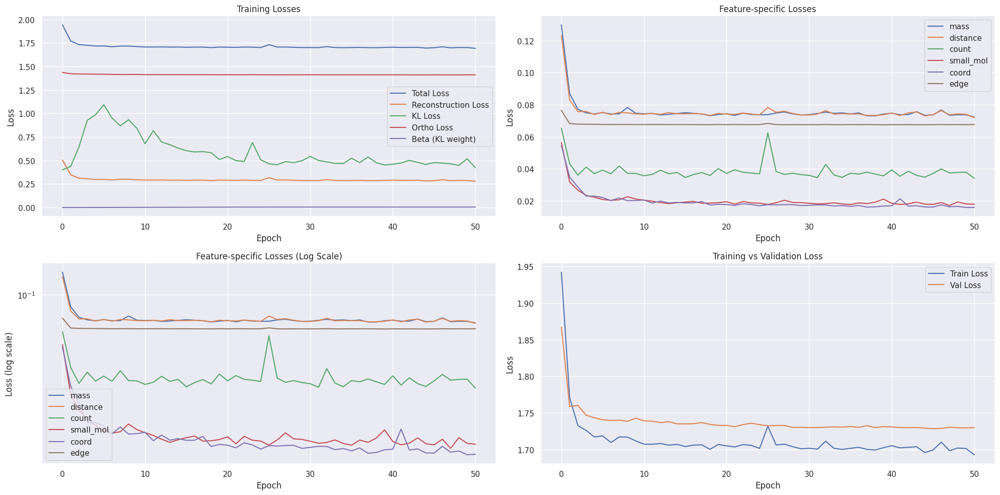

Epoch 52/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 17.46it/s, loss=1.6405, recon=0.2279, kl=0.4094, ortho=1.4105]


Detailed loss diagnostics:
Raw recon_loss: 0.2421
Raw KL loss: 0.4152
Ortho loss: 1.4102
Current beta: 0.0050
mu mean: -0.0811, std: 0.6357
logvar mean: -0.7735, std: 0.9134
mass: 0.0623
distance: 0.0616
count: 0.0252
small_mol: 0.0088
coord: 0.0164
edge: 0.0678


Epoch 52/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 20.23it/s, loss=1.6445, recon=0.2326, kl=0.4935, ortho=1.4094]


Detailed loss diagnostics:
Raw recon_loss: 0.2558
Raw KL loss: 0.5122
Ortho loss: 1.4091
Current beta: 0.0050
mu mean: -0.0665, std: 0.7219
logvar mean: -0.8728, std: 1.0076
mass: 0.0691
distance: 0.0691
count: 0.0257
small_mol: 0.0141
coord: 0.0114
edge: 0.0662


Epoch 52/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 20.21it/s, loss=1.6992, recon=0.2872, kl=0.4659, ortho=1.4097]


Detailed loss diagnostics:
Raw recon_loss: 0.2595
Raw KL loss: 0.3858
Ortho loss: 1.4097
Current beta: 0.0050
mu mean: -0.0372, std: 0.5772
logvar mean: -0.8068, std: 0.9182
mass: 0.0704
distance: 0.0674
count: 0.0256
small_mol: 0.0209
coord: 0.0092
edge: 0.0660


Epoch 52/100 [Train]:  76%|███████▌  | 32/42 [00:01<00:00, 19.29it/s, loss=1.6961, recon=0.2843, kl=0.3873, ortho=1.4098]


Detailed loss diagnostics:
Raw recon_loss: 0.2667
Raw KL loss: 0.4570
Ortho loss: 1.4115
Current beta: 0.0050
mu mean: -0.0929, std: 0.7152
logvar mean: -0.7833, std: 0.8545
mass: 0.0723
distance: 0.0713
count: 0.0259
small_mol: 0.0113
coord: 0.0187
edge: 0.0671


Epoch 52/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.45it/s, loss=1.8061, recon=0.3787, kl=0.2445, ortho=1.4261]



Detailed loss diagnostics:
Raw recon_loss: 0.2385
Raw KL loss: 0.5189
Ortho loss: 1.4098
Current beta: 0.0050
mu mean: -0.0298, std: 0.7274
logvar mean: -0.9655, std: 0.9061
mass: 0.0608
distance: 0.0598
count: 0.0250
small_mol: 0.0182
coord: 0.0086
edge: 0.0662

Starting validation...


Epoch 52/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 67.81it/s]



Epoch [52/100] - Time: 2.48s
Train - Total: 1.6946, Recon: 0.2820, KL: 0.4410, Ortho: 1.4104, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0732
  distance_loss: 0.0733
  count_loss: 0.0351
  small_mol_loss: 0.0172
  coord_loss: 0.0157
  edge_loss: 0.0675


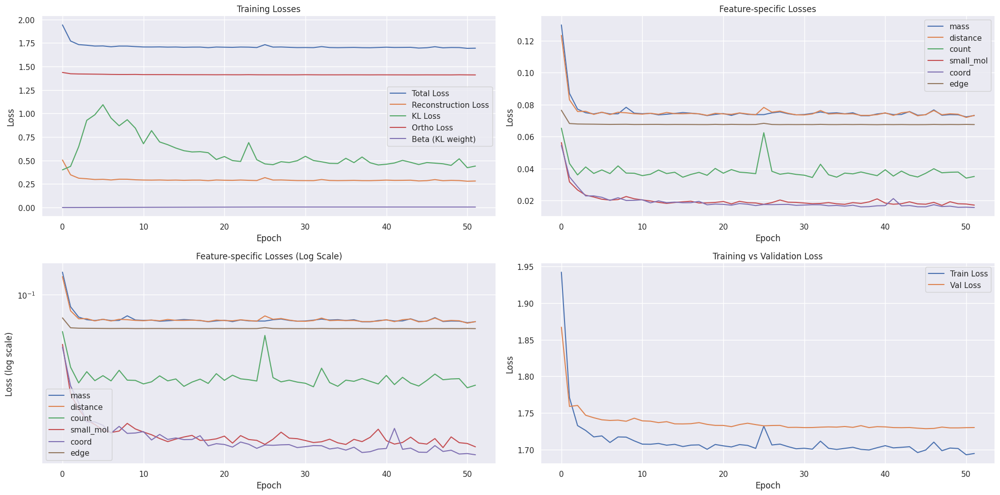

Epoch 53/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 16.60it/s, loss=1.7016, recon=0.2899, kl=0.4973, ortho=1.4091]


Detailed loss diagnostics:
Raw recon_loss: 0.2348
Raw KL loss: 0.4593
Ortho loss: 1.4095
Current beta: 0.0050
mu mean: -0.0198, std: 0.6837
logvar mean: -0.8250, std: 0.9385
mass: 0.0618
distance: 0.0615
count: 0.0251
small_mol: 0.0133
coord: 0.0078
edge: 0.0653


Epoch 53/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 20.08it/s, loss=1.6721, recon=0.2589, kl=0.5769, ortho=1.4103]


Detailed loss diagnostics:
Raw recon_loss: 0.3326
Raw KL loss: 0.8057
Ortho loss: 1.4091
Current beta: 0.0050
mu mean: -0.0923, std: 0.9490
logvar mean: -1.2440, std: 1.2689
mass: 0.0798
distance: 0.0914
count: 0.0370
small_mol: 0.0261
coord: 0.0292
edge: 0.0691


Epoch 53/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 19.59it/s, loss=1.6725, recon=0.2594, kl=0.4855, ortho=1.4107]


Detailed loss diagnostics:
Raw recon_loss: 0.2402
Raw KL loss: 0.3170
Ortho loss: 1.4097
Current beta: 0.0050
mu mean: -0.0002, std: 0.5502
logvar mean: -0.5872, std: 0.8863
mass: 0.0653
distance: 0.0641
count: 0.0254
small_mol: 0.0104
coord: 0.0075
edge: 0.0675


Epoch 53/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 19.89it/s, loss=1.7023, recon=0.2905, kl=0.3057, ortho=1.4103]


Detailed loss diagnostics:
Raw recon_loss: 0.2861
Raw KL loss: 0.4329
Ortho loss: 1.4100
Current beta: 0.0050
mu mean: -0.0565, std: 0.6029
logvar mean: -0.9120, std: 0.9552
mass: 0.0772
distance: 0.0741
count: 0.0262
small_mol: 0.0233
coord: 0.0177
edge: 0.0675


Epoch 53/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.47it/s, loss=1.8455, recon=0.4168, kl=0.3039, ortho=1.4272]



Detailed loss diagnostics:
Raw recon_loss: 0.3460
Raw KL loss: 0.3993
Ortho loss: 1.4103
Current beta: 0.0050
mu mean: -0.0569, std: 0.6463
logvar mean: -0.7408, std: 0.8637
mass: 0.0715
distance: 0.0823
count: 0.0973
small_mol: 0.0099
coord: 0.0132
edge: 0.0718

Starting validation...


Epoch 53/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 68.17it/s]



Epoch [53/100] - Time: 2.47s
Train - Total: 1.7049, Recon: 0.2919, KL: 0.4760, Ortho: 1.4106, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0750
  distance_loss: 0.0751
  count_loss: 0.0392
  small_mol_loss: 0.0187
  coord_loss: 0.0163
  edge_loss: 0.0676


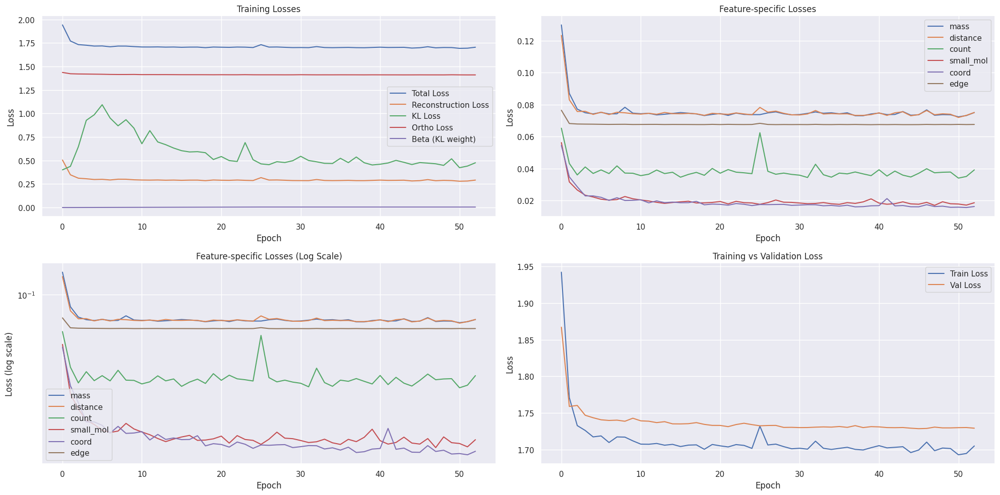

Epoch 54/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.91it/s, loss=1.7173, recon=0.3045, kl=0.4740, ortho=1.4104]


Detailed loss diagnostics:
Raw recon_loss: 0.2553
Raw KL loss: 0.4067
Ortho loss: 1.4102
Current beta: 0.0050
mu mean: -0.0188, std: 0.6068
logvar mean: -0.8587, std: 0.9175
mass: 0.0681
distance: 0.0671
count: 0.0255
small_mol: 0.0131
coord: 0.0144
edge: 0.0672


Epoch 54/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 19.70it/s, loss=1.6563, recon=0.2433, kl=0.5215, ortho=1.4103]


Detailed loss diagnostics:
Raw recon_loss: 0.4067
Raw KL loss: 0.4402
Ortho loss: 1.4096
Current beta: 0.0050
mu mean: -0.0692, std: 0.6231
logvar mean: -0.8881, std: 0.9669
mass: 0.0784
distance: 0.0936
count: 0.1333
small_mol: 0.0177
coord: 0.0121
edge: 0.0715


Epoch 54/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 20.44it/s, loss=1.6886, recon=0.2755, kl=0.4476, ortho=1.4108]


Detailed loss diagnostics:
Raw recon_loss: 0.3398
Raw KL loss: 0.4619
Ortho loss: 1.4113
Current beta: 0.0050
mu mean: -0.0889, std: 0.6075
logvar mean: -1.0046, std: 0.9981
mass: 0.0867
distance: 0.0958
count: 0.0387
small_mol: 0.0294
coord: 0.0216
edge: 0.0677


Epoch 54/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 19.62it/s, loss=1.6467, recon=0.2350, kl=0.3860, ortho=1.4098]


Detailed loss diagnostics:
Raw recon_loss: 0.2675
Raw KL loss: 0.3539
Ortho loss: 1.4093
Current beta: 0.0050
mu mean: -0.0672, std: 0.6068
logvar mean: -0.6250, std: 0.8691
mass: 0.0755
distance: 0.0727
count: 0.0261
small_mol: 0.0119
coord: 0.0145
edge: 0.0667


Epoch 54/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.84it/s, loss=1.8563, recon=0.4267, kl=0.5137, ortho=1.4270]



Detailed loss diagnostics:
Raw recon_loss: 0.2653
Raw KL loss: 0.3731
Ortho loss: 1.4096
Current beta: 0.0050
mu mean: -0.0461, std: 0.6337
logvar mean: -0.6905, std: 0.8305
mass: 0.0722
distance: 0.0724
count: 0.0260
small_mol: 0.0151
coord: 0.0124
edge: 0.0673

Starting validation...


Epoch 54/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 68.75it/s]



Epoch [54/100] - Time: 2.43s
Train - Total: 1.7035, Recon: 0.2909, KL: 0.4695, Ortho: 1.4103, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0743
  distance_loss: 0.0744
  count_loss: 0.0396
  small_mol_loss: 0.0194
  coord_loss: 0.0157
  edge_loss: 0.0675


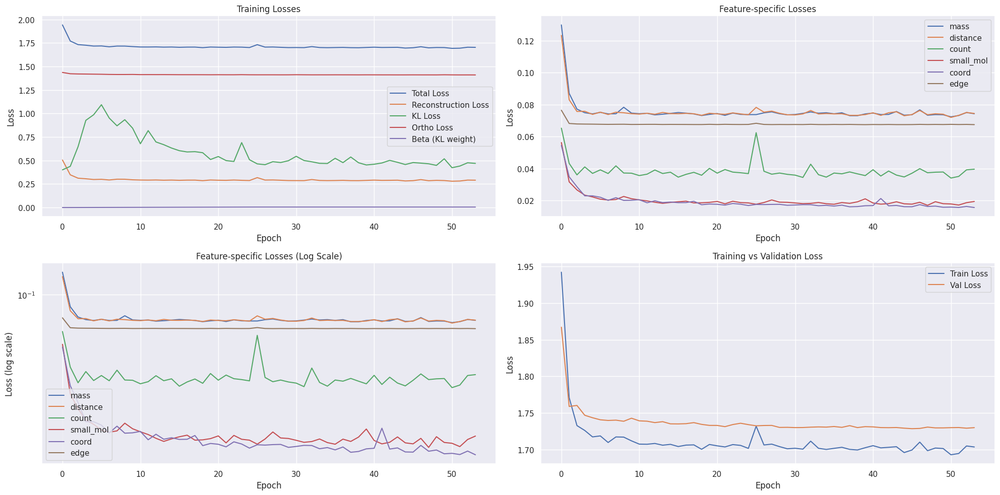

Epoch 55/100 [Train]:   7%|▋         | 3/42 [00:00<00:01, 19.77it/s, loss=1.7007, recon=0.2867, kl=0.5187, ortho=1.4113]


Detailed loss diagnostics:
Raw recon_loss: 0.2782
Raw KL loss: 0.2394
Ortho loss: 1.4103
Current beta: 0.0050
mu mean: -0.0057, std: 0.4523
logvar mean: -0.5360, std: 0.7609
mass: 0.0772
distance: 0.0733
count: 0.0262
small_mol: 0.0212
coord: 0.0130
edge: 0.0674


Epoch 55/100 [Train]:  29%|██▊       | 12/42 [00:00<00:01, 20.33it/s, loss=1.7056, recon=0.2916, kl=0.5720, ortho=1.4112]


Detailed loss diagnostics:
Raw recon_loss: 0.2428
Raw KL loss: 0.6696
Ortho loss: 1.4104
Current beta: 0.0050
mu mean: -0.0369, std: 0.8242
logvar mean: -1.0879, std: 1.2697
mass: 0.0615
distance: 0.0610
count: 0.0251
small_mol: 0.0141
coord: 0.0141
edge: 0.0670


Epoch 55/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:01, 18.89it/s, loss=1.6938, recon=0.2824, kl=0.4095, ortho=1.4094]


Detailed loss diagnostics:
Raw recon_loss: 0.2711
Raw KL loss: 0.4380
Ortho loss: 1.4097
Current beta: 0.0050
mu mean: -0.0581, std: 0.6007
logvar mean: -0.9682, std: 0.9628
mass: 0.0736
distance: 0.0701
count: 0.0259
small_mol: 0.0193
coord: 0.0145
edge: 0.0676


Epoch 55/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 19.28it/s, loss=1.6507, recon=0.2384, kl=0.5250, ortho=1.4096]


Detailed loss diagnostics:
Raw recon_loss: 0.2661
Raw KL loss: 0.4634
Ortho loss: 1.4104
Current beta: 0.0050
mu mean: -0.0503, std: 0.6495
logvar mean: -0.8959, std: 1.0759
mass: 0.0745
distance: 0.0752
count: 0.0262
small_mol: 0.0139
coord: 0.0095
edge: 0.0668


Epoch 55/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.53it/s, loss=1.7922, recon=0.3641, kl=0.4016, ortho=1.4261]



Detailed loss diagnostics:
Raw recon_loss: 0.2384
Raw KL loss: 0.5252
Ortho loss: 1.4089
Current beta: 0.0050
mu mean: -0.1077, std: 0.7223
logvar mean: -0.9456, std: 1.0289
mass: 0.0623
distance: 0.0605
count: 0.0250
small_mol: 0.0134
coord: 0.0091
edge: 0.0681

Starting validation...


Epoch 55/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 69.97it/s]



Epoch [55/100] - Time: 2.46s
Train - Total: 1.7051, Recon: 0.2920, KL: 0.4977, Ortho: 1.4106, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0749
  distance_loss: 0.0750
  count_loss: 0.0392
  small_mol_loss: 0.0187
  coord_loss: 0.0167
  edge_loss: 0.0676


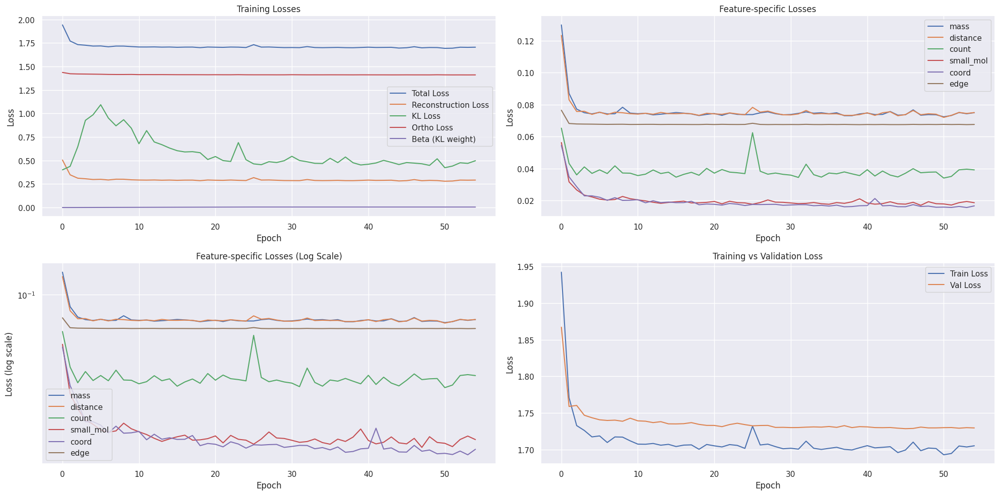

Epoch 56/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 18.49it/s, loss=1.7862, recon=0.3740, kl=0.3481, ortho=1.4105]


Detailed loss diagnostics:
Raw recon_loss: 0.2668
Raw KL loss: 0.4071
Ortho loss: 1.4107
Current beta: 0.0050
mu mean: -0.0361, std: 0.6053
logvar mean: -0.8526, std: 0.9191
mass: 0.0702
distance: 0.0707
count: 0.0258
small_mol: 0.0223
coord: 0.0116
edge: 0.0663


Epoch 56/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 20.49it/s, loss=1.6991, recon=0.2880, kl=0.3887, ortho=1.4092]


Detailed loss diagnostics:
Raw recon_loss: 0.4116
Raw KL loss: 0.6142
Ortho loss: 1.4095
Current beta: 0.0050
mu mean: -0.0982, std: 0.8260
logvar mean: -0.9443, std: 1.1701
mass: 0.0769
distance: 0.0983
count: 0.1252
small_mol: 0.0155
coord: 0.0263
edge: 0.0694


Epoch 56/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 20.07it/s, loss=1.6567, recon=0.2437, kl=0.5014, ortho=1.4105]


Detailed loss diagnostics:
Raw recon_loss: 0.2734
Raw KL loss: 0.4842
Ortho loss: 1.4094
Current beta: 0.0050
mu mean: -0.0627, std: 0.6821
logvar mean: -0.9237, std: 1.0012
mass: 0.0740
distance: 0.0724
count: 0.0261
small_mol: 0.0174
coord: 0.0160
edge: 0.0675


Epoch 56/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 19.83it/s, loss=1.7102, recon=0.2998, kl=0.3521, ortho=1.4087]


Detailed loss diagnostics:
Raw recon_loss: 0.2304
Raw KL loss: 0.5197
Ortho loss: 1.4096
Current beta: 0.0050
mu mean: -0.0781, std: 0.6955
logvar mean: -0.9848, std: 1.0600
mass: 0.0593
distance: 0.0584
count: 0.0249
small_mol: 0.0145
coord: 0.0074
edge: 0.0660


Epoch 56/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.95it/s, loss=1.8403, recon=0.4117, kl=0.5905, ortho=1.4257]



Detailed loss diagnostics:
Raw recon_loss: 0.2428
Raw KL loss: 0.3626
Ortho loss: 1.4114
Current beta: 0.0050
mu mean: -0.0590, std: 0.5764
logvar mean: -0.7729, std: 0.8845
mass: 0.0652
distance: 0.0643
count: 0.0254
small_mol: 0.0129
coord: 0.0084
edge: 0.0666

Starting validation...


Epoch 56/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 70.36it/s]



Epoch [56/100] - Time: 2.41s
Train - Total: 1.6982, Recon: 0.2855, KL: 0.4511, Ortho: 1.4104, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0735
  distance_loss: 0.0738
  count_loss: 0.0366
  small_mol_loss: 0.0180
  coord_loss: 0.0161
  edge_loss: 0.0675


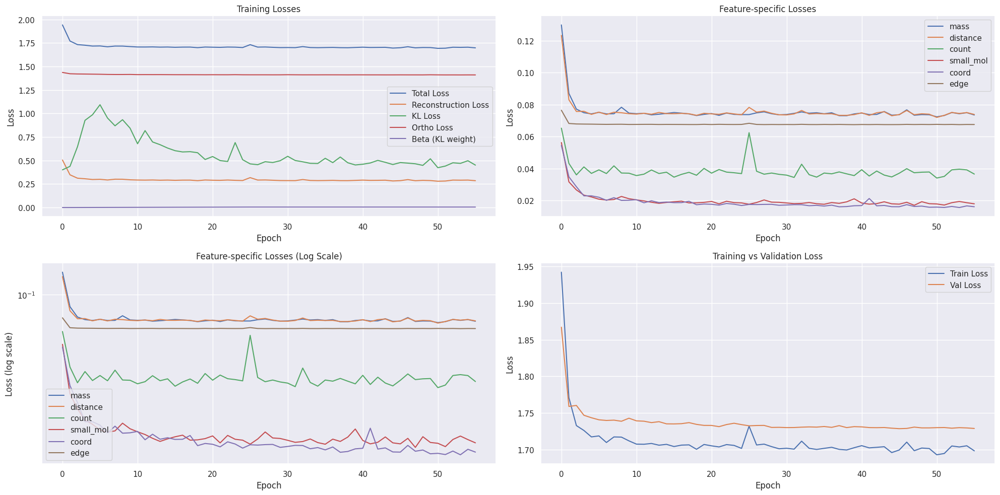

Epoch 57/100 [Train]:  10%|▉         | 4/42 [00:00<00:01, 19.51it/s, loss=1.6912, recon=0.2796, kl=0.3900, ortho=1.4097]


Detailed loss diagnostics:
Raw recon_loss: 0.3701
Raw KL loss: 0.4773
Ortho loss: 1.4095
Current beta: 0.0050
mu mean: -0.0807, std: 0.6902
logvar mean: -0.8330, std: 1.1416
mass: 0.0684
distance: 0.0785
count: 0.1274
small_mol: 0.0104
coord: 0.0164
edge: 0.0690


Epoch 57/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 21.19it/s, loss=1.7143, recon=0.3021, kl=0.4941, ortho=1.4097]


Detailed loss diagnostics:
Raw recon_loss: 0.3077
Raw KL loss: 0.3964
Ortho loss: 1.4133
Current beta: 0.0050
mu mean: -0.0722, std: 0.6082
logvar mean: -0.8573, std: 0.8582
mass: 0.0837
distance: 0.0814
count: 0.0265
small_mol: 0.0284
coord: 0.0194
edge: 0.0683


Epoch 57/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 20.32it/s, loss=1.6984, recon=0.2862, kl=0.4575, ortho=1.4099]


Detailed loss diagnostics:
Raw recon_loss: 0.2963
Raw KL loss: 0.4771
Ortho loss: 1.4112
Current beta: 0.0050
mu mean: -0.0643, std: 0.6767
logvar mean: -0.9885, std: 0.8593
mass: 0.0794
distance: 0.0755
count: 0.0263
small_mol: 0.0274
coord: 0.0197
edge: 0.0679


Epoch 57/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 20.23it/s, loss=1.7279, recon=0.3158, kl=0.3926, ortho=1.4101]


Detailed loss diagnostics:
Raw recon_loss: 0.2911
Raw KL loss: 0.7089
Ortho loss: 1.4112
Current beta: 0.0050
mu mean: -0.1331, std: 0.8373
logvar mean: -1.2821, std: 1.0158
mass: 0.0730
distance: 0.0789
count: 0.0326
small_mol: 0.0243
coord: 0.0144
edge: 0.0678


Epoch 57/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 20.07it/s, loss=1.7781, recon=0.3398, kl=0.1806, ortho=1.4374]



Detailed loss diagnostics:
Raw recon_loss: 0.2426
Raw KL loss: 0.5300
Ortho loss: 1.4111
Current beta: 0.0050
mu mean: -0.1525, std: 0.7627
logvar mean: -0.8672, std: 0.9776
mass: 0.0647
distance: 0.0624
count: 0.0252
small_mol: 0.0114
coord: 0.0124
edge: 0.0665

Starting validation...


Epoch 57/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 69.14it/s]



Epoch [57/100] - Time: 2.40s
Train - Total: 1.7016, Recon: 0.2881, KL: 0.4496, Ortho: 1.4112, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0748
  distance_loss: 0.0742
  count_loss: 0.0363
  small_mol_loss: 0.0185
  coord_loss: 0.0168
  edge_loss: 0.0675


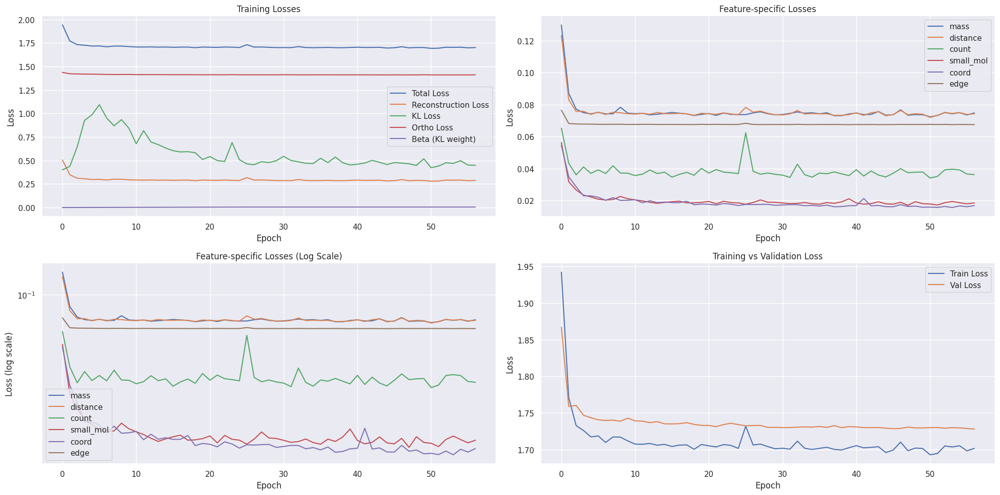

Epoch 58/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 19.49it/s, loss=1.7632, recon=0.3523, kl=0.3756, ortho=1.4090]


Detailed loss diagnostics:
Raw recon_loss: 0.3292
Raw KL loss: 0.3313
Ortho loss: 1.4095
Current beta: 0.0050
mu mean: -0.0763, std: 0.5439
logvar mean: -0.7363, std: 0.8261
mass: 0.0904
distance: 0.0832
count: 0.0271
small_mol: 0.0340
coord: 0.0274
edge: 0.0672


Epoch 58/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 20.43it/s, loss=1.8460, recon=0.4344, kl=0.4594, ortho=1.4094]


Detailed loss diagnostics:
Raw recon_loss: 0.2981
Raw KL loss: 0.3747
Ortho loss: 1.4106
Current beta: 0.0050
mu mean: -0.0836, std: 0.5677
logvar mean: -0.8756, std: 0.8142
mass: 0.0786
distance: 0.0803
count: 0.0264
small_mol: 0.0300
coord: 0.0145
edge: 0.0681


Epoch 58/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 19.74it/s, loss=1.6852, recon=0.2734, kl=0.4422, ortho=1.4096]


Detailed loss diagnostics:
Raw recon_loss: 0.3289
Raw KL loss: 0.3557
Ortho loss: 1.4098
Current beta: 0.0050
mu mean: -0.0457, std: 0.5721
logvar mean: -0.7518, std: 0.8639
mass: 0.1090
distance: 0.0847
count: 0.0271
small_mol: 0.0211
coord: 0.0204
edge: 0.0667


Epoch 58/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 20.39it/s, loss=1.6704, recon=0.2577, kl=0.5568, ortho=1.4100]


Detailed loss diagnostics:
Raw recon_loss: 0.2886
Raw KL loss: 0.4634
Ortho loss: 1.4107
Current beta: 0.0050
mu mean: -0.0521, std: 0.6213
logvar mean: -1.0354, std: 0.9408
mass: 0.0777
distance: 0.0736
count: 0.0262
small_mol: 0.0293
coord: 0.0146
edge: 0.0671


Epoch 58/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 20.00it/s, loss=1.7281, recon=0.3008, kl=0.3778, ortho=1.4254]



Detailed loss diagnostics:
Raw recon_loss: 0.2486
Raw KL loss: 0.4145
Ortho loss: 1.4097
Current beta: 0.0050
mu mean: -0.0649, std: 0.6503
logvar mean: -0.7998, std: 0.8671
mass: 0.0657
distance: 0.0644
count: 0.0254
small_mol: 0.0127
coord: 0.0132
edge: 0.0672

Starting validation...


Epoch 58/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 66.86it/s]



Epoch [58/100] - Time: 2.42s
Train - Total: 1.6985, Recon: 0.2861, KL: 0.4304, Ortho: 1.4102, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0740
  distance_loss: 0.0734
  count_loss: 0.0370
  small_mol_loss: 0.0181
  coord_loss: 0.0161
  edge_loss: 0.0675


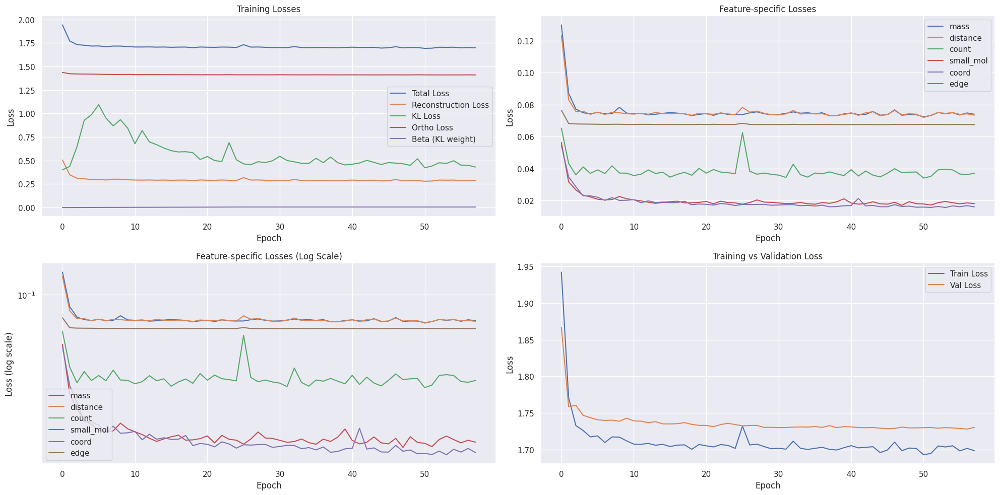

Epoch 59/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 16.72it/s, loss=1.6609, recon=0.2487, kl=0.5054, ortho=1.4097]


Detailed loss diagnostics:
Raw recon_loss: 0.2764
Raw KL loss: 0.3567
Ortho loss: 1.4091
Current beta: 0.0050
mu mean: -0.0465, std: 0.5999
logvar mean: -0.7062, std: 0.8472
mass: 0.0789
distance: 0.0765
count: 0.0263
small_mol: 0.0110
coord: 0.0165
edge: 0.0674


Epoch 59/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 18.79it/s, loss=1.6931, recon=0.2806, kl=0.5420, ortho=1.4098]


Detailed loss diagnostics:
Raw recon_loss: 0.2577
Raw KL loss: 0.3813
Ortho loss: 1.4098
Current beta: 0.0050
mu mean: -0.0507, std: 0.5892
logvar mean: -0.8390, std: 0.8475
mass: 0.0734
distance: 0.0653
count: 0.0254
small_mol: 0.0162
coord: 0.0112
edge: 0.0662


Epoch 59/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 20.10it/s, loss=1.6597, recon=0.2481, kl=0.4559, ortho=1.4092]


Detailed loss diagnostics:
Raw recon_loss: 0.2714
Raw KL loss: 0.3830
Ortho loss: 1.4095
Current beta: 0.0050
mu mean: -0.0854, std: 0.5785
logvar mean: -0.7973, std: 0.9496
mass: 0.0750
distance: 0.0744
count: 0.0262
small_mol: 0.0136
coord: 0.0146
edge: 0.0675


Epoch 59/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 20.63it/s, loss=1.7591, recon=0.3467, kl=0.3533, ortho=1.4106]


Detailed loss diagnostics:
Raw recon_loss: 0.2583
Raw KL loss: 0.4465
Ortho loss: 1.4082
Current beta: 0.0050
mu mean: -0.0539, std: 0.6424
logvar mean: -0.9307, std: 0.9308
mass: 0.0696
distance: 0.0685
count: 0.0257
small_mol: 0.0152
coord: 0.0118
edge: 0.0674


Epoch 59/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.66it/s, loss=1.7736, recon=0.3465, kl=0.3442, ortho=1.4254]



Detailed loss diagnostics:
Raw recon_loss: 0.2759
Raw KL loss: 0.4399
Ortho loss: 1.4102
Current beta: 0.0050
mu mean: -0.0381, std: 0.5954
logvar mean: -1.0347, std: 0.8825
mass: 0.0717
distance: 0.0692
count: 0.0258
small_mol: 0.0312
coord: 0.0112
edge: 0.0667

Starting validation...


Epoch 59/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 69.60it/s]



Epoch [59/100] - Time: 2.45s
Train - Total: 1.7025, Recon: 0.2902, KL: 0.4419, Ortho: 1.4101, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0748
  distance_loss: 0.0746
  count_loss: 0.0386
  small_mol_loss: 0.0186
  coord_loss: 0.0161
  edge_loss: 0.0676


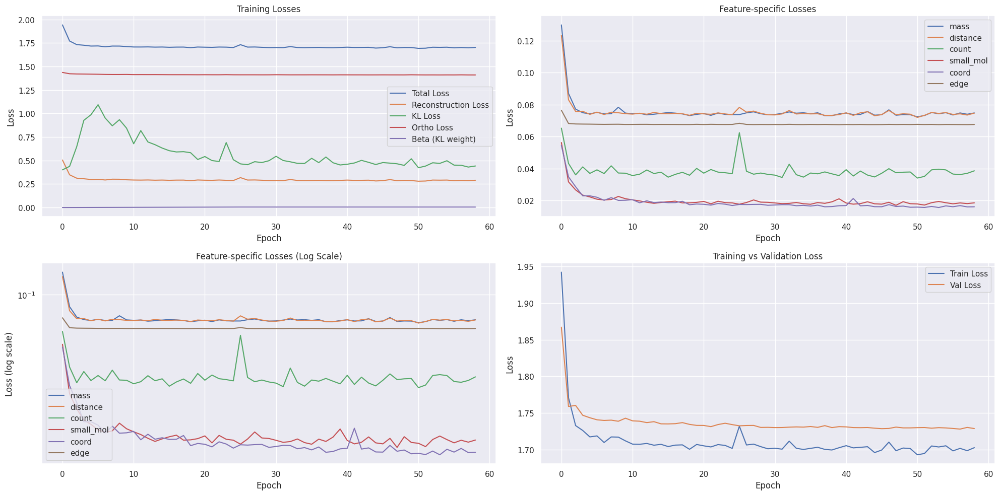

Epoch 60/100 [Train]:  10%|▉         | 4/42 [00:00<00:01, 19.50it/s, loss=1.6813, recon=0.2691, kl=0.4289, ortho=1.4100]


Detailed loss diagnostics:
Raw recon_loss: 0.2637
Raw KL loss: 0.3551
Ortho loss: 1.4095
Current beta: 0.0050
mu mean: -0.0411, std: 0.5614
logvar mean: -0.7657, std: 0.9003
mass: 0.0720
distance: 0.0724
count: 0.0258
small_mol: 0.0137
coord: 0.0123
edge: 0.0674


Epoch 60/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 20.60it/s, loss=1.6742, recon=0.2633, kl=0.3708, ortho=1.4090]


Detailed loss diagnostics:
Raw recon_loss: 0.2682
Raw KL loss: 0.3954
Ortho loss: 1.4106
Current beta: 0.0050
mu mean: -0.0426, std: 0.5958
logvar mean: -0.8625, std: 0.9045
mass: 0.0747
distance: 0.0734
count: 0.0261
small_mol: 0.0139
coord: 0.0136
edge: 0.0665


Epoch 60/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 19.57it/s, loss=1.6899, recon=0.2781, kl=0.5549, ortho=1.4090]


Detailed loss diagnostics:
Raw recon_loss: 0.2899
Raw KL loss: 0.6315
Ortho loss: 1.4101
Current beta: 0.0050
mu mean: -0.0391, std: 0.7937
logvar mean: -1.0945, std: 1.2856
mass: 0.0755
distance: 0.0741
count: 0.0261
small_mol: 0.0180
coord: 0.0291
edge: 0.0671


Epoch 60/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 18.88it/s, loss=1.6951, recon=0.2830, kl=0.5441, ortho=1.4093]


Detailed loss diagnostics:
Raw recon_loss: 0.3058
Raw KL loss: 0.3746
Ortho loss: 1.4093
Current beta: 0.0050
mu mean: -0.0636, std: 0.5761
logvar mean: -0.8316, std: 0.8868
mass: 0.0851
distance: 0.0820
count: 0.0266
small_mol: 0.0249
coord: 0.0196
edge: 0.0676


Epoch 60/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.36it/s, loss=1.7763, recon=0.3462, kl=0.2593, ortho=1.4288]



Detailed loss diagnostics:
Raw recon_loss: 0.2765
Raw KL loss: 0.3773
Ortho loss: 1.4103
Current beta: 0.0050
mu mean: -0.0591, std: 0.5596
logvar mean: -0.8872, std: 0.8836
mass: 0.0762
distance: 0.0747
count: 0.0260
small_mol: 0.0229
coord: 0.0098
edge: 0.0668

Starting validation...


Epoch 60/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 69.08it/s]



Epoch [60/100] - Time: 2.48s
Train - Total: 1.7011, Recon: 0.2887, KL: 0.4400, Ortho: 1.4102, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0747
  distance_loss: 0.0748
  count_loss: 0.0381
  small_mol_loss: 0.0176
  coord_loss: 0.0159
  edge_loss: 0.0676


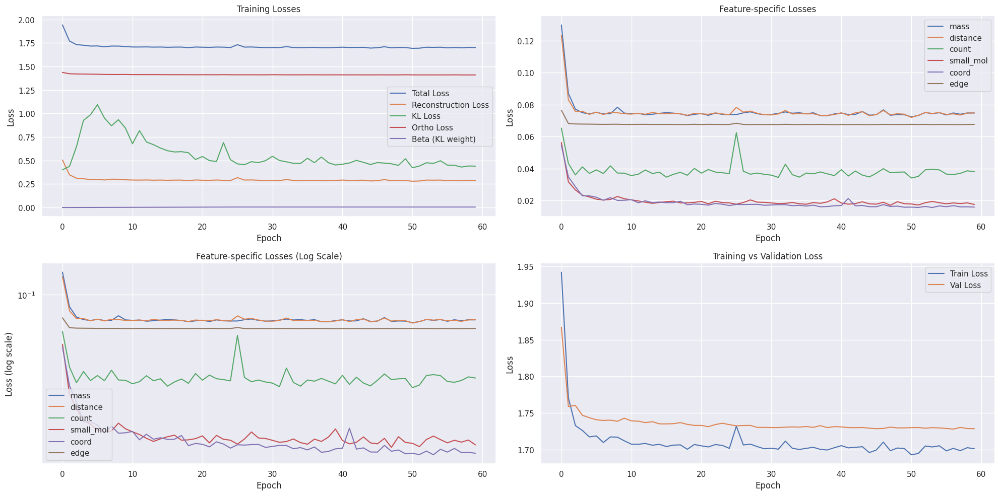

Epoch 61/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 18.68it/s, loss=1.7060, recon=0.2917, kl=0.6877, ortho=1.4108]


Detailed loss diagnostics:
Raw recon_loss: 0.2847
Raw KL loss: 0.4443
Ortho loss: 1.4086
Current beta: 0.0050
mu mean: -0.0799, std: 0.6361
logvar mean: -0.9452, std: 0.9102
mass: 0.0785
distance: 0.0742
count: 0.0261
small_mol: 0.0250
coord: 0.0123
edge: 0.0687


Epoch 61/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 19.48it/s, loss=1.7062, recon=0.2934, kl=0.6077, ortho=1.4097]


Detailed loss diagnostics:
Raw recon_loss: 0.2708
Raw KL loss: 0.4691
Ortho loss: 1.4099
Current beta: 0.0050
mu mean: -0.0379, std: 0.7010
logvar mean: -0.8512, std: 0.9412
mass: 0.0744
distance: 0.0735
count: 0.0260
small_mol: 0.0173
coord: 0.0130
edge: 0.0666


Epoch 61/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 19.61it/s, loss=1.6750, recon=0.2638, kl=0.4523, ortho=1.4090]


Detailed loss diagnostics:
Raw recon_loss: 0.2889
Raw KL loss: 0.4828
Ortho loss: 1.4105
Current beta: 0.0050
mu mean: -0.0836, std: 0.7045
logvar mean: -0.8627, std: 1.0906
mass: 0.0798
distance: 0.0771
count: 0.0265
small_mol: 0.0193
coord: 0.0190
edge: 0.0672


Epoch 61/100 [Train]:  76%|███████▌  | 32/42 [00:01<00:00, 18.81it/s, loss=1.6987, recon=0.2873, kl=0.5034, ortho=1.4090]


Detailed loss diagnostics:
Raw recon_loss: 0.2933
Raw KL loss: 0.4456
Ortho loss: 1.4080
Current beta: 0.0050
mu mean: -0.0560, std: 0.6426
logvar mean: -0.8792, std: 0.9966
mass: 0.0811
distance: 0.0783
count: 0.0266
small_mol: 0.0213
coord: 0.0196
edge: 0.0665


Epoch 61/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.33it/s, loss=1.7923, recon=0.3618, kl=0.8354, ortho=1.4262]



Detailed loss diagnostics:
Raw recon_loss: 0.3227
Raw KL loss: 0.5255
Ortho loss: 1.4107
Current beta: 0.0050
mu mean: -0.0507, std: 0.6321
logvar mean: -1.0503, std: 1.3144
mass: 0.0921
distance: 0.0893
count: 0.0275
small_mol: 0.0292
coord: 0.0182
edge: 0.0664

Starting validation...


Epoch 61/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 65.89it/s]



Epoch [61/100] - Time: 2.50s
Train - Total: 1.7015, Recon: 0.2882, KL: 0.4853, Ortho: 1.4109, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0746
  distance_loss: 0.0746
  count_loss: 0.0362
  small_mol_loss: 0.0192
  coord_loss: 0.0161
  edge_loss: 0.0675


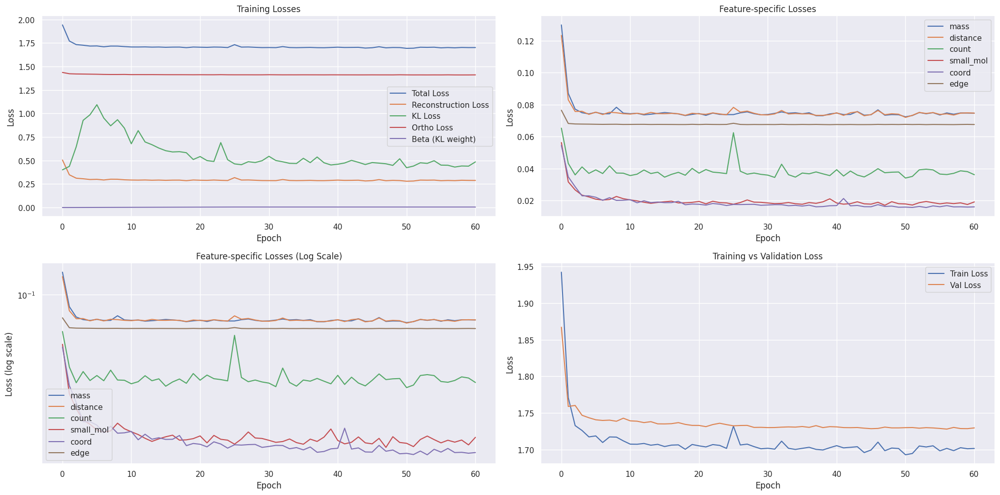

Epoch 62/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 19.13it/s, loss=1.6754, recon=0.2619, kl=0.5887, ortho=1.4107]


Detailed loss diagnostics:
Raw recon_loss: 0.2610
Raw KL loss: 0.5499
Ortho loss: 1.4103
Current beta: 0.0050
mu mean: -0.0761, std: 0.6499
logvar mean: -1.1310, std: 1.2570
mass: 0.0713
distance: 0.0707
count: 0.0258
small_mol: 0.0160
coord: 0.0102
edge: 0.0670


Epoch 62/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 19.51it/s, loss=1.6941, recon=0.2817, kl=0.4436, ortho=1.4102]


Detailed loss diagnostics:
Raw recon_loss: 0.2610
Raw KL loss: 0.4498
Ortho loss: 1.4099
Current beta: 0.0050
mu mean: -0.0605, std: 0.6304
logvar mean: -0.8790, std: 1.1221
mass: 0.0722
distance: 0.0692
count: 0.0259
small_mol: 0.0158
coord: 0.0117
edge: 0.0663


Epoch 62/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 19.47it/s, loss=1.7050, recon=0.2934, kl=0.3785, ortho=1.4097]


Detailed loss diagnostics:
Raw recon_loss: 0.2946
Raw KL loss: 0.5232
Ortho loss: 1.4097
Current beta: 0.0050
mu mean: -0.0821, std: 0.7702
logvar mean: -0.7842, std: 1.0822
mass: 0.0800
distance: 0.0754
count: 0.0262
small_mol: 0.0187
coord: 0.0271
edge: 0.0673


Epoch 62/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 18.26it/s, loss=1.6469, recon=0.2357, kl=0.4120, ortho=1.4091]


Detailed loss diagnostics:
Raw recon_loss: 0.3156
Raw KL loss: 0.3022
Ortho loss: 1.4098
Current beta: 0.0050
mu mean: -0.0403, std: 0.4926
logvar mean: -0.7105, std: 0.8787
mass: 0.0889
distance: 0.0889
count: 0.0269
small_mol: 0.0287
coord: 0.0148
edge: 0.0672


Epoch 62/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 18.68it/s, loss=1.7259, recon=0.2940, kl=0.2109, ortho=1.4309]



Detailed loss diagnostics:
Raw recon_loss: 0.2657
Raw KL loss: 0.4539
Ortho loss: 1.4090
Current beta: 0.0050
mu mean: -0.0308, std: 0.6982
logvar mean: -0.7859, std: 0.9744
mass: 0.0706
distance: 0.0719
count: 0.0260
small_mol: 0.0149
coord: 0.0150
edge: 0.0673

Starting validation...


Epoch 62/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 67.49it/s]



Epoch [62/100] - Time: 2.57s
Train - Total: 1.6946, Recon: 0.2816, KL: 0.4679, Ortho: 1.4106, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0727
  distance_loss: 0.0732
  count_loss: 0.0356
  small_mol_loss: 0.0173
  coord_loss: 0.0154
  edge_loss: 0.0675


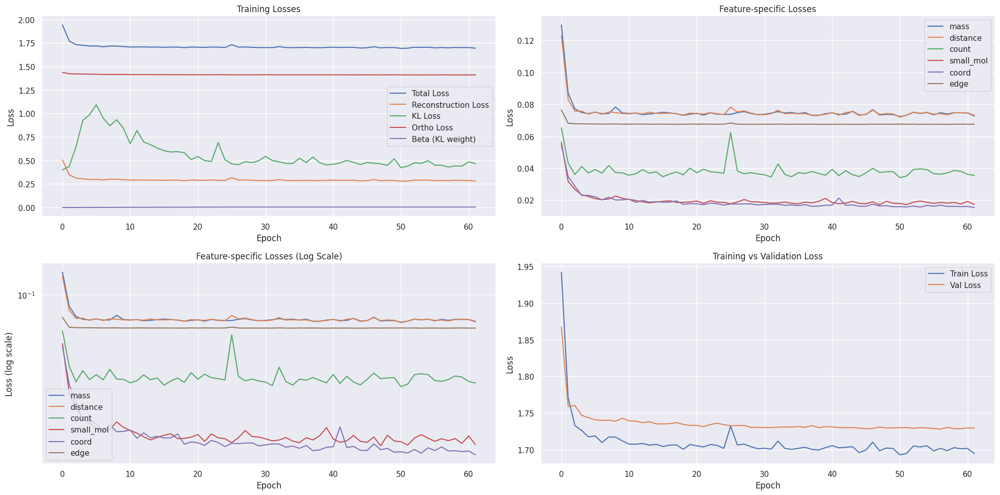

Epoch 63/100 [Train]:  10%|▉         | 4/42 [00:00<00:01, 19.49it/s, loss=1.6890, recon=0.2767, kl=0.4850, ortho=1.4098]


Detailed loss diagnostics:
Raw recon_loss: 0.2721
Raw KL loss: 0.3413
Ortho loss: 1.4094
Current beta: 0.0050
mu mean: -0.0352, std: 0.5719
logvar mean: -0.7025, std: 0.8751
mass: 0.0732
distance: 0.0728
count: 0.0260
small_mol: 0.0167
coord: 0.0162
edge: 0.0672


Epoch 63/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 19.48it/s, loss=1.6740, recon=0.2602, kl=0.4577, ortho=1.4115]


Detailed loss diagnostics:
Raw recon_loss: 0.3314
Raw KL loss: 0.3985
Ortho loss: 1.4103
Current beta: 0.0050
mu mean: -0.0419, std: 0.5935
logvar mean: -0.8336, std: 0.9766
mass: 0.0934
distance: 0.0899
count: 0.0273
small_mol: 0.0316
coord: 0.0226
edge: 0.0666


Epoch 63/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:00, 20.31it/s, loss=1.7110, recon=0.2992, kl=0.5363, ortho=1.4091]


Detailed loss diagnostics:
Raw recon_loss: 0.2654
Raw KL loss: 0.4656
Ortho loss: 1.4106
Current beta: 0.0050
mu mean: -0.0677, std: 0.6888
logvar mean: -0.8977, std: 0.9574
mass: 0.0705
distance: 0.0690
count: 0.0258
small_mol: 0.0132
coord: 0.0212
edge: 0.0657


Epoch 63/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 19.81it/s, loss=1.6519, recon=0.2385, kl=0.4586, ortho=1.4111]


Detailed loss diagnostics:
Raw recon_loss: 0.2553
Raw KL loss: 0.5733
Ortho loss: 1.4087
Current beta: 0.0050
mu mean: -0.1159, std: 0.7967
logvar mean: -0.9536, std: 1.0272
mass: 0.0636
distance: 0.0619
count: 0.0252
small_mol: 0.0110
coord: 0.0251
edge: 0.0684


Epoch 63/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 20.38it/s, loss=1.8279, recon=0.3845, kl=0.3891, ortho=1.4415]



Detailed loss diagnostics:
Raw recon_loss: 0.3963
Raw KL loss: 0.4342
Ortho loss: 1.4093
Current beta: 0.0050
mu mean: -0.0821, std: 0.6947
logvar mean: -0.6669, std: 1.1141
mass: 0.0734
distance: 0.0923
count: 0.1248
small_mol: 0.0121
coord: 0.0208
edge: 0.0729

Starting validation...


Epoch 63/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 70.71it/s]



Epoch [63/100] - Time: 2.37s
Train - Total: 1.7001, Recon: 0.2873, KL: 0.4211, Ortho: 1.4107, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0741
  distance_loss: 0.0737
  count_loss: 0.0367
  small_mol_loss: 0.0189
  coord_loss: 0.0165
  edge_loss: 0.0675


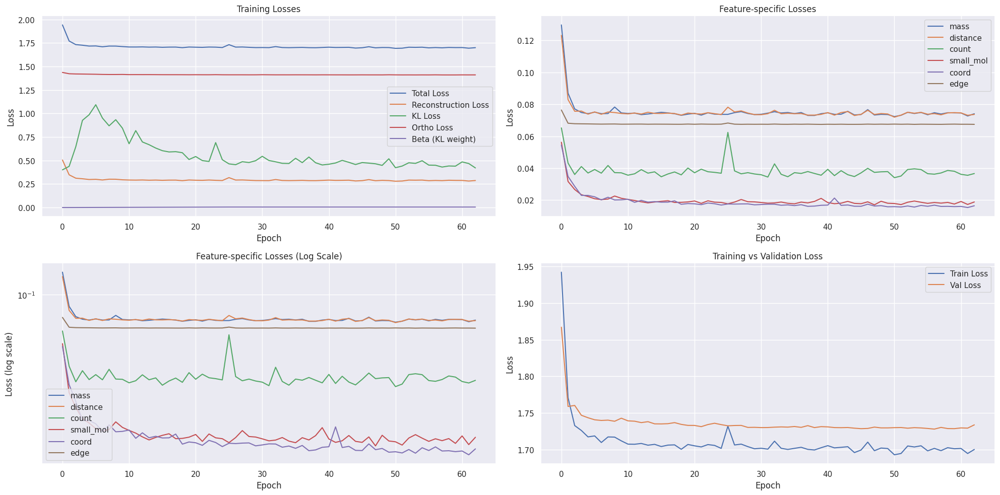

Epoch 64/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.95it/s, loss=1.7208, recon=0.3079, kl=0.4134, ortho=1.4109]


Detailed loss diagnostics:
Raw recon_loss: 0.2886
Raw KL loss: 0.3194
Ortho loss: 1.4083
Current beta: 0.0050
mu mean: -0.0331, std: 0.5352
logvar mean: -0.6553, std: 0.9220
mass: 0.0785
distance: 0.0778
count: 0.0263
small_mol: 0.0155
coord: 0.0236
edge: 0.0669


Epoch 64/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 18.31it/s, loss=1.8138, recon=0.4005, kl=0.4245, ortho=1.4112]


Detailed loss diagnostics:
Raw recon_loss: 0.3428
Raw KL loss: 0.3428
Ortho loss: 1.4104
Current beta: 0.0050
mu mean: -0.0301, std: 0.5513
logvar mean: -0.7234, std: 0.9320
mass: 0.0684
distance: 0.0799
count: 0.0997
small_mol: 0.0130
coord: 0.0106
edge: 0.0712


Epoch 64/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 19.24it/s, loss=1.6767, recon=0.2643, kl=0.4482, ortho=1.4102]


Detailed loss diagnostics:
Raw recon_loss: 0.2610
Raw KL loss: 0.3916
Ortho loss: 1.4104
Current beta: 0.0050
mu mean: -0.0081, std: 0.6366
logvar mean: -0.6906, std: 0.9759
mass: 0.0706
distance: 0.0708
count: 0.0259
small_mol: 0.0107
coord: 0.0152
edge: 0.0679


Epoch 64/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 19.89it/s, loss=1.7040, recon=0.2908, kl=0.4887, ortho=1.4108]


Detailed loss diagnostics:
Raw recon_loss: 0.2552
Raw KL loss: 0.3170
Ortho loss: 1.4097
Current beta: 0.0050
mu mean: -0.0250, std: 0.5432
logvar mean: -0.6779, std: 0.8775
mass: 0.0712
distance: 0.0673
count: 0.0257
small_mol: 0.0130
coord: 0.0106
edge: 0.0674


Epoch 64/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.25it/s, loss=1.8241, recon=0.3913, kl=0.7805, ortho=1.4289]



Detailed loss diagnostics:
Raw recon_loss: 0.2855
Raw KL loss: 0.4974
Ortho loss: 1.4089
Current beta: 0.0050
mu mean: -0.0641, std: 0.6989
logvar mean: -0.9350, std: 1.0171
mass: 0.0777
distance: 0.0758
count: 0.0264
small_mol: 0.0224
coord: 0.0164
edge: 0.0667

Starting validation...


Epoch 64/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 69.23it/s]



Epoch [64/100] - Time: 2.49s
Train - Total: 1.7019, Recon: 0.2892, KL: 0.4286, Ortho: 1.4106, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0743
  distance_loss: 0.0745
  count_loss: 0.0373
  small_mol_loss: 0.0183
  coord_loss: 0.0172
  edge_loss: 0.0676


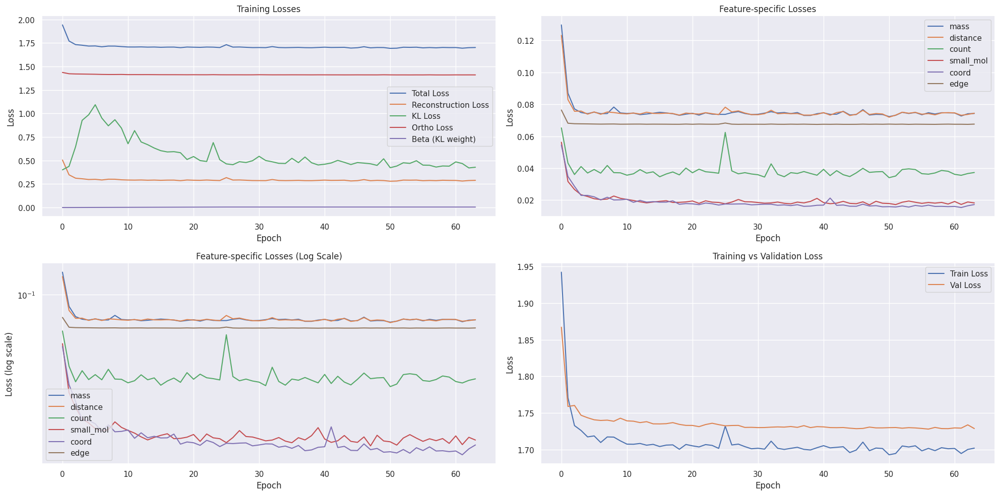

Epoch 65/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.07it/s, loss=1.6792, recon=0.2659, kl=0.4855, ortho=1.4109]


Detailed loss diagnostics:
Raw recon_loss: 0.2825
Raw KL loss: 0.4755
Ortho loss: 1.4090
Current beta: 0.0050
mu mean: -0.0766, std: 0.7079
logvar mean: -0.8458, std: 0.9729
mass: 0.0763
distance: 0.0732
count: 0.0262
small_mol: 0.0165
coord: 0.0233
edge: 0.0671


Epoch 65/100 [Train]:  29%|██▊       | 12/42 [00:00<00:01, 19.77it/s, loss=1.6730, recon=0.2622, kl=0.3260, ortho=1.4092]


Detailed loss diagnostics:
Raw recon_loss: 0.3080
Raw KL loss: 0.3693
Ortho loss: 1.4102
Current beta: 0.0050
mu mean: -0.0540, std: 0.5738
logvar mean: -0.7764, std: 0.9468
mass: 0.0878
distance: 0.0843
count: 0.0269
small_mol: 0.0241
coord: 0.0179
edge: 0.0671


Epoch 65/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 20.36it/s, loss=1.7329, recon=0.3184, kl=0.6768, ortho=1.4111]


Detailed loss diagnostics:
Raw recon_loss: 0.2798
Raw KL loss: 0.3146
Ortho loss: 1.4129
Current beta: 0.0050
mu mean: -0.0839, std: 0.5582
logvar mean: -0.6640, std: 0.8058
mass: 0.0749
distance: 0.0722
count: 0.0261
small_mol: 0.0274
coord: 0.0127
edge: 0.0665


Epoch 65/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 20.41it/s, loss=1.6472, recon=0.2362, kl=0.4099, ortho=1.4089]


Detailed loss diagnostics:
Raw recon_loss: 0.2965
Raw KL loss: 0.4146
Ortho loss: 1.4096
Current beta: 0.0050
mu mean: -0.0791, std: 0.6332
logvar mean: -0.7865, std: 0.9744
mass: 0.0849
distance: 0.0794
count: 0.0268
small_mol: 0.0231
coord: 0.0156
edge: 0.0667


Epoch 65/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 20.15it/s, loss=1.7336, recon=0.3052, kl=0.5361, ortho=1.4256]



Detailed loss diagnostics:
Raw recon_loss: 0.2950
Raw KL loss: 0.4686
Ortho loss: 1.4096
Current beta: 0.0050
mu mean: -0.1099, std: 0.6554
logvar mean: -0.9454, std: 0.9881
mass: 0.0748
distance: 0.0840
count: 0.0355
small_mol: 0.0198
coord: 0.0119
edge: 0.0690

Starting validation...


Epoch 65/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 70.63it/s]



Epoch [65/100] - Time: 2.39s
Train - Total: 1.6938, Recon: 0.2813, KL: 0.4414, Ortho: 1.4103, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0736
  distance_loss: 0.0730
  count_loss: 0.0334
  small_mol_loss: 0.0175
  coord_loss: 0.0163
  edge_loss: 0.0675


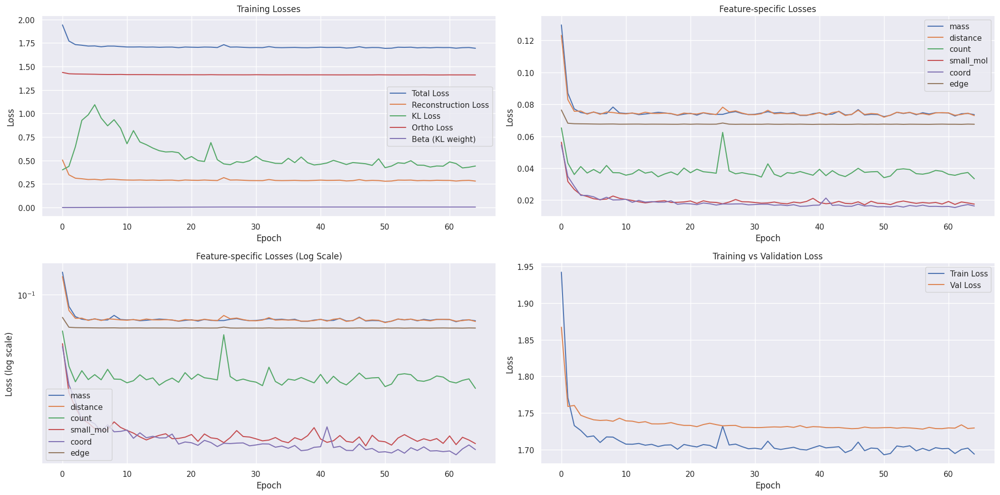

Epoch 66/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 18.85it/s, loss=1.7556, recon=0.3436, kl=0.4638, ortho=1.4096]


Detailed loss diagnostics:
Raw recon_loss: 0.2407
Raw KL loss: 0.6070
Ortho loss: 1.4096
Current beta: 0.0050
mu mean: -0.1097, std: 0.8094
logvar mean: -1.0156, std: 1.0703
mass: 0.0631
distance: 0.0613
count: 0.0251
small_mol: 0.0130
coord: 0.0103
edge: 0.0678


Epoch 66/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 18.52it/s, loss=1.7325, recon=0.3207, kl=0.3752, ortho=1.4100]


Detailed loss diagnostics:
Raw recon_loss: 0.2852
Raw KL loss: 0.3660
Ortho loss: 1.4095
Current beta: 0.0050
mu mean: -0.0242, std: 0.5655
logvar mean: -0.7995, std: 0.9304
mass: 0.0793
distance: 0.0747
count: 0.0263
small_mol: 0.0235
coord: 0.0147
edge: 0.0668


Epoch 66/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:01, 19.71it/s, loss=1.6991, recon=0.2873, kl=0.3541, ortho=1.4101]


Detailed loss diagnostics:
Raw recon_loss: 0.3077
Raw KL loss: 0.4748
Ortho loss: 1.4094
Current beta: 0.0050
mu mean: -0.0647, std: 0.7432
logvar mean: -0.7508, std: 0.9397
mass: 0.0835
distance: 0.0788
count: 0.0265
small_mol: 0.0185
coord: 0.0332
edge: 0.0673


Epoch 66/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 18.95it/s, loss=1.6974, recon=0.2845, kl=0.5257, ortho=1.4103]


Detailed loss diagnostics:
Raw recon_loss: 0.2715
Raw KL loss: 0.6595
Ortho loss: 1.4102
Current beta: 0.0050
mu mean: -0.0766, std: 0.8682
logvar mean: -1.0563, std: 1.0483
mass: 0.0683
distance: 0.0674
count: 0.0256
small_mol: 0.0209
coord: 0.0238
edge: 0.0656


Epoch 66/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.44it/s, loss=1.7164, recon=0.2802, kl=0.3722, ortho=1.4343]



Detailed loss diagnostics:
Raw recon_loss: 0.2816
Raw KL loss: 0.4097
Ortho loss: 1.4102
Current beta: 0.0050
mu mean: -0.0925, std: 0.6653
logvar mean: -0.6909, std: 0.9438
mass: 0.0608
distance: 0.0679
count: 0.0609
small_mol: 0.0106
coord: 0.0110
edge: 0.0703

Starting validation...


Epoch 66/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 71.31it/s]



Epoch [66/100] - Time: 2.46s
Train - Total: 1.6970, Recon: 0.2844, KL: 0.4347, Ortho: 1.4104, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0737
  distance_loss: 0.0734
  count_loss: 0.0365
  small_mol_loss: 0.0175
  coord_loss: 0.0158
  edge_loss: 0.0675


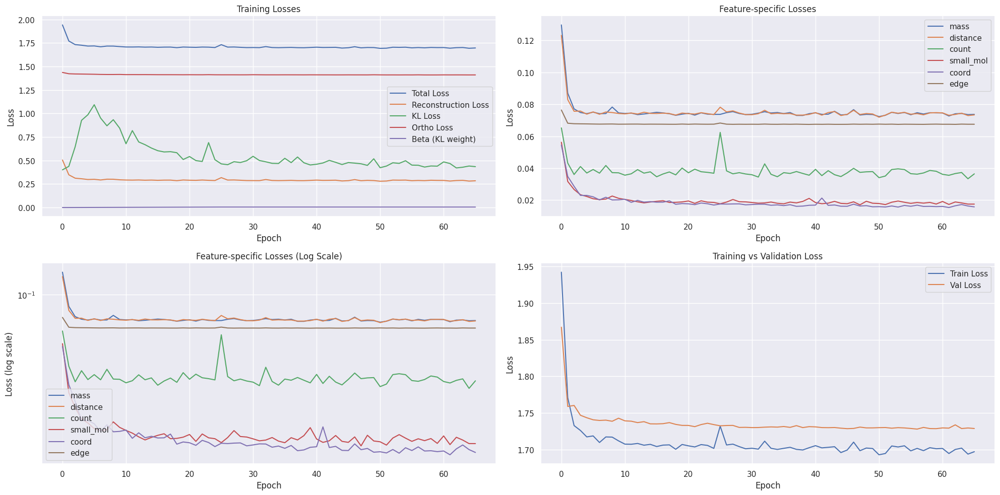

Epoch 67/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.05it/s, loss=1.7005, recon=0.2898, kl=0.3350, ortho=1.4090]


Detailed loss diagnostics:
Raw recon_loss: 0.2971
Raw KL loss: 0.4210
Ortho loss: 1.4101
Current beta: 0.0050
mu mean: -0.0842, std: 0.6604
logvar mean: -0.7528, std: 0.9564
mass: 0.0751
distance: 0.0821
count: 0.0330
small_mol: 0.0174
coord: 0.0202
edge: 0.0693


Epoch 67/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 20.00it/s, loss=1.6739, recon=0.2624, kl=0.3506, ortho=1.4098]


Detailed loss diagnostics:
Raw recon_loss: 0.2678
Raw KL loss: 0.3848
Ortho loss: 1.4127
Current beta: 0.0050
mu mean: -0.0857, std: 0.6284
logvar mean: -0.7208, std: 0.8981
mass: 0.0746
distance: 0.0754
count: 0.0263
small_mol: 0.0130
coord: 0.0121
edge: 0.0663


Epoch 67/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 19.93it/s, loss=1.7244, recon=0.3116, kl=0.3649, ortho=1.4110]


Detailed loss diagnostics:
Raw recon_loss: 0.2802
Raw KL loss: 0.4267
Ortho loss: 1.4087
Current beta: 0.0050
mu mean: -0.0594, std: 0.6382
logvar mean: -0.8943, std: 0.9164
mass: 0.0776
distance: 0.0754
count: 0.0263
small_mol: 0.0176
coord: 0.0166
edge: 0.0667


Epoch 67/100 [Train]:  76%|███████▌  | 32/42 [00:01<00:00, 19.72it/s, loss=1.8253, recon=0.4144, kl=0.3638, ortho=1.4090]


Detailed loss diagnostics:
Raw recon_loss: 0.2603
Raw KL loss: 0.4165
Ortho loss: 1.4090
Current beta: 0.0050
mu mean: -0.0780, std: 0.6269
logvar mean: -0.8657, std: 0.9265
mass: 0.0700
distance: 0.0687
count: 0.0257
small_mol: 0.0166
coord: 0.0131
edge: 0.0663


Epoch 67/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.65it/s, loss=1.7294, recon=0.3006, kl=0.4544, ortho=1.4265]



Detailed loss diagnostics:
Raw recon_loss: 0.2448
Raw KL loss: 0.4780
Ortho loss: 1.4099
Current beta: 0.0050
mu mean: -0.1189, std: 0.6970
logvar mean: -0.9214, std: 0.9252
mass: 0.0628
distance: 0.0615
count: 0.0251
small_mol: 0.0190
coord: 0.0088
edge: 0.0677

Starting validation...


Epoch 67/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 63.59it/s]



Epoch [67/100] - Time: 2.48s
Train - Total: 1.7019, Recon: 0.2898, KL: 0.4018, Ortho: 1.4101, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0741
  distance_loss: 0.0749
  count_loss: 0.0398
  small_mol_loss: 0.0173
  coord_loss: 0.0162
  edge_loss: 0.0675


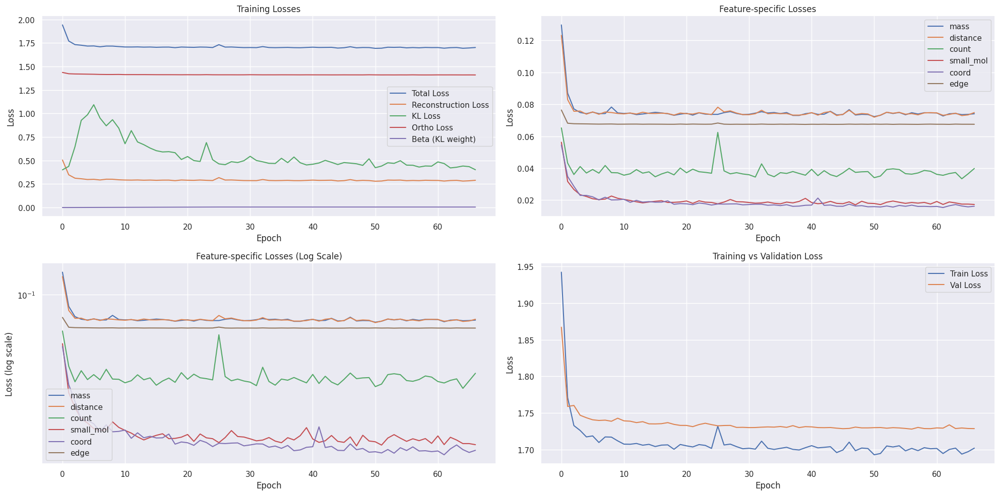

Epoch 68/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.73it/s, loss=1.6839, recon=0.2722, kl=0.3534, ortho=1.4099]


Detailed loss diagnostics:
Raw recon_loss: 0.2929
Raw KL loss: 0.2982
Ortho loss: 1.4093
Current beta: 0.0050
mu mean: -0.0633, std: 0.5246
logvar mean: -0.5893, std: 0.9079
mass: 0.0861
distance: 0.0824
count: 0.0269
small_mol: 0.0134
coord: 0.0175
edge: 0.0666


Epoch 68/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 18.60it/s, loss=1.6745, recon=0.2630, kl=0.4292, ortho=1.4093]


Detailed loss diagnostics:
Raw recon_loss: 0.2971
Raw KL loss: 0.4717
Ortho loss: 1.4107
Current beta: 0.0050
mu mean: -0.1376, std: 0.6511
logvar mean: -1.0160, std: 0.9191
mass: 0.0706
distance: 0.0786
count: 0.0340
small_mol: 0.0276
coord: 0.0165
edge: 0.0697


Epoch 68/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 18.61it/s, loss=1.6464, recon=0.2356, kl=0.4137, ortho=1.4088]


Detailed loss diagnostics:
Raw recon_loss: 0.2730
Raw KL loss: 0.3641
Ortho loss: 1.4091
Current beta: 0.0050
mu mean: -0.0470, std: 0.6042
logvar mean: -0.7091, std: 0.9255
mass: 0.0772
distance: 0.0736
count: 0.0262
small_mol: 0.0144
coord: 0.0145
edge: 0.0671


Epoch 68/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 18.99it/s, loss=1.6493, recon=0.2384, kl=0.3937, ortho=1.4089]


Detailed loss diagnostics:
Raw recon_loss: 0.2641
Raw KL loss: 0.3754
Ortho loss: 1.4095
Current beta: 0.0050
mu mean: -0.0722, std: 0.6024
logvar mean: -0.7316, std: 0.9554
mass: 0.0709
distance: 0.0689
count: 0.0257
small_mol: 0.0132
coord: 0.0177
edge: 0.0677


Epoch 68/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 18.84it/s, loss=1.7722, recon=0.3435, kl=0.3248, ortho=1.4270]



Detailed loss diagnostics:
Raw recon_loss: 0.2844
Raw KL loss: 0.3753
Ortho loss: 1.4110
Current beta: 0.0050
mu mean: -0.0960, std: 0.5753
logvar mean: -0.8282, std: 0.8929
mass: 0.0767
distance: 0.0738
count: 0.0262
small_mol: 0.0268
coord: 0.0137
edge: 0.0673

Starting validation...


Epoch 68/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 60.90it/s]



Epoch [68/100] - Time: 2.59s
Train - Total: 1.6991, Recon: 0.2866, KL: 0.4337, Ortho: 1.4103, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0735
  distance_loss: 0.0737
  count_loss: 0.0385
  small_mol_loss: 0.0175
  coord_loss: 0.0159
  edge_loss: 0.0675


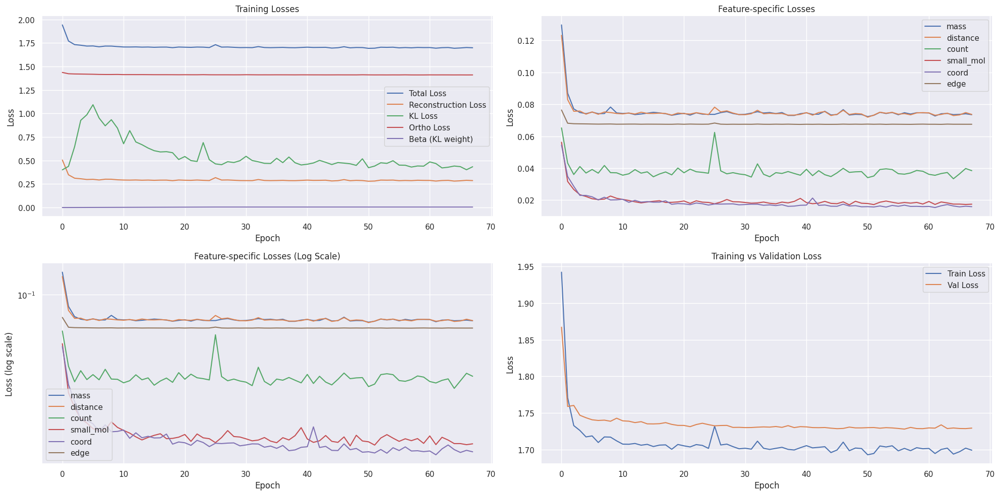

Epoch 69/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.35it/s, loss=1.7049, recon=0.2918, kl=0.4403, ortho=1.4109]


Detailed loss diagnostics:
Raw recon_loss: 0.2833
Raw KL loss: 0.4149
Ortho loss: 1.4103
Current beta: 0.0050
mu mean: -0.0680, std: 0.6760
logvar mean: -0.7108, std: 0.9331
mass: 0.0804
distance: 0.0776
count: 0.0265
small_mol: 0.0130
coord: 0.0196
edge: 0.0661


Epoch 69/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 19.17it/s, loss=1.7158, recon=0.3032, kl=0.5934, ortho=1.4096]


Detailed loss diagnostics:
Raw recon_loss: 0.2659
Raw KL loss: 0.4057
Ortho loss: 1.4105
Current beta: 0.0050
mu mean: -0.0438, std: 0.6234
logvar mean: -0.8083, std: 0.9703
mass: 0.0722
distance: 0.0699
count: 0.0258
small_mol: 0.0188
coord: 0.0115
edge: 0.0677


Epoch 69/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 20.62it/s, loss=1.6817, recon=0.2698, kl=0.4311, ortho=1.4097]


Detailed loss diagnostics:
Raw recon_loss: 0.3763
Raw KL loss: 0.5434
Ortho loss: 1.4095
Current beta: 0.0050
mu mean: -0.0542, std: 0.7291
logvar mean: -1.0071, std: 1.1400
mass: 0.0705
distance: 0.0823
count: 0.1201
small_mol: 0.0176
coord: 0.0172
edge: 0.0686


Epoch 69/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 19.99it/s, loss=1.6737, recon=0.2631, kl=0.3865, ortho=1.4087]


Detailed loss diagnostics:
Raw recon_loss: 0.2799
Raw KL loss: 0.5317
Ortho loss: 1.4085
Current beta: 0.0050
mu mean: -0.0825, std: 0.7473
logvar mean: -0.9400, std: 1.0483
mass: 0.0724
distance: 0.0683
count: 0.0257
small_mol: 0.0198
coord: 0.0265
edge: 0.0672


Epoch 69/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.73it/s, loss=1.7950, recon=0.3645, kl=0.2645, ortho=1.4292]



Detailed loss diagnostics:
Raw recon_loss: 0.2662
Raw KL loss: 0.3667
Ortho loss: 1.4091
Current beta: 0.0050
mu mean: -0.0549, std: 0.5762
logvar mean: -0.7848, std: 0.9144
mass: 0.0725
distance: 0.0703
count: 0.0259
small_mol: 0.0199
coord: 0.0104
edge: 0.0673

Starting validation...


Epoch 69/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 65.69it/s]



Epoch [69/100] - Time: 2.46s
Train - Total: 1.7034, Recon: 0.2909, KL: 0.4296, Ortho: 1.4104, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0751
  distance_loss: 0.0752
  count_loss: 0.0386
  small_mol_loss: 0.0178
  coord_loss: 0.0165
  edge_loss: 0.0676


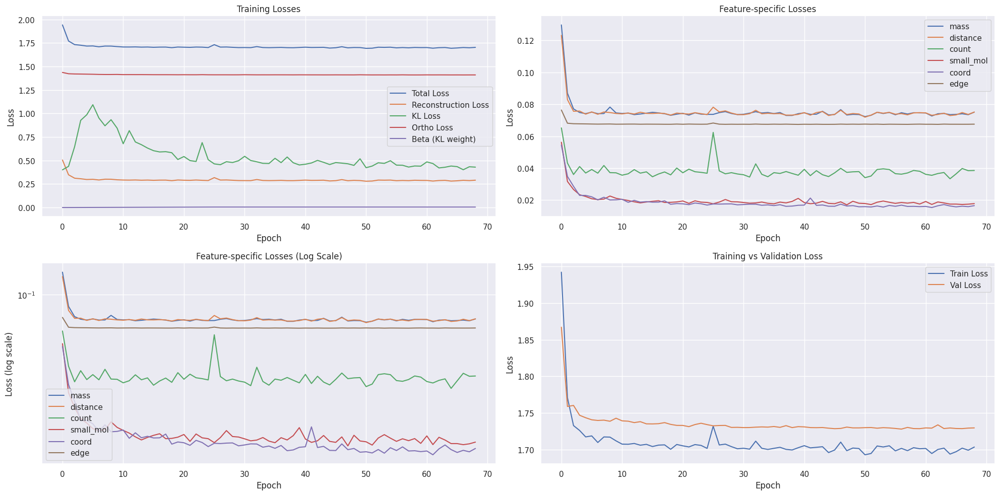

Epoch 70/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 17.52it/s, loss=1.6737, recon=0.2613, kl=0.3686, ortho=1.4105]


Detailed loss diagnostics:
Raw recon_loss: 0.2704
Raw KL loss: 0.4267
Ortho loss: 1.4098
Current beta: 0.0050
mu mean: -0.1010, std: 0.6113
logvar mean: -0.9066, std: 0.9648
mass: 0.0737
distance: 0.0712
count: 0.0259
small_mol: 0.0211
coord: 0.0117
edge: 0.0668


Epoch 70/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 20.55it/s, loss=1.8440, recon=0.4326, kl=0.3725, ortho=1.4096]


Detailed loss diagnostics:
Raw recon_loss: 0.3234
Raw KL loss: 0.4011
Ortho loss: 1.4098
Current beta: 0.0050
mu mean: -0.1016, std: 0.6026
logvar mean: -0.8642, std: 0.9293
mass: 0.0884
distance: 0.0854
count: 0.0272
small_mol: 0.0390
coord: 0.0164
edge: 0.0670


Epoch 70/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 21.23it/s, loss=1.6833, recon=0.2689, kl=0.4538, ortho=1.4122]


Detailed loss diagnostics:
Raw recon_loss: 0.2554
Raw KL loss: 0.4075
Ortho loss: 1.4102
Current beta: 0.0050
mu mean: -0.0325, std: 0.6044
logvar mean: -0.8658, std: 0.9621
mass: 0.0691
distance: 0.0681
count: 0.0257
small_mol: 0.0173
coord: 0.0080
edge: 0.0673


Epoch 70/100 [Train]:  76%|███████▌  | 32/42 [00:01<00:00, 19.76it/s, loss=1.6728, recon=0.2625, kl=0.3468, ortho=1.4086]


Detailed loss diagnostics:
Raw recon_loss: 0.2425
Raw KL loss: 0.4555
Ortho loss: 1.4101
Current beta: 0.0050
mu mean: -0.0856, std: 0.6631
logvar mean: -0.9014, std: 0.9888
mass: 0.0662
distance: 0.0609
count: 0.0251
small_mol: 0.0145
coord: 0.0098
edge: 0.0659


Epoch 70/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 20.05it/s, loss=1.8081, recon=0.3797, kl=0.3659, ortho=1.4266]



Detailed loss diagnostics:
Raw recon_loss: 0.2739
Raw KL loss: 0.3280
Ortho loss: 1.4094
Current beta: 0.0050
mu mean: -0.0891, std: 0.6026
logvar mean: -0.5374, std: 0.8923
mass: 0.0770
distance: 0.0772
count: 0.0262
small_mol: 0.0108
coord: 0.0154
edge: 0.0674

Starting validation...


Epoch 70/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 64.71it/s]



Epoch [70/100] - Time: 2.43s
Train - Total: 1.6987, Recon: 0.2861, KL: 0.4115, Ortho: 1.4105, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0733
  distance_loss: 0.0739
  count_loss: 0.0382
  small_mol_loss: 0.0178
  coord_loss: 0.0152
  edge_loss: 0.0675


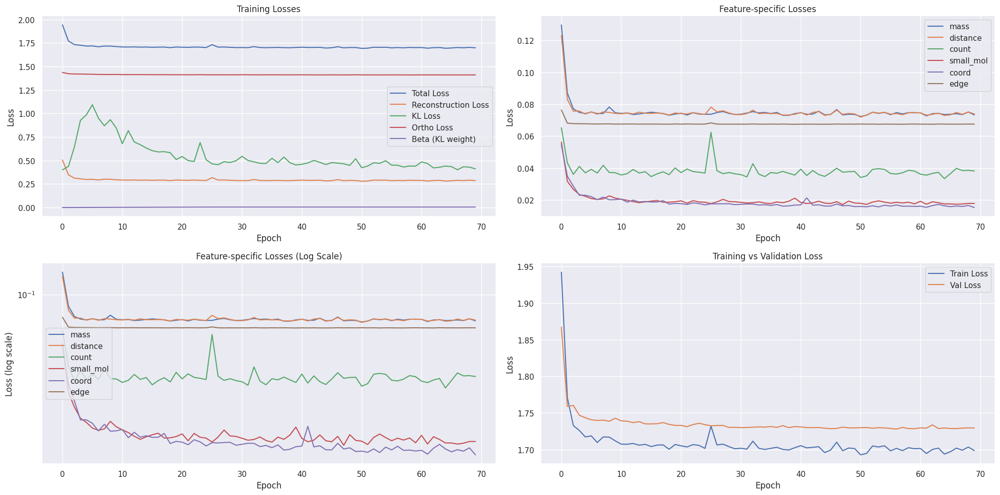

Epoch 71/100 [Train]:  10%|▉         | 4/42 [00:00<00:01, 19.41it/s, loss=1.6470, recon=0.2353, kl=0.3474, ortho=1.4100]


Detailed loss diagnostics:
Raw recon_loss: 0.2867
Raw KL loss: 0.3853
Ortho loss: 1.4095
Current beta: 0.0050
mu mean: -0.0649, std: 0.6403
logvar mean: -0.7081, std: 0.9126
mass: 0.0796
distance: 0.0782
count: 0.0265
small_mol: 0.0222
coord: 0.0137
edge: 0.0665


Epoch 71/100 [Train]:  29%|██▊       | 12/42 [00:00<00:01, 20.59it/s, loss=1.6971, recon=0.2845, kl=0.6055, ortho=1.4096]


Detailed loss diagnostics:
Raw recon_loss: 0.2668
Raw KL loss: 0.4715
Ortho loss: 1.4109
Current beta: 0.0050
mu mean: 0.0058, std: 0.6806
logvar mean: -0.9633, std: 0.9840
mass: 0.0732
distance: 0.0709
count: 0.0260
small_mol: 0.0187
coord: 0.0115
edge: 0.0665


Epoch 71/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 19.87it/s, loss=1.6751, recon=0.2623, kl=0.5164, ortho=1.4102]


Detailed loss diagnostics:
Raw recon_loss: 0.2467
Raw KL loss: 0.7103
Ortho loss: 1.4095
Current beta: 0.0050
mu mean: -0.0538, std: 0.8833
logvar mean: -1.1542, std: 1.1886
mass: 0.0651
distance: 0.0639
count: 0.0254
small_mol: 0.0140
coord: 0.0107
edge: 0.0677


Epoch 71/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 19.25it/s, loss=1.7827, recon=0.3709, kl=0.2942, ortho=1.4104]


Detailed loss diagnostics:
Raw recon_loss: 0.2811
Raw KL loss: 0.3570
Ortho loss: 1.4092
Current beta: 0.0050
mu mean: -0.0542, std: 0.5924
logvar mean: -0.7300, std: 0.9265
mass: 0.0772
distance: 0.0756
count: 0.0264
small_mol: 0.0165
coord: 0.0177
edge: 0.0676


Epoch 71/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.79it/s, loss=1.7193, recon=0.2861, kl=0.2516, ortho=1.4319]



Detailed loss diagnostics:
Raw recon_loss: 0.2350
Raw KL loss: 0.4198
Ortho loss: 1.4086
Current beta: 0.0050
mu mean: -0.0322, std: 0.6798
logvar mean: -0.7378, std: 0.9555
mass: 0.0612
distance: 0.0602
count: 0.0250
small_mol: 0.0120
coord: 0.0092
edge: 0.0673

Starting validation...


Epoch 71/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 63.36it/s]



Epoch [71/100] - Time: 2.46s
Train - Total: 1.6978, Recon: 0.2846, KL: 0.4763, Ortho: 1.4108, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0735
  distance_loss: 0.0737
  count_loss: 0.0363
  small_mol_loss: 0.0179
  coord_loss: 0.0157
  edge_loss: 0.0675


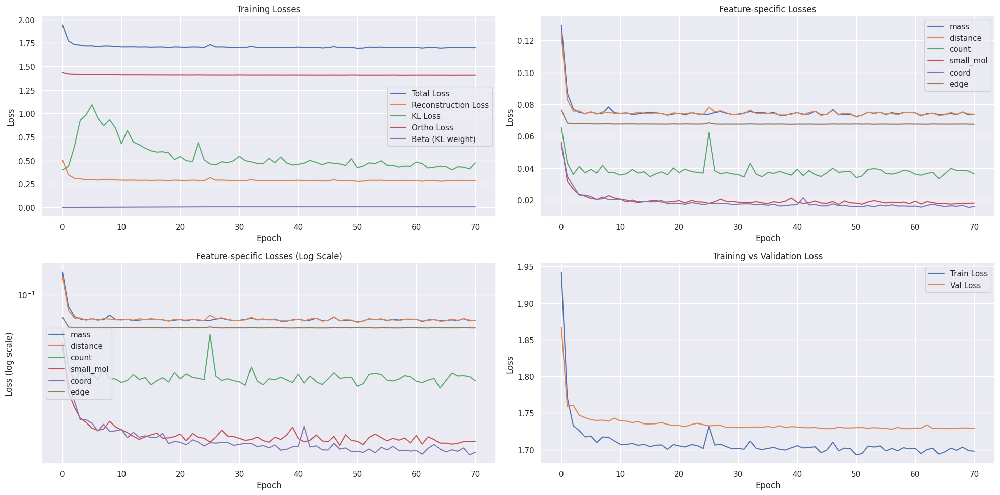

Epoch 72/100 [Train]:   7%|▋         | 3/42 [00:00<00:01, 21.07it/s, loss=1.6737, recon=0.2616, kl=0.4177, ortho=1.4100]


Detailed loss diagnostics:
Raw recon_loss: 0.2731
Raw KL loss: 0.3706
Ortho loss: 1.4103
Current beta: 0.0050
mu mean: -0.0452, std: 0.5895
logvar mean: -0.7299, std: 0.9984
mass: 0.0738
distance: 0.0702
count: 0.0259
small_mol: 0.0150
coord: 0.0209
edge: 0.0673


Epoch 72/100 [Train]:  29%|██▊       | 12/42 [00:00<00:01, 20.44it/s, loss=1.7261, recon=0.3138, kl=0.3827, ortho=1.4104]


Detailed loss diagnostics:
Raw recon_loss: 0.2435
Raw KL loss: 0.3629
Ortho loss: 1.4087
Current beta: 0.0050
mu mean: -0.0330, std: 0.5628
logvar mean: -0.7762, std: 0.9792
mass: 0.0645
distance: 0.0627
count: 0.0253
small_mol: 0.0153
coord: 0.0083
edge: 0.0675


Epoch 72/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 21.21it/s, loss=1.8234, recon=0.4115, kl=0.4533, ortho=1.4096]


Detailed loss diagnostics:
Raw recon_loss: 0.3144
Raw KL loss: 0.4534
Ortho loss: 1.4099
Current beta: 0.0050
mu mean: -0.0641, std: 0.6687
logvar mean: -0.8444, std: 1.1533
mass: 0.0888
distance: 0.0832
count: 0.0269
small_mol: 0.0194
coord: 0.0298
edge: 0.0664


Epoch 72/100 [Train]:  76%|███████▌  | 32/42 [00:01<00:00, 19.27it/s, loss=1.9795, recon=0.5677, kl=0.3822, ortho=1.4100]


Detailed loss diagnostics:
Raw recon_loss: 0.2811
Raw KL loss: 0.3997
Ortho loss: 1.4093
Current beta: 0.0050
mu mean: -0.0620, std: 0.6105
logvar mean: -0.8272, std: 0.9782
mass: 0.0782
distance: 0.0726
count: 0.0261
small_mol: 0.0218
coord: 0.0154
edge: 0.0671


Epoch 72/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 20.14it/s, loss=1.7980, recon=0.3497, kl=0.2468, ortho=1.4471]



Detailed loss diagnostics:
Raw recon_loss: 0.2740
Raw KL loss: 0.3055
Ortho loss: 1.4091
Current beta: 0.0050
mu mean: -0.0171, std: 0.5322
logvar mean: -0.6324, std: 0.9320
mass: 0.0785
distance: 0.0722
count: 0.0261
small_mol: 0.0157
coord: 0.0144
edge: 0.0671

Starting validation...


Epoch 72/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 69.75it/s]



Epoch [72/100] - Time: 2.40s
Train - Total: 1.6991, Recon: 0.2865, KL: 0.4017, Ortho: 1.4106, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0740
  distance_loss: 0.0741
  count_loss: 0.0378
  small_mol_loss: 0.0171
  coord_loss: 0.0159
  edge_loss: 0.0675


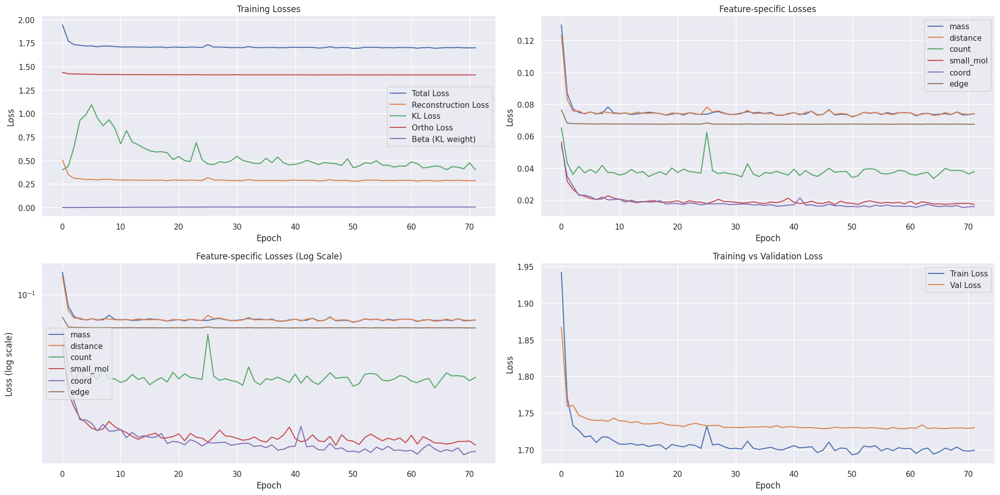

Epoch 73/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 16.64it/s, loss=1.6771, recon=0.2648, kl=0.4234, ortho=1.4102]


Detailed loss diagnostics:
Raw recon_loss: 0.2435
Raw KL loss: 0.5701
Ortho loss: 1.4114
Current beta: 0.0050
mu mean: -0.0989, std: 0.7604
logvar mean: -1.0619, std: 1.0109
mass: 0.0620
distance: 0.0614
count: 0.0252
small_mol: 0.0188
coord: 0.0099
edge: 0.0662


Epoch 73/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 19.95it/s, loss=1.6864, recon=0.2736, kl=0.3371, ortho=1.4111]


Detailed loss diagnostics:
Raw recon_loss: 0.2539
Raw KL loss: 0.6051
Ortho loss: 1.4113
Current beta: 0.0050
mu mean: -0.1018, std: 0.7491
logvar mean: -1.2215, std: 1.0496
mass: 0.0659
distance: 0.0642
count: 0.0254
small_mol: 0.0203
coord: 0.0112
edge: 0.0668


Epoch 73/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:01, 18.99it/s, loss=1.6706, recon=0.2576, kl=0.3745, ortho=1.4110]


Detailed loss diagnostics:
Raw recon_loss: 0.2891
Raw KL loss: 0.3311
Ortho loss: 1.4098
Current beta: 0.0050
mu mean: -0.0446, std: 0.5410
logvar mean: -0.7090, std: 0.9466
mass: 0.0739
distance: 0.0844
count: 0.0343
small_mol: 0.0155
coord: 0.0119
edge: 0.0692


Epoch 73/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 19.73it/s, loss=1.6580, recon=0.2475, kl=0.3277, ortho=1.4089]


Detailed loss diagnostics:
Raw recon_loss: 0.2683
Raw KL loss: 0.3636
Ortho loss: 1.4086
Current beta: 0.0050
mu mean: -0.0205, std: 0.5955
logvar mean: -0.7448, std: 0.9157
mass: 0.0720
distance: 0.0686
count: 0.0257
small_mol: 0.0206
coord: 0.0143
edge: 0.0671


Epoch 73/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.85it/s, loss=1.7582, recon=0.3232, kl=0.2609, ortho=1.4336]



Detailed loss diagnostics:
Raw recon_loss: 0.2652
Raw KL loss: 0.3342
Ortho loss: 1.4106
Current beta: 0.0050
mu mean: -0.0496, std: 0.5484
logvar mean: -0.7313, std: 0.9497
mass: 0.0734
distance: 0.0707
count: 0.0260
small_mol: 0.0122
coord: 0.0161
edge: 0.0667

Starting validation...


Epoch 73/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 67.84it/s]



Epoch [73/100] - Time: 2.43s
Train - Total: 1.7002, Recon: 0.2869, KL: 0.4488, Ortho: 1.4110, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0743
  distance_loss: 0.0743
  count_loss: 0.0384
  small_mol_loss: 0.0170
  coord_loss: 0.0154
  edge_loss: 0.0675


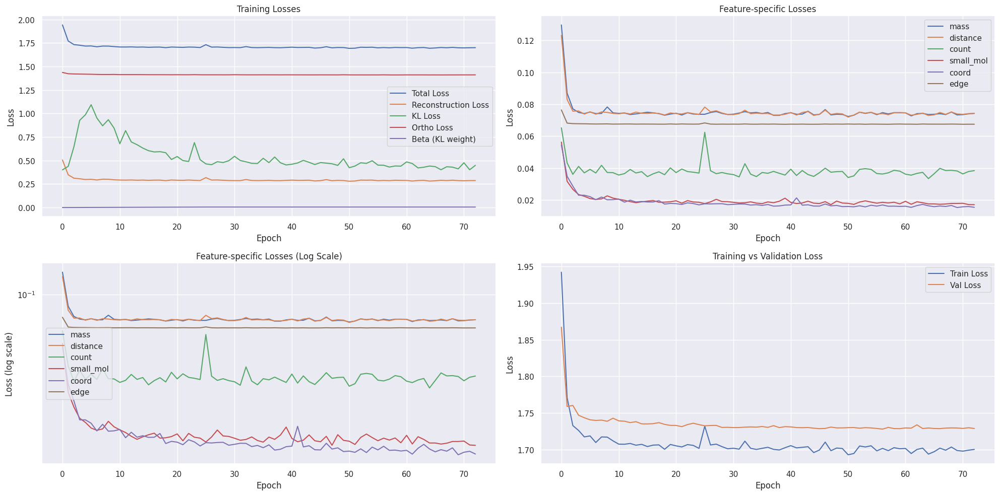

Epoch 74/100 [Train]:  10%|▉         | 4/42 [00:00<00:01, 19.04it/s, loss=1.6846, recon=0.2741, kl=0.4058, ortho=1.4085]


Detailed loss diagnostics:
Raw recon_loss: 0.2812
Raw KL loss: 0.4130
Ortho loss: 1.4099
Current beta: 0.0050
mu mean: -0.0677, std: 0.6364
logvar mean: -0.7471, std: 1.0619
mass: 0.0773
distance: 0.0748
count: 0.0262
small_mol: 0.0153
coord: 0.0207
edge: 0.0669


Epoch 74/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 19.19it/s, loss=1.6626, recon=0.2500, kl=0.5829, ortho=1.4097]


Detailed loss diagnostics:
Raw recon_loss: 0.3075
Raw KL loss: 0.4719
Ortho loss: 1.4122
Current beta: 0.0050
mu mean: -0.0768, std: 0.6385
logvar mean: -0.9589, std: 1.1096
mass: 0.0837
distance: 0.0768
count: 0.0265
small_mol: 0.0237
coord: 0.0300
edge: 0.0668


Epoch 74/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 19.16it/s, loss=1.6612, recon=0.2475, kl=0.4778, ortho=1.4113]


Detailed loss diagnostics:
Raw recon_loss: 0.2425
Raw KL loss: 0.3470
Ortho loss: 1.4099
Current beta: 0.0050
mu mean: -0.0388, std: 0.5440
logvar mean: -0.7298, std: 1.0237
mass: 0.0629
distance: 0.0631
count: 0.0253
small_mol: 0.0111
coord: 0.0131
edge: 0.0670


Epoch 74/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 19.87it/s, loss=1.6936, recon=0.2833, kl=0.2896, ortho=1.4089]


Detailed loss diagnostics:
Raw recon_loss: 0.2474
Raw KL loss: 0.4174
Ortho loss: 1.4105
Current beta: 0.0050
mu mean: -0.0534, std: 0.6772
logvar mean: -0.7185, std: 0.9572
mass: 0.0650
distance: 0.0646
count: 0.0254
small_mol: 0.0096
coord: 0.0159
edge: 0.0669


Epoch 74/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.59it/s, loss=1.6969, recon=0.2691, kl=0.3515, ortho=1.4261]



Detailed loss diagnostics:
Raw recon_loss: 0.3564
Raw KL loss: 0.3810
Ortho loss: 1.4108
Current beta: 0.0050
mu mean: -0.0932, std: 0.6030
logvar mean: -0.7331, std: 1.0002
mass: 0.0710
distance: 0.0894
count: 0.0972
small_mol: 0.0145
coord: 0.0128
edge: 0.0715

Starting validation...


Epoch 74/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 70.39it/s]



Epoch [74/100] - Time: 2.45s
Train - Total: 1.7002, Recon: 0.2879, KL: 0.4109, Ortho: 1.4103, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0747
  distance_loss: 0.0745
  count_loss: 0.0376
  small_mol_loss: 0.0178
  coord_loss: 0.0158
  edge_loss: 0.0675


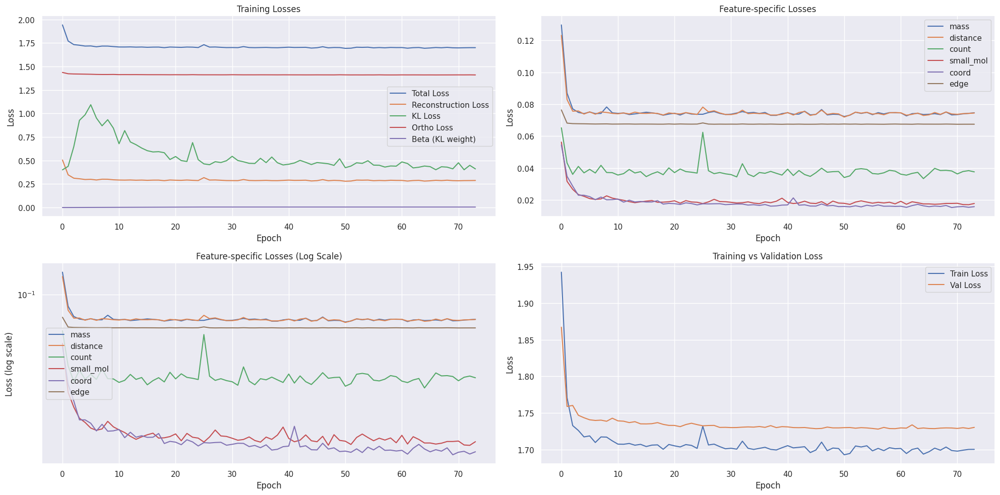

Epoch 75/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 16.30it/s, loss=1.6495, recon=0.2391, kl=0.3791, ortho=1.4086]


Detailed loss diagnostics:
Raw recon_loss: 0.4963
Raw KL loss: 0.4561
Ortho loss: 1.4093
Current beta: 0.0050
mu mean: -0.0813, std: 0.6667
logvar mean: -0.8534, std: 1.0702
mass: 0.0848
distance: 0.1185
count: 0.1755
small_mol: 0.0230
coord: 0.0211
edge: 0.0734


Epoch 75/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 19.65it/s, loss=1.6771, recon=0.2640, kl=0.4654, ortho=1.4107]


Detailed loss diagnostics:
Raw recon_loss: 0.2930
Raw KL loss: 0.5306
Ortho loss: 1.4106
Current beta: 0.0050
mu mean: -0.0554, std: 0.6826
logvar mean: -1.0727, std: 1.1300
mass: 0.0818
distance: 0.0756
count: 0.0262
small_mol: 0.0286
coord: 0.0137
edge: 0.0670


Epoch 75/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 18.50it/s, loss=1.7082, recon=0.2961, kl=0.3738, ortho=1.4102]


Detailed loss diagnostics:
Raw recon_loss: 0.2760
Raw KL loss: 0.3397
Ortho loss: 1.4091
Current beta: 0.0050
mu mean: -0.0403, std: 0.5277
logvar mean: -0.7635, std: 1.0090
mass: 0.0765
distance: 0.0731
count: 0.0262
small_mol: 0.0191
coord: 0.0144
edge: 0.0667


Epoch 75/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 19.61it/s, loss=1.6814, recon=0.2690, kl=0.4556, ortho=1.4101]


Detailed loss diagnostics:
Raw recon_loss: 0.2758
Raw KL loss: 0.4542
Ortho loss: 1.4103
Current beta: 0.0050
mu mean: -0.1004, std: 0.6528
logvar mean: -0.9332, std: 1.0213
mass: 0.0771
distance: 0.0753
count: 0.0263
small_mol: 0.0172
coord: 0.0127
edge: 0.0672


Epoch 75/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.26it/s, loss=1.7307, recon=0.3025, kl=0.3713, ortho=1.4264]



Detailed loss diagnostics:
Raw recon_loss: 0.4188
Raw KL loss: 0.3433
Ortho loss: 1.4095
Current beta: 0.0050
mu mean: -0.0562, std: 0.5475
logvar mean: -0.7000, std: 1.0106
mass: 0.0869
distance: 0.0981
count: 0.1316
small_mol: 0.0168
coord: 0.0159
edge: 0.0695

Starting validation...


Epoch 75/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 68.79it/s]



Epoch [75/100] - Time: 2.49s
Train - Total: 1.7006, Recon: 0.2885, KL: 0.4336, Ortho: 1.4100, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0744
  distance_loss: 0.0748
  count_loss: 0.0385
  small_mol_loss: 0.0175
  coord_loss: 0.0158
  edge_loss: 0.0676


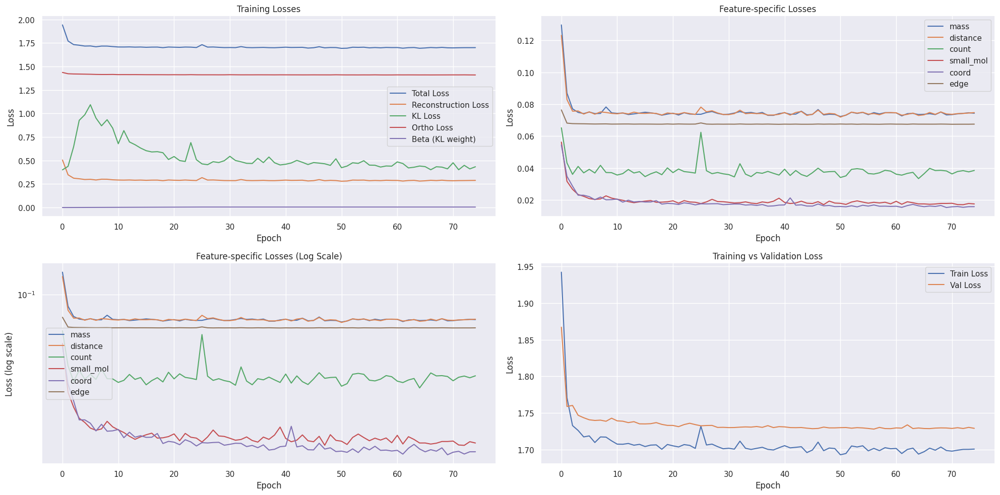

Epoch 76/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.32it/s, loss=1.6792, recon=0.2688, kl=0.2990, ortho=1.4089]


Detailed loss diagnostics:
Raw recon_loss: 0.2820
Raw KL loss: 0.3320
Ortho loss: 1.4084
Current beta: 0.0050
mu mean: -0.0420, std: 0.5298
logvar mean: -0.7135, std: 1.0047
mass: 0.0797
distance: 0.0736
count: 0.0262
small_mol: 0.0204
coord: 0.0146
edge: 0.0675


Epoch 76/100 [Train]:  29%|██▊       | 12/42 [00:00<00:01, 20.29it/s, loss=1.6812, recon=0.2692, kl=0.4307, ortho=1.4098]


Detailed loss diagnostics:
Raw recon_loss: 0.2527
Raw KL loss: 0.3311
Ortho loss: 1.4099
Current beta: 0.0050
mu mean: -0.0474, std: 0.5643
logvar mean: -0.6537, std: 0.9611
mass: 0.0687
distance: 0.0693
count: 0.0258
small_mol: 0.0120
coord: 0.0101
edge: 0.0669


Epoch 76/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 20.33it/s, loss=1.6700, recon=0.2585, kl=0.4665, ortho=1.4091]


Detailed loss diagnostics:
Raw recon_loss: 0.2799
Raw KL loss: 0.5114
Ortho loss: 1.4093
Current beta: 0.0050
mu mean: -0.0983, std: 0.6909
logvar mean: -1.0137, std: 1.0795
mass: 0.0739
distance: 0.0757
count: 0.0262
small_mol: 0.0219
coord: 0.0148
edge: 0.0674


Epoch 76/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 19.87it/s, loss=1.7228, recon=0.3112, kl=0.3536, ortho=1.4098]


Detailed loss diagnostics:
Raw recon_loss: 0.2736
Raw KL loss: 0.3457
Ortho loss: 1.4098
Current beta: 0.0050
mu mean: -0.0548, std: 0.5379
logvar mean: -0.7592, std: 0.9955
mass: 0.0732
distance: 0.0712
count: 0.0259
small_mol: 0.0219
coord: 0.0139
edge: 0.0674


Epoch 76/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.98it/s, loss=1.8172, recon=0.3880, kl=0.4116, ortho=1.4272]



Detailed loss diagnostics:
Raw recon_loss: 0.2874
Raw KL loss: 0.3899
Ortho loss: 1.4107
Current beta: 0.0050
mu mean: -0.0623, std: 0.5871
logvar mean: -0.8367, std: 0.9808
mass: 0.0771
distance: 0.0762
count: 0.0263
small_mol: 0.0244
coord: 0.0164
edge: 0.0670

Starting validation...


Epoch 76/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 65.77it/s]



Epoch [76/100] - Time: 2.43s
Train - Total: 1.7024, Recon: 0.2904, KL: 0.3990, Ortho: 1.4100, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0742
  distance_loss: 0.0746
  count_loss: 0.0399
  small_mol_loss: 0.0182
  coord_loss: 0.0159
  edge_loss: 0.0676


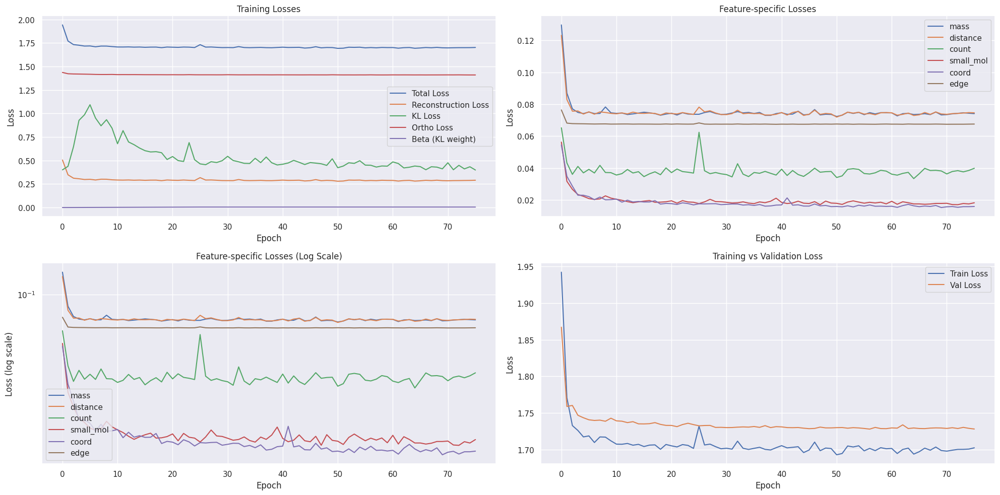

Epoch 77/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.64it/s, loss=1.7927, recon=0.3821, kl=0.4453, ortho=1.4084]


Detailed loss diagnostics:
Raw recon_loss: 0.2962
Raw KL loss: 0.4375
Ortho loss: 1.4091
Current beta: 0.0050
mu mean: -0.0904, std: 0.6347
logvar mean: -0.8915, std: 1.0217
mass: 0.0801
distance: 0.0782
count: 0.0267
small_mol: 0.0250
coord: 0.0189
edge: 0.0674


Epoch 77/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 18.68it/s, loss=1.7083, recon=0.2968, kl=0.4049, ortho=1.4095]


Detailed loss diagnostics:
Raw recon_loss: 0.2821
Raw KL loss: 0.3987
Ortho loss: 1.4114
Current beta: 0.0050
mu mean: -0.0844, std: 0.6231
logvar mean: -0.7608, std: 1.0352
mass: 0.0790
distance: 0.0745
count: 0.0261
small_mol: 0.0169
coord: 0.0174
edge: 0.0682


Epoch 77/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:01, 17.52it/s, loss=1.7318, recon=0.3206, kl=0.5251, ortho=1.4085]


Detailed loss diagnostics:
Raw recon_loss: 0.2687
Raw KL loss: 0.3786
Ortho loss: 1.4100
Current beta: 0.0050
mu mean: -0.0740, std: 0.5557
logvar mean: -0.8755, std: 1.0218
mass: 0.0707
distance: 0.0693
count: 0.0256
small_mol: 0.0203
coord: 0.0149
edge: 0.0679


Epoch 77/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 18.84it/s, loss=1.6589, recon=0.2478, kl=0.4641, ortho=1.4088]


Detailed loss diagnostics:
Raw recon_loss: 0.2357
Raw KL loss: 0.4125
Ortho loss: 1.4109
Current beta: 0.0050
mu mean: -0.0258, std: 0.6325
logvar mean: -0.7890, std: 1.0613
mass: 0.0621
distance: 0.0616
count: 0.0252
small_mol: 0.0123
coord: 0.0087
edge: 0.0657


Epoch 77/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 18.78it/s, loss=1.7410, recon=0.3122, kl=0.4516, ortho=1.4266]



Detailed loss diagnostics:
Raw recon_loss: 0.2546
Raw KL loss: 0.3722
Ortho loss: 1.4099
Current beta: 0.0050
mu mean: -0.0809, std: 0.6202
logvar mean: -0.6623, std: 1.0040
mass: 0.0660
distance: 0.0701
count: 0.0297
small_mol: 0.0083
coord: 0.0118
edge: 0.0688

Starting validation...


Epoch 77/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 69.02it/s]



Epoch [77/100] - Time: 2.55s
Train - Total: 1.6994, Recon: 0.2874, KL: 0.4072, Ortho: 1.4100, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0743
  distance_loss: 0.0743
  count_loss: 0.0371
  small_mol_loss: 0.0180
  coord_loss: 0.0163
  edge_loss: 0.0675


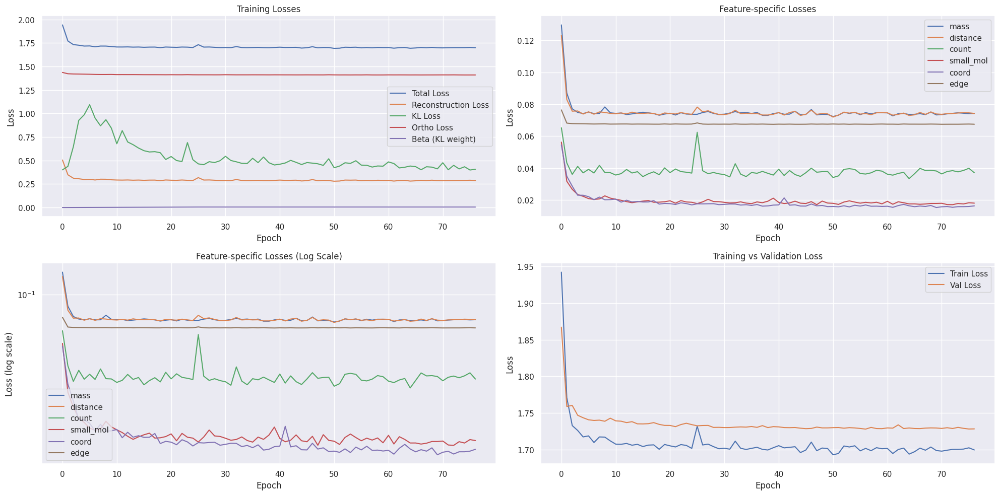

Epoch 78/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 19.67it/s, loss=1.8499, recon=0.4381, kl=0.4847, ortho=1.4094]


Detailed loss diagnostics:
Raw recon_loss: 0.2610
Raw KL loss: 0.5236
Ortho loss: 1.4085
Current beta: 0.0050
mu mean: -0.0666, std: 0.7456
logvar mean: -0.8654, std: 1.2189
mass: 0.0706
distance: 0.0693
count: 0.0257
small_mol: 0.0144
coord: 0.0154
edge: 0.0656


Epoch 78/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 20.45it/s, loss=1.6744, recon=0.2617, kl=0.4488, ortho=1.4104]


Detailed loss diagnostics:
Raw recon_loss: 0.2743
Raw KL loss: 0.5632
Ortho loss: 1.4093
Current beta: 0.0050
mu mean: -0.0597, std: 0.7111
logvar mean: -1.0897, std: 1.3225
mass: 0.0731
distance: 0.0725
count: 0.0260
small_mol: 0.0180
coord: 0.0180
edge: 0.0666


Epoch 78/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:00, 20.73it/s, loss=1.6639, recon=0.2517, kl=0.4055, ortho=1.4101]


Detailed loss diagnostics:
Raw recon_loss: 0.2709
Raw KL loss: 0.4336
Ortho loss: 1.4102
Current beta: 0.0050
mu mean: -0.0175, std: 0.6073
logvar mean: -0.9328, std: 1.0919
mass: 0.0725
distance: 0.0694
count: 0.0258
small_mol: 0.0236
coord: 0.0124
edge: 0.0672


Epoch 78/100 [Train]:  76%|███████▌  | 32/42 [00:01<00:00, 19.10it/s, loss=1.6646, recon=0.2523, kl=0.4514, ortho=1.4100]


Detailed loss diagnostics:
Raw recon_loss: 0.2555
Raw KL loss: 0.3656
Ortho loss: 1.4085
Current beta: 0.0050
mu mean: -0.0517, std: 0.5692
logvar mean: -0.7915, std: 0.9965
mass: 0.0676
distance: 0.0671
count: 0.0256
small_mol: 0.0187
coord: 0.0097
edge: 0.0668


Epoch 78/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 20.02it/s, loss=1.7435, recon=0.3172, kl=0.2034, ortho=1.4254]



Detailed loss diagnostics:
Raw recon_loss: 0.2463
Raw KL loss: 0.3336
Ortho loss: 1.4098
Current beta: 0.0050
mu mean: -0.0435, std: 0.5420
logvar mean: -0.7099, std: 0.9934
mass: 0.0650
distance: 0.0635
count: 0.0253
small_mol: 0.0114
coord: 0.0141
edge: 0.0670

Starting validation...


Epoch 78/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 66.18it/s]



Epoch [78/100] - Time: 2.42s
Train - Total: 1.6941, Recon: 0.2818, KL: 0.4528, Ortho: 1.4101, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0733
  distance_loss: 0.0733
  count_loss: 0.0361
  small_mol_loss: 0.0169
  coord_loss: 0.0147
  edge_loss: 0.0674


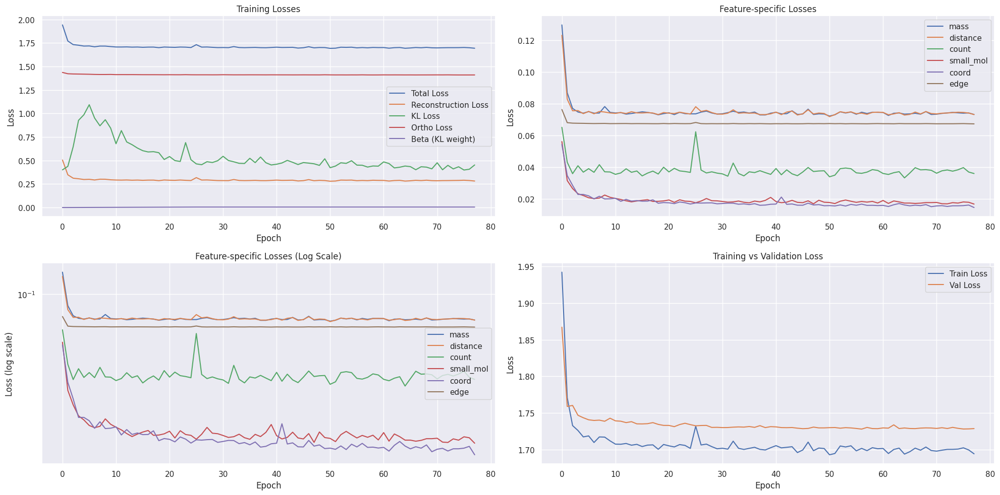

Epoch 79/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.07it/s, loss=1.6666, recon=0.2549, kl=0.3807, ortho=1.4098]


Detailed loss diagnostics:
Raw recon_loss: 0.2925
Raw KL loss: 0.5549
Ortho loss: 1.4100
Current beta: 0.0050
mu mean: -0.0562, std: 0.8010
logvar mean: -0.8235, std: 1.1598
mass: 0.0726
distance: 0.0792
count: 0.0327
small_mol: 0.0154
coord: 0.0249
edge: 0.0678


Epoch 79/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 19.24it/s, loss=1.7233, recon=0.3113, kl=0.3397, ortho=1.4104]


Detailed loss diagnostics:
Raw recon_loss: 0.2708
Raw KL loss: 0.3206
Ortho loss: 1.4111
Current beta: 0.0050
mu mean: -0.0132, std: 0.5413
logvar mean: -0.6550, std: 0.9895
mass: 0.0764
distance: 0.0725
count: 0.0260
small_mol: 0.0136
coord: 0.0150
edge: 0.0674


Epoch 79/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:00, 20.05it/s, loss=1.6939, recon=0.2837, kl=0.3644, ortho=1.4084]


Detailed loss diagnostics:
Raw recon_loss: 0.2543
Raw KL loss: 0.3393
Ortho loss: 1.4089
Current beta: 0.0050
mu mean: -0.0691, std: 0.5401
logvar mean: -0.7740, std: 0.9655
mass: 0.0686
distance: 0.0670
count: 0.0257
small_mol: 0.0142
coord: 0.0117
edge: 0.0671


Epoch 79/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 21.35it/s, loss=1.6647, recon=0.2524, kl=0.6615, ortho=1.4090]


Detailed loss diagnostics:
Raw recon_loss: 0.3570
Raw KL loss: 0.5134
Ortho loss: 1.4097
Current beta: 0.0050
mu mean: -0.0799, std: 0.7332
logvar mean: -0.8798, std: 1.1872
mass: 0.0727
distance: 0.0855
count: 0.1000
small_mol: 0.0116
coord: 0.0182
edge: 0.0688


Epoch 79/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 20.21it/s, loss=1.7156, recon=0.2817, kl=0.4008, ortho=1.4319]



Detailed loss diagnostics:
Raw recon_loss: 0.2526
Raw KL loss: 0.4711
Ortho loss: 1.4093
Current beta: 0.0050
mu mean: -0.0815, std: 0.7038
logvar mean: -0.8171, std: 1.1212
mass: 0.0638
distance: 0.0628
count: 0.0252
small_mol: 0.0099
coord: 0.0242
edge: 0.0667

Starting validation...


Epoch 79/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 64.44it/s]



Epoch [79/100] - Time: 2.41s
Train - Total: 1.6987, Recon: 0.2868, KL: 0.3879, Ortho: 1.4100, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0735
  distance_loss: 0.0740
  count_loss: 0.0390
  small_mol_loss: 0.0171
  coord_loss: 0.0156
  edge_loss: 0.0675


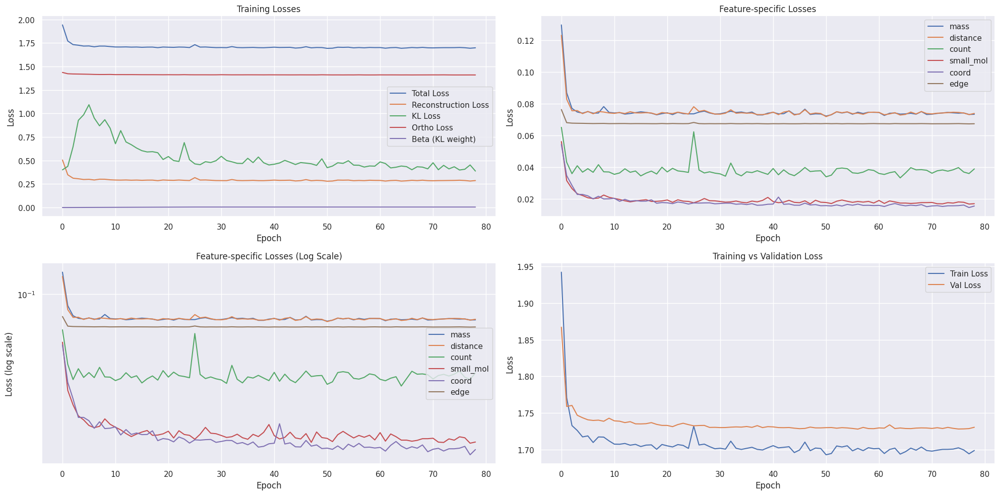

Epoch 80/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.52it/s, loss=1.6762, recon=0.2647, kl=0.3539, ortho=1.4098]


Detailed loss diagnostics:
Raw recon_loss: 0.4191
Raw KL loss: 0.4010
Ortho loss: 1.4097
Current beta: 0.0050
mu mean: -0.1182, std: 0.6046
logvar mean: -0.8206, std: 1.0683
mass: 0.0808
distance: 0.1052
count: 0.1250
small_mol: 0.0174
coord: 0.0186
edge: 0.0721


Epoch 80/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 18.84it/s, loss=1.6914, recon=0.2801, kl=0.3674, ortho=1.4095]


Detailed loss diagnostics:
Raw recon_loss: 0.2888
Raw KL loss: 0.3042
Ortho loss: 1.4088
Current beta: 0.0050
mu mean: -0.0289, std: 0.5079
logvar mean: -0.6631, std: 1.0003
mass: 0.0821
distance: 0.0794
count: 0.0268
small_mol: 0.0182
coord: 0.0161
edge: 0.0663


Epoch 80/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 18.66it/s, loss=1.6766, recon=0.2655, kl=0.3929, ortho=1.4091]


Detailed loss diagnostics:
Raw recon_loss: 0.2606
Raw KL loss: 0.3475
Ortho loss: 1.4089
Current beta: 0.0050
mu mean: -0.0386, std: 0.5455
logvar mean: -0.7589, std: 1.0176
mass: 0.0694
distance: 0.0674
count: 0.0257
small_mol: 0.0171
coord: 0.0140
edge: 0.0670


Epoch 80/100 [Train]:  76%|███████▌  | 32/42 [00:01<00:00, 18.56it/s, loss=1.6810, recon=0.2687, kl=0.4328, ortho=1.4101]


Detailed loss diagnostics:
Raw recon_loss: 0.2400
Raw KL loss: 0.4073
Ortho loss: 1.4081
Current beta: 0.0050
mu mean: -0.0547, std: 0.5980
logvar mean: -0.8446, std: 1.1108
mass: 0.0611
distance: 0.0611
count: 0.0251
small_mol: 0.0113
coord: 0.0147
edge: 0.0668


Epoch 80/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 18.83it/s, loss=3.1395, recon=1.7081, kl=0.4874, ortho=1.4290]



Detailed loss diagnostics:
Raw recon_loss: 0.2350
Raw KL loss: 0.3114
Ortho loss: 1.4109
Current beta: 0.0050
mu mean: -0.0246, std: 0.5015
logvar mean: -0.6911, std: 1.0327
mass: 0.0619
distance: 0.0612
count: 0.0252
small_mol: 0.0109
coord: 0.0096
edge: 0.0663

Starting validation...


Epoch 80/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 61.64it/s]



Epoch [80/100] - Time: 2.58s
Train - Total: 1.7302, Recon: 0.3184, KL: 0.3787, Ortho: 1.4100, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0743
  distance_loss: 0.0785
  count_loss: 0.0644
  small_mol_loss: 0.0173
  coord_loss: 0.0158
  edge_loss: 0.0681


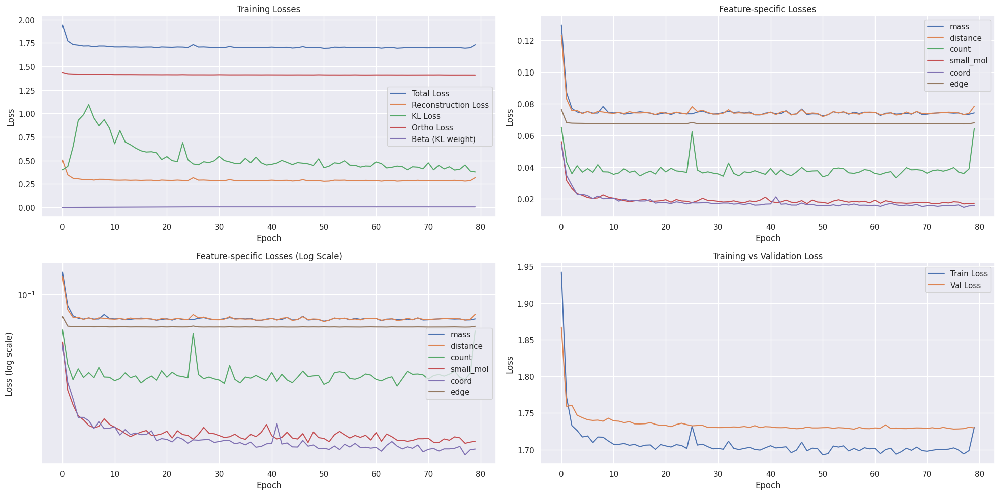

Epoch 81/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 17.05it/s, loss=1.6886, recon=0.2774, kl=0.4270, ortho=1.4090]


Detailed loss diagnostics:
Raw recon_loss: 0.3191
Raw KL loss: 0.3948
Ortho loss: 1.4100
Current beta: 0.0050
mu mean: -0.0454, std: 0.5739
logvar mean: -0.8545, std: 1.0888
mass: 0.0854
distance: 0.0836
count: 0.0269
small_mol: 0.0366
coord: 0.0196
edge: 0.0670


Epoch 81/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 20.39it/s, loss=1.6939, recon=0.2815, kl=0.5486, ortho=1.4096]


Detailed loss diagnostics:
Raw recon_loss: 0.2644
Raw KL loss: 0.4029
Ortho loss: 1.4100
Current beta: 0.0050
mu mean: -0.0540, std: 0.5762
logvar mean: -0.8586, std: 1.1266
mass: 0.0724
distance: 0.0705
count: 0.0259
small_mol: 0.0170
coord: 0.0119
edge: 0.0667


Epoch 81/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 20.10it/s, loss=1.6754, recon=0.2622, kl=0.4589, ortho=1.4109]


Detailed loss diagnostics:
Raw recon_loss: 0.2559
Raw KL loss: 0.4935
Ortho loss: 1.4113
Current beta: 0.0050
mu mean: -0.0374, std: 0.7400
logvar mean: -0.7921, std: 1.1217
mass: 0.0676
distance: 0.0660
count: 0.0255
small_mol: 0.0102
coord: 0.0201
edge: 0.0664


Epoch 81/100 [Train]:  76%|███████▌  | 32/42 [00:01<00:00, 20.13it/s, loss=1.6848, recon=0.2741, kl=0.3251, ortho=1.4091]


Detailed loss diagnostics:
Raw recon_loss: 0.2789
Raw KL loss: 0.3424
Ortho loss: 1.4117
Current beta: 0.0050
mu mean: -0.0804, std: 0.5656
logvar mean: -0.6659, std: 1.0000
mass: 0.0799
distance: 0.0777
count: 0.0265
small_mol: 0.0132
coord: 0.0152
edge: 0.0664


Epoch 81/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 20.12it/s, loss=1.8872, recon=0.4474, kl=0.4365, ortho=1.4376]



Detailed loss diagnostics:
Raw recon_loss: 0.2337
Raw KL loss: 0.3153
Ortho loss: 1.4096
Current beta: 0.0050
mu mean: -0.0602, std: 0.5208
logvar mean: -0.6555, std: 1.0274
mass: 0.0596
distance: 0.0586
count: 0.0249
small_mol: 0.0080
coord: 0.0146
edge: 0.0681

Starting validation...


Epoch 81/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 67.64it/s]



Epoch [81/100] - Time: 2.41s
Train - Total: 1.7008, Recon: 0.2885, KL: 0.4059, Ortho: 1.4103, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0738
  distance_loss: 0.0740
  count_loss: 0.0381
  small_mol_loss: 0.0190
  coord_loss: 0.0161
  edge_loss: 0.0675


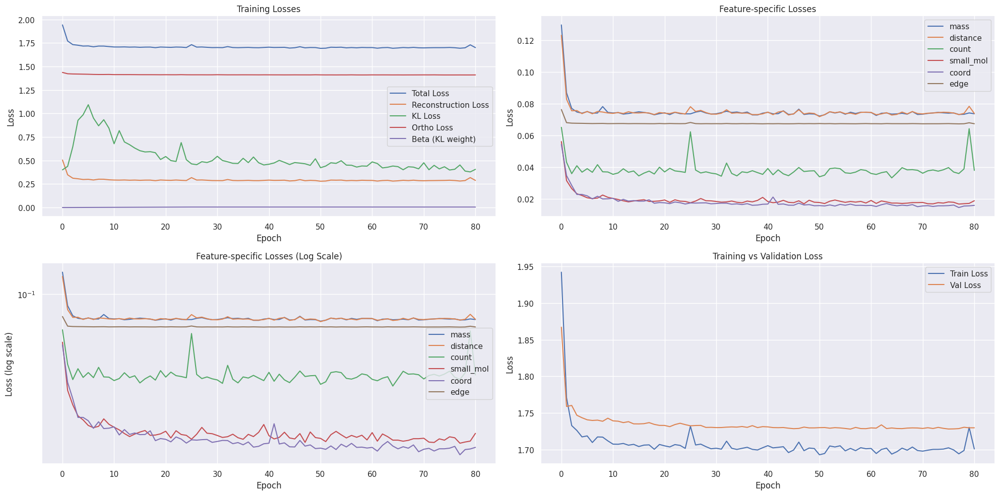

Epoch 82/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 17.61it/s, loss=1.6723, recon=0.2613, kl=0.2890, ortho=1.4096]


Detailed loss diagnostics:
Raw recon_loss: 0.2617
Raw KL loss: 0.3936
Ortho loss: 1.4099
Current beta: 0.0050
mu mean: -0.0339, std: 0.6471
logvar mean: -0.6667, std: 1.0131
mass: 0.0682
distance: 0.0682
count: 0.0256
small_mol: 0.0153
coord: 0.0171
edge: 0.0673


Epoch 82/100 [Train]:  29%|██▊       | 12/42 [00:00<00:01, 18.56it/s, loss=1.7122, recon=0.3004, kl=0.3807, ortho=1.4099]


Detailed loss diagnostics:
Raw recon_loss: 0.2529
Raw KL loss: 0.4191
Ortho loss: 1.4107
Current beta: 0.0050
mu mean: -0.0718, std: 0.6135
logvar mean: -0.8252, std: 1.1267
mass: 0.0670
distance: 0.0640
count: 0.0254
small_mol: 0.0171
coord: 0.0123
edge: 0.0671


Epoch 82/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 21.13it/s, loss=1.6685, recon=0.2564, kl=0.4123, ortho=1.4100]


Detailed loss diagnostics:
Raw recon_loss: 0.2708
Raw KL loss: 0.4517
Ortho loss: 1.4121
Current beta: 0.0050
mu mean: -0.0056, std: 0.6828
logvar mean: -0.7482, std: 1.2154
mass: 0.0737
distance: 0.0717
count: 0.0260
small_mol: 0.0115
coord: 0.0205
edge: 0.0674


Epoch 82/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 20.47it/s, loss=1.6593, recon=0.2469, kl=0.6073, ortho=1.4094]


Detailed loss diagnostics:
Raw recon_loss: 0.2722
Raw KL loss: 0.4135
Ortho loss: 1.4102
Current beta: 0.0050
mu mean: -0.0365, std: 0.6388
logvar mean: -0.7770, std: 1.0967
mass: 0.0715
distance: 0.0743
count: 0.0260
small_mol: 0.0158
coord: 0.0172
edge: 0.0675


Epoch 82/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 20.01it/s, loss=1.8460, recon=0.4180, kl=0.4780, ortho=1.4256]



Detailed loss diagnostics:
Raw recon_loss: 0.2497
Raw KL loss: 0.3850
Ortho loss: 1.4092
Current beta: 0.0050
mu mean: -0.0382, std: 0.6236
logvar mean: -0.7199, std: 1.0145
mass: 0.0646
distance: 0.0649
count: 0.0254
small_mol: 0.0181
coord: 0.0095
edge: 0.0671

Starting validation...


Epoch 82/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 69.06it/s]



Epoch [82/100] - Time: 2.41s
Train - Total: 1.6994, Recon: 0.2870, KL: 0.4188, Ortho: 1.4104, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0738
  distance_loss: 0.0738
  count_loss: 0.0368
  small_mol_loss: 0.0185
  coord_loss: 0.0166
  edge_loss: 0.0675


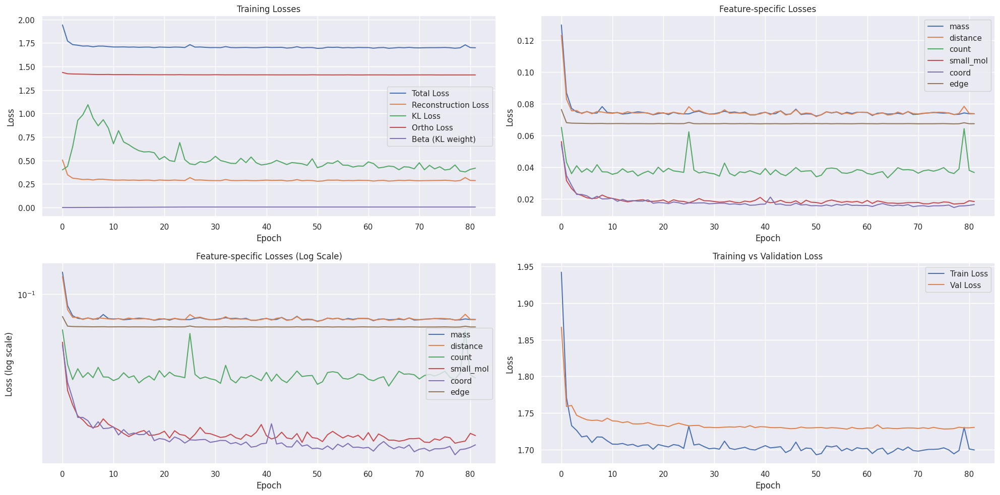

Epoch 83/100 [Train]:   7%|▋         | 3/42 [00:00<00:01, 20.60it/s, loss=1.6894, recon=0.2784, kl=0.3303, ortho=1.4094]


Detailed loss diagnostics:
Raw recon_loss: 0.2655
Raw KL loss: 0.3914
Ortho loss: 1.4098
Current beta: 0.0050
mu mean: -0.0884, std: 0.6326
logvar mean: -0.6877, std: 1.0620
mass: 0.0728
distance: 0.0704
count: 0.0259
small_mol: 0.0155
coord: 0.0136
edge: 0.0675


Epoch 83/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 18.38it/s, loss=1.6964, recon=0.2864, kl=0.3297, ortho=1.4084]


Detailed loss diagnostics:
Raw recon_loss: 0.2734
Raw KL loss: 0.3324
Ortho loss: 1.4096
Current beta: 0.0050
mu mean: -0.0607, std: 0.5478
logvar mean: -0.6821, std: 1.0234
mass: 0.0736
distance: 0.0717
count: 0.0260
small_mol: 0.0210
coord: 0.0145
edge: 0.0667


Epoch 83/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:01, 18.77it/s, loss=1.8203, recon=0.4078, kl=0.3890, ortho=1.4106]


Detailed loss diagnostics:
Raw recon_loss: 0.2764
Raw KL loss: 0.3755
Ortho loss: 1.4115
Current beta: 0.0050
mu mean: -0.0966, std: 0.5786
logvar mean: -0.7695, std: 1.0587
mass: 0.0755
distance: 0.0728
count: 0.0261
small_mol: 0.0147
coord: 0.0206
edge: 0.0667


Epoch 83/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 19.03it/s, loss=1.6753, recon=0.2626, kl=0.3377, ortho=1.4109]


Detailed loss diagnostics:
Raw recon_loss: 0.2715
Raw KL loss: 0.3140
Ortho loss: 1.4092
Current beta: 0.0050
mu mean: -0.0260, std: 0.5077
logvar mean: -0.7011, std: 1.0366
mass: 0.0749
distance: 0.0734
count: 0.0261
small_mol: 0.0151
coord: 0.0143
edge: 0.0676


Epoch 83/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.15it/s, loss=1.8090, recon=0.3750, kl=0.2427, ortho=1.4328]



Detailed loss diagnostics:
Raw recon_loss: 0.4263
Raw KL loss: 0.4237
Ortho loss: 1.4085
Current beta: 0.0050
mu mean: -0.0597, std: 0.6603
logvar mean: -0.7826, std: 1.0364
mass: 0.0793
distance: 0.0935
count: 0.1354
small_mol: 0.0266
coord: 0.0179
edge: 0.0736

Starting validation...


Epoch 83/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 68.11it/s]



Epoch [83/100] - Time: 2.51s
Train - Total: 1.6991, Recon: 0.2869, KL: 0.3708, Ortho: 1.4103, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0732
  distance_loss: 0.0735
  count_loss: 0.0390
  small_mol_loss: 0.0178
  coord_loss: 0.0157
  edge_loss: 0.0676


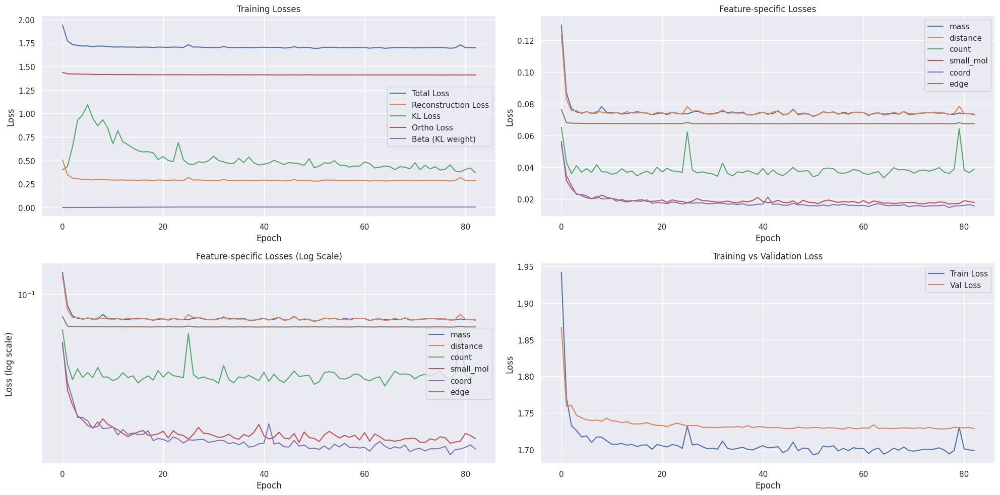

Epoch 84/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 17.99it/s, loss=1.6688, recon=0.2571, kl=0.3214, ortho=1.4102]


Detailed loss diagnostics:
Raw recon_loss: 0.2848
Raw KL loss: 0.3402
Ortho loss: 1.4092
Current beta: 0.0050
mu mean: -0.0524, std: 0.5537
logvar mean: -0.7379, std: 0.9742
mass: 0.0789
distance: 0.0767
count: 0.0265
small_mol: 0.0213
coord: 0.0152
edge: 0.0663


Epoch 84/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 19.27it/s, loss=1.6454, recon=0.2341, kl=0.4304, ortho=1.4091]


Detailed loss diagnostics:
Raw recon_loss: 0.2560
Raw KL loss: 0.4505
Ortho loss: 1.4095
Current beta: 0.0050
mu mean: -0.0391, std: 0.6659
logvar mean: -0.8567, std: 1.1078
mass: 0.0688
distance: 0.0690
count: 0.0257
small_mol: 0.0122
coord: 0.0127
edge: 0.0675


Epoch 84/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:01, 19.49it/s, loss=1.6920, recon=0.2807, kl=0.4717, ortho=1.4089]


Detailed loss diagnostics:
Raw recon_loss: 0.2756
Raw KL loss: 0.3662
Ortho loss: 1.4093
Current beta: 0.0050
mu mean: -0.0302, std: 0.5912
logvar mean: -0.7034, std: 1.0707
mass: 0.0694
distance: 0.0787
count: 0.0323
small_mol: 0.0102
coord: 0.0157
edge: 0.0692


Epoch 84/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 19.63it/s, loss=1.8129, recon=0.3997, kl=0.5125, ortho=1.4106]


Detailed loss diagnostics:
Raw recon_loss: 0.2721
Raw KL loss: 0.3769
Ortho loss: 1.4085
Current beta: 0.0050
mu mean: -0.0749, std: 0.5878
logvar mean: -0.7568, std: 1.0637
mass: 0.0728
distance: 0.0715
count: 0.0258
small_mol: 0.0163
coord: 0.0177
edge: 0.0679


Epoch 84/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.43it/s, loss=1.8298, recon=0.3900, kl=0.2957, ortho=1.4383]



Detailed loss diagnostics:
Raw recon_loss: 0.2707
Raw KL loss: 0.3203
Ortho loss: 1.4085
Current beta: 0.0050
mu mean: -0.0235, std: 0.5157
logvar mean: -0.7286, std: 1.0099
mass: 0.0740
distance: 0.0725
count: 0.0259
small_mol: 0.0193
coord: 0.0119
edge: 0.0671

Starting validation...


Epoch 84/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 68.58it/s]



Epoch [84/100] - Time: 2.48s
Train - Total: 1.7064, Recon: 0.2941, KL: 0.4056, Ortho: 1.4102, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0754
  distance_loss: 0.0752
  count_loss: 0.0405
  small_mol_loss: 0.0184
  coord_loss: 0.0170
  edge_loss: 0.0676


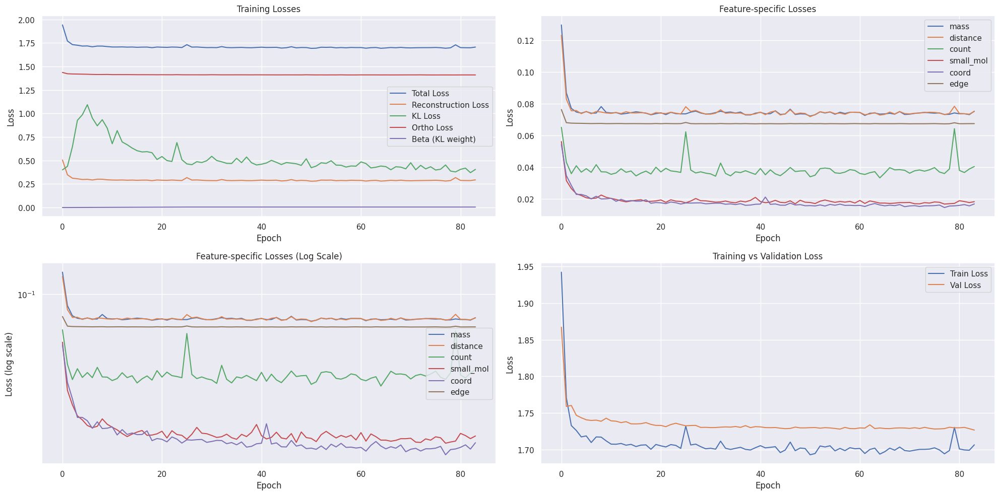

Epoch 85/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 18.92it/s, loss=1.7743, recon=0.3600, kl=0.4494, ortho=1.4120]


Detailed loss diagnostics:
Raw recon_loss: 0.2534
Raw KL loss: 0.3583
Ortho loss: 1.4091
Current beta: 0.0050
mu mean: -0.0207, std: 0.5892
logvar mean: -0.7022, std: 0.9899
mass: 0.0669
distance: 0.0662
count: 0.0255
small_mol: 0.0140
coord: 0.0143
edge: 0.0665


Epoch 85/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 20.27it/s, loss=1.6500, recon=0.2368, kl=0.3674, ortho=1.4113]


Detailed loss diagnostics:
Raw recon_loss: 0.2737
Raw KL loss: 0.3042
Ortho loss: 1.4099
Current beta: 0.0050
mu mean: -0.0391, std: 0.5521
logvar mean: -0.5776, std: 0.9405
mass: 0.0760
distance: 0.0725
count: 0.0261
small_mol: 0.0158
coord: 0.0157
edge: 0.0675


Epoch 85/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 19.66it/s, loss=1.6981, recon=0.2868, kl=0.2857, ortho=1.4099]


Detailed loss diagnostics:
Raw recon_loss: 0.3099
Raw KL loss: 0.3150
Ortho loss: 1.4100
Current beta: 0.0050
mu mean: -0.1054, std: 0.5374
logvar mean: -0.6189, std: 0.9778
mass: 0.0938
distance: 0.0761
count: 0.0264
small_mol: 0.0239
coord: 0.0227
edge: 0.0670


Epoch 85/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 19.86it/s, loss=1.6851, recon=0.2737, kl=0.3390, ortho=1.4097]


Detailed loss diagnostics:
Raw recon_loss: 0.2765
Raw KL loss: 0.3268
Ortho loss: 1.4095
Current beta: 0.0050
mu mean: -0.0228, std: 0.5388
logvar mean: -0.7193, std: 0.9487
mass: 0.0766
distance: 0.0734
count: 0.0261
small_mol: 0.0217
coord: 0.0110
edge: 0.0677


Epoch 85/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.91it/s, loss=1.7987, recon=0.3694, kl=0.4105, ortho=1.4272]



Detailed loss diagnostics:
Raw recon_loss: 0.2693
Raw KL loss: 0.3332
Ortho loss: 1.4109
Current beta: 0.0050
mu mean: -0.0479, std: 0.5267
logvar mean: -0.7307, std: 0.9994
mass: 0.0757
distance: 0.0722
count: 0.0261
small_mol: 0.0170
coord: 0.0119
edge: 0.0665

Starting validation...


Epoch 85/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 62.28it/s]



Epoch [85/100] - Time: 2.46s
Train - Total: 1.6951, Recon: 0.2825, KL: 0.3648, Ortho: 1.4109, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0737
  distance_loss: 0.0730
  count_loss: 0.0347
  small_mol_loss: 0.0176
  coord_loss: 0.0159
  edge_loss: 0.0675


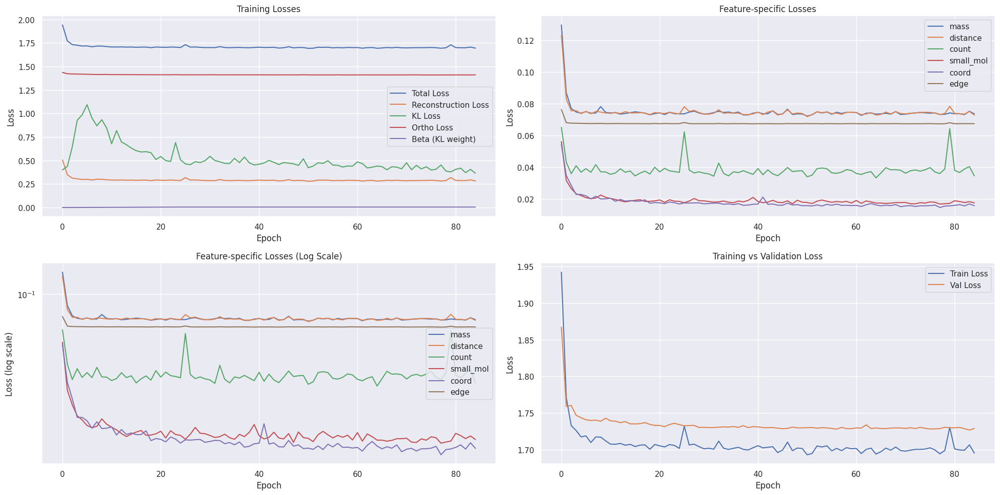

Epoch 86/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 17.72it/s, loss=1.6709, recon=0.2584, kl=0.3637, ortho=1.4106]


Detailed loss diagnostics:
Raw recon_loss: 0.2469
Raw KL loss: 0.5737
Ortho loss: 1.4094
Current beta: 0.0050
mu mean: -0.1196, std: 0.8170
logvar mean: -0.8398, std: 1.1256
mass: 0.0649
distance: 0.0630
count: 0.0253
small_mol: 0.0118
coord: 0.0139
edge: 0.0680


Epoch 86/100 [Train]:  29%|██▊       | 12/42 [00:00<00:01, 18.16it/s, loss=1.6667, recon=0.2556, kl=0.3151, ortho=1.4095]


Detailed loss diagnostics:
Raw recon_loss: 0.2567
Raw KL loss: 0.3815
Ortho loss: 1.4104
Current beta: 0.0050
mu mean: -0.1353, std: 0.6043
logvar mean: -0.7654, std: 0.9750
mass: 0.0664
distance: 0.0668
count: 0.0256
small_mol: 0.0158
coord: 0.0156
edge: 0.0666


Epoch 86/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 19.03it/s, loss=1.6478, recon=0.2352, kl=0.4307, ortho=1.4104]


Detailed loss diagnostics:
Raw recon_loss: 0.2673
Raw KL loss: 0.3425
Ortho loss: 1.4095
Current beta: 0.0050
mu mean: -0.0704, std: 0.5848
logvar mean: -0.6252, std: 0.9926
mass: 0.0713
distance: 0.0699
count: 0.0257
small_mol: 0.0126
coord: 0.0196
edge: 0.0681


Epoch 86/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 19.06it/s, loss=1.7005, recon=0.2885, kl=0.3639, ortho=1.4102]


Detailed loss diagnostics:
Raw recon_loss: 0.2492
Raw KL loss: 0.3339
Ortho loss: 1.4086
Current beta: 0.0050
mu mean: -0.0275, std: 0.5653
logvar mean: -0.6603, std: 0.9954
mass: 0.0666
distance: 0.0640
count: 0.0253
small_mol: 0.0142
coord: 0.0112
edge: 0.0678


Epoch 86/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 18.76it/s, loss=1.8596, recon=0.4198, kl=0.2465, ortho=1.4385]



Detailed loss diagnostics:
Raw recon_loss: 0.2863
Raw KL loss: 0.4286
Ortho loss: 1.4109
Current beta: 0.0050
mu mean: -0.0599, std: 0.6392
logvar mean: -0.8762, std: 1.0072
mass: 0.0765
distance: 0.0760
count: 0.0262
small_mol: 0.0263
coord: 0.0142
edge: 0.0669

Starting validation...


Epoch 86/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 64.88it/s]



Epoch [86/100] - Time: 2.57s
Train - Total: 1.6999, Recon: 0.2874, KL: 0.3797, Ortho: 1.4105, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0740
  distance_loss: 0.0742
  count_loss: 0.0379
  small_mol_loss: 0.0180
  coord_loss: 0.0158
  edge_loss: 0.0676


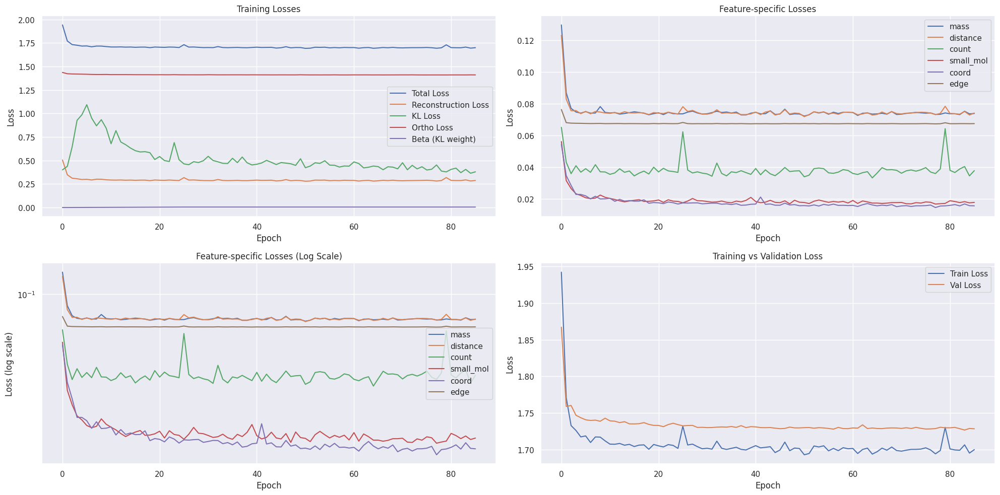

Epoch 87/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 17.24it/s, loss=1.6968, recon=0.2848, kl=0.4798, ortho=1.4097]


Detailed loss diagnostics:
Raw recon_loss: 0.3055
Raw KL loss: 0.3612
Ortho loss: 1.4106
Current beta: 0.0050
mu mean: -0.0742, std: 0.5243
logvar mean: -0.8865, std: 1.0030
mass: 0.0822
distance: 0.0756
count: 0.0264
small_mol: 0.0345
coord: 0.0191
edge: 0.0678


Epoch 87/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 19.94it/s, loss=1.6825, recon=0.2694, kl=0.5113, ortho=1.4106]


Detailed loss diagnostics:
Raw recon_loss: 0.2497
Raw KL loss: 0.6371
Ortho loss: 1.4091
Current beta: 0.0050
mu mean: -0.1131, std: 0.7987
logvar mean: -1.1015, std: 1.2943
mass: 0.0666
distance: 0.0660
count: 0.0255
small_mol: 0.0135
coord: 0.0114
edge: 0.0668


Epoch 87/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 19.84it/s, loss=1.6506, recon=0.2376, kl=0.3718, ortho=1.4112]


Detailed loss diagnostics:
Raw recon_loss: 0.2773
Raw KL loss: 0.4408
Ortho loss: 1.4101
Current beta: 0.0050
mu mean: -0.0545, std: 0.6626
logvar mean: -0.8037, std: 1.0827
mass: 0.0761
distance: 0.0752
count: 0.0262
small_mol: 0.0161
coord: 0.0167
edge: 0.0671


Epoch 87/100 [Train]:  76%|███████▌  | 32/42 [00:01<00:00, 19.55it/s, loss=1.6934, recon=0.2826, kl=0.3458, ortho=1.4090]


Detailed loss diagnostics:
Raw recon_loss: 0.2825
Raw KL loss: 0.4384
Ortho loss: 1.4099
Current beta: 0.0050
mu mean: -0.0536, std: 0.6909
logvar mean: -0.7093, std: 1.0860
mass: 0.0731
distance: 0.0696
count: 0.0258
small_mol: 0.0164
coord: 0.0302
edge: 0.0672


Epoch 87/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.74it/s, loss=1.6963, recon=0.2687, kl=0.3885, ortho=1.4257]



Detailed loss diagnostics:
Raw recon_loss: 0.2827
Raw KL loss: 0.3341
Ortho loss: 1.4102
Current beta: 0.0050
mu mean: 0.0081, std: 0.5699
logvar mean: -0.6046, std: 1.0641
mass: 0.0781
distance: 0.0773
count: 0.0263
small_mol: 0.0139
coord: 0.0190
edge: 0.0679

Starting validation...


Epoch 87/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 69.30it/s]



Epoch [87/100] - Time: 2.44s
Train - Total: 1.6979, Recon: 0.2848, KL: 0.4337, Ortho: 1.4109, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0726
  distance_loss: 0.0733
  count_loss: 0.0387
  small_mol_loss: 0.0174
  coord_loss: 0.0152
  edge_loss: 0.0676


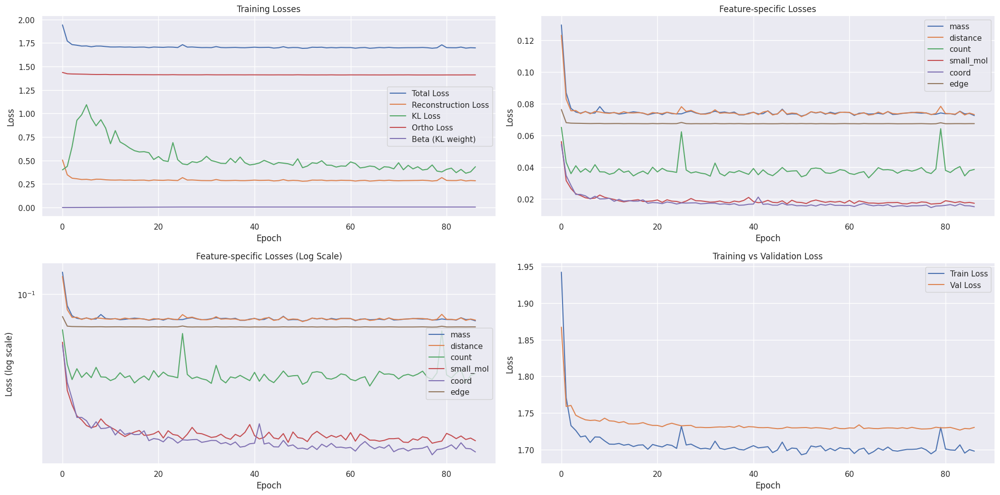

Epoch 88/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 17.60it/s, loss=1.7180, recon=0.3058, kl=0.3395, ortho=1.4105]


Detailed loss diagnostics:
Raw recon_loss: 0.2415
Raw KL loss: 0.2807
Ortho loss: 1.4113
Current beta: 0.0050
mu mean: -0.0038, std: 0.4949
logvar mean: -0.5857, std: 0.9772
mass: 0.0640
distance: 0.0651
count: 0.0254
small_mol: 0.0118
coord: 0.0085
edge: 0.0667


Epoch 88/100 [Train]:  29%|██▊       | 12/42 [00:00<00:01, 20.53it/s, loss=1.6633, recon=0.2524, kl=0.3360, ortho=1.4093]


Detailed loss diagnostics:
Raw recon_loss: 0.2608
Raw KL loss: 0.3404
Ortho loss: 1.4096
Current beta: 0.0050
mu mean: -0.0826, std: 0.5562
logvar mean: -0.6635, std: 1.0302
mass: 0.0725
distance: 0.0721
count: 0.0259
small_mol: 0.0103
coord: 0.0124
edge: 0.0675


Epoch 88/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 19.81it/s, loss=1.9566, recon=0.5439, kl=0.4110, ortho=1.4107]


Detailed loss diagnostics:
Raw recon_loss: 0.2798
Raw KL loss: 0.4013
Ortho loss: 1.4096
Current beta: 0.0050
mu mean: -0.0928, std: 0.6392
logvar mean: -0.7174, std: 1.0414
mass: 0.0766
distance: 0.0745
count: 0.0262
small_mol: 0.0175
coord: 0.0173
edge: 0.0676


Epoch 88/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 19.73it/s, loss=1.6582, recon=0.2450, kl=0.5605, ortho=1.4104]


Detailed loss diagnostics:
Raw recon_loss: 0.2644
Raw KL loss: 0.3562
Ortho loss: 1.4088
Current beta: 0.0050
mu mean: -0.0464, std: 0.5457
logvar mean: -0.7606, std: 1.0819
mass: 0.0723
distance: 0.0687
count: 0.0259
small_mol: 0.0186
coord: 0.0119
edge: 0.0670


Epoch 88/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.63it/s, loss=1.9989, recon=0.5665, kl=1.2880, ortho=1.4259]



Detailed loss diagnostics:
Raw recon_loss: 0.2484
Raw KL loss: 0.4017
Ortho loss: 1.4096
Current beta: 0.0050
mu mean: -0.0802, std: 0.5818
logvar mean: -0.8894, std: 1.0686
mass: 0.0626
distance: 0.0642
count: 0.0279
small_mol: 0.0148
coord: 0.0115
edge: 0.0674

Starting validation...


Epoch 88/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 68.36it/s]



Epoch [88/100] - Time: 2.46s
Train - Total: 1.7057, Recon: 0.2937, KL: 0.4167, Ortho: 1.4100, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0744
  distance_loss: 0.0743
  count_loss: 0.0393
  small_mol_loss: 0.0174
  coord_loss: 0.0207
  edge_loss: 0.0675


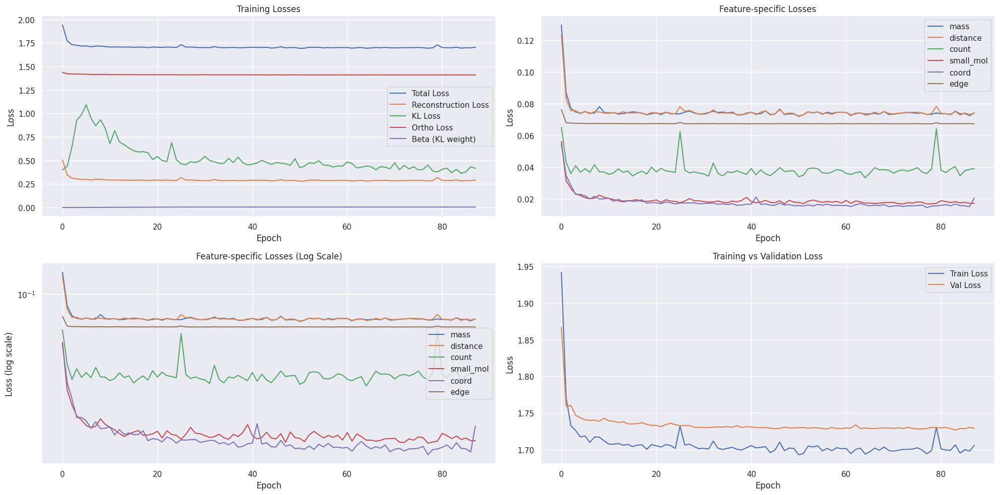

Epoch 89/100 [Train]:  10%|▉         | 4/42 [00:00<00:01, 19.45it/s, loss=1.6576, recon=0.2475, kl=0.3884, ortho=1.4081]


Detailed loss diagnostics:
Raw recon_loss: 0.2791
Raw KL loss: 0.3617
Ortho loss: 1.4108
Current beta: 0.0050
mu mean: -0.0745, std: 0.5572
logvar mean: -0.7843, std: 1.0253
mass: 0.0754
distance: 0.0722
count: 0.0261
small_mol: 0.0256
coord: 0.0125
edge: 0.0672


Epoch 89/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 19.65it/s, loss=1.6767, recon=0.2655, kl=0.3116, ortho=1.4096]


Detailed loss diagnostics:
Raw recon_loss: 0.2561
Raw KL loss: 0.3211
Ortho loss: 1.4101
Current beta: 0.0050
mu mean: -0.0706, std: 0.5345
logvar mean: -0.6335, std: 1.0317
mass: 0.0696
distance: 0.0695
count: 0.0258
small_mol: 0.0111
coord: 0.0130
edge: 0.0672


Epoch 89/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:01, 18.75it/s, loss=1.6843, recon=0.2735, kl=0.3626, ortho=1.4090]


Detailed loss diagnostics:
Raw recon_loss: 0.2696
Raw KL loss: 0.6874
Ortho loss: 1.4097
Current beta: 0.0050
mu mean: -0.1591, std: 0.8680
logvar mean: -1.0914, std: 1.2428
mass: 0.0686
distance: 0.0666
count: 0.0255
small_mol: 0.0167
coord: 0.0250
edge: 0.0672


Epoch 89/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 20.20it/s, loss=1.7126, recon=0.2988, kl=0.4215, ortho=1.4116]


Detailed loss diagnostics:
Raw recon_loss: 0.2510
Raw KL loss: 0.3888
Ortho loss: 1.4088
Current beta: 0.0050
mu mean: -0.0547, std: 0.5933
logvar mean: -0.7881, std: 1.1007
mass: 0.0635
distance: 0.0686
count: 0.0295
small_mol: 0.0096
coord: 0.0119
edge: 0.0679


Epoch 89/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.58it/s, loss=1.7568, recon=0.3297, kl=0.2271, ortho=1.4260]



Detailed loss diagnostics:
Raw recon_loss: 0.2668
Raw KL loss: 0.3026
Ortho loss: 1.4094
Current beta: 0.0050
mu mean: -0.0314, std: 0.5175
logvar mean: -0.6252, std: 0.9917
mass: 0.0751
distance: 0.0702
count: 0.0258
small_mol: 0.0159
coord: 0.0124
edge: 0.0673

Starting validation...


Epoch 89/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 68.88it/s]



Epoch [89/100] - Time: 2.46s
Train - Total: 1.7042, Recon: 0.2918, KL: 0.3909, Ortho: 1.4104, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0752
  distance_loss: 0.0755
  count_loss: 0.0396
  small_mol_loss: 0.0176
  coord_loss: 0.0163
  edge_loss: 0.0676


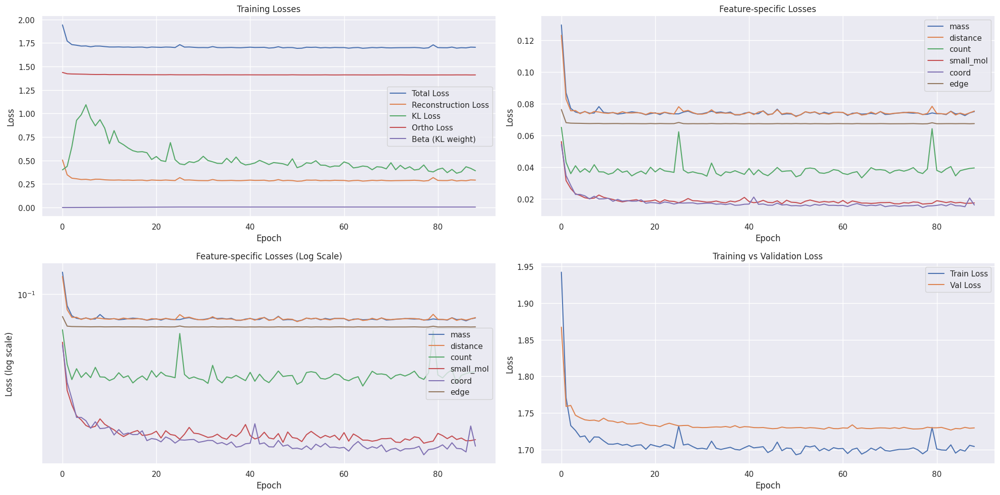

Epoch 90/100 [Train]:   7%|▋         | 3/42 [00:00<00:02, 18.67it/s, loss=1.6904, recon=0.2783, kl=0.2877, ortho=1.4107]


Detailed loss diagnostics:
Raw recon_loss: 0.2754
Raw KL loss: 0.3262
Ortho loss: 1.4087
Current beta: 0.0050
mu mean: -0.0561, std: 0.5302
logvar mean: -0.6985, std: 1.0100
mass: 0.0742
distance: 0.0719
count: 0.0261
small_mol: 0.0216
coord: 0.0145
edge: 0.0670


Epoch 90/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 18.14it/s, loss=1.6992, recon=0.2876, kl=0.3638, ortho=1.4098]


Detailed loss diagnostics:
Raw recon_loss: 0.2623
Raw KL loss: 0.3742
Ortho loss: 1.4085
Current beta: 0.0050
mu mean: -0.0471, std: 0.5971
logvar mean: -0.7210, std: 1.0540
mass: 0.0716
distance: 0.0724
count: 0.0258
small_mol: 0.0134
coord: 0.0119
edge: 0.0672


Epoch 90/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 19.75it/s, loss=1.6743, recon=0.2640, kl=0.3274, ortho=1.4086]


Detailed loss diagnostics:
Raw recon_loss: 0.2697
Raw KL loss: 0.3034
Ortho loss: 1.4086
Current beta: 0.0050
mu mean: -0.0069, std: 0.5247
logvar mean: -0.6285, std: 0.9834
mass: 0.0734
distance: 0.0720
count: 0.0260
small_mol: 0.0138
coord: 0.0175
edge: 0.0670


Epoch 90/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 20.37it/s, loss=1.7019, recon=0.2909, kl=0.3613, ortho=1.4091]


Detailed loss diagnostics:
Raw recon_loss: 0.2713
Raw KL loss: 0.4062
Ortho loss: 1.4093
Current beta: 0.0050
mu mean: -0.0459, std: 0.6265
logvar mean: -0.7833, std: 1.0640
mass: 0.0735
distance: 0.0700
count: 0.0259
small_mol: 0.0168
coord: 0.0179
edge: 0.0673


Epoch 90/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.86it/s, loss=1.8514, recon=0.4167, kl=0.4861, ortho=1.4323]



Detailed loss diagnostics:
Raw recon_loss: 0.2529
Raw KL loss: 0.3619
Ortho loss: 1.4093
Current beta: 0.0050
mu mean: -0.0378, std: 0.5756
logvar mean: -0.7429, std: 1.0444
mass: 0.0681
distance: 0.0677
count: 0.0255
small_mol: 0.0111
coord: 0.0128
edge: 0.0676

Starting validation...


Epoch 90/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 69.59it/s]



Epoch [90/100] - Time: 2.42s
Train - Total: 1.7025, Recon: 0.2904, KL: 0.3832, Ortho: 1.4102, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0743
  distance_loss: 0.0746
  count_loss: 0.0390
  small_mol_loss: 0.0184
  coord_loss: 0.0166
  edge_loss: 0.0676


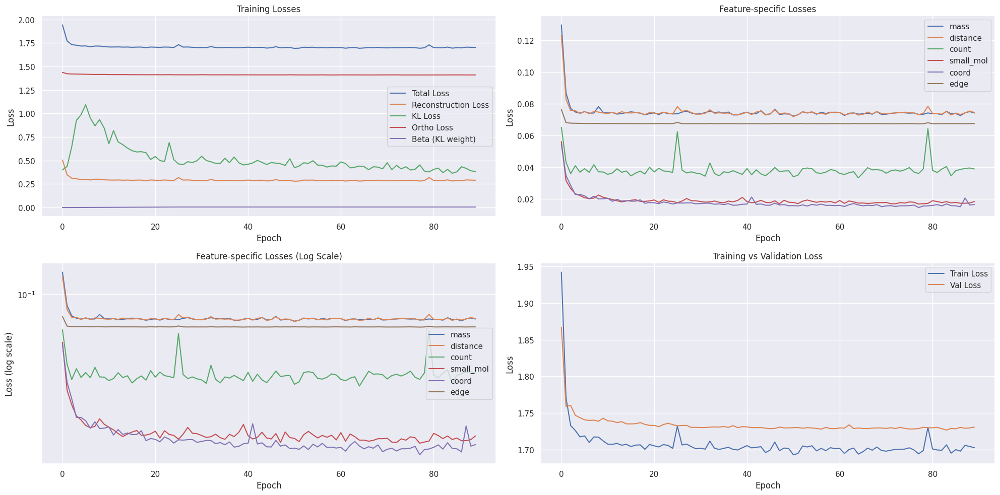

Epoch 91/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.55it/s, loss=1.7323, recon=0.3209, kl=0.5345, ortho=1.4087]


Detailed loss diagnostics:
Raw recon_loss: 0.2538
Raw KL loss: 0.4327
Ortho loss: 1.4110
Current beta: 0.0050
mu mean: -0.0442, std: 0.6231
logvar mean: -0.8991, std: 1.0985
mass: 0.0667
distance: 0.0659
count: 0.0255
small_mol: 0.0175
coord: 0.0122
edge: 0.0660


Epoch 91/100 [Train]:  29%|██▊       | 12/42 [00:00<00:01, 20.60it/s, loss=1.7076, recon=0.2929, kl=0.5597, ortho=1.4119]


Detailed loss diagnostics:
Raw recon_loss: 0.2723
Raw KL loss: 0.4254
Ortho loss: 1.4105
Current beta: 0.0050
mu mean: -0.0226, std: 0.6189
logvar mean: -0.8573, std: 1.1369
mass: 0.0758
distance: 0.0746
count: 0.0263
small_mol: 0.0152
coord: 0.0140
edge: 0.0665


Epoch 91/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 19.37it/s, loss=1.6847, recon=0.2700, kl=0.5430, ortho=1.4120]


Detailed loss diagnostics:
Raw recon_loss: 0.2521
Raw KL loss: 0.4188
Ortho loss: 1.4105
Current beta: 0.0050
mu mean: -0.0407, std: 0.6350
logvar mean: -0.7735, std: 1.1485
mass: 0.0688
distance: 0.0666
count: 0.0256
small_mol: 0.0129
coord: 0.0114
edge: 0.0668


Epoch 91/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 19.49it/s, loss=1.6870, recon=0.2758, kl=0.3177, ortho=1.4096]


Detailed loss diagnostics:
Raw recon_loss: 0.2662
Raw KL loss: 0.2913
Ortho loss: 1.4112
Current beta: 0.0050
mu mean: -0.0117, std: 0.4845
logvar mean: -0.5993, std: 1.0891
mass: 0.0743
distance: 0.0739
count: 0.0261
small_mol: 0.0132
coord: 0.0116
edge: 0.0671


Epoch 91/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.44it/s, loss=1.7068, recon=0.2787, kl=0.3887, ortho=1.4262]



Detailed loss diagnostics:
Raw recon_loss: 0.2440
Raw KL loss: 0.5166
Ortho loss: 1.4109
Current beta: 0.0050
mu mean: -0.1388, std: 0.7536
logvar mean: -0.8243, std: 1.1487
mass: 0.0649
distance: 0.0629
count: 0.0253
small_mol: 0.0126
coord: 0.0108
edge: 0.0674

Starting validation...


Epoch 91/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 66.83it/s]



Epoch [91/100] - Time: 2.48s
Train - Total: 1.7021, Recon: 0.2892, KL: 0.4237, Ortho: 1.4107, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0753
  distance_loss: 0.0753
  count_loss: 0.0368
  small_mol_loss: 0.0177
  coord_loss: 0.0166
  edge_loss: 0.0675


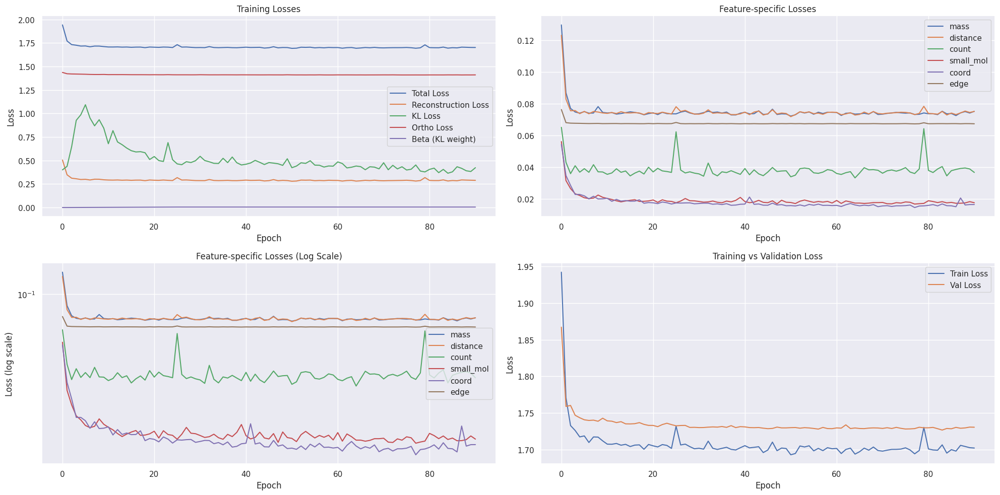

Epoch 92/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 17.58it/s, loss=1.6550, recon=0.2437, kl=0.3953, ortho=1.4094]


Detailed loss diagnostics:
Raw recon_loss: 0.2920
Raw KL loss: 0.3957
Ortho loss: 1.4100
Current beta: 0.0050
mu mean: -0.0724, std: 0.6067
logvar mean: -0.7466, std: 1.1618
mass: 0.0826
distance: 0.0777
count: 0.0265
small_mol: 0.0182
coord: 0.0192
edge: 0.0676


Epoch 92/100 [Train]:  29%|██▊       | 12/42 [00:00<00:01, 20.37it/s, loss=1.8297, recon=0.4177, kl=0.4554, ortho=1.4097]


Detailed loss diagnostics:
Raw recon_loss: 0.2926
Raw KL loss: 0.5265
Ortho loss: 1.4113
Current beta: 0.0050
mu mean: -0.0358, std: 0.7737
logvar mean: -0.8254, std: 1.1621
mass: 0.0757
distance: 0.0733
count: 0.0261
small_mol: 0.0249
coord: 0.0257
edge: 0.0669


Epoch 92/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 19.23it/s, loss=1.6573, recon=0.2450, kl=0.3355, ortho=1.4106]


Detailed loss diagnostics:
Raw recon_loss: 0.2446
Raw KL loss: 0.5105
Ortho loss: 1.4090
Current beta: 0.0050
mu mean: -0.1103, std: 0.7573
logvar mean: -0.7957, std: 1.1509
mass: 0.0643
distance: 0.0634
count: 0.0253
small_mol: 0.0107
coord: 0.0134
edge: 0.0673


Epoch 92/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 20.19it/s, loss=1.8500, recon=0.4390, kl=0.3546, ortho=1.4092]


Detailed loss diagnostics:
Raw recon_loss: 0.2517
Raw KL loss: 0.3114
Ortho loss: 1.4098
Current beta: 0.0050
mu mean: -0.0819, std: 0.5101
logvar mean: -0.6587, std: 1.0606
mass: 0.0680
distance: 0.0659
count: 0.0255
small_mol: 0.0124
coord: 0.0132
edge: 0.0666


Epoch 92/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.80it/s, loss=1.8100, recon=0.3810, kl=0.3513, ortho=1.4272]



Detailed loss diagnostics:
Raw recon_loss: 0.2431
Raw KL loss: 0.3352
Ortho loss: 1.4104
Current beta: 0.0050
mu mean: -0.0061, std: 0.5623
logvar mean: -0.6366, std: 1.0697
mass: 0.0657
distance: 0.0648
count: 0.0254
small_mol: 0.0105
coord: 0.0103
edge: 0.0664

Starting validation...


Epoch 92/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 69.36it/s]



Epoch [92/100] - Time: 2.43s
Train - Total: 1.6974, Recon: 0.2853, KL: 0.3883, Ortho: 1.4101, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0737
  distance_loss: 0.0737
  count_loss: 0.0375
  small_mol_loss: 0.0169
  coord_loss: 0.0160
  edge_loss: 0.0676


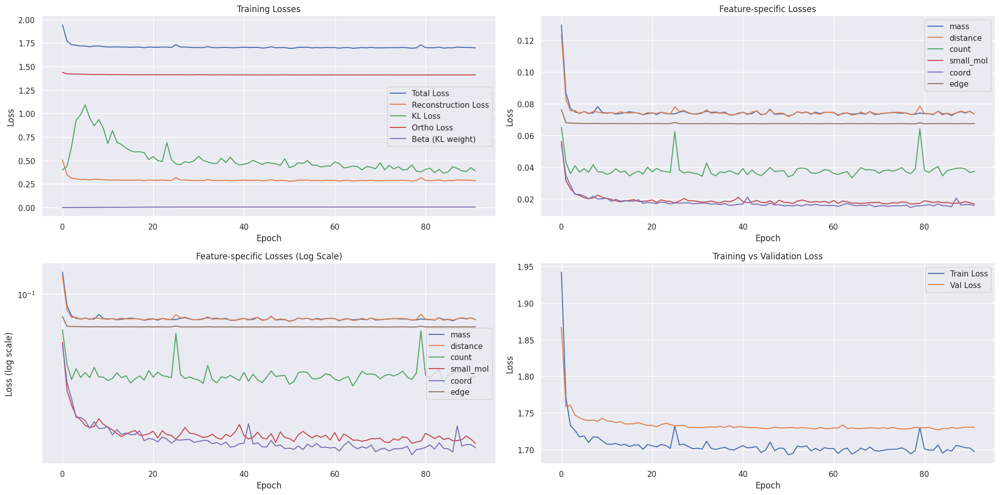

Epoch 93/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 17.45it/s, loss=1.6698, recon=0.2569, kl=0.7011, ortho=1.4094]


Detailed loss diagnostics:
Raw recon_loss: 0.3140
Raw KL loss: 0.3405
Ortho loss: 1.4092
Current beta: 0.0050
mu mean: -0.0204, std: 0.5514
logvar mean: -0.7250, std: 1.0476
mass: 0.0861
distance: 0.0862
count: 0.0268
small_mol: 0.0305
coord: 0.0166
edge: 0.0678


Epoch 93/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 19.96it/s, loss=1.6470, recon=0.2347, kl=0.4206, ortho=1.4102]


Detailed loss diagnostics:
Raw recon_loss: 0.4317
Raw KL loss: 0.4292
Ortho loss: 1.4090
Current beta: 0.0050
mu mean: -0.0498, std: 0.6404
logvar mean: -0.8235, std: 1.1692
mass: 0.0814
distance: 0.0935
count: 0.1572
small_mol: 0.0141
coord: 0.0165
edge: 0.0689


Epoch 93/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:00, 20.72it/s, loss=1.7217, recon=0.3100, kl=0.4164, ortho=1.4096]


Detailed loss diagnostics:
Raw recon_loss: 0.2777
Raw KL loss: 0.2828
Ortho loss: 1.4098
Current beta: 0.0050
mu mean: 0.0078, std: 0.4695
logvar mean: -0.6162, std: 1.0666
mass: 0.0774
distance: 0.0725
count: 0.0261
small_mol: 0.0195
coord: 0.0156
edge: 0.0665


Epoch 93/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 19.46it/s, loss=1.6496, recon=0.2380, kl=0.5869, ortho=1.4086]


Detailed loss diagnostics:
Raw recon_loss: 0.2515
Raw KL loss: 0.3636
Ortho loss: 1.4108
Current beta: 0.0050
mu mean: -0.0234, std: 0.5859
logvar mean: -0.7173, std: 1.0689
mass: 0.0664
distance: 0.0652
count: 0.0286
small_mol: 0.0142
coord: 0.0099
edge: 0.0672


Epoch 93/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.13it/s, loss=1.7546, recon=0.3266, kl=0.2648, ortho=1.4267]



Detailed loss diagnostics:
Raw recon_loss: 0.2581
Raw KL loss: 0.4137
Ortho loss: 1.4084
Current beta: 0.0050
mu mean: -0.0523, std: 0.6609
logvar mean: -0.7074, std: 1.0769
mass: 0.0698
distance: 0.0681
count: 0.0257
small_mol: 0.0140
coord: 0.0125
edge: 0.0681

Starting validation...


Epoch 93/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 68.28it/s]



Epoch [93/100] - Time: 2.51s
Train - Total: 1.6993, Recon: 0.2872, KL: 0.4003, Ortho: 1.4101, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0747
  distance_loss: 0.0745
  count_loss: 0.0370
  small_mol_loss: 0.0175
  coord_loss: 0.0159
  edge_loss: 0.0675


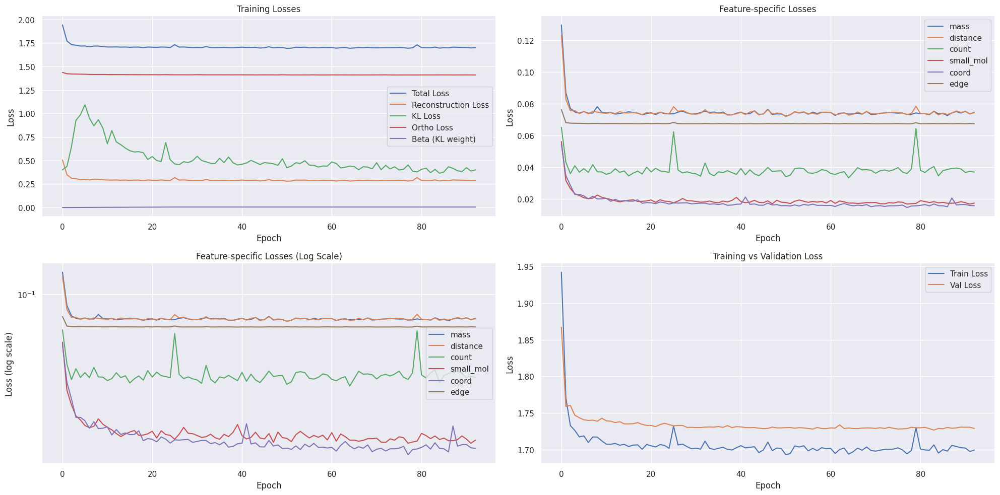

Epoch 94/100 [Train]:   5%|▍         | 2/42 [00:00<00:02, 18.51it/s, loss=1.6776, recon=0.2672, kl=0.3986, ortho=1.4085]


Detailed loss diagnostics:
Raw recon_loss: 0.2864
Raw KL loss: 0.3996
Ortho loss: 1.4099
Current beta: 0.0050
mu mean: -0.0333, std: 0.6393
logvar mean: -0.7522, std: 1.0408
mass: 0.0768
distance: 0.0757
count: 0.0262
small_mol: 0.0252
coord: 0.0161
edge: 0.0664


Epoch 94/100 [Train]:  29%|██▊       | 12/42 [00:00<00:01, 19.57it/s, loss=1.7022, recon=0.2898, kl=0.4074, ortho=1.4104]


Detailed loss diagnostics:
Raw recon_loss: 0.2870
Raw KL loss: 0.4194
Ortho loss: 1.4088
Current beta: 0.0050
mu mean: -0.0509, std: 0.6665
logvar mean: -0.7426, std: 1.0584
mass: 0.0624
distance: 0.0668
count: 0.0640
small_mol: 0.0153
coord: 0.0083
edge: 0.0701


Epoch 94/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 19.27it/s, loss=1.7110, recon=0.2994, kl=0.3408, ortho=1.4099]


Detailed loss diagnostics:
Raw recon_loss: 0.3201
Raw KL loss: 0.4414
Ortho loss: 1.4100
Current beta: 0.0050
mu mean: -0.0741, std: 0.6741
logvar mean: -0.7680, std: 1.1090
mass: 0.0904
distance: 0.0860
count: 0.0272
small_mol: 0.0224
coord: 0.0276
edge: 0.0664


Epoch 94/100 [Train]:  79%|███████▊  | 33/42 [00:01<00:00, 20.05it/s, loss=1.6469, recon=0.2354, kl=0.3884, ortho=1.4096]


Detailed loss diagnostics:
Raw recon_loss: 0.2774
Raw KL loss: 0.3803
Ortho loss: 1.4101
Current beta: 0.0050
mu mean: -0.0712, std: 0.5782
logvar mean: -0.7578, std: 1.1335
mass: 0.0773
distance: 0.0770
count: 0.0264
small_mol: 0.0150
coord: 0.0151
edge: 0.0666


Epoch 94/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.63it/s, loss=1.7495, recon=0.3170, kl=0.4181, ortho=1.4304]



Detailed loss diagnostics:
Raw recon_loss: 0.2680
Raw KL loss: 0.4106
Ortho loss: 1.4083
Current beta: 0.0050
mu mean: -0.0835, std: 0.6345
logvar mean: -0.7486, std: 1.1049
mass: 0.0721
distance: 0.0707
count: 0.0259
small_mol: 0.0164
coord: 0.0159
edge: 0.0670

Starting validation...


Epoch 94/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 69.48it/s]



Epoch [94/100] - Time: 2.45s
Train - Total: 1.6980, Recon: 0.2860, KL: 0.4016, Ortho: 1.4100, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0746
  distance_loss: 0.0742
  count_loss: 0.0362
  small_mol_loss: 0.0175
  coord_loss: 0.0161
  edge_loss: 0.0674


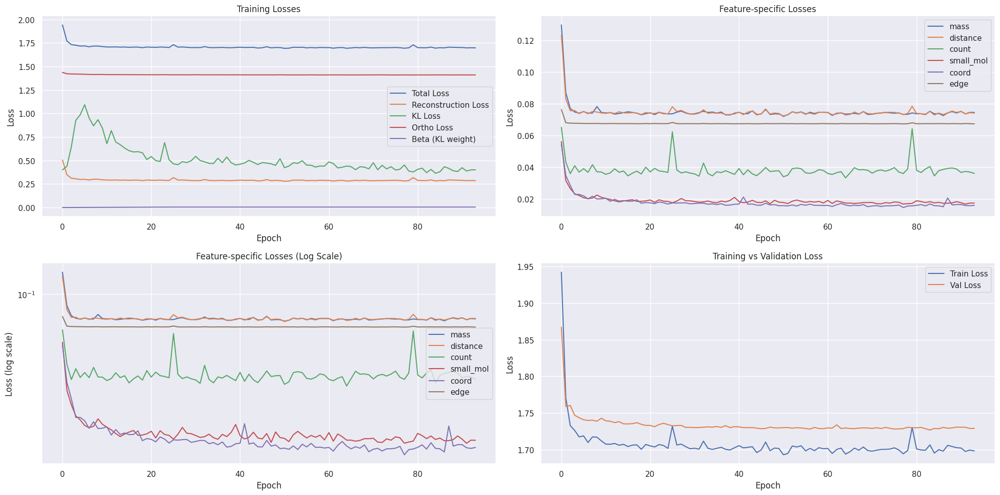

Epoch 95/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.25it/s, loss=1.7075, recon=0.2961, kl=0.3706, ortho=1.4095]


Detailed loss diagnostics:
Raw recon_loss: 0.2387
Raw KL loss: 0.3773
Ortho loss: 1.4098
Current beta: 0.0050
mu mean: -0.0743, std: 0.6316
logvar mean: -0.6357, std: 1.0401
mass: 0.0629
distance: 0.0621
count: 0.0252
small_mol: 0.0106
coord: 0.0121
edge: 0.0658


Epoch 95/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 18.95it/s, loss=1.7000, recon=0.2872, kl=0.3403, ortho=1.4110]


Detailed loss diagnostics:
Raw recon_loss: 0.2510
Raw KL loss: 0.4706
Ortho loss: 1.4100
Current beta: 0.0050
mu mean: -0.0591, std: 0.6739
logvar mean: -0.8992, std: 1.1374
mass: 0.0660
distance: 0.0652
count: 0.0255
small_mol: 0.0170
coord: 0.0104
edge: 0.0671


Epoch 95/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 19.07it/s, loss=1.6854, recon=0.2729, kl=0.4455, ortho=1.4103]


Detailed loss diagnostics:
Raw recon_loss: 0.2795
Raw KL loss: 0.3372
Ortho loss: 1.4098
Current beta: 0.0050
mu mean: -0.0321, std: 0.5277
logvar mean: -0.7093, std: 1.1139
mass: 0.0761
distance: 0.0704
count: 0.0259
small_mol: 0.0202
coord: 0.0185
edge: 0.0683


Epoch 95/100 [Train]:  76%|███████▌  | 32/42 [00:01<00:00, 19.08it/s, loss=1.7254, recon=0.3133, kl=0.4785, ortho=1.4096]


Detailed loss diagnostics:
Raw recon_loss: 0.3483
Raw KL loss: 0.4163
Ortho loss: 1.4099
Current beta: 0.0050
mu mean: -0.0803, std: 0.6133
logvar mean: -0.8606, std: 1.1165
mass: 0.0718
distance: 0.0865
count: 0.0908
small_mol: 0.0182
coord: 0.0123
edge: 0.0687


Epoch 95/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.39it/s, loss=1.7811, recon=0.3480, kl=0.2439, ortho=1.4319]



Detailed loss diagnostics:
Raw recon_loss: 0.2637
Raw KL loss: 0.4577
Ortho loss: 1.4096
Current beta: 0.0050
mu mean: -0.0784, std: 0.6851
logvar mean: -0.8267, std: 1.1251
mass: 0.0690
distance: 0.0689
count: 0.0258
small_mol: 0.0111
coord: 0.0223
edge: 0.0666

Starting validation...


Epoch 95/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 66.07it/s]



Epoch [95/100] - Time: 2.49s
Train - Total: 1.6973, Recon: 0.2850, KL: 0.4008, Ortho: 1.4103, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0744
  distance_loss: 0.0739
  count_loss: 0.0353
  small_mol_loss: 0.0182
  coord_loss: 0.0158
  edge_loss: 0.0675


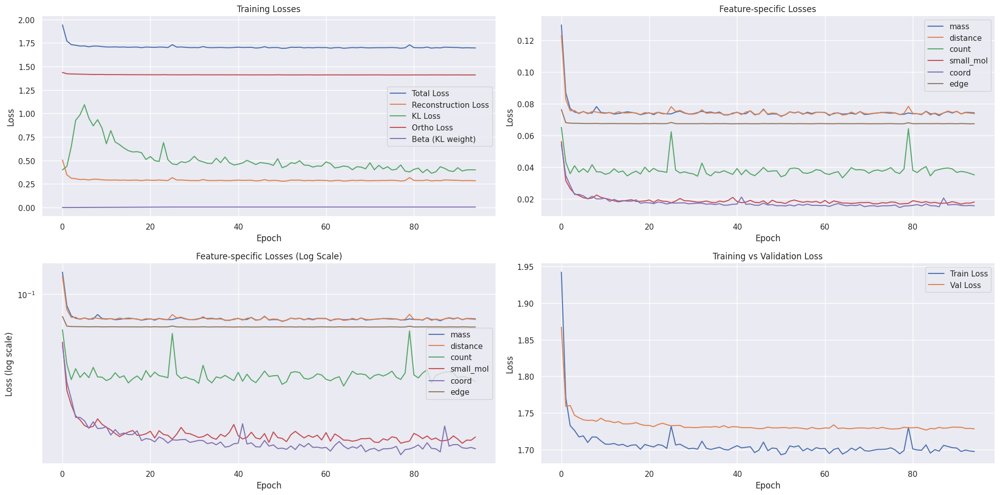

Epoch 96/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.06it/s, loss=1.6596, recon=0.2465, kl=0.4600, ortho=1.4108]


Detailed loss diagnostics:
Raw recon_loss: 0.2649
Raw KL loss: 0.4616
Ortho loss: 1.4091
Current beta: 0.0050
mu mean: -0.0784, std: 0.6479
logvar mean: -0.9216, std: 1.1763
mass: 0.0723
distance: 0.0706
count: 0.0259
small_mol: 0.0151
coord: 0.0146
edge: 0.0664


Epoch 96/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 19.37it/s, loss=1.6941, recon=0.2810, kl=0.3929, ortho=1.4112]


Detailed loss diagnostics:
Raw recon_loss: 0.2646
Raw KL loss: 0.4723
Ortho loss: 1.4114
Current beta: 0.0050
mu mean: -0.0847, std: 0.6326
logvar mean: -0.9610, std: 1.2688
mass: 0.0750
distance: 0.0705
count: 0.0260
small_mol: 0.0133
coord: 0.0125
edge: 0.0674


Epoch 96/100 [Train]:  55%|█████▍    | 23/42 [00:01<00:00, 19.54it/s, loss=1.6929, recon=0.2804, kl=0.5015, ortho=1.4101]


Detailed loss diagnostics:
Raw recon_loss: 0.5426
Raw KL loss: 0.5017
Ortho loss: 1.4107
Current beta: 0.0050
mu mean: -0.1251, std: 0.7096
logvar mean: -0.8752, std: 1.2305
mass: 0.0794
distance: 0.1126
count: 0.2429
small_mol: 0.0136
coord: 0.0223
edge: 0.0717


Epoch 96/100 [Train]:  76%|███████▌  | 32/42 [00:01<00:00, 20.07it/s, loss=1.8515, recon=0.4378, kl=0.4405, ortho=1.4116]


Detailed loss diagnostics:
Raw recon_loss: 0.2307
Raw KL loss: 0.4166
Ortho loss: 1.4096
Current beta: 0.0050
mu mean: -0.0831, std: 0.6387
logvar mean: -0.7670, std: 1.1263
mass: 0.0604
distance: 0.0595
count: 0.0250
small_mol: 0.0121
coord: 0.0086
edge: 0.0650


Epoch 96/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.72it/s, loss=1.7934, recon=0.3564, kl=0.2135, ortho=1.4359]



Detailed loss diagnostics:
Raw recon_loss: 0.2335
Raw KL loss: 0.3545
Ortho loss: 1.4094
Current beta: 0.0050
mu mean: -0.1038, std: 0.5539
logvar mean: -0.7289, std: 1.1239
mass: 0.0599
distance: 0.0601
count: 0.0250
small_mol: 0.0116
coord: 0.0103
edge: 0.0666

Starting validation...


Epoch 96/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 69.46it/s]



Epoch [96/100] - Time: 2.44s
Train - Total: 1.7029, Recon: 0.2895, KL: 0.4664, Ortho: 1.4111, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0751
  distance_loss: 0.0751
  count_loss: 0.0387
  small_mol_loss: 0.0172
  coord_loss: 0.0158
  edge_loss: 0.0675


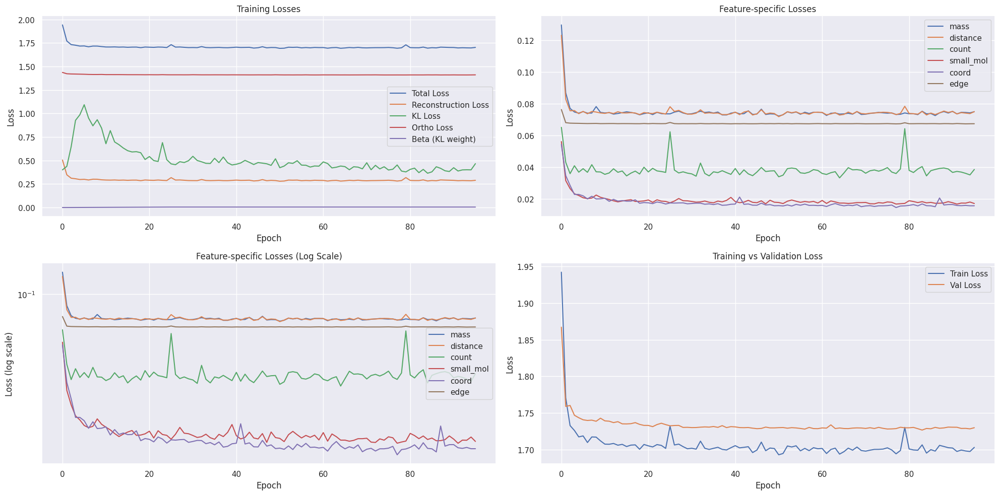

Epoch 97/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 18.73it/s, loss=1.6660, recon=0.2546, kl=0.3574, ortho=1.4097]


Detailed loss diagnostics:
Raw recon_loss: 0.3720
Raw KL loss: 0.5073
Ortho loss: 1.4089
Current beta: 0.0050
mu mean: -0.1075, std: 0.6993
logvar mean: -0.9299, std: 1.2708
mass: 0.0767
distance: 0.0851
count: 0.0971
small_mol: 0.0196
coord: 0.0237
edge: 0.0699


Epoch 97/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 19.45it/s, loss=1.6807, recon=0.2696, kl=0.3263, ortho=1.4095]


Detailed loss diagnostics:
Raw recon_loss: 0.2907
Raw KL loss: 0.4443
Ortho loss: 1.4114
Current beta: 0.0050
mu mean: -0.0735, std: 0.6497
logvar mean: -0.8643, std: 1.1706
mass: 0.0604
distance: 0.0660
count: 0.0763
small_mol: 0.0123
coord: 0.0069
edge: 0.0688


Epoch 97/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:01, 19.29it/s, loss=1.6722, recon=0.2617, kl=0.3089, ortho=1.4089]


Detailed loss diagnostics:
Raw recon_loss: 0.2555
Raw KL loss: 0.2825
Ortho loss: 1.4091
Current beta: 0.0050
mu mean: -0.0566, std: 0.4884
logvar mean: -0.5938, std: 1.0293
mass: 0.0706
distance: 0.0682
count: 0.0258
small_mol: 0.0131
coord: 0.0108
edge: 0.0671


Epoch 97/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 20.61it/s, loss=1.7050, recon=0.2936, kl=0.3174, ortho=1.4098]


Detailed loss diagnostics:
Raw recon_loss: 0.2712
Raw KL loss: 0.3297
Ortho loss: 1.4113
Current beta: 0.0050
mu mean: -0.0718, std: 0.5606
logvar mean: -0.6080, std: 1.0472
mass: 0.0771
distance: 0.0766
count: 0.0262
small_mol: 0.0101
coord: 0.0141
edge: 0.0670


Epoch 97/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.91it/s, loss=1.7544, recon=0.3270, kl=0.3042, ortho=1.4259]



Detailed loss diagnostics:
Raw recon_loss: 0.2846
Raw KL loss: 0.3910
Ortho loss: 1.4092
Current beta: 0.0050
mu mean: -0.0560, std: 0.5956
logvar mean: -0.7990, std: 1.1235
mass: 0.0797
distance: 0.0750
count: 0.0263
small_mol: 0.0226
coord: 0.0139
edge: 0.0671

Starting validation...


Epoch 97/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 70.42it/s]



Epoch [97/100] - Time: 2.42s
Train - Total: 1.6934, Recon: 0.2815, KL: 0.3900, Ortho: 1.4099, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0729
  distance_loss: 0.0730
  count_loss: 0.0358
  small_mol_loss: 0.0169
  coord_loss: 0.0154
  edge_loss: 0.0675


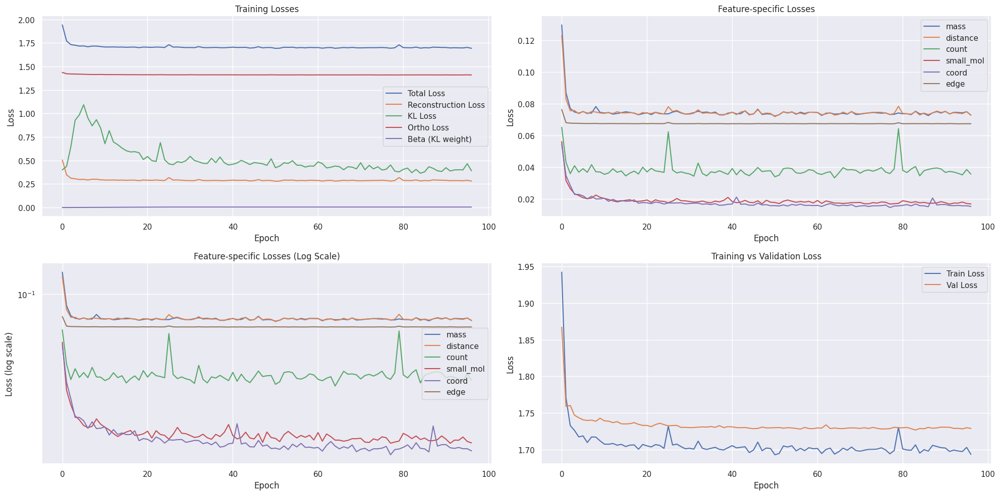

Epoch 98/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 17.92it/s, loss=1.7262, recon=0.3144, kl=0.4358, ortho=1.4097]


Detailed loss diagnostics:
Raw recon_loss: 0.2627
Raw KL loss: 0.3835
Ortho loss: 1.4087
Current beta: 0.0050
mu mean: -0.0508, std: 0.5886
logvar mean: -0.7951, std: 1.1215
mass: 0.0715
distance: 0.0699
count: 0.0259
small_mol: 0.0162
coord: 0.0115
edge: 0.0677


Epoch 98/100 [Train]:  31%|███       | 13/42 [00:00<00:01, 20.10it/s, loss=1.7187, recon=0.3079, kl=0.3369, ortho=1.4091]


Detailed loss diagnostics:
Raw recon_loss: 0.2668
Raw KL loss: 0.3503
Ortho loss: 1.4100
Current beta: 0.0050
mu mean: -0.0136, std: 0.5621
logvar mean: -0.6715, std: 1.1278
mass: 0.0718
distance: 0.0695
count: 0.0258
small_mol: 0.0178
coord: 0.0147
edge: 0.0672


Epoch 98/100 [Train]:  52%|█████▏    | 22/42 [00:01<00:01, 19.18it/s, loss=1.6892, recon=0.2791, kl=0.3196, ortho=1.4085]


Detailed loss diagnostics:
Raw recon_loss: 0.2329
Raw KL loss: 0.3906
Ortho loss: 1.4099
Current beta: 0.0050
mu mean: -0.0681, std: 0.6080
logvar mean: -0.7319, std: 1.1303
mass: 0.0615
distance: 0.0604
count: 0.0250
small_mol: 0.0099
coord: 0.0098
edge: 0.0662


Epoch 98/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 19.92it/s, loss=1.7261, recon=0.3138, kl=0.4368, ortho=1.4101]


Detailed loss diagnostics:
Raw recon_loss: 0.2684
Raw KL loss: 0.3501
Ortho loss: 1.4094
Current beta: 0.0050
mu mean: -0.0386, std: 0.5514
logvar mean: -0.7132, std: 1.1146
mass: 0.0692
distance: 0.0722
count: 0.0305
small_mol: 0.0166
coord: 0.0129
edge: 0.0670


Epoch 98/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.78it/s, loss=1.8320, recon=0.4022, kl=0.4088, ortho=1.4278]



Detailed loss diagnostics:
Raw recon_loss: 0.2567
Raw KL loss: 0.3882
Ortho loss: 1.4086
Current beta: 0.0050
mu mean: -0.0756, std: 0.5897
logvar mean: -0.7763, std: 1.1332
mass: 0.0687
distance: 0.0672
count: 0.0256
small_mol: 0.0165
coord: 0.0116
edge: 0.0671

Starting validation...


Epoch 98/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 67.16it/s]



Epoch [98/100] - Time: 2.44s
Train - Total: 1.6956, Recon: 0.2836, KL: 0.3925, Ortho: 1.4100, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0736
  distance_loss: 0.0735
  count_loss: 0.0361
  small_mol_loss: 0.0181
  coord_loss: 0.0148
  edge_loss: 0.0674


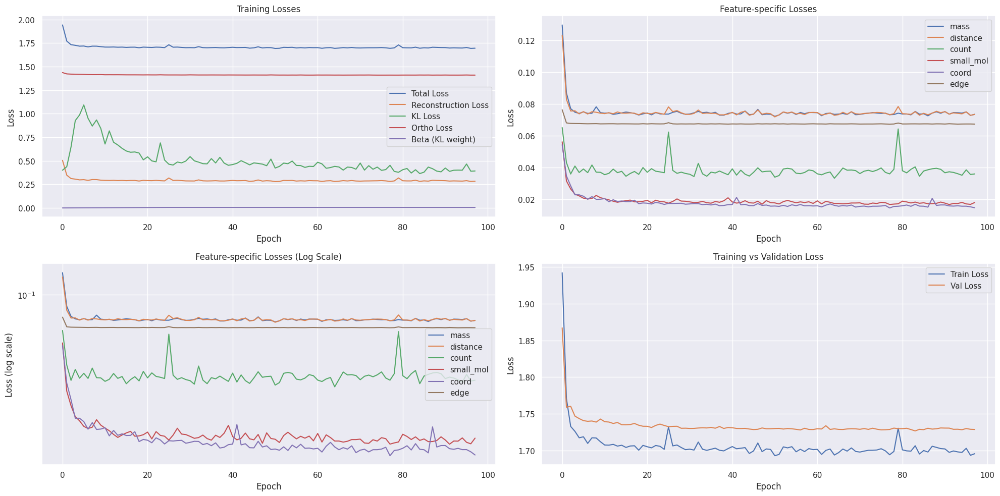

Epoch 99/100 [Train]:  10%|▉         | 4/42 [00:00<00:02, 17.38it/s, loss=1.7142, recon=0.3023, kl=0.4049, ortho=1.4098]


Detailed loss diagnostics:
Raw recon_loss: 0.2706
Raw KL loss: 0.3515
Ortho loss: 1.4077
Current beta: 0.0050
mu mean: -0.0490, std: 0.5474
logvar mean: -0.7249, std: 1.1273
mass: 0.0758
distance: 0.0728
count: 0.0261
small_mol: 0.0171
coord: 0.0118
edge: 0.0670


Epoch 99/100 [Train]:  33%|███▎      | 14/42 [00:00<00:01, 19.86it/s, loss=1.6786, recon=0.2670, kl=0.3979, ortho=1.4096]


Detailed loss diagnostics:
Raw recon_loss: 0.2657
Raw KL loss: 0.3466
Ortho loss: 1.4105
Current beta: 0.0050
mu mean: -0.0624, std: 0.5393
logvar mean: -0.7424, std: 1.0892
mass: 0.0723
distance: 0.0705
count: 0.0259
small_mol: 0.0214
coord: 0.0089
edge: 0.0667


Epoch 99/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 19.51it/s, loss=1.7186, recon=0.3059, kl=0.3989, ortho=1.4107]


Detailed loss diagnostics:
Raw recon_loss: 0.2794
Raw KL loss: 0.3556
Ortho loss: 1.4100
Current beta: 0.0050
mu mean: -0.0091, std: 0.5424
logvar mean: -0.7564, std: 1.1595
mass: 0.0763
distance: 0.0732
count: 0.0261
small_mol: 0.0175
coord: 0.0185
edge: 0.0677


Epoch 99/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 19.93it/s, loss=1.6734, recon=0.2632, kl=0.3926, ortho=1.4082]


Detailed loss diagnostics:
Raw recon_loss: 0.2421
Raw KL loss: 0.6162
Ortho loss: 1.4098
Current beta: 0.0050
mu mean: -0.1024, std: 0.7714
logvar mean: -1.1125, std: 1.4229
mass: 0.0603
distance: 0.0592
count: 0.0250
small_mol: 0.0132
coord: 0.0170
edge: 0.0675


Epoch 99/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.59it/s, loss=1.7626, recon=0.3285, kl=0.3133, ortho=1.4325]



Detailed loss diagnostics:
Raw recon_loss: 0.3457
Raw KL loss: 0.4387
Ortho loss: 1.4091
Current beta: 0.0050
mu mean: -0.0898, std: 0.6431
logvar mean: -0.8280, std: 1.1695
mass: 0.0700
distance: 0.0842
count: 0.0917
small_mol: 0.0144
coord: 0.0148
edge: 0.0707

Starting validation...


Epoch 99/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 66.63it/s]



Epoch [99/100] - Time: 2.47s
Train - Total: 1.6955, Recon: 0.2833, KL: 0.4221, Ortho: 1.4102, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0738
  distance_loss: 0.0733
  count_loss: 0.0353
  small_mol_loss: 0.0179
  coord_loss: 0.0155
  edge_loss: 0.0675


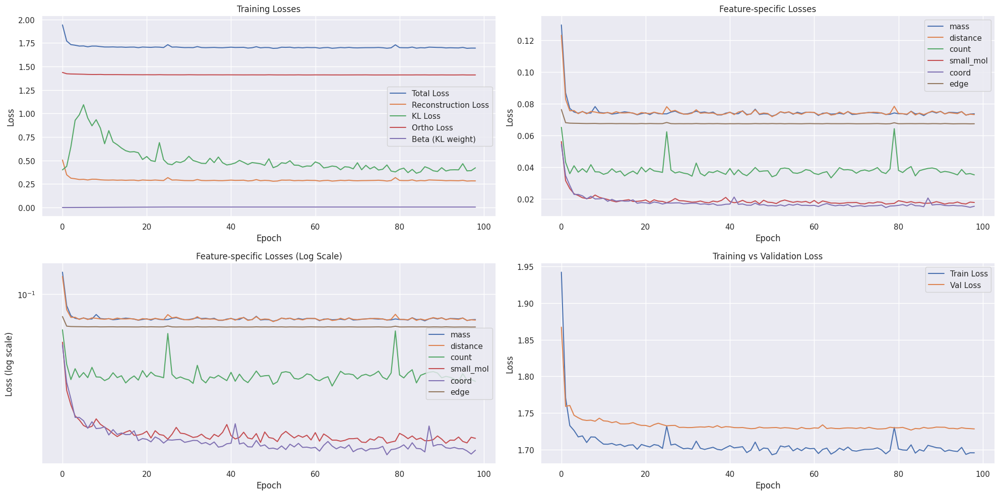

Epoch 100/100 [Train]:   7%|▋         | 3/42 [00:00<00:01, 20.69it/s, loss=1.6794, recon=0.2688, kl=0.3752, ortho=1.4088]


Detailed loss diagnostics:
Raw recon_loss: 0.2876
Raw KL loss: 0.5775
Ortho loss: 1.4092
Current beta: 0.0050
mu mean: -0.0601, std: 0.7622
logvar mean: -0.9874, std: 1.3750
mass: 0.0754
distance: 0.0730
count: 0.0260
small_mol: 0.0246
coord: 0.0212
edge: 0.0674


Epoch 100/100 [Train]:  29%|██▊       | 12/42 [00:00<00:01, 20.43it/s, loss=1.6847, recon=0.2742, kl=0.3410, ortho=1.4088]


Detailed loss diagnostics:
Raw recon_loss: 0.2691
Raw KL loss: 0.3050
Ortho loss: 1.4091
Current beta: 0.0050
mu mean: -0.0387, std: 0.4809
logvar mean: -0.6794, std: 1.1147
mass: 0.0761
distance: 0.0717
count: 0.0260
small_mol: 0.0164
coord: 0.0110
edge: 0.0678


Epoch 100/100 [Train]:  57%|█████▋    | 24/42 [00:01<00:00, 19.24it/s, loss=1.6873, recon=0.2750, kl=0.3525, ortho=1.4105]


Detailed loss diagnostics:
Raw recon_loss: 0.2903
Raw KL loss: 0.2920
Ortho loss: 1.4090
Current beta: 0.0050
mu mean: -0.0246, std: 0.4739
logvar mean: -0.6441, std: 1.0877
mass: 0.0842
distance: 0.0761
count: 0.0263
small_mol: 0.0159
coord: 0.0194
edge: 0.0684


Epoch 100/100 [Train]:  81%|████████  | 34/42 [00:01<00:00, 18.90it/s, loss=1.6911, recon=0.2808, kl=0.3253, ortho=1.4086]


Detailed loss diagnostics:
Raw recon_loss: 0.3084
Raw KL loss: 0.3014
Ortho loss: 1.4105
Current beta: 0.0050
mu mean: -0.0775, std: 0.5110
logvar mean: -0.6403, std: 1.0131
mass: 0.0822
distance: 0.0854
count: 0.0268
small_mol: 0.0295
coord: 0.0170
edge: 0.0675


Epoch 100/100 [Train]: 100%|██████████| 42/42 [00:02<00:00, 19.50it/s, loss=1.8331, recon=0.4051, kl=0.3266, ortho=1.4263]



Detailed loss diagnostics:
Raw recon_loss: 0.2690
Raw KL loss: 0.3092
Ortho loss: 1.4092
Current beta: 0.0050
mu mean: -0.0396, std: 0.5019
logvar mean: -0.6563, std: 1.0832
mass: 0.0741
distance: 0.0738
count: 0.0262
small_mol: 0.0166
coord: 0.0116
edge: 0.0668

Starting validation...


Epoch 100/100 [Valid]: 100%|██████████| 21/21 [00:00<00:00, 63.04it/s]



Epoch [100/100] - Time: 2.50s
Train - Total: 1.6954, Recon: 0.2837, KL: 0.3708, Ortho: 1.4098, Beta: 0.0050
Feature Losses:
  mass_loss: 0.0742
  distance_loss: 0.0736
  count_loss: 0.0357
  small_mol_loss: 0.0173
  coord_loss: 0.0156
  edge_loss: 0.0673


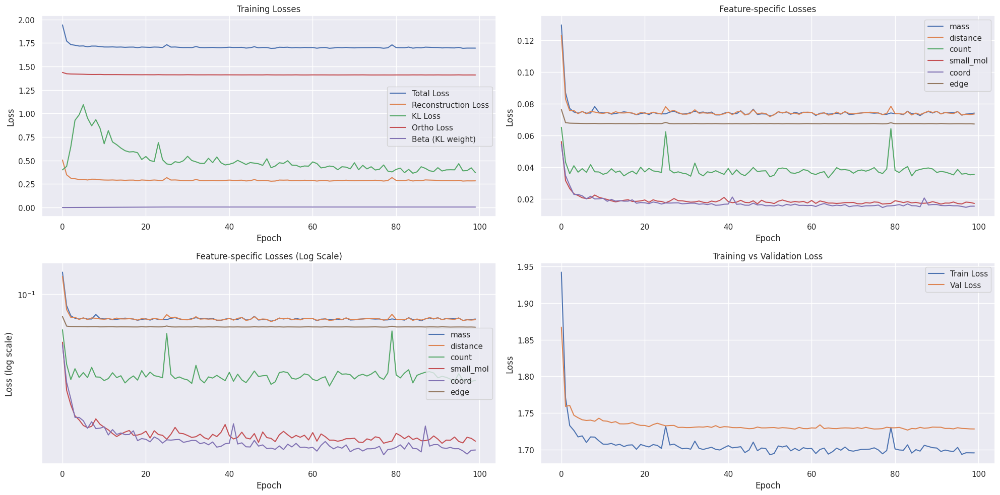


Training completed!


In [ ]:
#  #Adjust batch size for better gradient estimates
# train_loader, test_loader, in_channels, norm_params = prepare_graphs_for_vae(
#     graphs,
#     batch_size=16,  # Increased batch size
#     train_ratio=0.8,
#     shuffle=True
# )

# Send the model to device (params same as before)
model = ProteinGraphVAE(
    in_channels=8,
    hidden_channels=64,
    latent_channels=16,
    num_heads=4,
    edge_dim=1
).to(device)


# Adjust learning rate schedule
optimizer = torch.optim.Adam(model.parameters(), lr=0.0005, weight_decay=1e-5)
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=3)

# Update loss weights in the model to focus on underperforming features
model.loss_weights = {
    'mass': 0.1,
    'distance': 0.1,
    'count': 0.05,     # Lara: Updated, old=0.2 ; Increased to improve count prediction
    'small_mol': 0.1,
    'coord': 0.1,
    'edge': 0.2       # Increased to improve edge reconstruction
}

# Train with slightly different parameters
num_epochs = 100
model, history = train_model(
    model=model,
    train_loader=augmented_train_loader,
    test_loader=test_loader,
    device=device,
    num_epochs=num_epochs,
    min_beta=0.00001,    # Lower starting point
    max_beta=0.005,      # Slightly lower max
    warmup_epochs=25,    # Longer warmup
    lambda_ortho=0.1     # Keep orthogonal regularization as is
)

## Visualization of the latent space after training

Filtered node counts: 102 - 6112


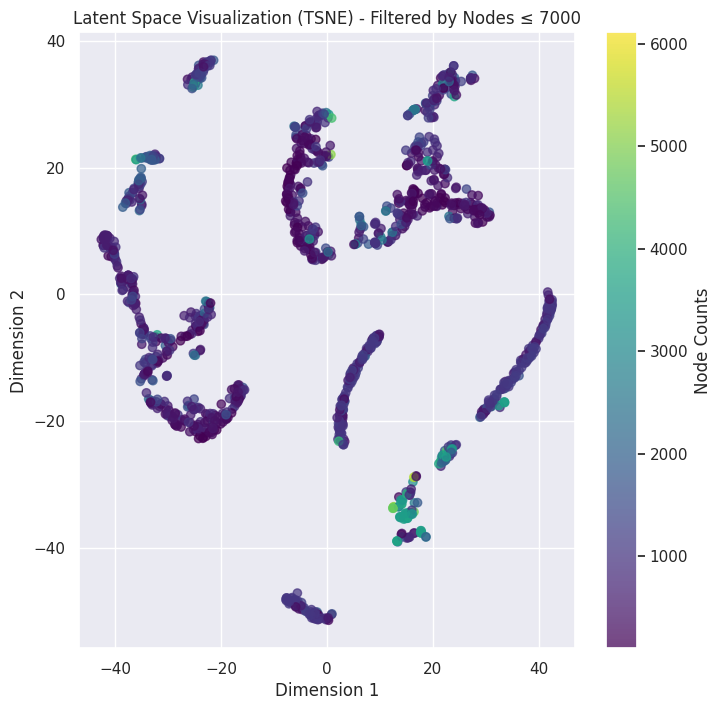

In [ ]:
visualize_latent_space_with_node_count_filtered(
    model=model,
    data_loader=augmented_train_loader,
    device=device,
    method='tsne',
    perplexity=30,
    max_nodes=7000
)

Filtered node counts: 102 - 6112


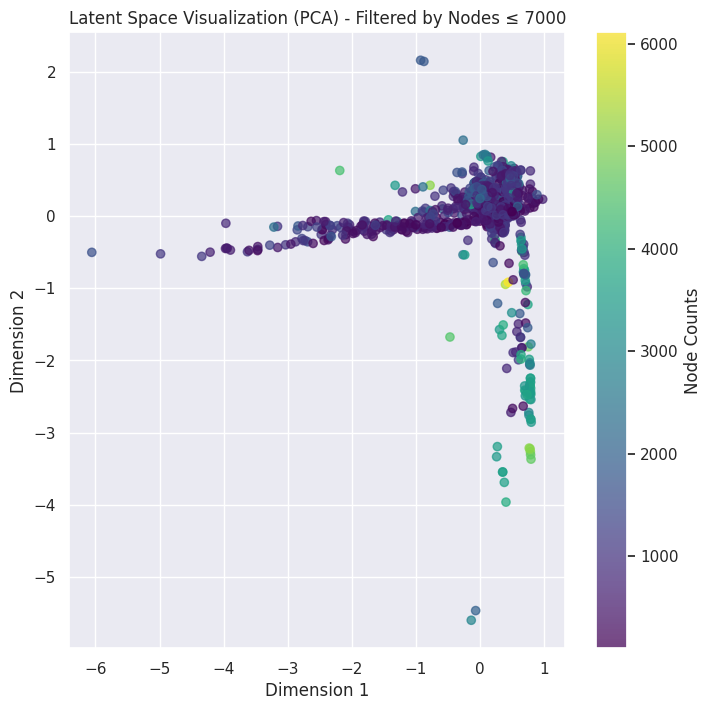

In [ ]:
visualize_latent_space_with_node_count_filtered(
    model=model,
    data_loader=augmented_train_loader,
    device=device,
    method='pca',
    max_nodes=7000
)

## Save the model

In [ ]:
# Assuming `model` is your trained ProteinGraphVAE instance
model_path = '/content/drive/MyDrive/CAS_AML/models/protein_graph_vae.pth'

# Save the model's state dictionary
torch.save(model.state_dict(), model_path)

print(f"Model saved to {model_path}")

Model saved to /content/drive/MyDrive/CAS_AML/models/protein_graph_vae.pth


In [ ]:
# Save the model and norm_params together
save_path = '/content/drive/MyDrive/CAS_AML/models/protein_graph_vae_norm.pth'
torch.save({
    'model_state_dict': model.state_dict(),
    'norm_params': norm_params
}, save_path)

print(f"Model and normalization parameters saved to {save_path}")

## Analysis of the latent space

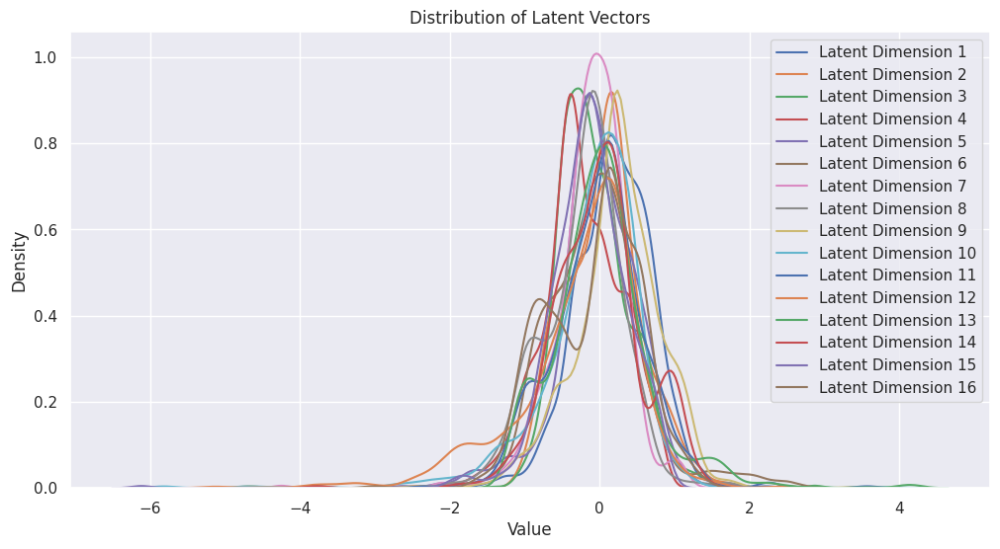

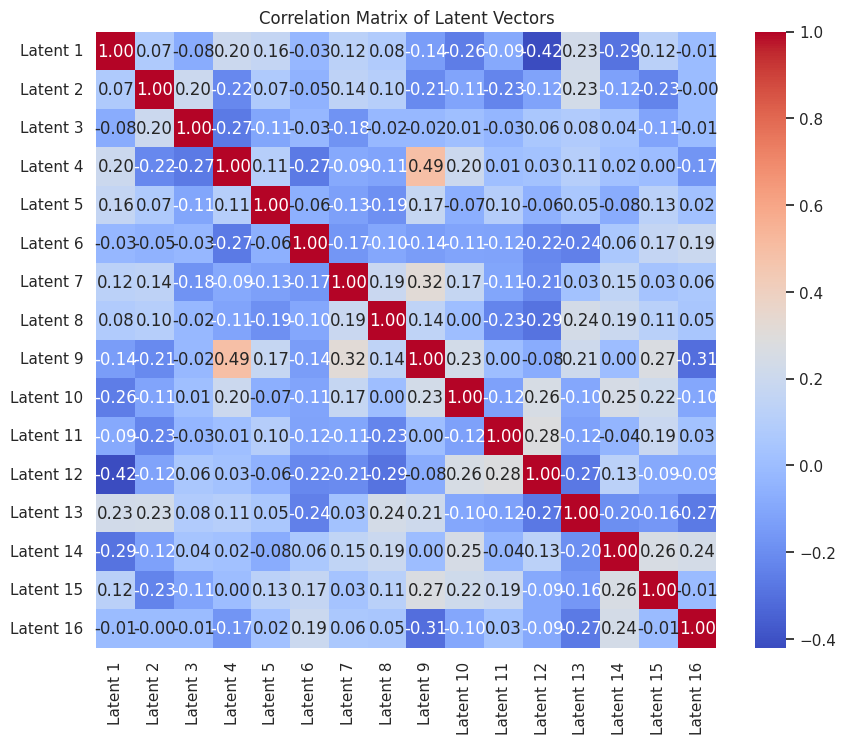

In [ ]:
def plot_latent_distribution_and_correlation(model, data_loader, device):
    """
    Plot the distribution of latent vectors and the correlation matrix.

    Args:
        model: Trained ProteinGraphVAE model.
        data_loader: DataLoader containing the data.
        device: torch device.
    """
    model.eval()
    latent_vectors = []

    with torch.no_grad():
        for batch in data_loader:
            batch = batch.to(device)
            mu, logvar = model.encode(batch.x, batch.edge_index, batch.edge_attr, batch.batch)
            z = model.reparameterize(mu, logvar)
            latent_vectors.append(z.cpu().numpy())

    latent_vectors = np.concatenate(latent_vectors, axis=0)

    # Plot the distribution of latent vectors
    plt.figure(figsize=(12, 6))
    for i in range(latent_vectors.shape[1]):
        sns.kdeplot(latent_vectors[:, i], label=f'Latent Dimension {i+1}')
    plt.title('Distribution of Latent Vectors')
    plt.xlabel('Value')
    plt.ylabel('Density')
    plt.legend()
    plt.show()

    # Compute and plot the correlation matrix
    correlation_matrix = np.corrcoef(latent_vectors, rowvar=False)
    plt.figure(figsize=(10, 8))
    sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f',
                xticklabels=[f'Latent {i+1}' for i in range(latent_vectors.shape[1])],
                yticklabels=[f'Latent {i+1}' for i in range(latent_vectors.shape[1])])
    plt.title('Correlation Matrix of Latent Vectors')
    plt.show()

# Example usage
plot_latent_distribution_and_correlation(model, augmented_train_loader, device)

In [ ]:
def analyze_latent_space(model, data_loader, device, save_path=None):
    """
    Analyze and visualize the latent space distributions and correlations

    Args:
        model: Trained ProteinGraphVAE model
        data_loader: DataLoader containing protein graphs
        device: torch device
        save_path: Optional path to save visualizations
    """
    model.eval()
    latent_vectors = []

    # Collect latent vectors
    with torch.no_grad():
        for batch in data_loader:
            batch = batch.to(device)
            mu, logvar = model.encode(batch.x, batch.edge_index, batch.edge_attr, batch.batch)
            latent_vectors.append(mu.cpu().numpy())

    # Concatenate all latent vectors
    latent_vectors = np.concatenate(latent_vectors, axis=0)

    # Create figure with subplots
    fig = plt.figure(figsize=(20, 10))

    # 1. Distribution plots for each latent dimension
    ax1 = plt.subplot(231)
    for i in range(latent_vectors.shape[1]):
        sns.kdeplot(data=latent_vectors[:, i], ax=ax1, label=f'Dim {i}')
    ax1.set_title('Latent Dimension Distributions')
    ax1.set_xlabel('Value')
    ax1.set_ylabel('Density')
    ax1.legend(bbox_to_anchor=(1.05, 1), loc='upper left')

    # 2. Correlation matrix
    ax2 = plt.subplot(232)
    corr_matrix = np.corrcoef(latent_vectors.T)
    sns.heatmap(corr_matrix,
                ax=ax2,
                cmap='coolwarm',
                center=0,
                vmin=-1,
                vmax=1,
                square=True,
                xticklabels=False,
                yticklabels=False)
    ax2.set_title('Latent Dimension Correlations')

    # 3. PCA visualization
    ax3 = plt.subplot(233)
    pca = PCA(n_components=2)
    pca_result = pca.fit_transform(latent_vectors)
    scatter = ax3.scatter(pca_result[:, 0],
                          pca_result[:, 1],
                          alpha=0.5,
                          c=np.sum(latent_vectors**2, axis=1),  # Color by L2 norm
                          cmap='viridis')
    plt.colorbar(scatter, ax=ax3, label='L2 Norm')
    ax3.set_title(f'PCA Projection\nExplained Variance: {pca.explained_variance_ratio_.sum():.2%}')

    # 4. Box plot of latent dimensions
    ax4 = plt.subplot(234)
    ax4.boxplot(latent_vectors)
    ax4.set_title('Latent Dimension Ranges')
    ax4.set_xlabel('Dimension')
    ax4.set_ylabel('Value')

    # 5. Dimension-wise statistics
    ax5 = plt.subplot(235)
    stats = pd.DataFrame({
        'Mean': np.mean(latent_vectors, axis=0),
        'Std': np.std(latent_vectors, axis=0),
        'Median': np.median(latent_vectors, axis=0),
        'IQR': np.percentile(latent_vectors, 75, axis=0) - np.percentile(latent_vectors, 25, axis=0)
    })
    stats.index = [f'Dim {i}' for i in range(latent_vectors.shape[1])]
    sns.heatmap(stats,
                ax=ax5,
                cmap='viridis',
                annot=True,
                fmt='.2f')
    ax5.set_title('Dimension-wise Statistics')

    # 6. Wasserstein distance matrix between dimensions
    ax6 = plt.subplot(236)
    n_dims = latent_vectors.shape[1]
    wasserstein_mat = np.zeros((n_dims, n_dims))
    for i in range(n_dims):
        for j in range(n_dims):
            wasserstein_mat[i, j] = wasserstein_distance(
                latent_vectors[:, i],
                latent_vectors[:, j]
            )
    sns.heatmap(wasserstein_mat,
                ax=ax6,
                cmap='viridis',
                square=True,
                xticklabels=False,
                yticklabels=False)
    ax6.set_title('Wasserstein Distances\nbetween Dimensions')

    plt.tight_layout()

    # Save if path provided
    if save_path:
        plt.savefig(save_path, dpi=300, bbox_inches='tight')

    # Calculate additional metrics
    metrics = {
        'mean_correlation': np.mean(np.abs(corr_matrix - np.eye(n_dims))),
        'max_correlation': np.max(np.abs(corr_matrix - np.eye(n_dims))),
        'mean_wasserstein': np.mean(wasserstein_mat),
        'dimension_entropy': -np.sum(np.mean(latent_vectors, axis=0) * np.log(np.abs(np.mean(latent_vectors, axis=0)) + 1e-10)),
        'pca_explained_variance': pca.explained_variance_ratio_.sum()
    }

    return fig, metrics

def visualize_latent_traversal(model, data_loader, device, dim_idx=0, n_steps=10):
    """
    Visualize how changing a single latent dimension affects the reconstruction

    Args:
        model: Trained ProteinGraphVAE model
        data_loader: DataLoader containing protein graphs
        device: torch device
        dim_idx: Index of dimension to traverse
        n_steps: Number of steps in traversal
    """
    model.eval()

    # Get a sample batch
    batch = next(iter(data_loader)).to(device)

    # Get latent representation
    with torch.no_grad():
        mu, logvar = model.encode(batch.x, batch.edge_index, batch.edge_attr, batch.batch)
        z = model.reparameterize(mu, logvar)

    # Create traversal values
    traversal_range = np.linspace(-3, 3, n_steps)
    reconstructions = []

    # Generate reconstructions
    with torch.no_grad():
        for value in traversal_range:
            z_new = z.clone()
            z_new[:, dim_idx] = value
            recon, edge_recon = model.decode(z_new, batch.x.size(0), batch.edge_index)
            reconstructions.append(recon.cpu().numpy())

    return np.array(reconstructions), traversal_range

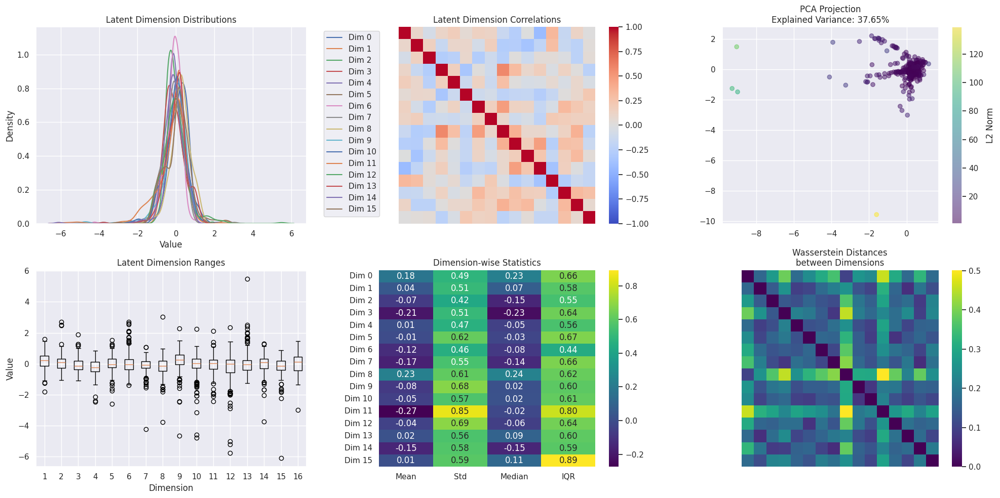

mean_correlation: 0.1556
max_correlation: 0.5826
mean_wasserstein: 0.1844
dimension_entropy: -1.3024
pca_explained_variance: 0.3765


In [ ]:
# After training your model
fig, metrics = analyze_latent_space(model, test_loader, device)
plt.show()

# Print latent space metrics
for name, value in metrics.items():
    print(f"{name}: {value:.4f}")

# Visualize how changing dimension 0 affects reconstruction
reconstructions, traversal_values = visualize_latent_traversal(model, test_loader, device, dim_idx=0)

# Generator

## Load the model (activate for inference)

In [ ]:
# # Initialize your model
# model = ProteinGraphVAE(
#     in_channels=8,
#     hidden_channels=64,
#     latent_channels=16,
#     num_heads=4,
#     edge_dim=1
# )

# # Load the state dictionary
# model_path = '/content/drive/MyDrive/CAS_AML/models/protein_graph_vae.pth'
# model.load_state_dict(torch.load(model_path, map_location=torch.device('cpu')))

# # Set the model to evaluation mode (if needed)
# model.eval()

# print(f"Model loaded from {model_path}")


In [ ]:
# # Model inference (with normalization parameters)

# # Load the model and norm_params
# checkpoint = torch.load('/content/drive/MyDrive/CAS_AML/models/protein_graph_vae.pth')
# model.load_state_dict(checkpoint['model_state_dict'])
# norm_params = checkpoint['norm_params']

# # Move the model to the appropriate device
# model.to(device)
# model.eval()

# print(f"Model and normalization parameters loaded successfully")


In [ ]:
generated_graphs = generate_protein_graphs(
    model=model,
    num_samples=5,  # n° graphs
    nodes_per_graph=3000,  # nodes per graph
    norm_params=norm_params,
    device=device,
    k=10,
    temperature=2.0)

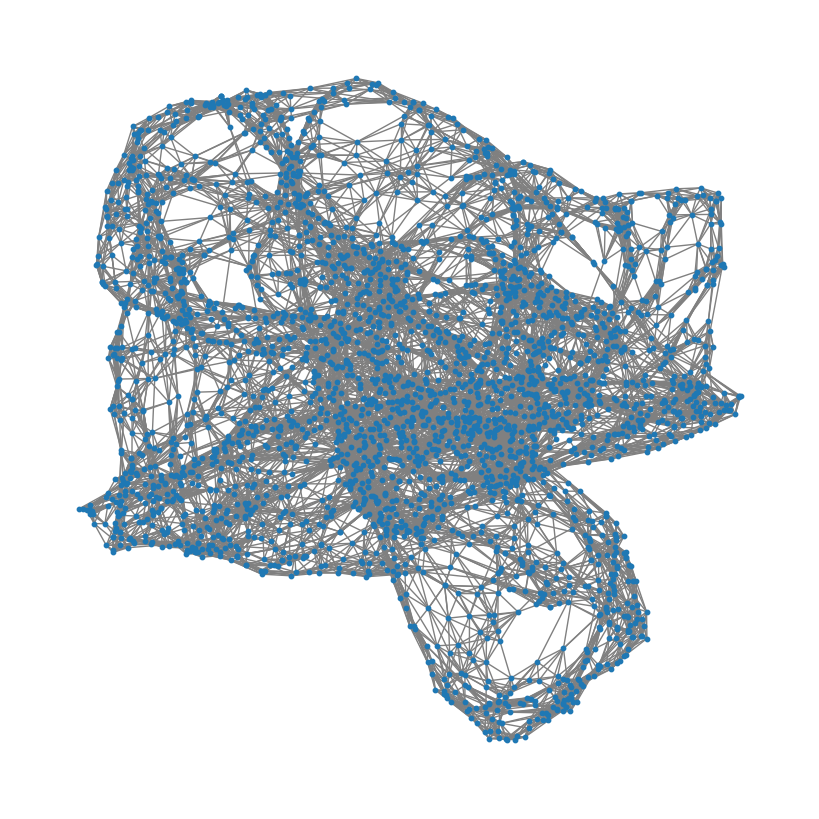

In [ ]:
graph = generated_graphs[0]
nx_graph = to_networkx(graph, to_undirected=True)
plt.figure(figsize=(8, 8))
nx.draw(nx_graph, node_size=10, edge_color="gray")
plt.show()


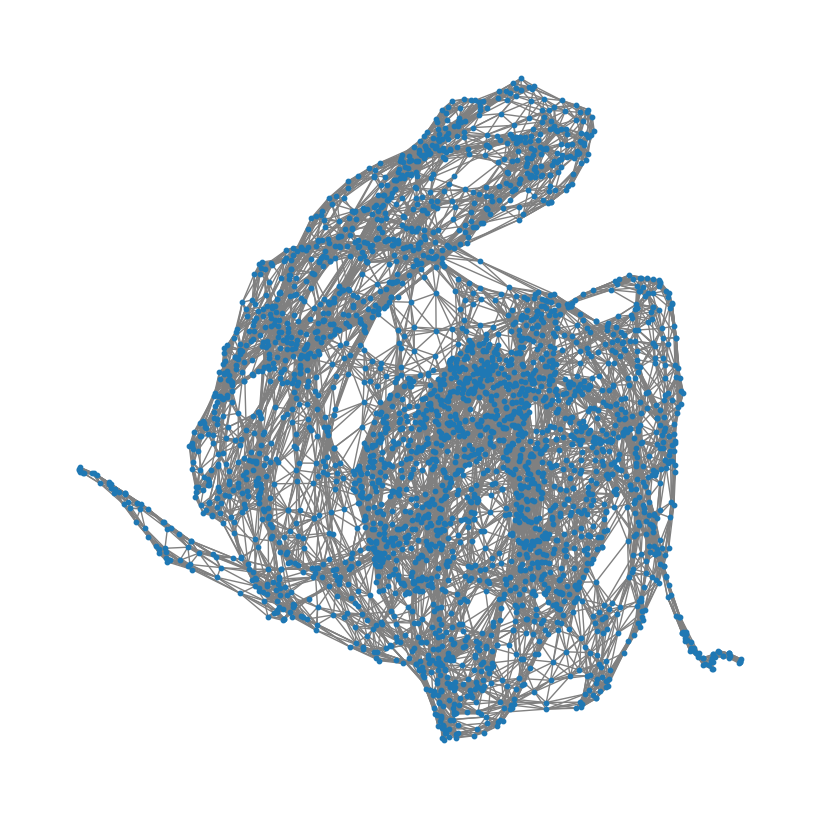

In [ ]:
graph = generated_graphs[1]
nx_graph = to_networkx(graph, to_undirected=True)
plt.figure(figsize=(8, 8))
nx.draw(nx_graph, node_size=10, edge_color="gray")
plt.show()

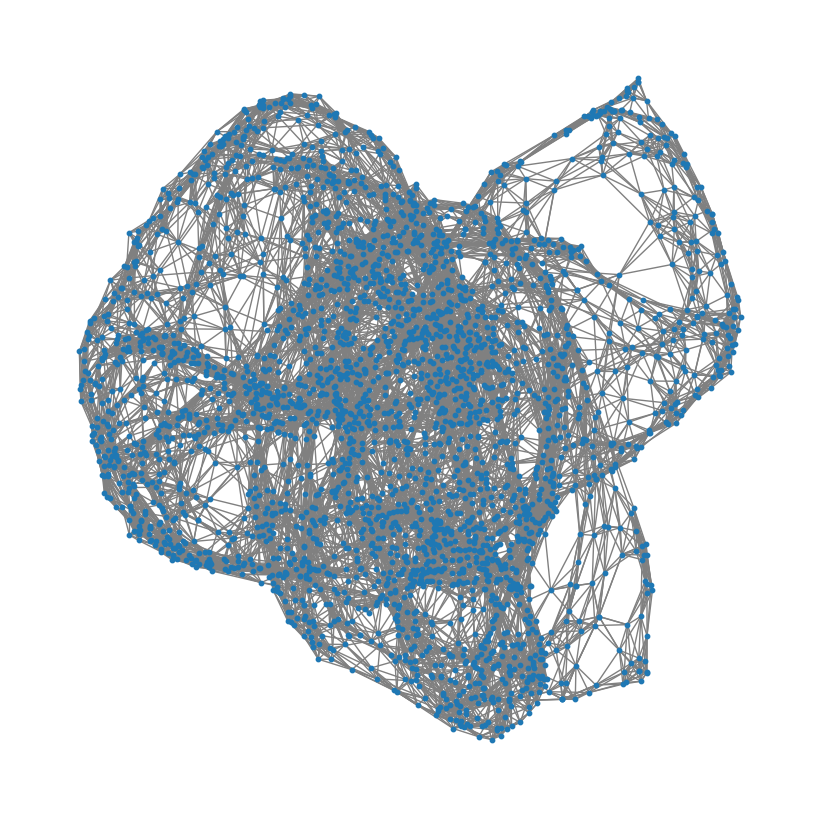

In [ ]:
graph = generated_graphs[2]
nx_graph = to_networkx(graph, to_undirected=True)
plt.figure(figsize=(8, 8))
nx.draw(nx_graph, node_size=10, edge_color="gray")
plt.show()

## evaluate the generations

In [ ]:
# Apply this to each generated graph
for i, protein_graph in enumerate(generated_graphs, 1):
    metrics = calculate_graph_metrics(protein_graph)
    print(f"Metrics for Generated Protein {i}:")
    for key, value in metrics.items():
        print(f"  {key}: {value}")



Metrics for Generated Protein 1:
  num_nodes: 3000
  num_edges: 15946
  avg_degree: 10.630666666666666
  edge_density: 0.0035447371346004224
  clustering_coeff: 0.5463033483945244
  graph_diameter: 32
  avg_path_length: 16.454133155496276
Metrics for Generated Protein 2:
  num_nodes: 3000
  num_edges: 16140
  avg_degree: 10.76
  edge_density: 0.0035878626208736245
  clustering_coeff: 0.564597291706114
  graph_diameter: 73
  avg_path_length: 23.011373124374792
Metrics for Generated Protein 3:
  num_nodes: 3000
  num_edges: 16566
  avg_degree: 11.044
  edge_density: 0.0036825608536178727
  clustering_coeff: 0.4977581719478782
  graph_diameter: 28
  avg_path_length: 14.521712793153274
Metrics for Generated Protein 4:
  num_nodes: 3000
  num_edges: 16733
  avg_degree: 11.155333333333333
  edge_density: 0.0037196843392241856
  clustering_coeff: 0.45606937132927944
  graph_diameter: 22
  avg_path_length: 9.621464043570079
Metrics for Generated Protein 5:
  num_nodes: 3000
  num_edges: 15358


# evaluate

In [ ]:
# def save_to_pdb(graph, aa_info, filename, scale_factor=10):
#     """
#     Save a generated graph as a PDB file with residues mapped based on closest masses.
#     Rescales the coordinates for better visualization.
#     """
#     node_features = graph.x.cpu().numpy()  # Assuming `x` contains the features
#     coordinates = node_features[:, -3:]    # Assuming the last three columns are coordinates
#     avg_masses = node_features[:, 0]       # Assuming the first column is the average mass

#     # Rescale coordinates
#     coordinates = rescale_coordinates(coordinates, scale_factor)

#     aa_masses = aa_info["Avg. mass (Da)"].values
#     aa_names = aa_info["Abbrev."].values

#     structure = Structure.Structure("Generated_Protein")
#     model = Model.Model(0)
#     chain = Chain.Chain("A")
#     structure.add(model)
#     model.add(chain)

#     for i, (coord, avg_mass) in enumerate(zip(coordinates, avg_masses)):
#         # Map avg_mass to the closest amino acid
#         differences = np.abs(aa_masses - avg_mass)
#         closest_idx = np.argmin(differences)
#         aa_name = aa_names[closest_idx]

#         # Debugging: Print mapping details
#         print(f"Node {i}: avg_mass={avg_mass}, closest_aa={aa_name}, coord={coord}")

#         res_id = (" ", i + 1, " ")
#         residue = Residue.Residue(res_id, aa_name, " ")

#         atom = Atom.Atom(
#             "CA",
#             coord,
#             1.0,
#             1.0,
#             " ",
#             f"CA{i}",
#             i + 1,
#             element="C"
#         )
#         residue.add(atom)
#         chain.add(residue)

#     io = PDBIO()
#     io.set_structure(structure)
#     io.save(filename)
#     print(f"Protein saved to {filename}")


In [ ]:
# # Save to PDB
# generated_graph = generated_graphs[0]  # Your generated graph
# save_to_pdb(graph, aa_info, "/content/drive/MyDrive/CAS_AML/outputs/generated_protein.pdb")

# Sources

https://opig.stats.ox.ac.uk/webapps/sabdab-sabpred/sabdab/nano/?all=true#downloads